In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
default_max_columns=pd.get_option('display.max_columns')

In [10]:
default_max_rows=pd.get_option('display.max_rows')

In [11]:
default_precision=pd.get_option('display.precision')

In [12]:
pd.set_option('display.precision', 2)

In [13]:
default_threshold=np.get_printoptions()['threshold']

In [14]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [15]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [16]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [17]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [18]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [19]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [20]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix

In [21]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210512-report.csv.gz',index_col=0,header=None,low_memory=False)

In [22]:
df.shape

(12026, 528)

In [23]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [24]:
df.drop("---",inplace=True)

In [25]:
df.shape

(12025, 528)

In [26]:
df.rename({'  ':'sample'},axis='rows',inplace=True)

In [27]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rntRNA-Leu-CTA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rn(TGTAAT)n,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rn(TCTGTCA)n,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
df=df.T

In [29]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rnUCON58,rn(TTTCACT)n,rn(TTAGTC)n,rn(TTACAGAA)n,rntRNA-Ser-TCA_,rntRNA-Leu-CTA,rn(TGTAAT)n,rn(TCTGTCA)n,rn(TCCCTG)n,rn(TACTCTA)n
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,NaN


In [30]:
df=df.merge(meta,left_on='Subject',right_on='subject')

In [31]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rn(TCTGTCA)n,rn(TCCCTG)n,rn(TACTCTA)n,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [32]:
df.columns  #.tolist()

Index(['sample', 'Subject', 'Lab kit', 'Trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'rn(TCTGTCA)n', 'rn(TCCCTG)n', 'rn(TACTCTA)n', 'subject', 'dplex',
       'lexogen', 'diag', 'disease', 'idh', 'x1p19q'],
      dtype='object', length=12032)

In [33]:
df.columns.tolist().index('bowtie2 mRNA Counts')

38

In [34]:
#mrnas=df.columns[41:91]
#mrnas=df.columns[37:99]
a=df.columns.tolist().index('bowtie2 mRNA Counts')+1
b=df.columns.tolist().index('STAR Gene Counts')
mrnas=df.columns[a:b]
mrnas

Index(['NR_004393.1', 'NR_030161.1', 'NR_106984.1', 'NR_002728.3',
       'NR_146117.1', 'NR_002716.3', 'NR_029484.1', 'NR_146144.1',
       'NR_146151.1', 'NR_047469.1',
       ...
       'XM_017015930.1', 'NM_001320974.2', 'XR_951069.2', 'XR_002956242.1',
       'XM_017000261.2', 'XR_940516.3', 'NR_126364.1', 'NM_001164715.2',
       'NM_001137671.2', 'NM_001144877.3'],
      dtype='object', length=1664)

In [35]:
df.columns.tolist().index('STAR Gene Counts')

1703

In [36]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
a=df.columns.tolist().index('STAR Gene Counts')+1
b=df.columns.tolist().index('STAR miRNA Counts')
genes=df.columns[a:b]
genes

Index(['RPH3A', 'P2RX6', 'PLCE1', 'ADGRG6', 'CCDC151', 'PIGG', 'NAALADL2',
       'MAPT', 'MIR486-1', 'MIR486-2',
       ...
       'ZER1', 'ATP10B', 'RAD54B', 'SPTBN1', 'PCDH11Y', 'GRM7', 'AEBP2',
       'CCNT1', 'CAP1', 'TMEM44'],
      dtype='object', length=2993)

In [37]:
df.columns.tolist().index('STAR miRNA Counts')

4697

In [38]:
#mirnas=df.columns[143:193]
#mirnas=df.columns[555:1139]
a=df.columns.tolist().index('STAR miRNA Counts')+1
b=df.columns.tolist().index('rmsk Family Counts')
#b=df.columns.tolist().index('diamond Family Counts')
mirnas=df.columns[a:b]
mirnas

Index(['hsa-mir-944-hairpin', 'hsa-mir-1260a-hairpin', 'hsa-mir-4538-hairpin',
       'hsa-mir-4538-mature', 'hsa-mir-486-1-hairpin', 'hsa-mir-486-2-hairpin',
       'hsa-mir-3168-hairpin', 'hsa-mir-3168-mature', 'hsa-mir-484-hairpin',
       'hsa-mir-1281-hairpin',
       ...
       'hsa-mir-4647-mature', 'hsa-mir-4742-3p-mature',
       'hsa-mir-3692-3p-mature', 'hsa-mir-24-1-5p-mature',
       'hsa-mir-19b-2-5p-mature', 'hsa-mir-651-3p-mature',
       'hsa-mir-520d-3p-mature', 'hsa-mir-6831-3p-mature',
       'hsa-mir-664b-3p-mature', 'hsa-mir-147a-mature'],
      dtype='object', length=3785)

In [39]:
#df.columns.tolist().index('diamond Family Counts')

In [40]:
#diamond_families=df.columns[194:244]
diamond_families=[]
#a=df.columns.tolist().index('diamond Family Counts')+1
#b=df.columns.tolist().index('rmsk Family Counts')
#diamond_families=df.columns[a:b]
diamond_families

[]

In [41]:
df.columns.tolist().index('rmsk Family Counts')

8483

In [42]:
#rmsk_families=df.columns[245:295]
#rmsk_families=df.columns[1140:1196]
a=df.columns.tolist().index('rmsk Family Counts')+1
b=df.columns.tolist().index('rmsk Class Counts')
rmsk_families=df.columns[a:b]
rmsk_families

Index(['rfL1', 'rfAlu', 'rfL2', 'rfSimple_repeat', 'rfERVL-MaLR', 'rfMIR',
       'rfERV1', 'rfERVL', 'rfrRNA', 'rfhAT-Charlie', 'rfTcMar-Tigger',
       'rfcentr', 'rfscRNA', 'rfSatellite', 'rfLow_complexity', 'rfCR1',
       'rfsnRNA', 'rfhAT-Tip100', 'rfERVK', 'rftRNA', 'rfSVA', 'rfGypsy',
       'rfRTE-X', 'rfhAT-Blackjack', 'rfTcMar-Mariner', 'rfTcMar-Tc2',
       'rfGypsy?', 'rfRTE-BovB', 'rfhAT', 'rftRNA-RTE', 'rfsrpRNA',
       'rfUnknown', 'rfLTR', 'rfacro', 'rfMULE-MuDR', 'rfhAT-Ac', 'rfERVL?',
       'rfPiggyBac', 'rfhAT-Tip100?', 'rfHelitron', 'rf5S-Deu-L2', 'rftelo',
       'rfDNA', 'rfhAT?', 'rfERV1?', 'rfPenelope', 'rfRNA', 'rfDong-R4',
       'rfTcMar?', 'rftRNA-Deu', 'rfPiggyBac?', 'rfhAT-Tag1', 'rfTcMar',
       'rfMerlin', 'rfPIF-Harbinger', 'rfTcMar-Pogo'],
      dtype='object')

In [43]:
df.columns.tolist().index('rmsk Class Counts')

8540

In [44]:
#rmsk_classes=df.columns[296:312]
#rmsk_classes=df.columns[1197:1213]
a=df.columns.tolist().index('rmsk Class Counts')+1
b=df.columns.tolist().index('rmsk Name Counts')
rmsk_classes=df.columns[a:b]
rmsk_classes

Index(['rcLINE', 'rcSINE', 'rcLTR', 'rcSimple_repeat', 'rcDNA', 'rcSatellite',
       'rcrRNA', 'rcscRNA', 'rcLow_complexity', 'rcsnRNA', 'rctRNA',
       'rcRetroposon', 'rcsrpRNA', 'rcUnknown', 'rcRC', 'rcRNA'],
      dtype='object')

In [45]:
df.columns.tolist().index('rmsk Name Counts')

8557

In [46]:
#rmsk_names=df.columns[313:363]
#rmsk_names=df.columns[1214:1699]
a=df.columns.tolist().index('rmsk Name Counts')+1
b=df.columns.tolist().index('subject')
rmsk_names=df.columns[a:b]
rmsk_names

Index(['rnAluJb', 'rnAluSx1', 'rnAluSx', 'rnAluSz', 'rnL2a', 'rnAluY',
       'rnAluJr', 'rnAluJo', 'rnL2c', 'rnMIRb',
       ...
       'rnUCON58', 'rn(TTTCACT)n', 'rn(TTAGTC)n', 'rn(TTACAGAA)n',
       'rntRNA-Ser-TCA_', 'rntRNA-Leu-CTA', 'rn(TGTAAT)n', 'rn(TCTGTCA)n',
       'rn(TCCCTG)n', 'rn(TACTCTA)n'],
      dtype='object', length=3467)

In [47]:
df.columns.tolist().index('subject')

12025

In [48]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [49]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [50]:
pd.set_option('display.max_rows',None)

In [51]:
df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

,subject,sample,Raw Read Count
222,1_1,SFHH006a,364593
234,1_2,SFHH006b,400868
246,1_3,SFHH006c,455355
330,1_10,SFHH006j,469602
486,3_1,SFHH006w,487861
306,1_8,SFHH006h,574687
270,1_5,SFHH006e,634722
78,3_11,SFHH006ag,704209
90,4_1,SFHH006ah,715171
282,1_6,SFHH006f,901462


In [52]:
df[['subject','sample','Trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

,subject,sample,Trimmer,Trimmed Read Count
192,4_10,SFHH005aq,bbduk1,320844
222,1_1,SFHH006a,bbduk1,343248
223,1_1,SFHH006a,bbduk2,360723
224,1_1,SFHH006a,bbduk3,360738
225,1_1,SFHH006a,cutadapt1,364038
226,1_1,SFHH006a,cutadapt2,364400
227,1_1,SFHH006a,cutadapt3,364427
193,4_10,SFHH005aq,bbduk2,371834
194,4_10,SFHH005aq,bbduk3,371844
196,4_10,SFHH005aq,cutadapt2,376186


In [53]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [54]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [55]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [56]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [57]:
type(diags)

numpy.ndarray

In [58]:
diags=diags.tolist()

In [59]:
type(diags)

list

In [60]:
d=diags.copy()

In [61]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [62]:
d.remove(d[2])

In [63]:
d

['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,', 'GBM, IDH1R132H WT,']

In [64]:
# Why here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

In [65]:
#'subject' in dfn.columns

higher pvalue for selection to heatmap but less in boxplot
filter oon variance fo Steve's samples or high blank values

pca plots

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [77]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.01,heat_p=0.1):
    select_p_values=[]
    for col in columns:
        #print(col)
        #
        # Check if column exists?
        if ( col not in localdf.columns ):
            continue
        #
        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) & (localdf["Trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) & (localdf["Trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')
    #print(pdf)
    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[(localdf['diag']=='V01 control (S1),,')&(localdf["Lab kit"]==row['labkit'])&(localdf["Trimmer"]==row['trimmer'])][row['col']])
            print(localdf[(localdf['diag']=='blank 2 (C1),,')&(localdf["Lab kit"]==row['labkit'])&(localdf["Trimmer"]==row['trimmer'])][row['col']])
            print(localdf[(localdf['diag']=='blank1 (C1),,')&(localdf["Lab kit"]==row['labkit'])&(localdf["Trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) & (localdf["Trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','Trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #print(selected)
    #print(len(selected))
    #['Lab kit' 'NR_029609.1' 'Trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('Trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                tmp-=tmp.min()
                tmp/=tmp.max()
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column, subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0)
                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag']).T
                
                #plt.subplots(figsize=(15,10))
                #sns.heatmap(tmp,cmap="Spectral")
                #plt.xticks(rotation=75,ha='right')
                #plt.title("Heatmap "+trimmer+" "+labkit)
                #plt.show()

                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral")
                #g=sns.clustermap(tmp,col_cluster=False,cmap="Spectral")
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
                plt.show()

                #g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral")
                #g=sns.clustermap(tmp,cmap="Spectral")
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

In [67]:
def ttests_and_boxplots(localdf,columns,max_p=0.10):
    selected=['subject','sample','Lab kit','Trimmer','diag']
    for col in columns:
        #
        # Check if column exists?
        #
        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                ps=[]
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) & (localdf["Trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) & (localdf["Trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < max_p:
                            print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                            print("\tt = " + str(t))
                            print("\tp = " + str(p))
                        ps=np.append(ps,p)

                if(any(p < max_p for p in ps)):
                    selected=np.append(selected,col)
                    localdf[((localdf["Lab kit"]==labkit) & (localdf["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                    plt.title(col + " Normalized by Trimmed Read Count")
                    plt.xticks(rotation=75,ha='right')
                    plt.show()
    selected=np.unique(selected)
    return selected


In [68]:
def heat_and_clustermaps(localdf,columns):
    #for trimmer in dfn['Trimmer'].unique():
    for trimmer in 'bbduk2','cutadapt2':
        for labkit in dfn['Lab kit'].unique():
            tmp=localdf[columns].copy()
            tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
            tmp=tmp.drop('Trimmer',axis='columns')
            tmp=tmp.drop('Lab kit',axis='columns')
            tmp.set_index(['subject','sample','diag'],inplace=True)
            #tmp=tmp.transform(lambda x: np.log2(x))
            
            # scale each column from 0-1
            tmp-=tmp.min()
            tmp/=tmp.max()
            
            tmp=tmp.fillna(0).sort_values(['diag']).T
            plt.subplots(figsize=(15,10))
            sns.heatmap(tmp,cmap="Spectral")
            plt.xticks(rotation=75,ha='right')
            plt.title("Heatmap "+trimmer+" "+labkit)
            plt.show()
            
            
            # Check number of samples and columns prior to clustermap?

            
            g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
            g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
            plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
            plt.show()

# Normalize by Trimmed Read Count

In [69]:
dfn=df.copy()

In [70]:
dfn.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,rn(TCTGTCA)n,rn(TCCCTG)n,rn(TACTCTA)n,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,NaN,8,NaN,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [71]:
dfn[mirnas]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[mirnas])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[genes]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[genes])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[mrnas]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[mrnas])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[diamond_families]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[diamond_families])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsk_families]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_families])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsk_classes]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_classes])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsk_names]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_names])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )


In [72]:
#dfn[dfn=='---']=''
#dfn.replace(to_replace = '---', value = '', inplace = True)


In [73]:
#dfn[41:]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[41:])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )


selected=ttests_and_boxplots(dfn,mirnas)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,genes)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],max_p=0.2)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,mrnas)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,diamond_families)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,rmsk_families)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,rmsk_classes)
heat_and_clustermaps(dfn,selected)

selected=ttests_and_boxplots(dfn,rmsk_names)
heat_and_clustermaps(dfn,selected)

# Genes

 p : 0.0007165852070366561  ( t : 4.071279640053069 ) :  Lexogen  :  bbduk2  :  MAST1
Control and blanks
79     41487.36
343    15711.26
Name: MAST1, dtype: float64
211    20224.67
Name: MAST1, dtype: float64
475    45507.99
Name: MAST1, dtype: float64


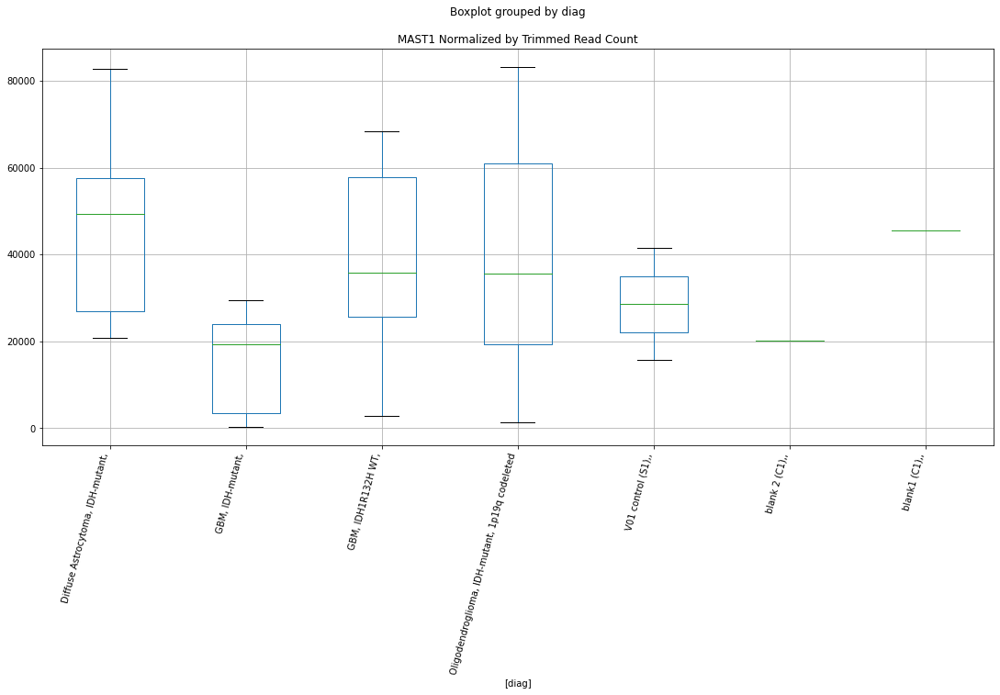

 p : 0.0007996878127283024  ( t : 4.021992549230216 ) :  Lexogen  :  cutadapt2  :  MAST1
Control and blanks
82     41181.48
346    15782.59
Name: MAST1, dtype: float64
214    20070.76
Name: MAST1, dtype: float64
478    45117.49
Name: MAST1, dtype: float64


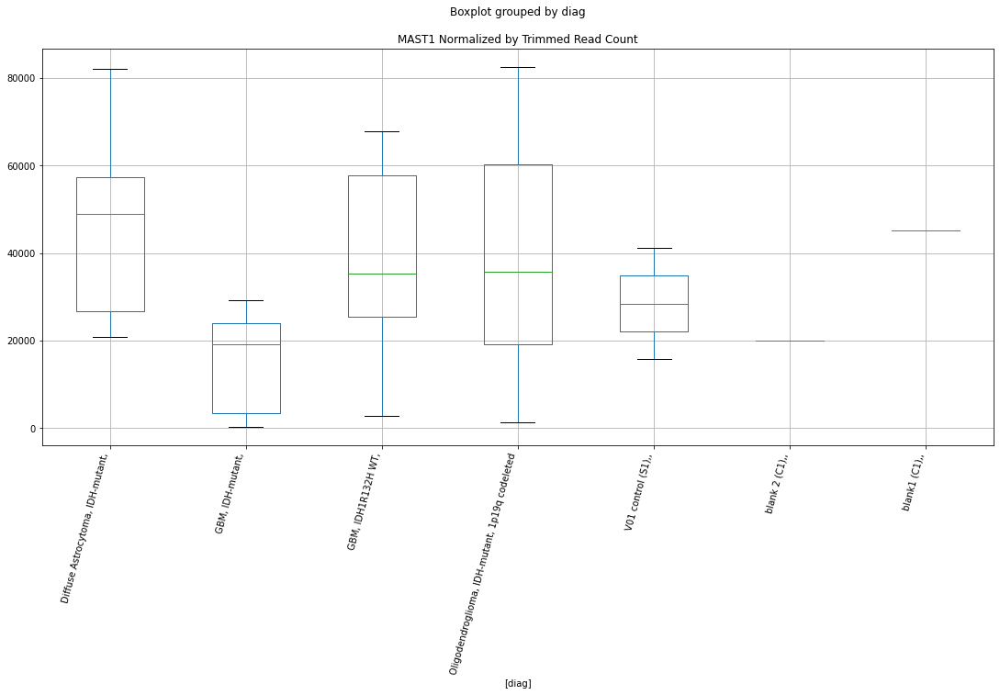

 p : 0.0015326762262049772  ( t : 3.730018063107694 ) :  D-plex  :  cutadapt2  :  ZNF800
Control and blanks
76     152280.46
340     11449.52
Name: ZNF800, dtype: float64
208    56964.35
Name: ZNF800, dtype: float64
472    43924.64
Name: ZNF800, dtype: float64


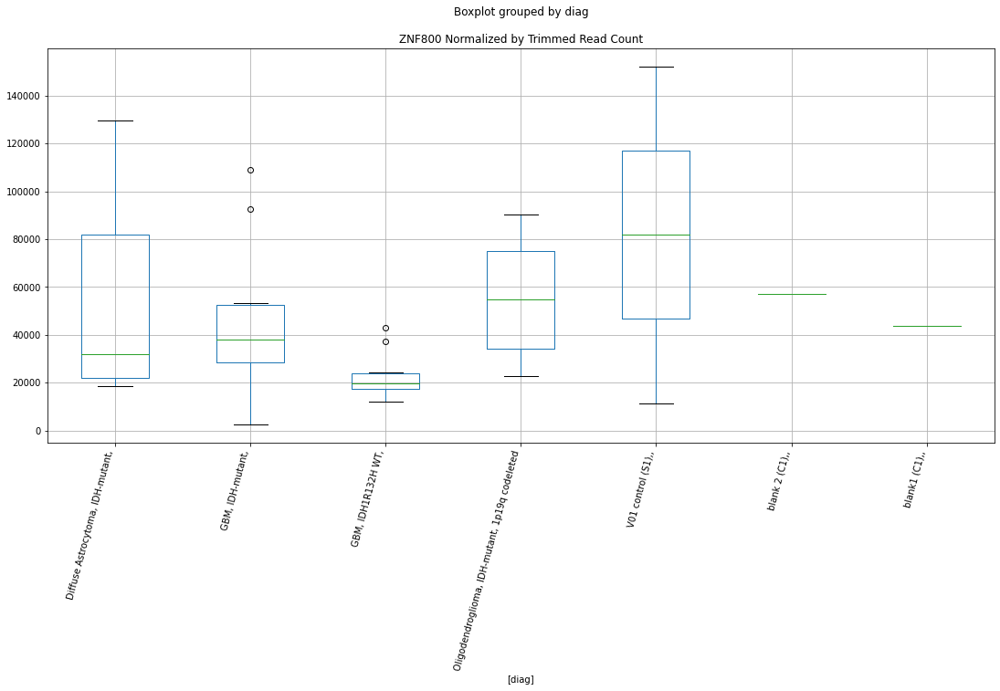

 p : 0.003806603085622255  ( t : 3.320321258304656 ) :  D-plex  :  bbduk2  :  MUC16
Control and blanks
73      10049.11
337    196724.76
Name: MUC16, dtype: float64
205    73248.2
Name: MUC16, dtype: float64
469    1.91e+06
Name: MUC16, dtype: float64


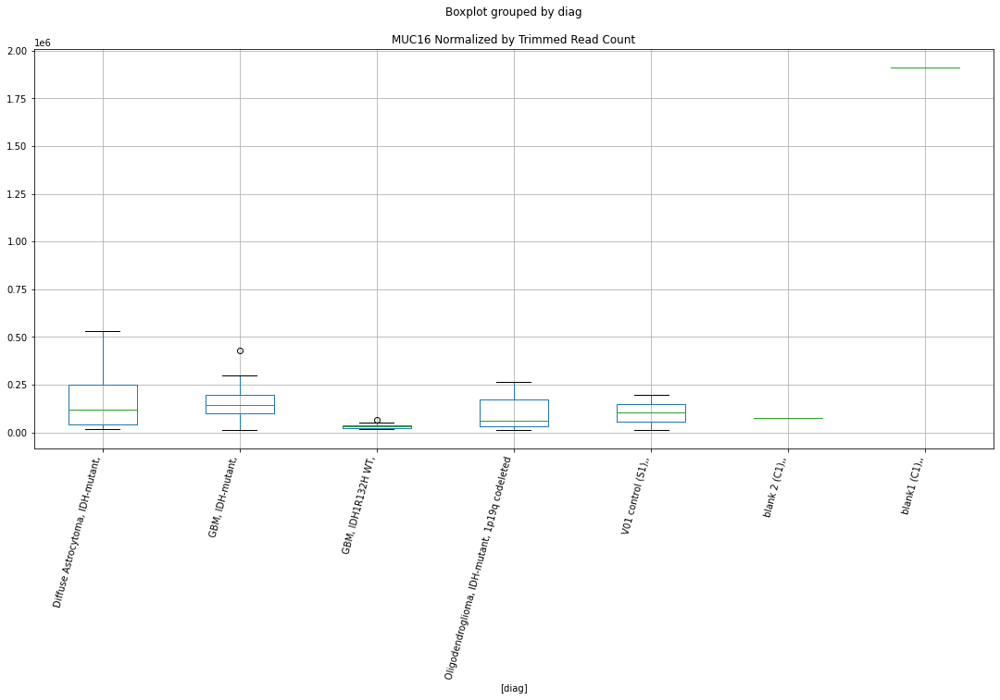

 p : 0.0038366048180519256  ( t : 3.3167670928105535 ) :  D-plex  :  bbduk2  :  TESK2
Control and blanks
73      97399.06
337    320456.62
Name: TESK2, dtype: float64
205    171569.13
Name: TESK2, dtype: float64
469    63884.95
Name: TESK2, dtype: float64


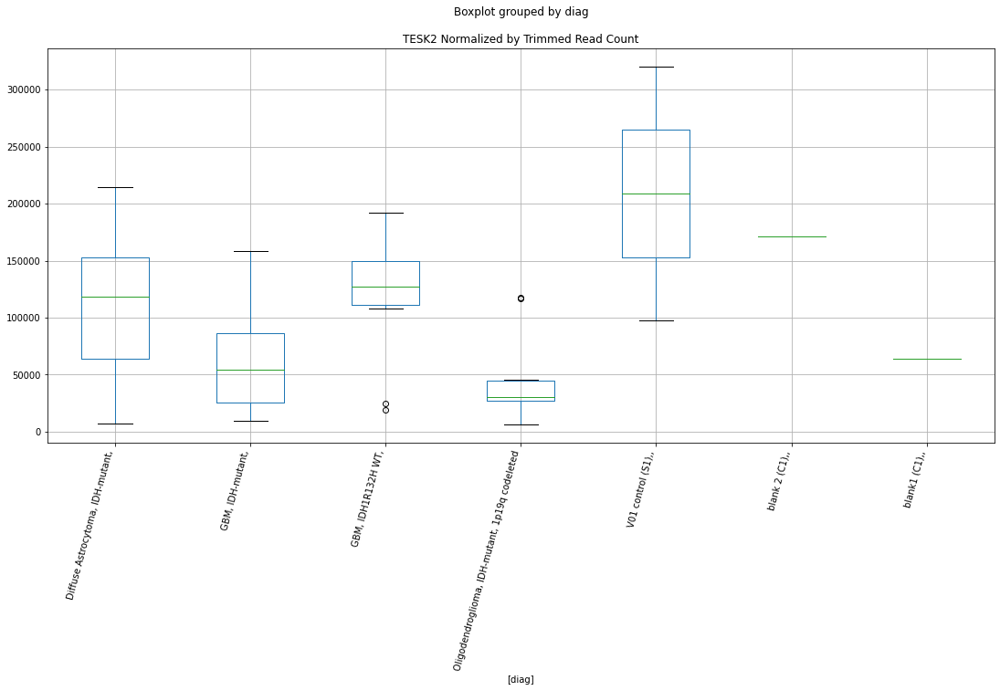

 p : 0.0039549354843494595  ( t : 3.303010609569249 ) :  Lexogen  :  bbduk2  :  IL17RB
Control and blanks
79          NaN
343    10191.09
Name: IL17RB, dtype: float64
211    9839.03
Name: IL17RB, dtype: float64
475    5748.38
Name: IL17RB, dtype: float64


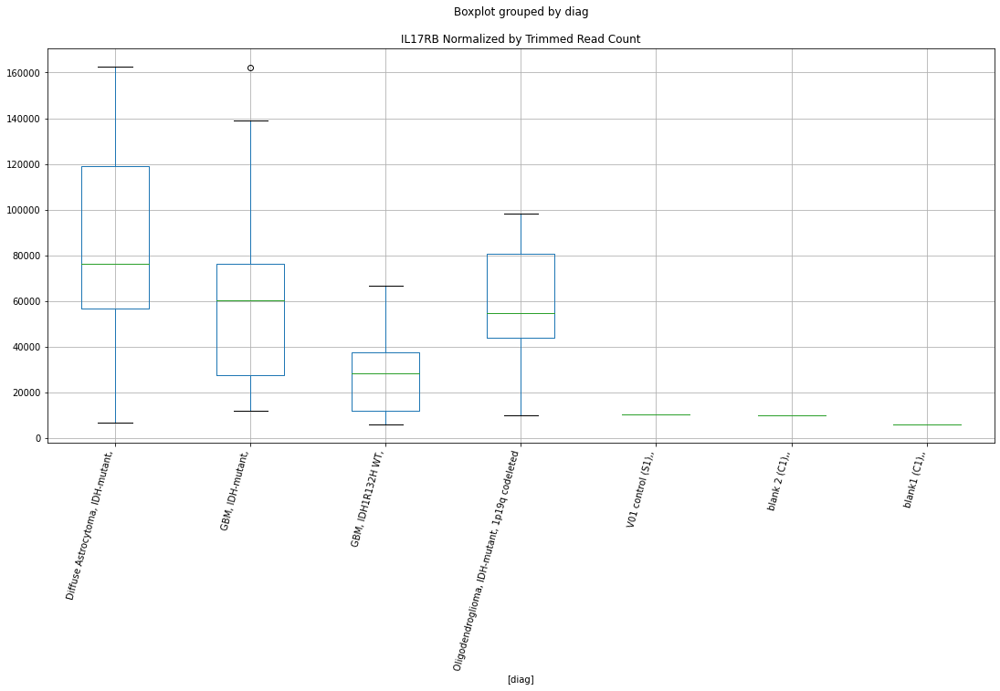

 p : 0.003993853049170482  ( t : 3.2985745977764824 ) :  D-plex  :  bbduk2  :  ZNF800
Control and blanks
73     136822.49
337     11572.04
Name: ZNF800, dtype: float64
205    43340.01
Name: ZNF800, dtype: float64
469    39632.33
Name: ZNF800, dtype: float64


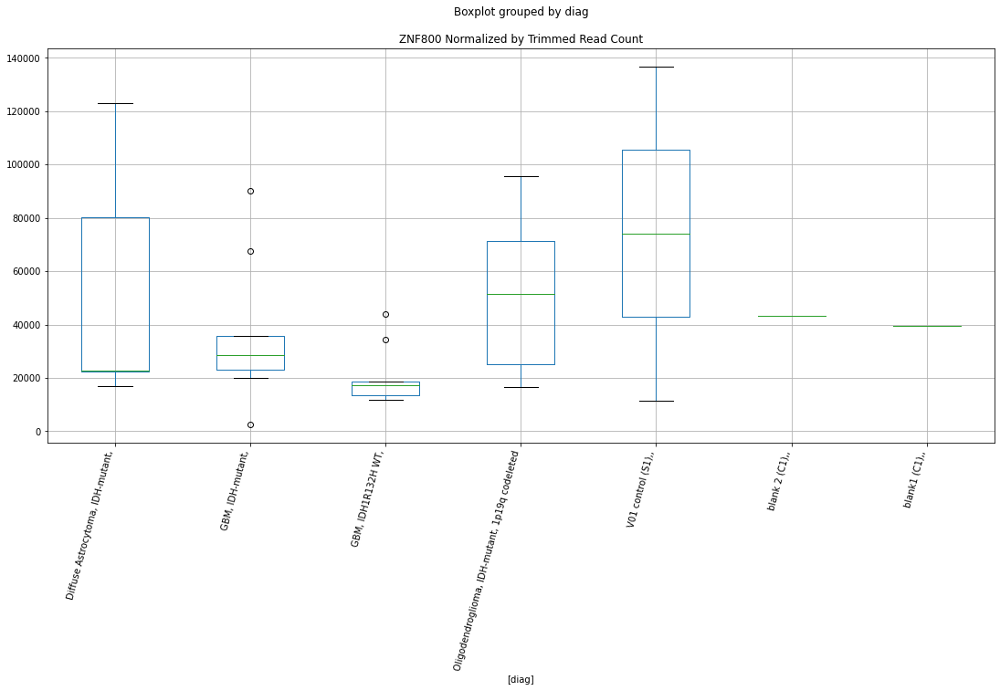

 p : 0.0041257199004476495  ( t : 3.283853475770231 ) :  D-plex  :  cutadapt2  :  TESK2
Control and blanks
76      95459.39
340    320586.50
Name: TESK2, dtype: float64
208    171422.13
Name: TESK2, dtype: float64
472    61263.32
Name: TESK2, dtype: float64


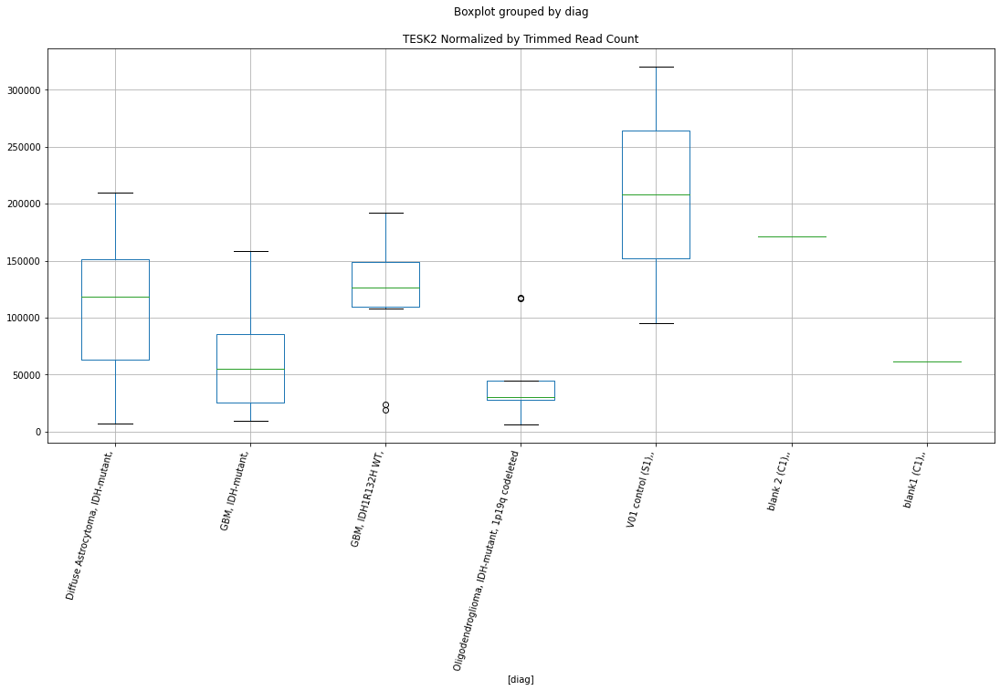

 p : 0.00527853251139948  ( t : 3.1718961585759344 ) :  D-plex  :  bbduk2  :  CORO1B
Control and blanks
73     25509.28
337    98807.46
Name: CORO1B, dtype: float64
205    31161.83
Name: CORO1B, dtype: float64
469    335987.52
Name: CORO1B, dtype: float64


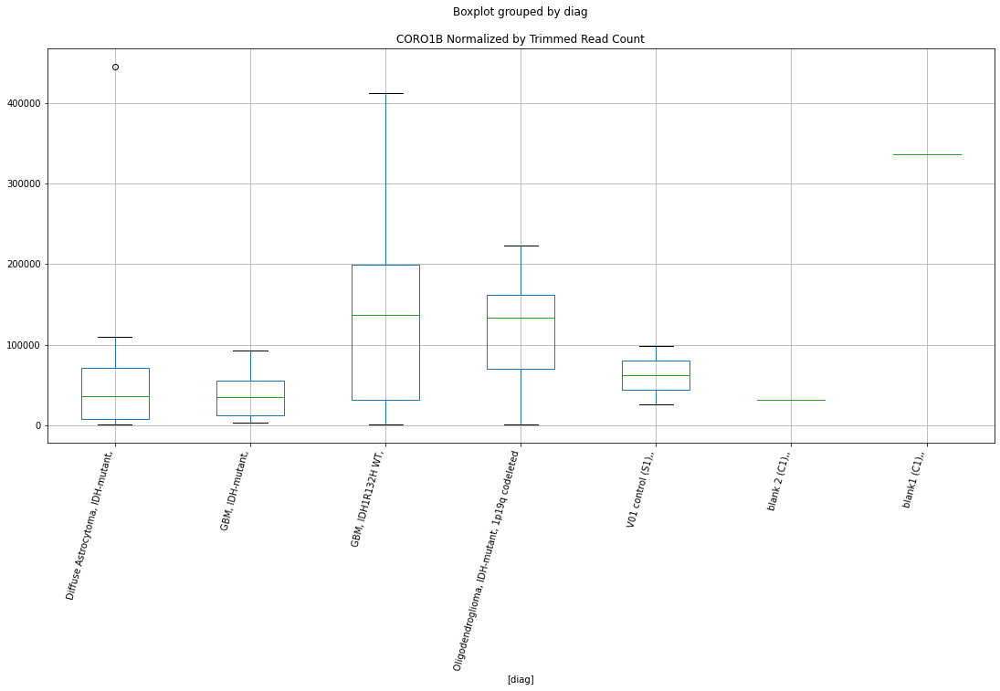

 p : 0.0053050434874177725  ( t : 3.1696140838157216 ) :  D-plex  :  cutadapt2  :  CORO1B
Control and blanks
76     20455.58
340    97761.27
Name: CORO1B, dtype: float64
208    30510.32
Name: CORO1B, dtype: float64
472    328856.87
Name: CORO1B, dtype: float64


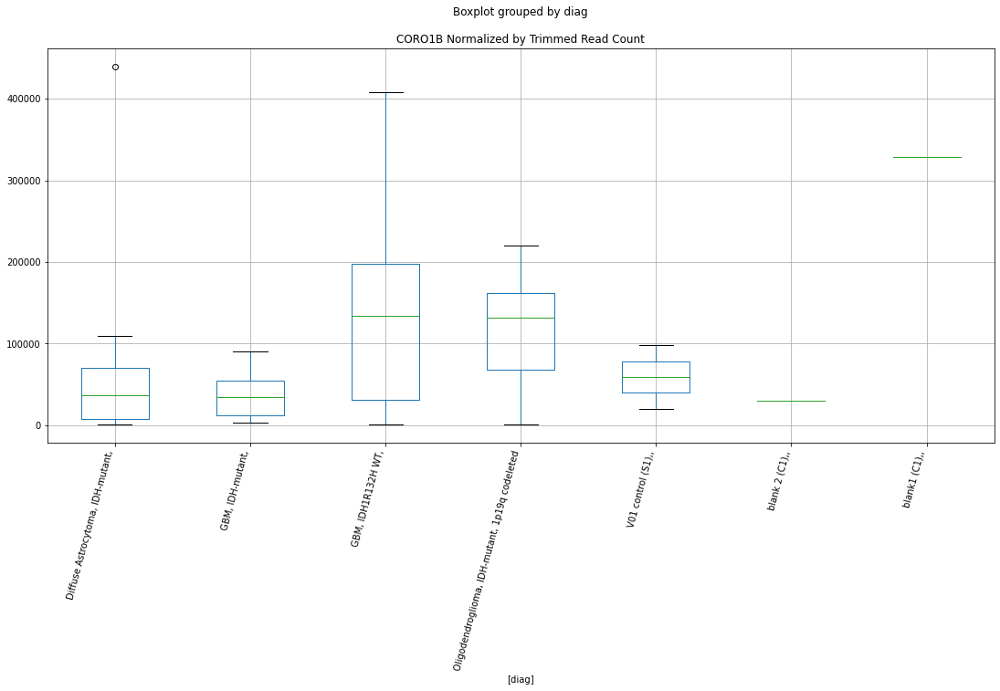

 p : 0.006560857278644601  ( t : 3.072589248015574 ) :  D-plex  :  cutadapt2  :  MUC16
Control and blanks
76       9848.98
340    160293.25
Name: MUC16, dtype: float64
208    61020.64
Name: MUC16, dtype: float64
472    1.86e+06
Name: MUC16, dtype: float64


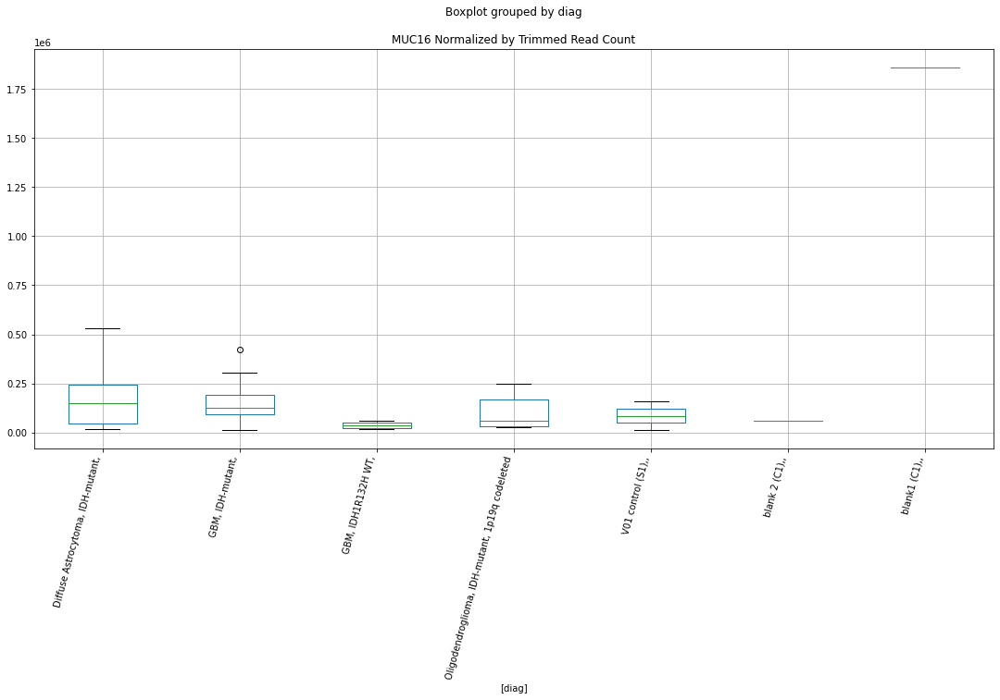

 p : 0.007565590163116123  ( t : 3.0072243810418713 ) :  D-plex  :  cutadapt2  :  GEMIN4
Control and blanks
76      6060.91
340    14091.71
Name: GEMIN4, dtype: float64
208    321151.96
Name: GEMIN4, dtype: float64
472    73978.35
Name: GEMIN4, dtype: float64


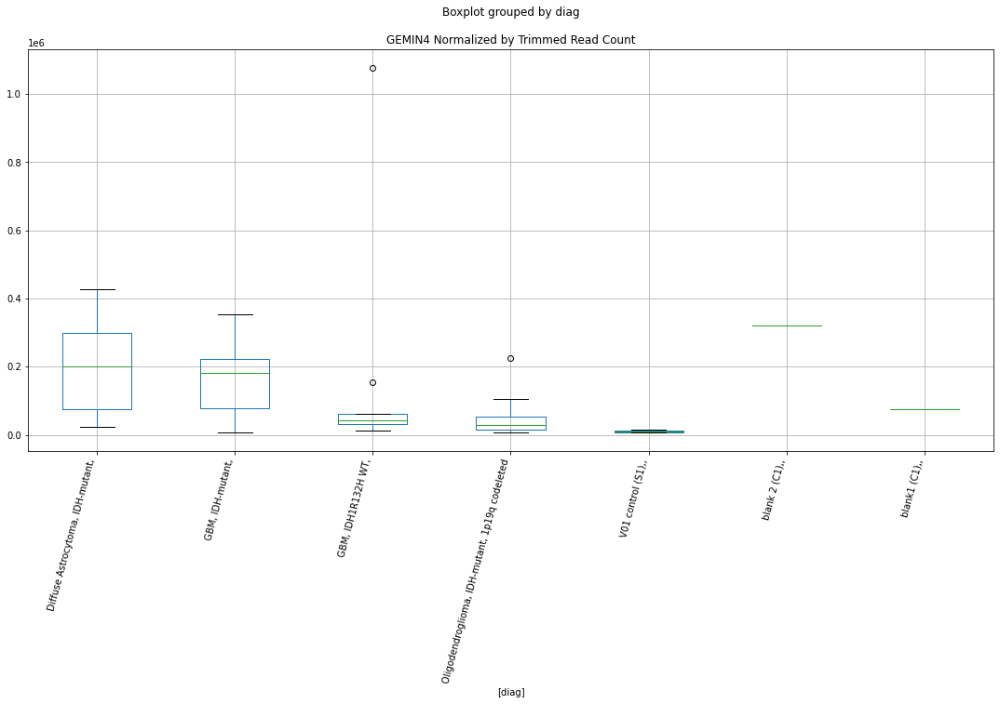

 p : 0.008290669422217536  ( t : 2.9651004348787233 ) :  Lexogen  :  bbduk2  :  LOC107986211
Control and blanks
79          NaN
343    38428.89
Name: LOC107986211, dtype: float64
211    12298.79
Name: LOC107986211, dtype: float64
475    239.52
Name: LOC107986211, dtype: float64


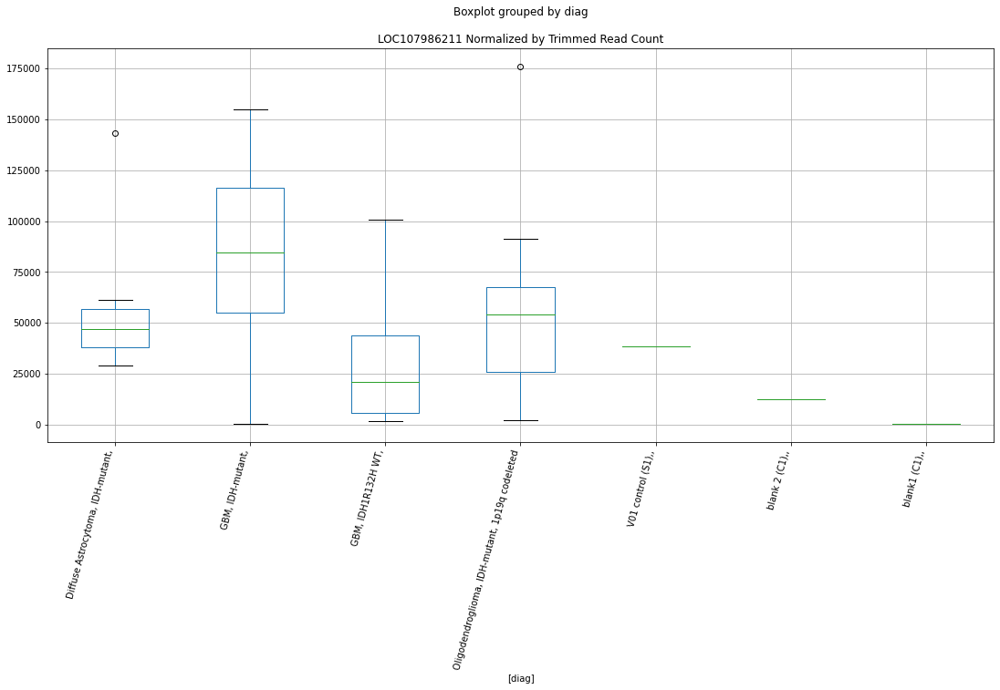

 p : 0.008406133511328294  ( t : 2.958724350053944 ) :  D-plex  :  bbduk2  :  GEMIN4
Control and blanks
73      6184.07
337    14242.52
Name: GEMIN4, dtype: float64
205    327557.35
Name: GEMIN4, dtype: float64
469    70983.28
Name: GEMIN4, dtype: float64


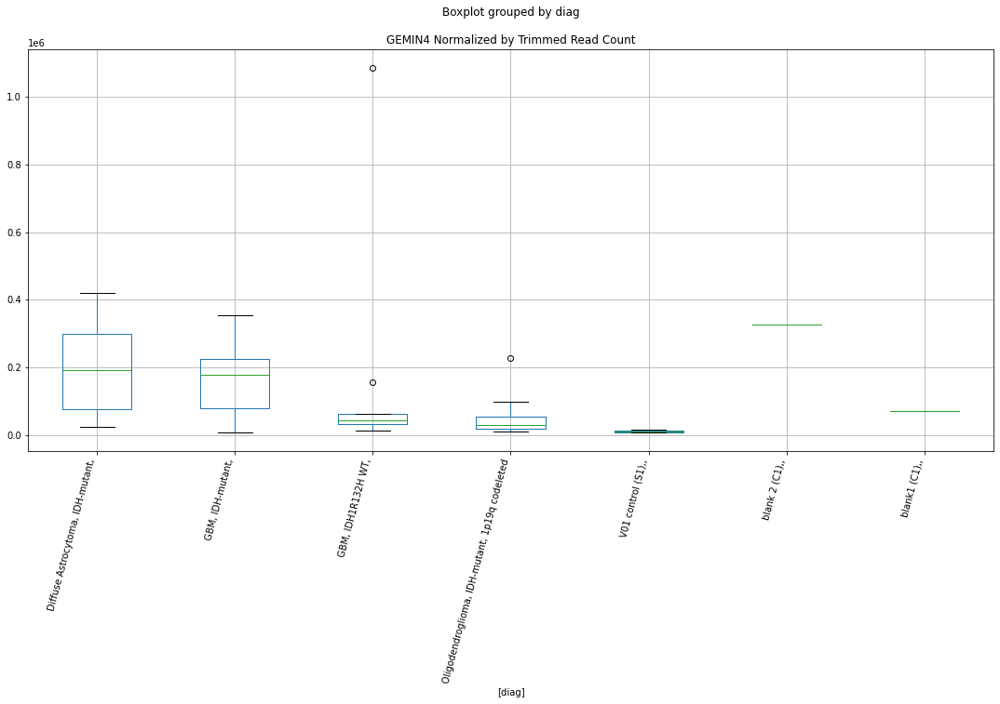

 p : 0.00852099075167219  ( t : 2.9524654122774168 ) :  Lexogen  :  cutadapt2  :  LOC107986211
Control and blanks
82          NaN
346    38088.65
Name: LOC107986211, dtype: float64
214    12205.19
Name: LOC107986211, dtype: float64
478    237.46
Name: LOC107986211, dtype: float64


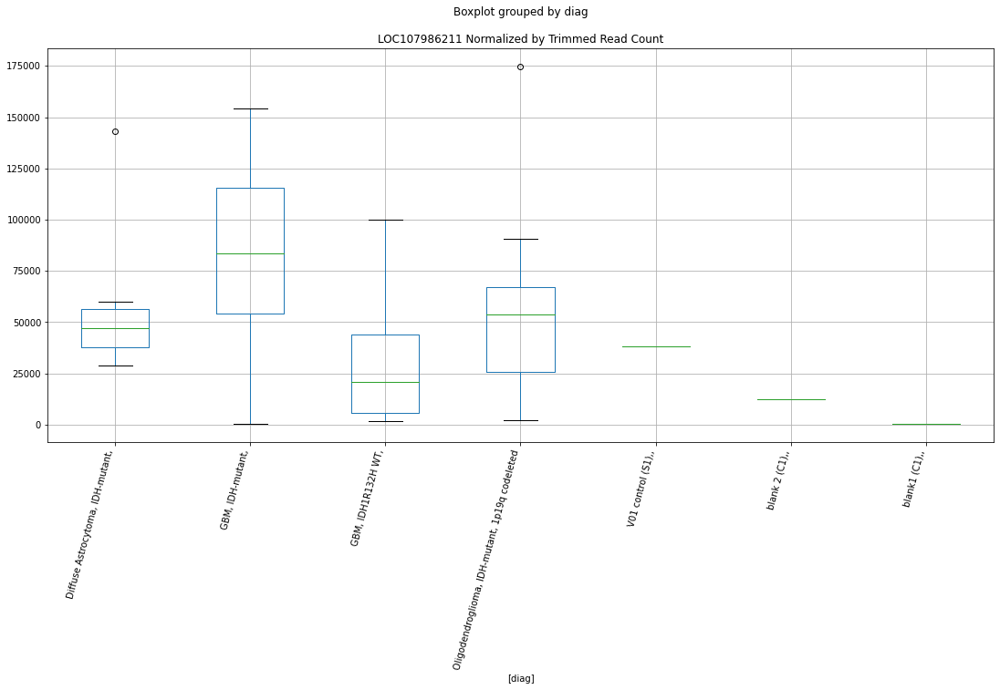

 p : 0.009153102738868673  ( t : 2.919417045135805 ) :  D-plex  :  bbduk2  :  CTXND1
Control and blanks
73     29374.32
337    18693.30
Name: CTXND1, dtype: float64
205    20774.55
Name: CTXND1, dtype: float64
469    29576.37
Name: CTXND1, dtype: float64


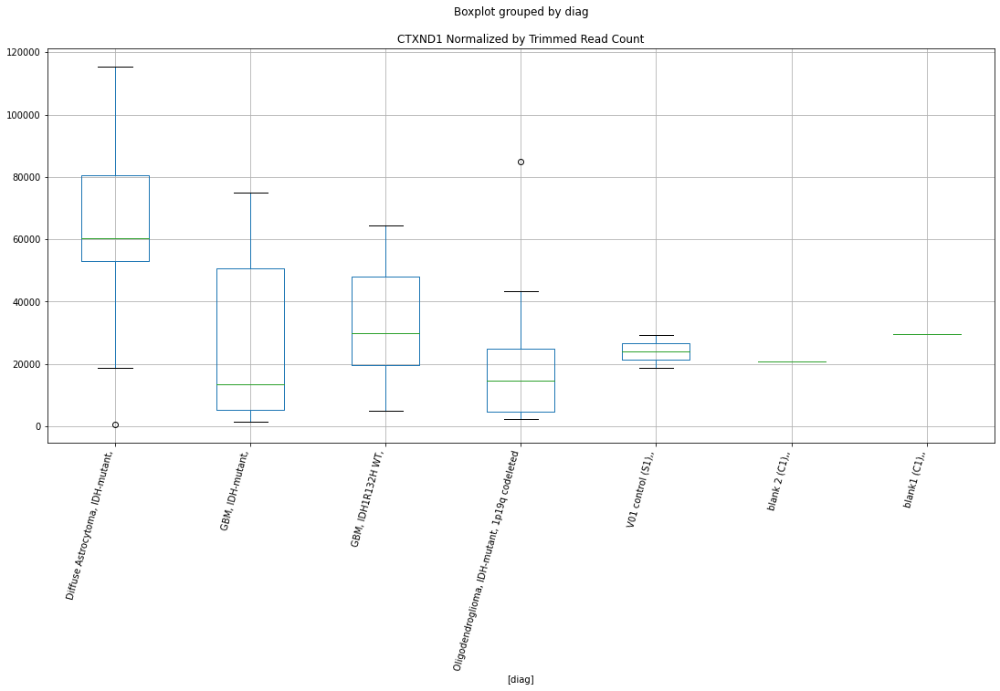

 p : 0.00947014062500278  ( t : 2.9036642813365185 ) :  Lexogen  :  cutadapt2  :  MIR10B
Control and blanks
82       1420.05
346    119947.68
Name: MIR10B, dtype: float64
214    5966.98
Name: MIR10B, dtype: float64
478    237.46
Name: MIR10B, dtype: float64


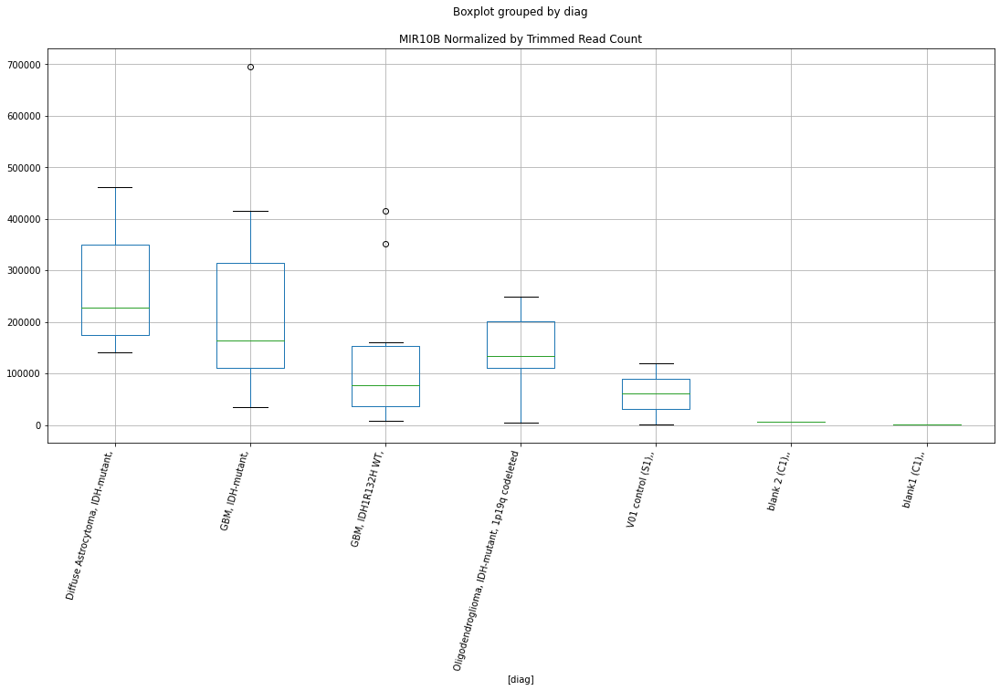

 p : 0.00952560236962854  ( t : 2.9009610173025577 ) :  Lexogen  :  bbduk2  :  MIR10B
Control and blanks
79       1430.60
343    121231.47
Name: MIR10B, dtype: float64
211    6012.74
Name: MIR10B, dtype: float64
475    239.52
Name: MIR10B, dtype: float64


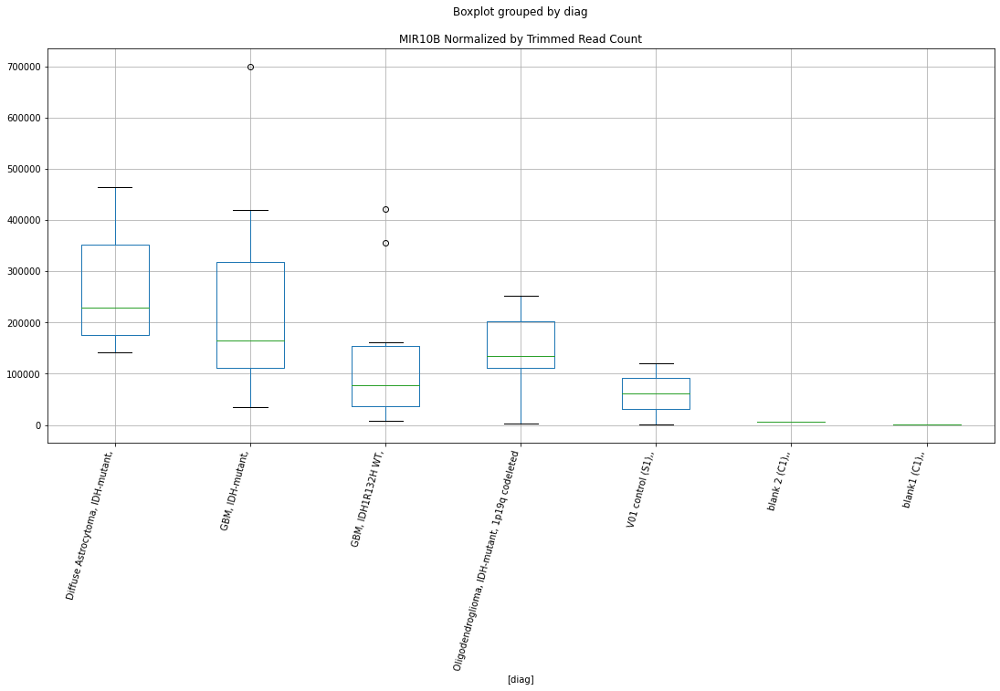

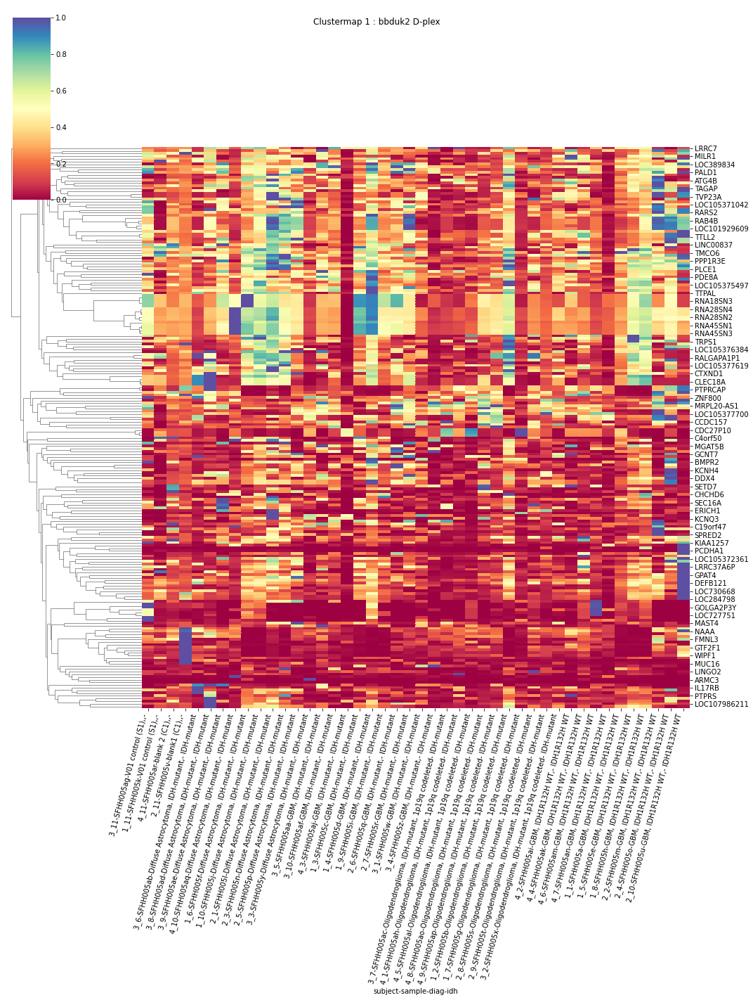

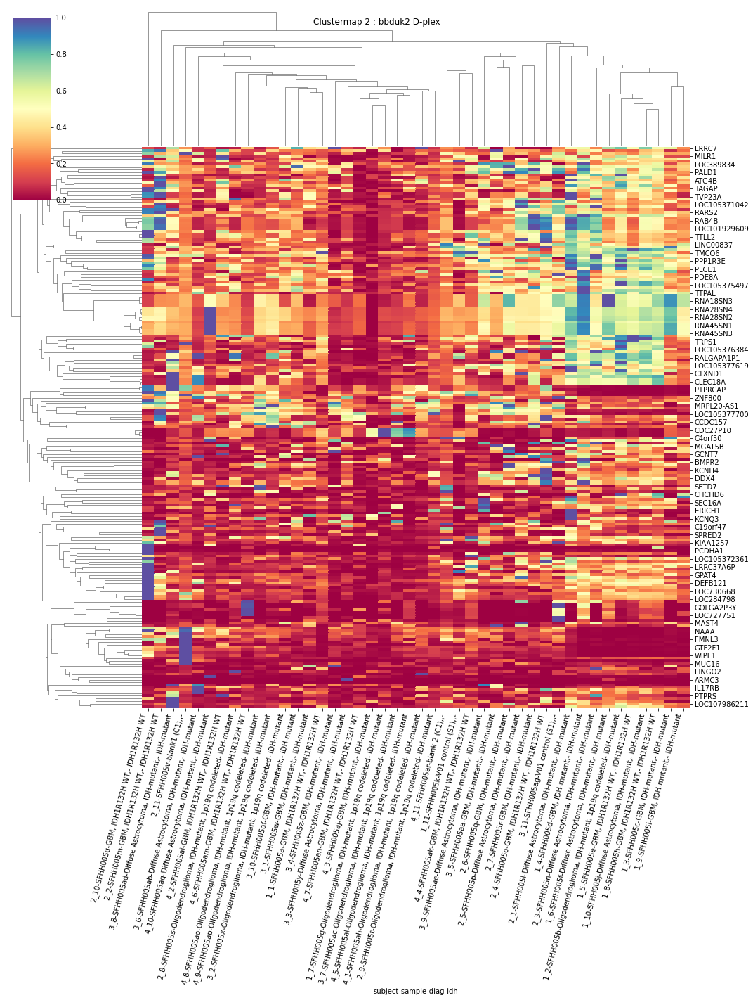

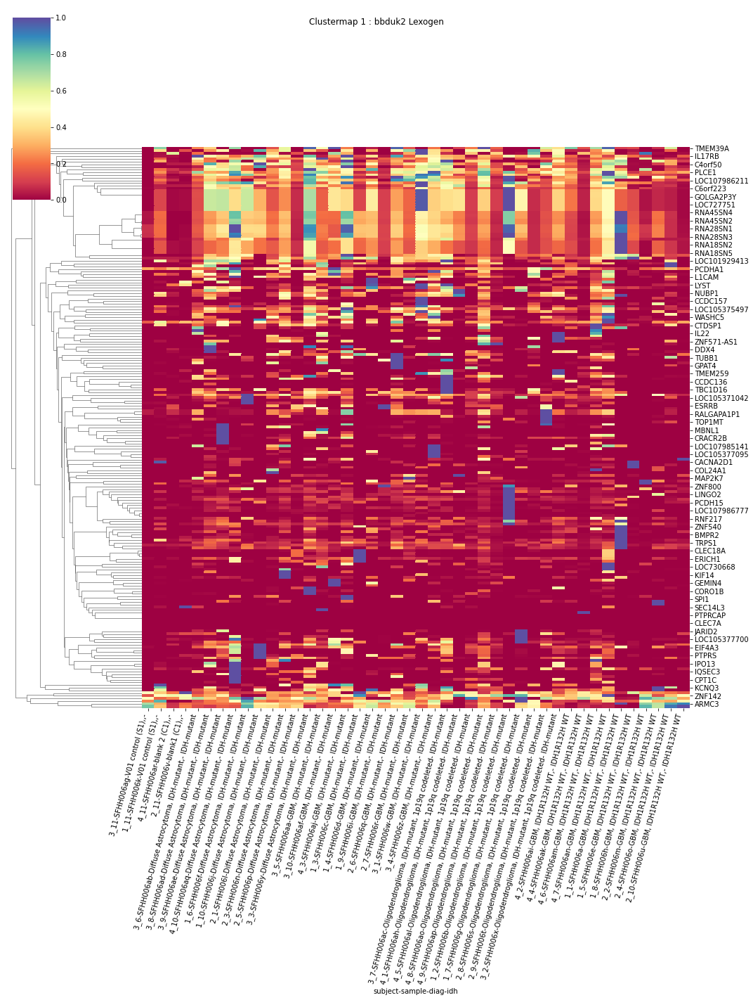

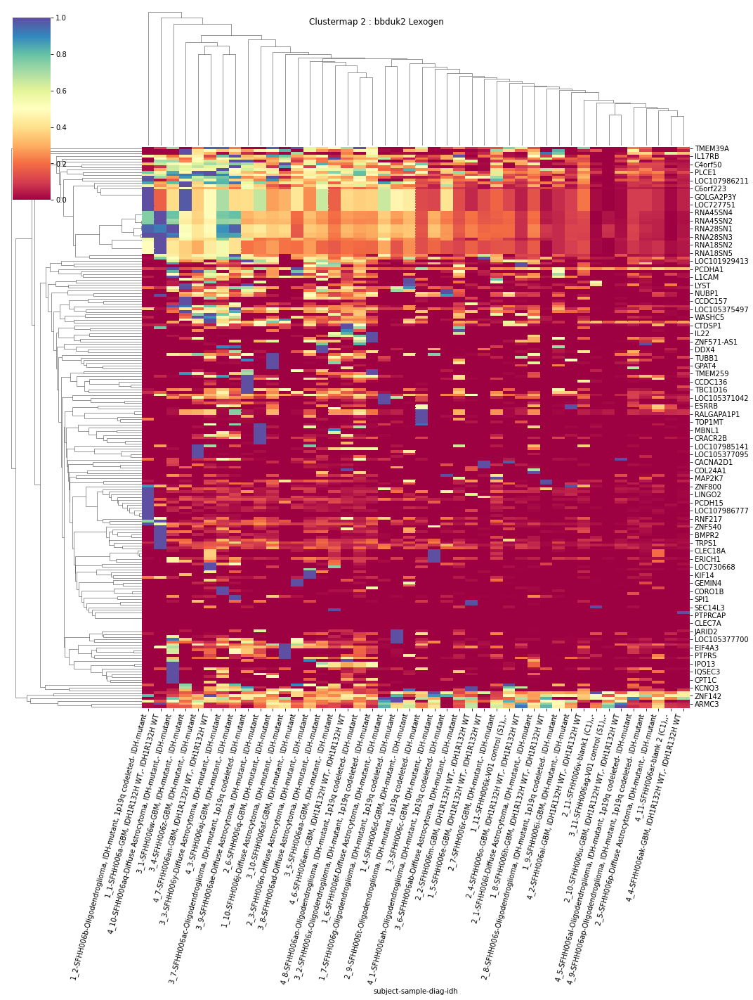

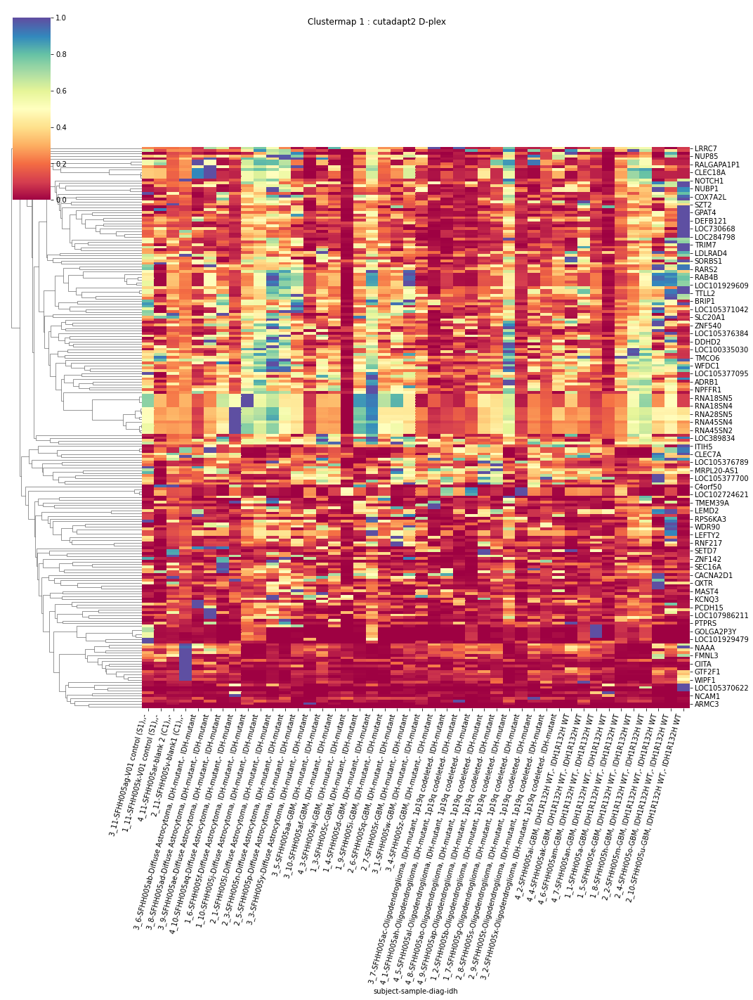

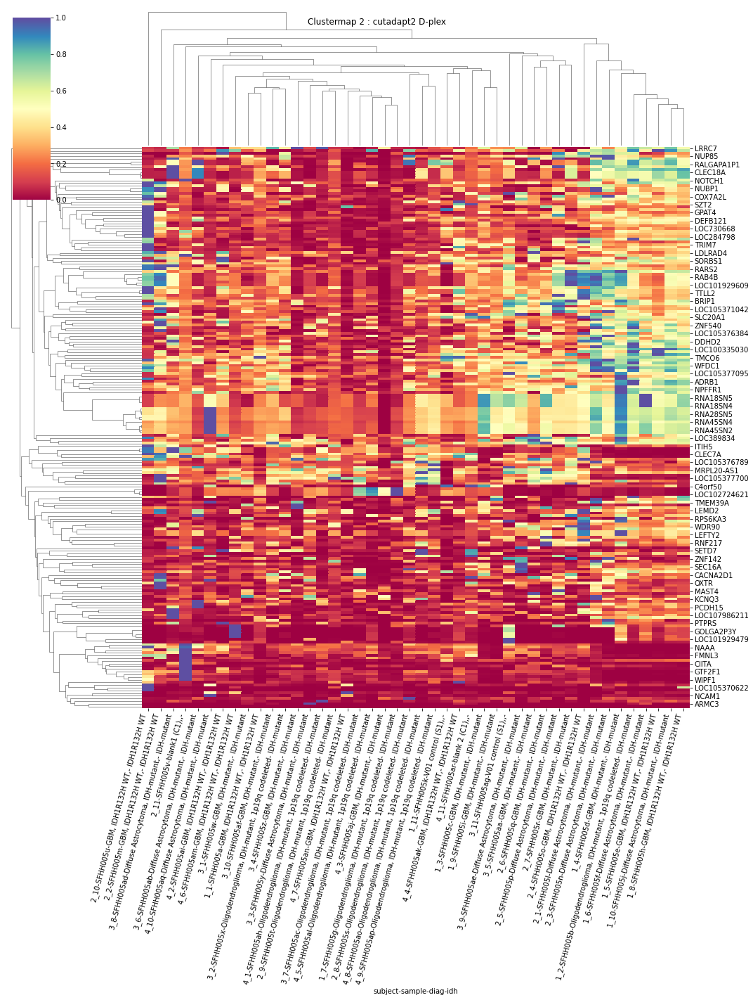

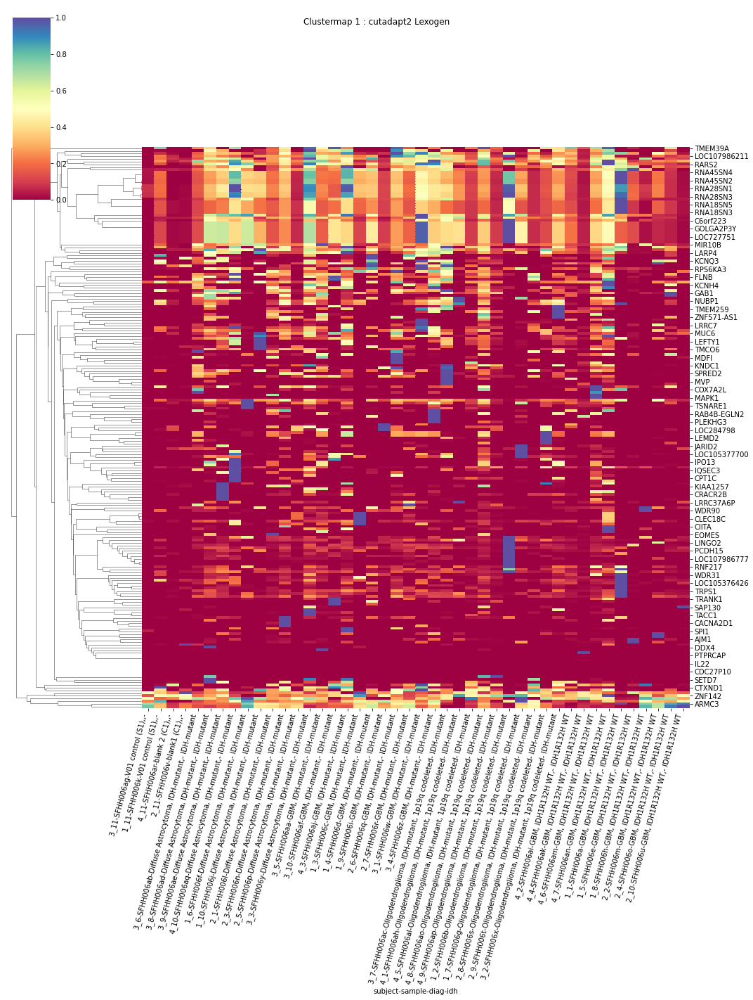

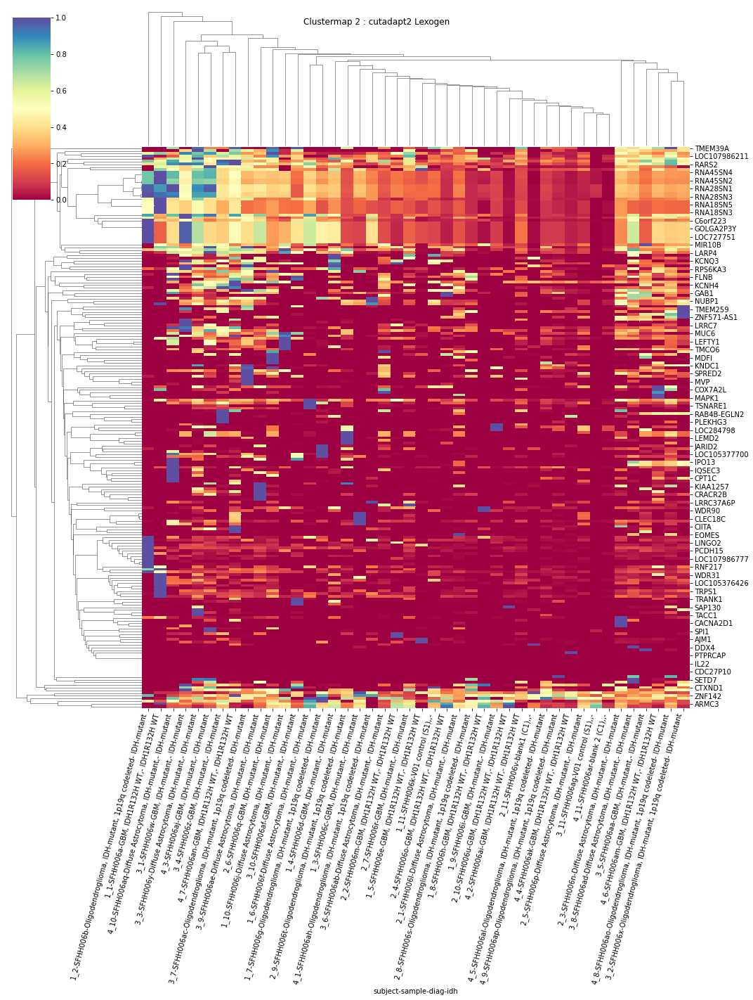

In [78]:
ttests_boxplots_and_heatmaps(dfn,genes)

In [79]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53']) #,box_p=0.2)

Not enough data to produce cluster maps


# miRNA

 p : 0.0004591611895880398  ( t : 4.271561802854335 ) :  D-plex  :  cutadapt2  :  hsa-mir-6771-hairpin
Control and blanks
76     29546.95
340    44036.61
Name: hsa-mir-6771-hairpin, dtype: float64
208    11992.49
Name: hsa-mir-6771-hairpin, dtype: float64
472    20806.41
Name: hsa-mir-6771-hairpin, dtype: float64


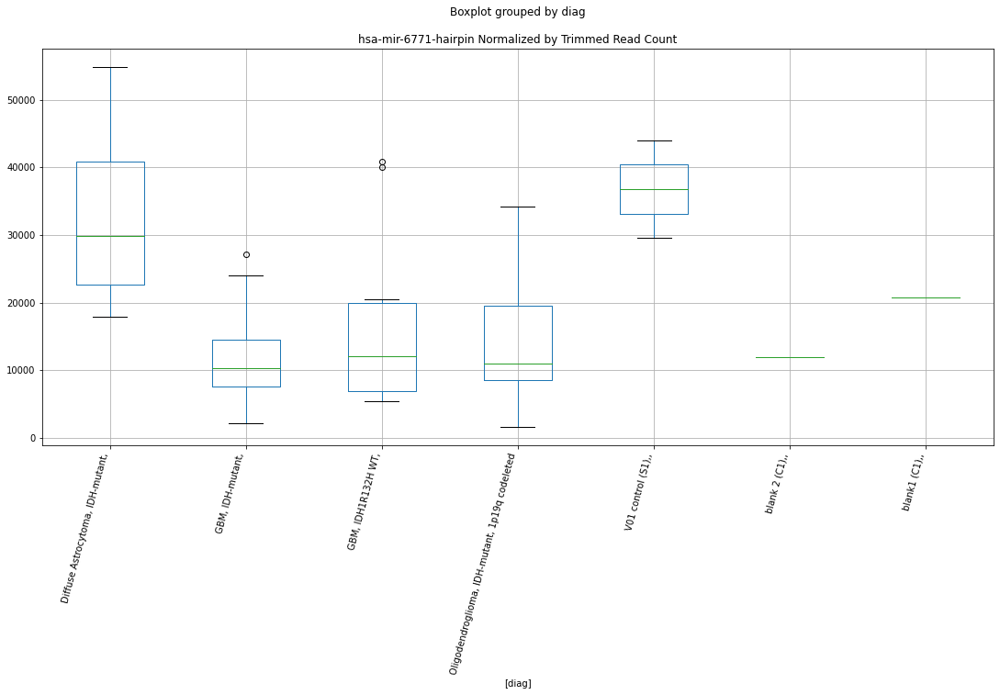

 p : 0.0004685727822030752  ( t : 4.262416314842988 ) :  D-plex  :  bbduk2  :  hsa-mir-6771-hairpin
Control and blanks
73     30147.33
337    44507.86
Name: hsa-mir-6771-hairpin, dtype: float64
205    11999.09
Name: hsa-mir-6771-hairpin, dtype: float64
469    20111.93
Name: hsa-mir-6771-hairpin, dtype: float64


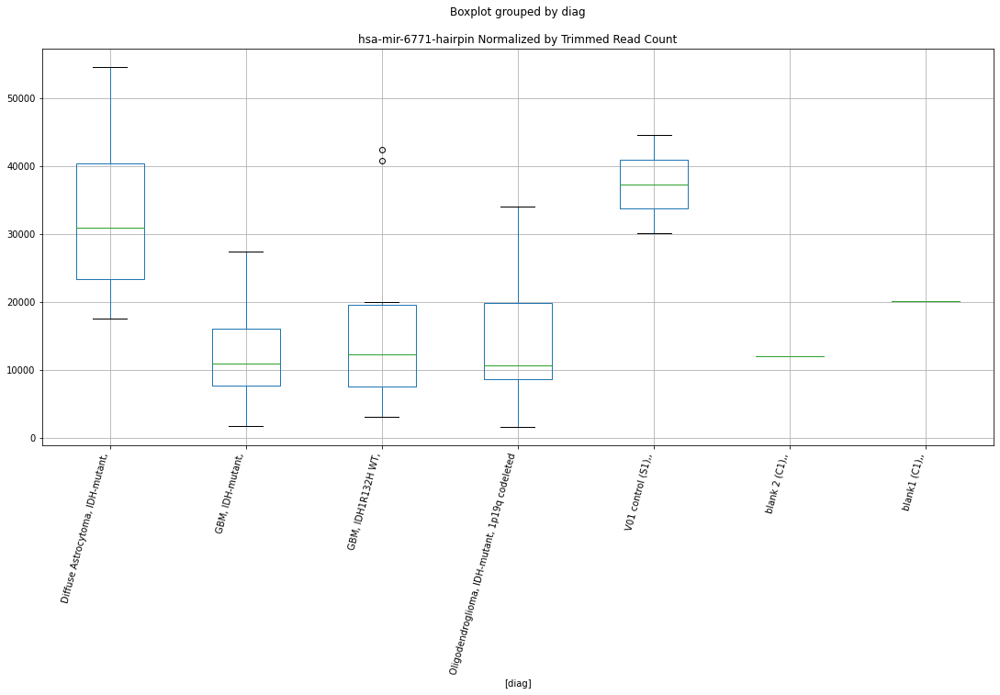

 p : 0.0007094052650137412  ( t : 4.075804404430772 ) :  D-plex  :  cutadapt2  :  hsa-mir-1343-5p-mature
Control and blanks
76     5303.3
340    2642.2
Name: hsa-mir-1343-5p-mature, dtype: float64
208    20810.51
Name: hsa-mir-1343-5p-mature, dtype: float64
472    11559.12
Name: hsa-mir-1343-5p-mature, dtype: float64


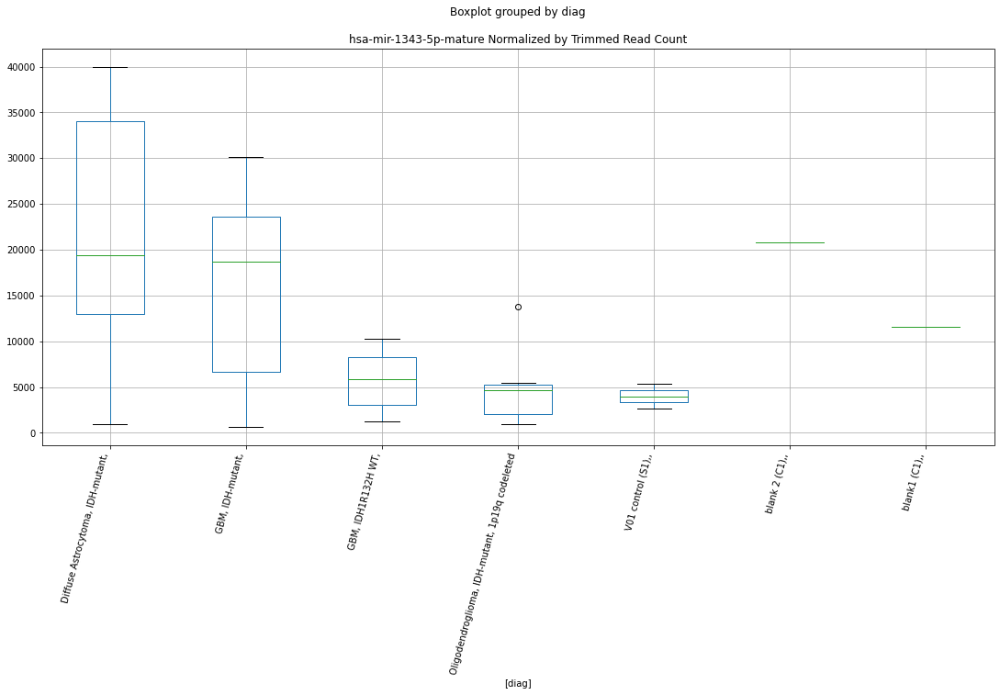

 p : 0.0007211752613799888  ( t : 4.0684108284854235 ) :  D-plex  :  cutadapt2  :  hsa-mir-4436a-hairpin
Control and blanks
76     4545.69
340    9688.05
Name: hsa-mir-4436a-hairpin, dtype: float64
208    7936.21
Name: hsa-mir-4436a-hairpin, dtype: float64
472    14448.9
Name: hsa-mir-4436a-hairpin, dtype: float64


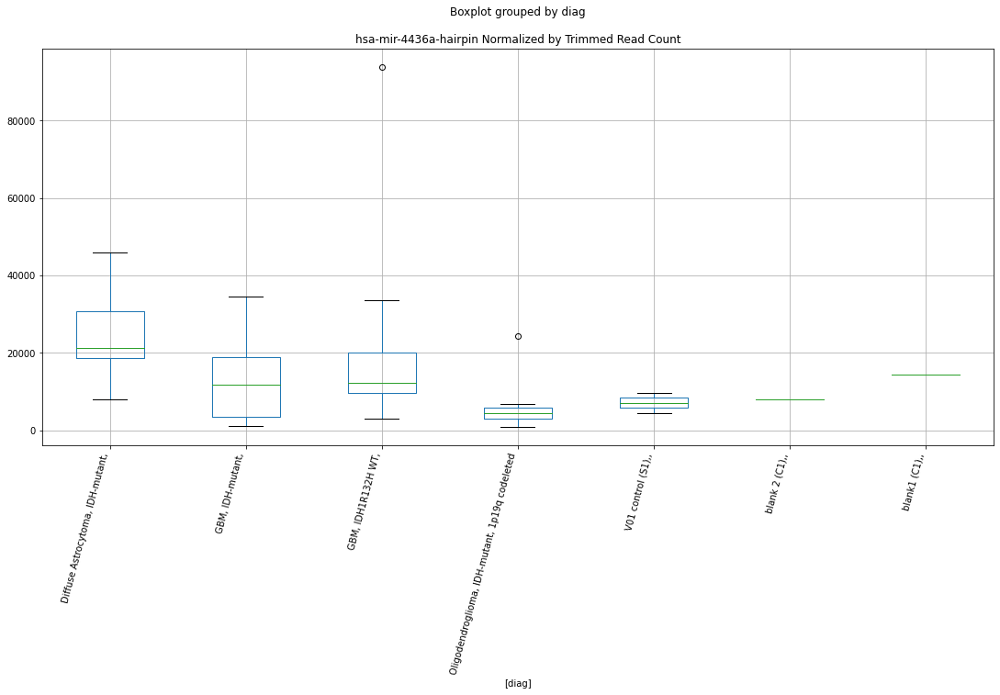

 p : 0.0011405888286168888  ( t : 3.8626162248584666 ) :  D-plex  :  bbduk2  :  hsa-mir-155-hairpin
Control and blanks
73     89668.97
337     2670.47
Name: hsa-mir-155-hairpin, dtype: float64
205    20595.46
Name: hsa-mir-155-hairpin, dtype: float64
469    30759.42
Name: hsa-mir-155-hairpin, dtype: float64


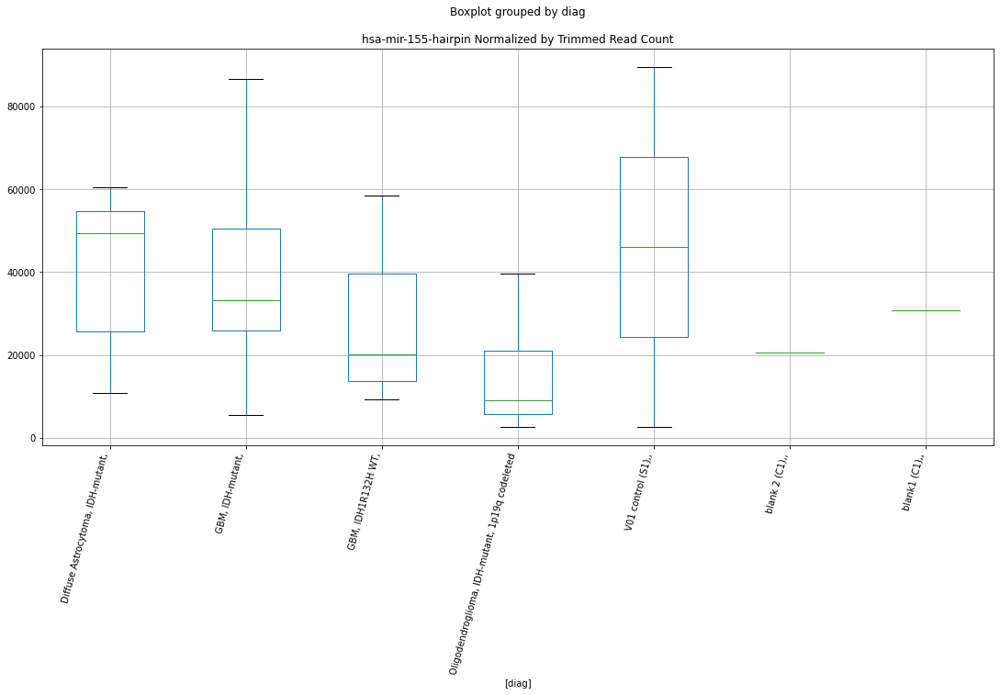

 p : 0.0011765683338475531  ( t : 3.8486802975494823 ) :  D-plex  :  cutadapt2  :  hsa-mir-1343-5p-mature
Control and blanks
76     5303.3
340    2642.2
Name: hsa-mir-1343-5p-mature, dtype: float64
208    20810.51
Name: hsa-mir-1343-5p-mature, dtype: float64
472    11559.12
Name: hsa-mir-1343-5p-mature, dtype: float64


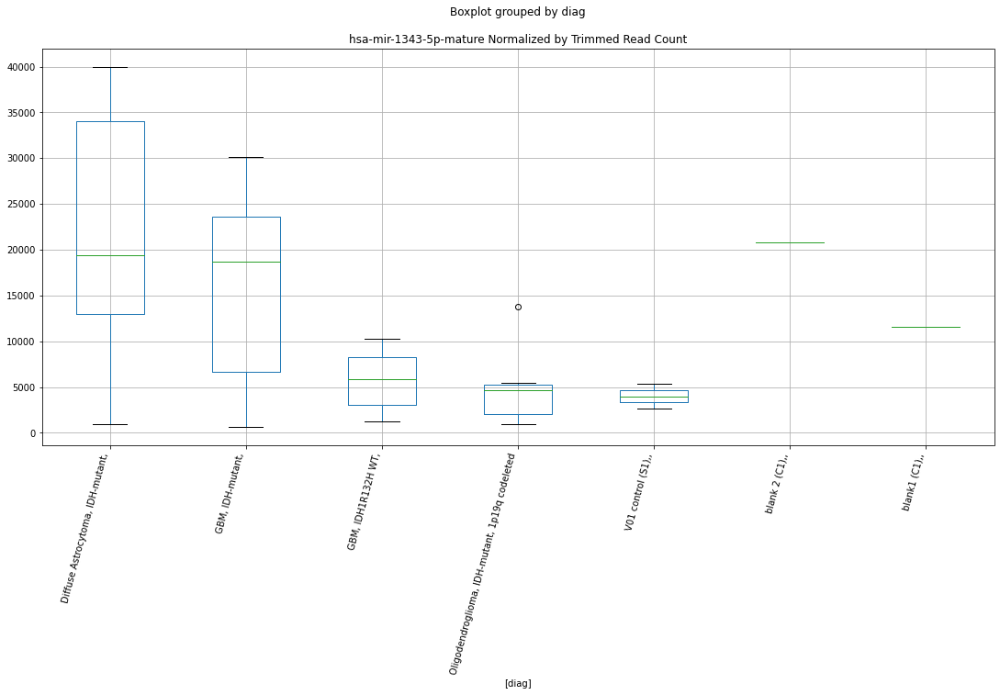

 p : 0.0011871138993874118  ( t : 3.8446763881884656 ) :  D-plex  :  cutadapt2  :  hsa-mir-9-1-hairpin
Control and blanks
76     115157.36
340    143559.34
Name: hsa-mir-9-1-hairpin, dtype: float64
208    87121.95
Name: hsa-mir-9-1-hairpin, dtype: float64
472    41034.86
Name: hsa-mir-9-1-hairpin, dtype: float64


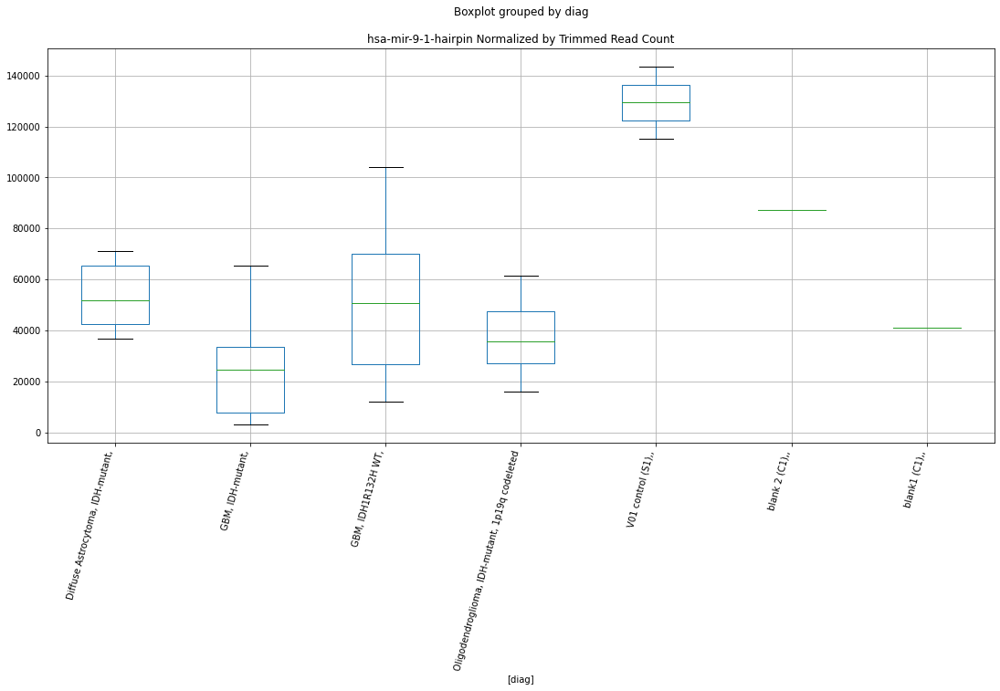

 p : 0.0013240533965704398  ( t : 3.795687545096537 ) :  D-plex  :  bbduk2  :  hsa-mir-4436a-hairpin
Control and blanks
73     4638.05
337    9791.73
Name: hsa-mir-4436a-hairpin, dtype: float64
205    8954.55
Name: hsa-mir-4436a-hairpin, dtype: float64
469    15379.71
Name: hsa-mir-4436a-hairpin, dtype: float64


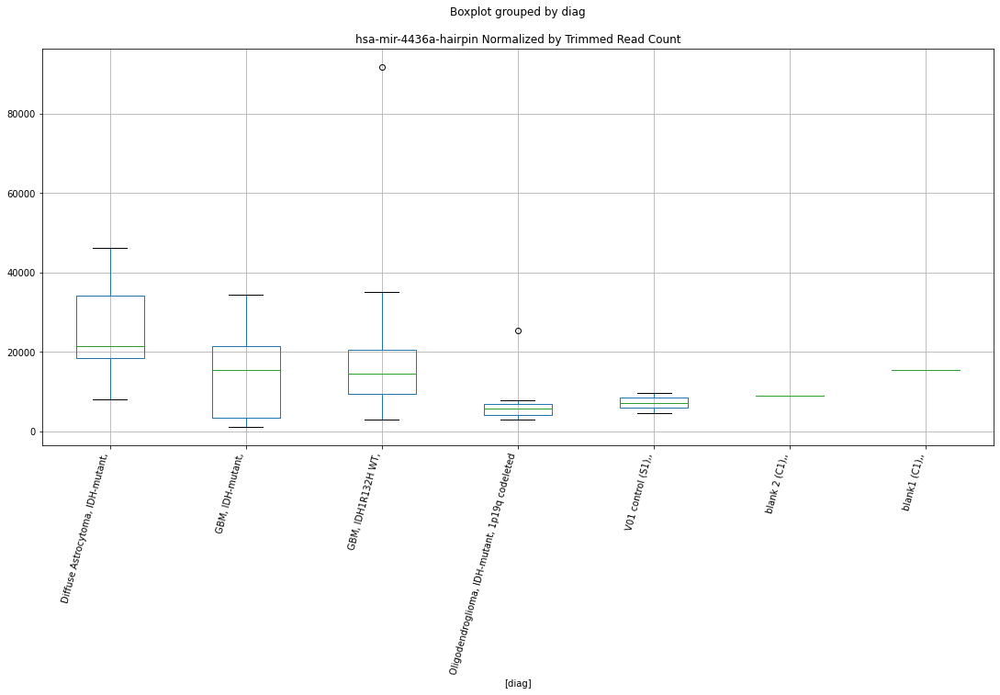

 p : 0.0014144847751123197  ( t : 3.766038076207558 ) :  D-plex  :  bbduk2  :  hsa-mir-6771-hairpin
Control and blanks
73     30147.33
337    44507.86
Name: hsa-mir-6771-hairpin, dtype: float64
205    11999.09
Name: hsa-mir-6771-hairpin, dtype: float64
469    20111.93
Name: hsa-mir-6771-hairpin, dtype: float64


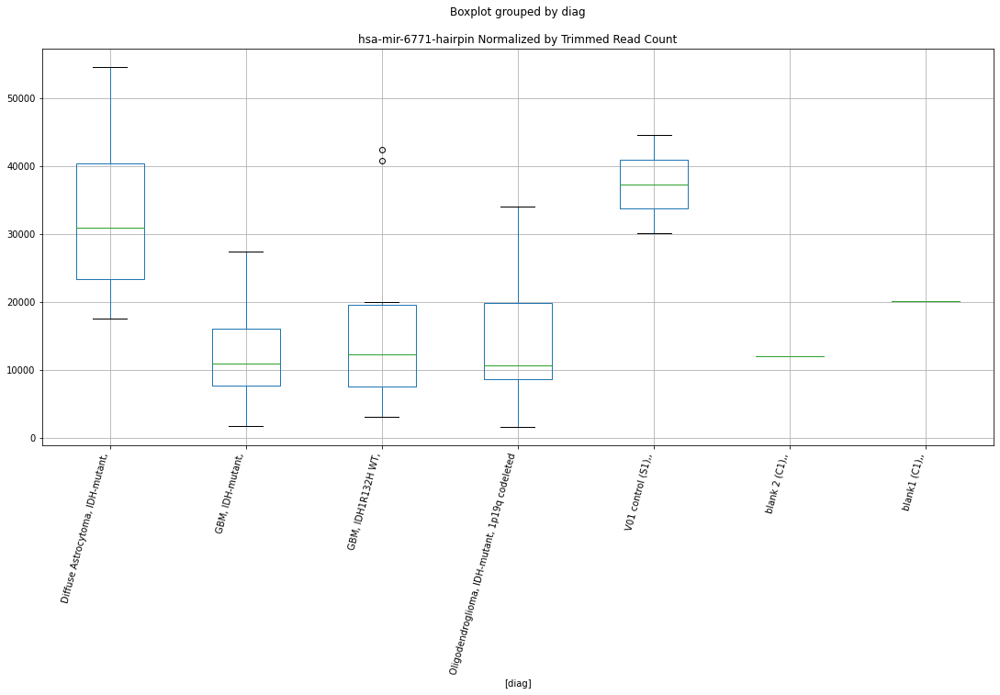

 p : 0.0015095008157605299  ( t : 3.7368574720682837 ) :  D-plex  :  cutadapt2  :  hsa-mir-155-hairpin
Control and blanks
76     87883.25
340     2642.20
Name: hsa-mir-155-hairpin, dtype: float64
208    19752.34
Name: hsa-mir-155-hairpin, dtype: float64
472    29475.75
Name: hsa-mir-155-hairpin, dtype: float64


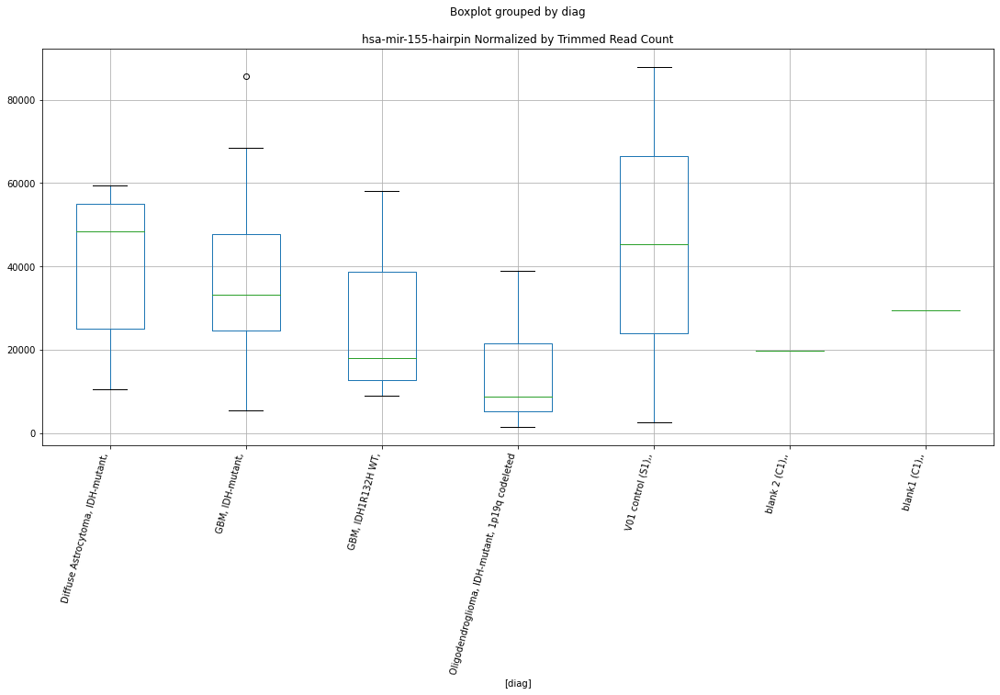

 p : 0.0015790594962966434  ( t : 3.716633964294697 ) :  D-plex  :  cutadapt2  :  hsa-mir-6771-hairpin
Control and blanks
76     29546.95
340    44036.61
Name: hsa-mir-6771-hairpin, dtype: float64
208    11992.49
Name: hsa-mir-6771-hairpin, dtype: float64
472    20806.41
Name: hsa-mir-6771-hairpin, dtype: float64


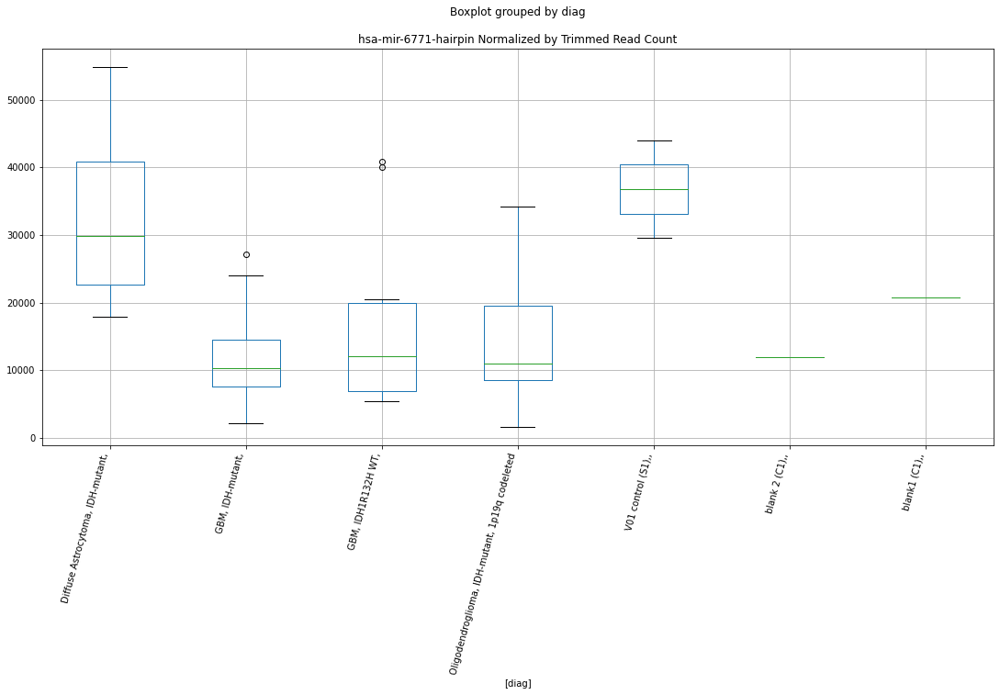

 p : 0.0016268400849200767  ( t : 3.7032502340848295 ) :  D-plex  :  cutadapt2  :  hsa-mir-320a-hairpin
Control and blanks
76     48487.31
340    36990.75
Name: hsa-mir-320a-hairpin, dtype: float64
208    24161.35
Name: hsa-mir-320a-hairpin, dtype: float64
472    30631.66
Name: hsa-mir-320a-hairpin, dtype: float64


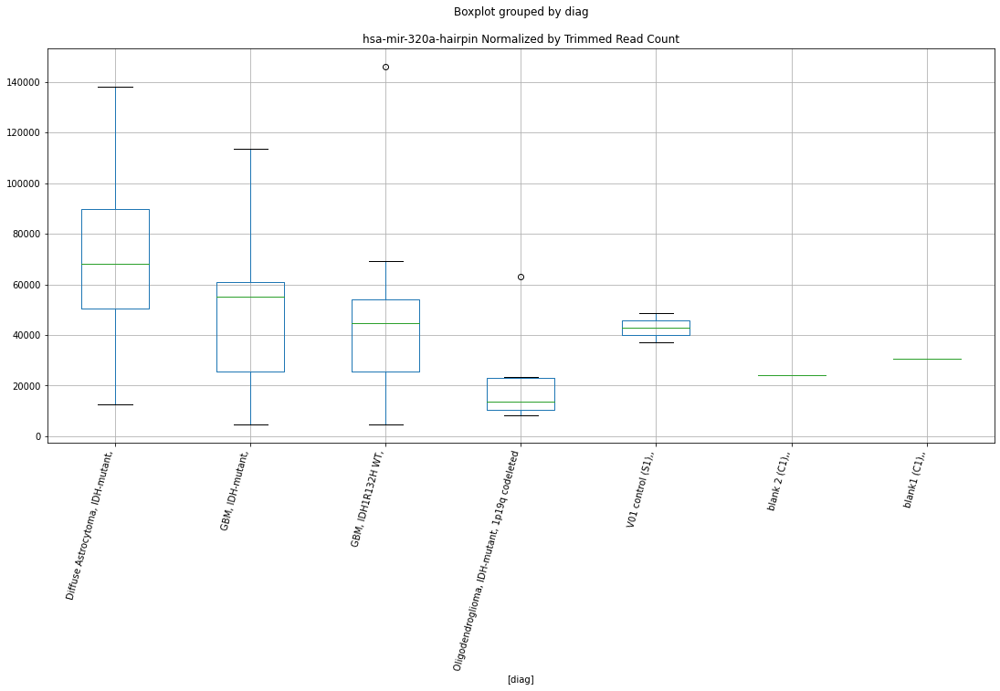

 p : 0.0017077385664893158  ( t : 3.681458339694662 ) :  D-plex  :  cutadapt2  :  hsa-mir-320e-hairpin
Control and blanks
76     78791.88
340    16733.91
Name: hsa-mir-320e-hairpin, dtype: float64
208    67016.88
Name: hsa-mir-320e-hairpin, dtype: float64
472    24852.1
Name: hsa-mir-320e-hairpin, dtype: float64


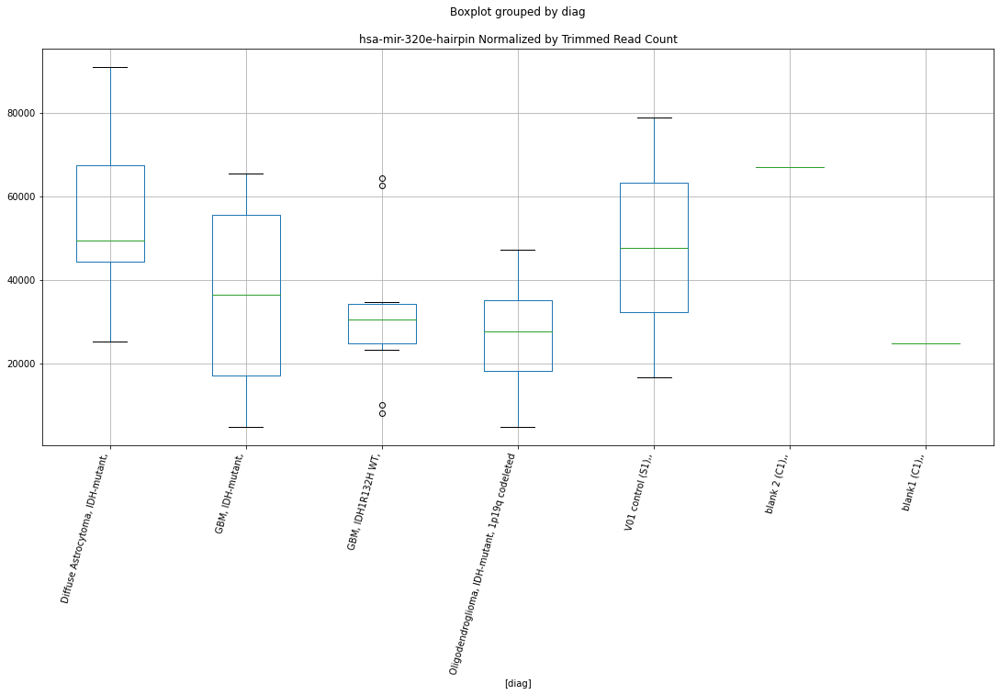

 p : 0.001739022462807183  ( t : 3.6733057655221018 ) :  D-plex  :  bbduk2  :  hsa-mir-764-hairpin
Control and blanks
73      3092.03
337    35606.29
Name: hsa-mir-764-hairpin, dtype: float64
205    15760.0
Name: hsa-mir-764-hairpin, dtype: float64
469    18928.87
Name: hsa-mir-764-hairpin, dtype: float64


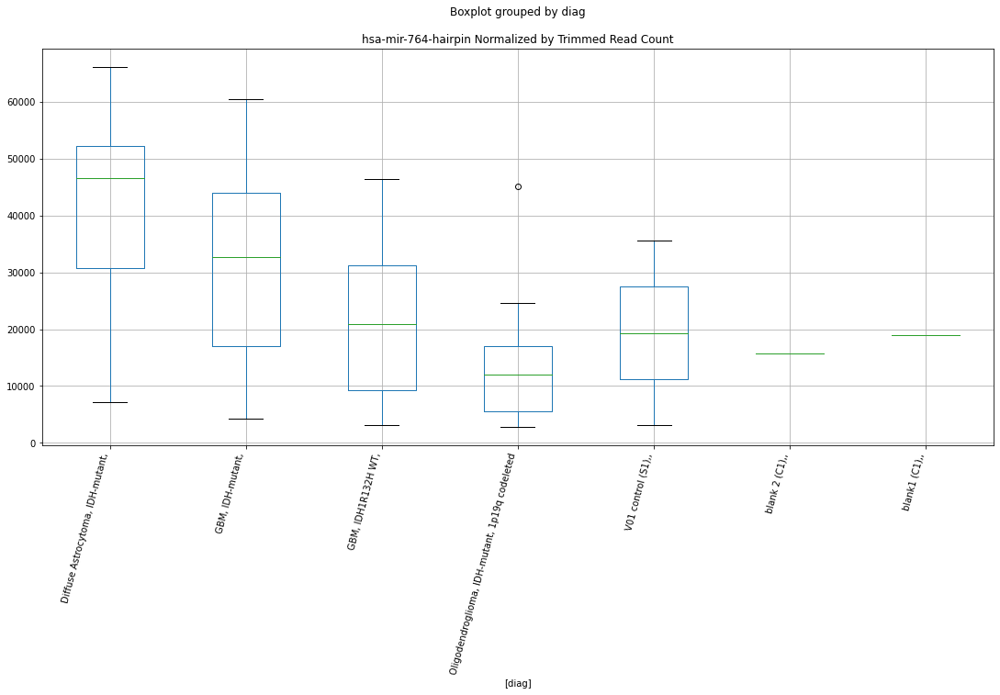

 p : 0.0018431915576905171  ( t : 3.647174306238617 ) :  D-plex  :  cutadapt2  :  hsa-mir-3059-hairpin
Control and blanks
76     179554.57
340     85431.02
Name: hsa-mir-3059-hairpin, dtype: float64
208    159429.64
Name: hsa-mir-3059-hairpin, dtype: float64
472    107499.79
Name: hsa-mir-3059-hairpin, dtype: float64


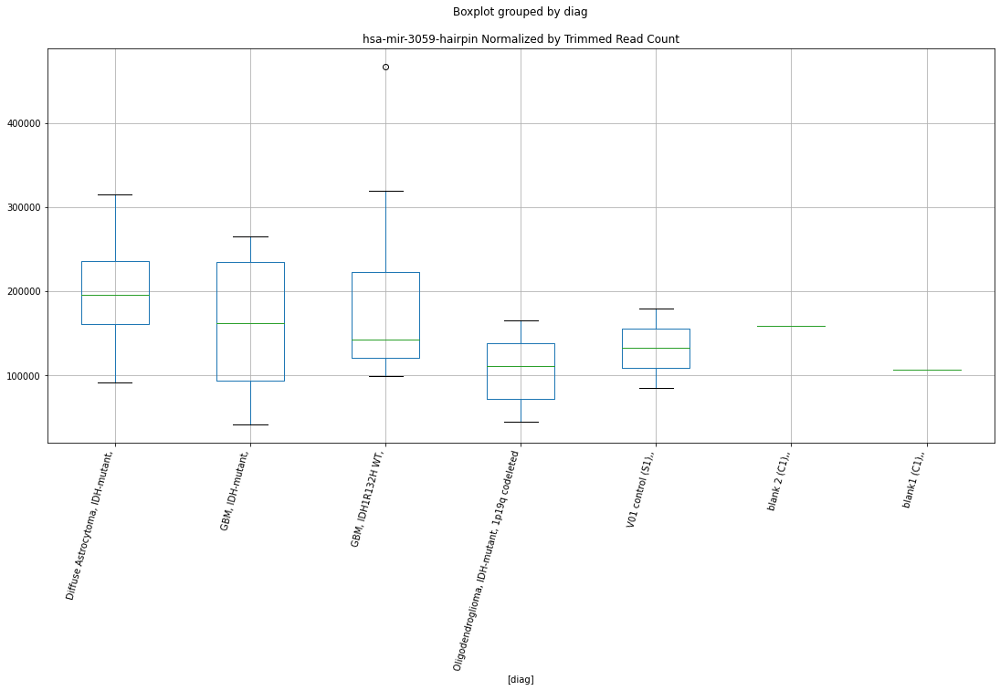

 p : 0.0018582831804815534  ( t : 3.6435108356284642 ) :  Lexogen  :  bbduk2  :  hsa-mir-11401-hairpin
Control and blanks
79          NaN
343    12314.23
Name: hsa-mir-11401-hairpin, dtype: float64
211   NaN
Name: hsa-mir-11401-hairpin, dtype: float64
475   NaN
Name: hsa-mir-11401-hairpin, dtype: float64


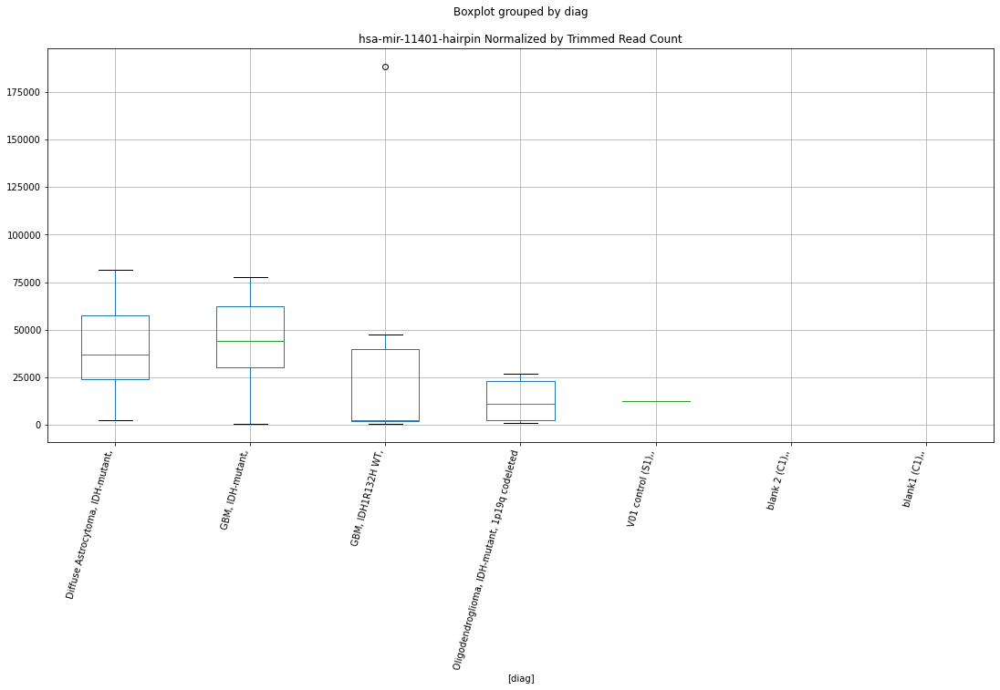

 p : 0.0021127714852487746  ( t : 3.5858253104031372 ) :  D-plex  :  bbduk2  :  hsa-mir-1252-hairpin
Control and blanks
73      40969.45
337    150436.58
Name: hsa-mir-1252-hairpin, dtype: float64
205    37430.01
Name: hsa-mir-1252-hairpin, dtype: float64
469    59744.26
Name: hsa-mir-1252-hairpin, dtype: float64


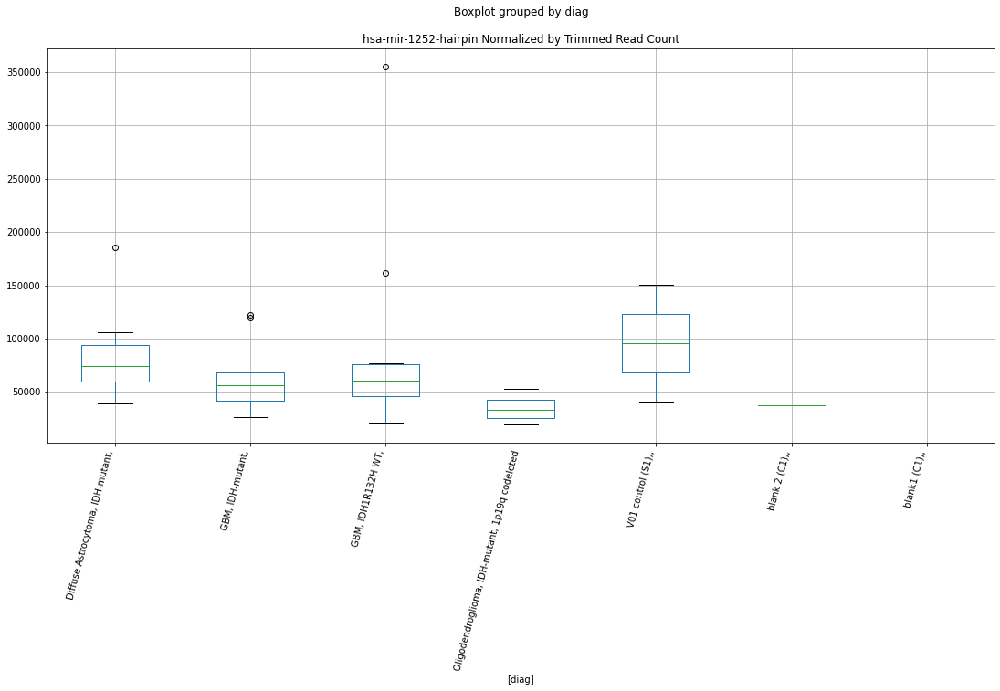

 p : 0.00223966619353589  ( t : 3.5595937148758963 ) :  D-plex  :  bbduk2  :  hsa-mir-320a-hairpin
Control and blanks
73     51018.55
337    37386.61
Name: hsa-mir-320a-hairpin, dtype: float64
205    24893.64
Name: hsa-mir-320a-hairpin, dtype: float64
469    32534.0
Name: hsa-mir-320a-hairpin, dtype: float64


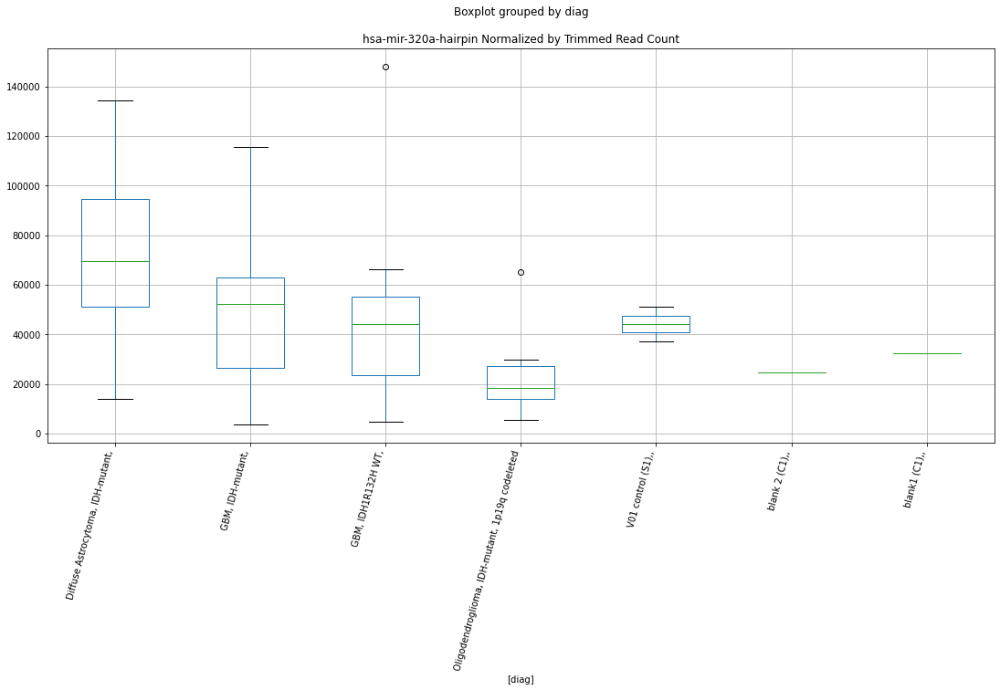

 p : 0.0023278847583940673  ( t : 3.542212149969545 ) :  D-plex  :  cutadapt2  :  hsa-mir-764-hairpin
Control and blanks
76      3788.07
340    63412.71
Name: hsa-mir-764-hairpin, dtype: float64
208    15696.06
Name: hsa-mir-764-hairpin, dtype: float64
472    18494.59
Name: hsa-mir-764-hairpin, dtype: float64


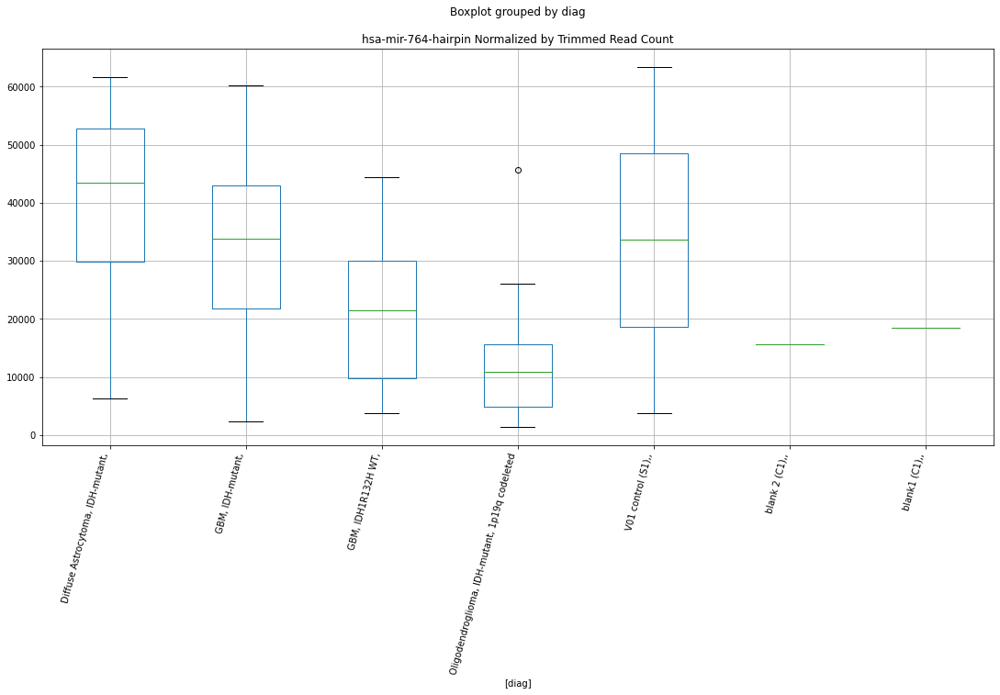

 p : 0.0023925178171685466  ( t : 3.5298872487896427 ) :  D-plex  :  bbduk2  :  hsa-mir-6760-5p-mature
Control and blanks
73     14687.16
337    16912.99
Name: hsa-mir-6760-5p-mature, dtype: float64
205    9850.0
Name: hsa-mir-6760-5p-mature, dtype: float64
469    10647.49
Name: hsa-mir-6760-5p-mature, dtype: float64


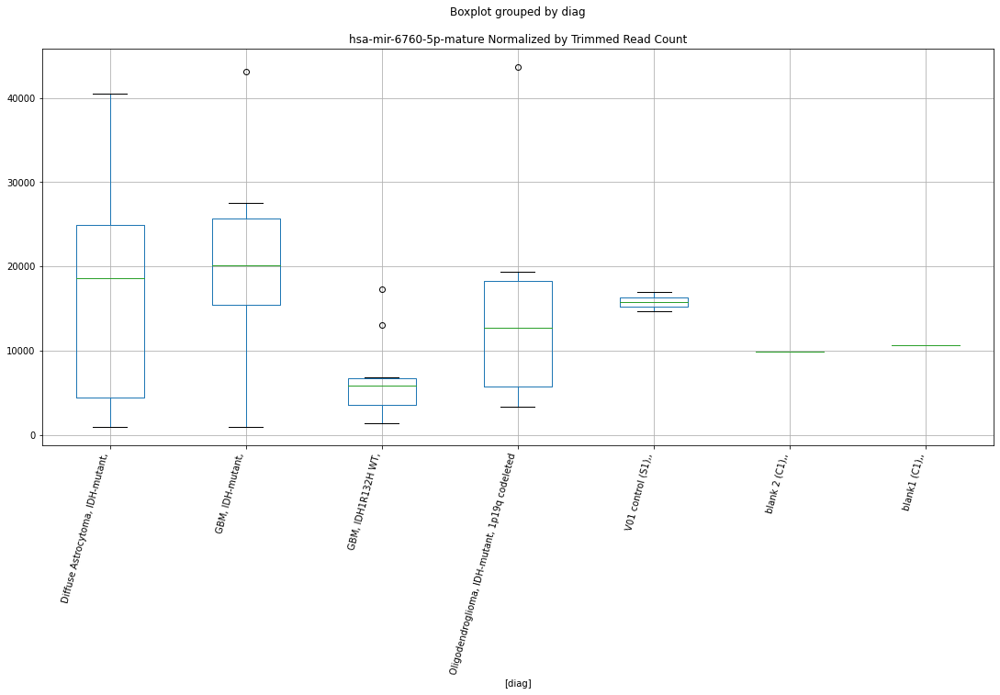

 p : 0.002455438964907454  ( t : 3.5182017632349663 ) :  D-plex  :  cutadapt2  :  hsa-mir-6760-5p-mature
Control and blanks
76     13637.06
340    16733.91
Name: hsa-mir-6760-5p-mature, dtype: float64
208    9523.45
Name: hsa-mir-6760-5p-mature, dtype: float64
472    10981.16
Name: hsa-mir-6760-5p-mature, dtype: float64


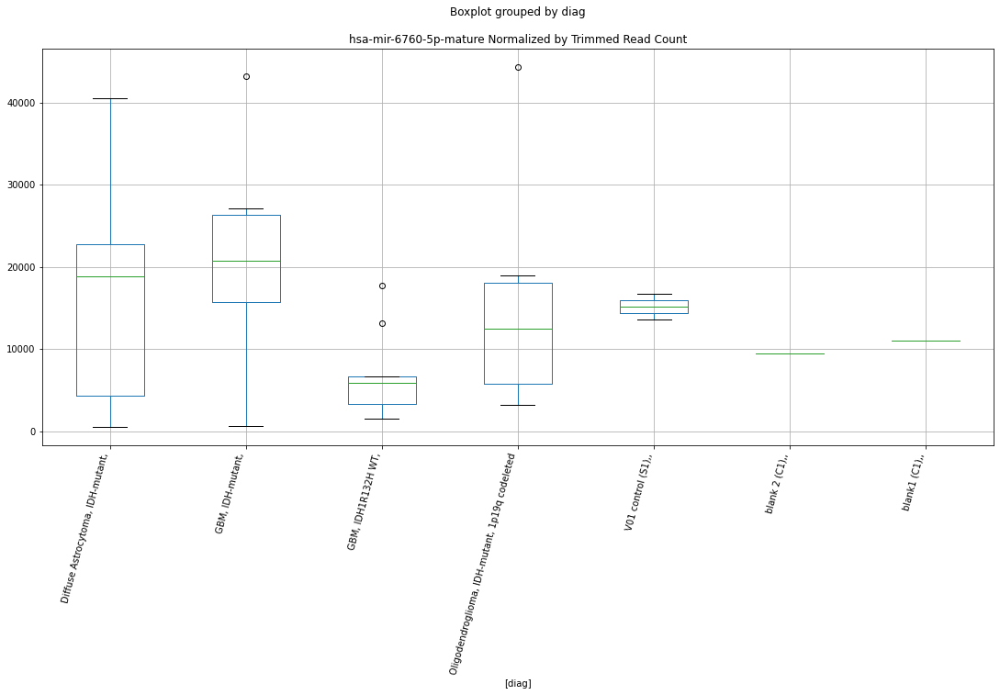

 p : 0.0024698397436578273  ( t : 3.51556904291535 ) :  D-plex  :  bbduk2  :  hsa-mir-3059-hairpin
Control and blanks
73     184749.01
337     83674.78
Name: hsa-mir-3059-hairpin, dtype: float64
205    176225.5
Name: hsa-mir-3059-hairpin, dtype: float64
469    105291.86
Name: hsa-mir-3059-hairpin, dtype: float64


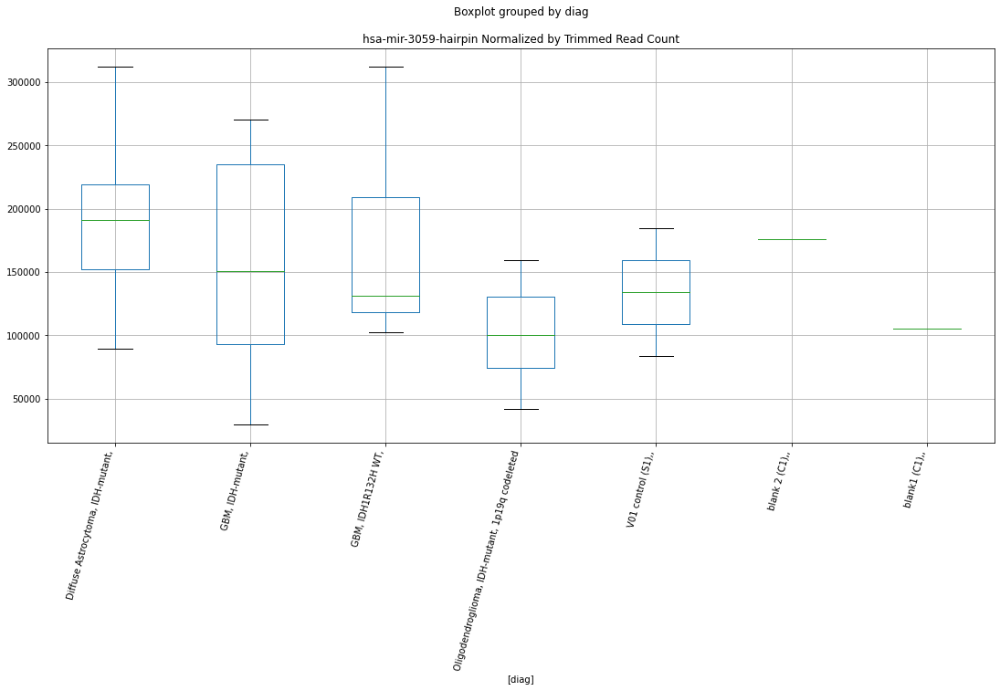

 p : 0.0025094545401447843  ( t : 3.508404444315338 ) :  Lexogen  :  cutadapt2  :  hsa-mir-3665-hairpin
Control and blanks
82     15620.56
346    26514.75
Name: hsa-mir-3665-hairpin, dtype: float64
214    8950.47
Name: hsa-mir-3665-hairpin, dtype: float64
478    12347.95
Name: hsa-mir-3665-hairpin, dtype: float64


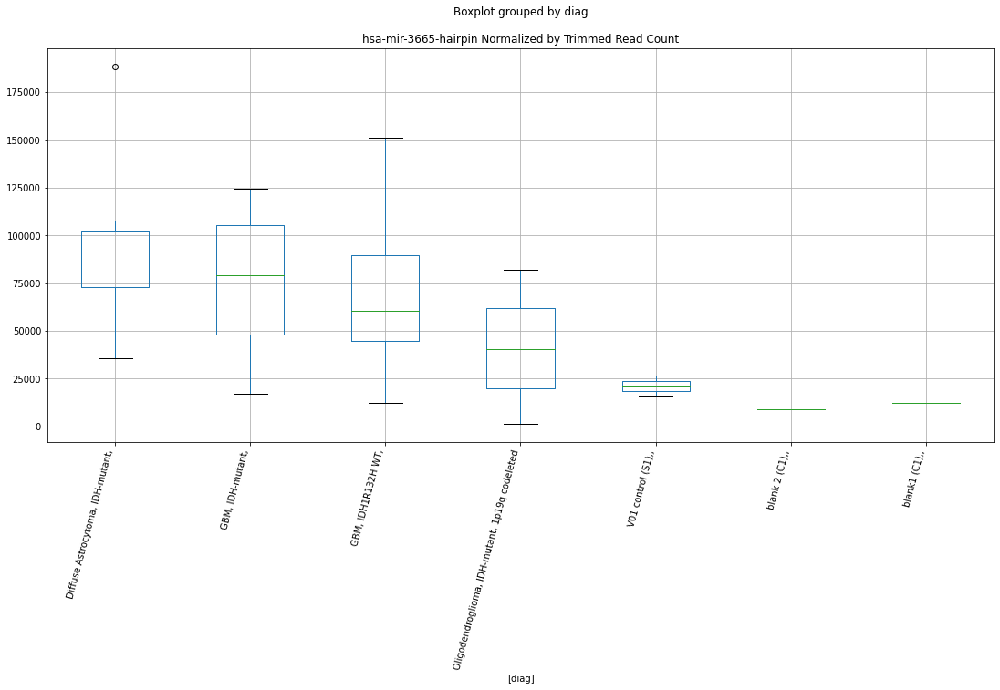

 p : 0.002663284168237664  ( t : 3.4816064670993527 ) :  D-plex  :  bbduk2  :  hsa-mir-6809-hairpin
Control and blanks
73     47926.52
337    84564.94
Name: hsa-mir-6809-hairpin, dtype: float64
205    46026.37
Name: hsa-mir-6809-hairpin, dtype: float64
469    46730.66
Name: hsa-mir-6809-hairpin, dtype: float64


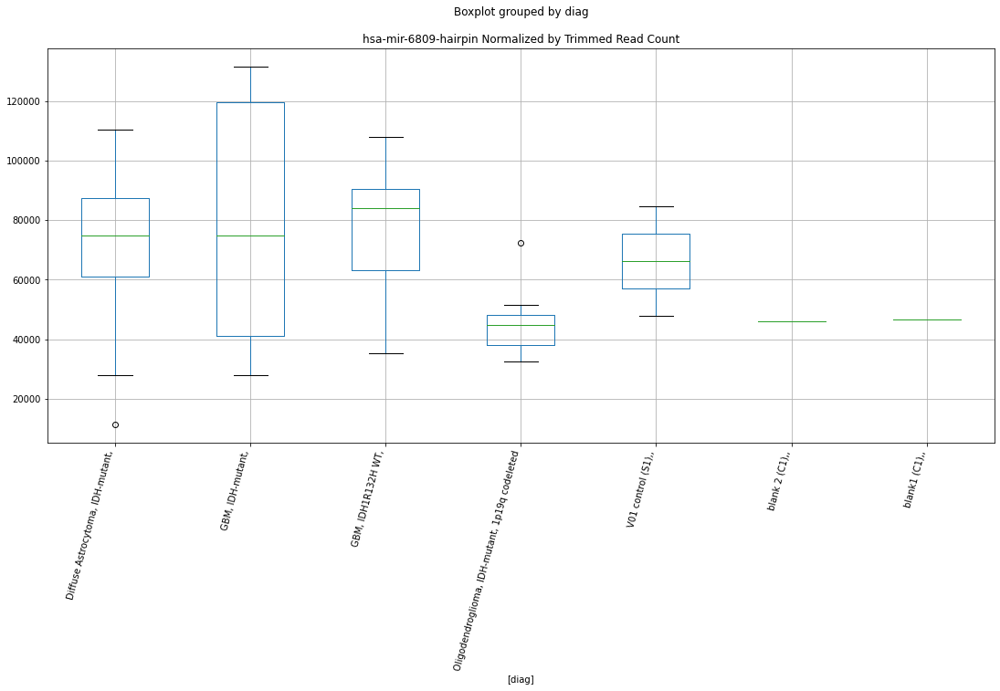

 p : 0.002665357765034199  ( t : 3.4812557991308957 ) :  D-plex  :  cutadapt2  :  hsa-mir-1252-hairpin
Control and blanks
76      60609.14
340    146201.53
Name: hsa-mir-1252-hairpin, dtype: float64
208    31039.4
Name: hsa-mir-1252-hairpin, dtype: float64
472    50282.16
Name: hsa-mir-1252-hairpin, dtype: float64


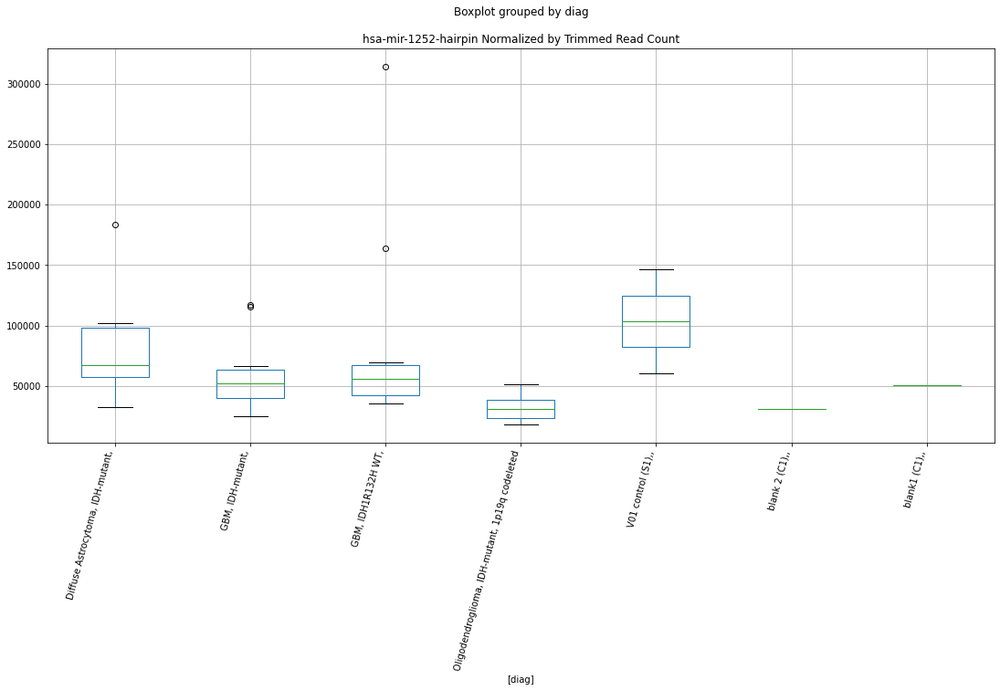

 p : 0.0028692021382596797  ( t : 3.4480375803136893 ) :  D-plex  :  bbduk2  :  hsa-mir-564-hairpin
Control and blanks
73     40196.44
337    35606.29
Name: hsa-mir-564-hairpin, dtype: float64
205    67159.11
Name: hsa-mir-564-hairpin, dtype: float64
469    33717.06
Name: hsa-mir-564-hairpin, dtype: float64


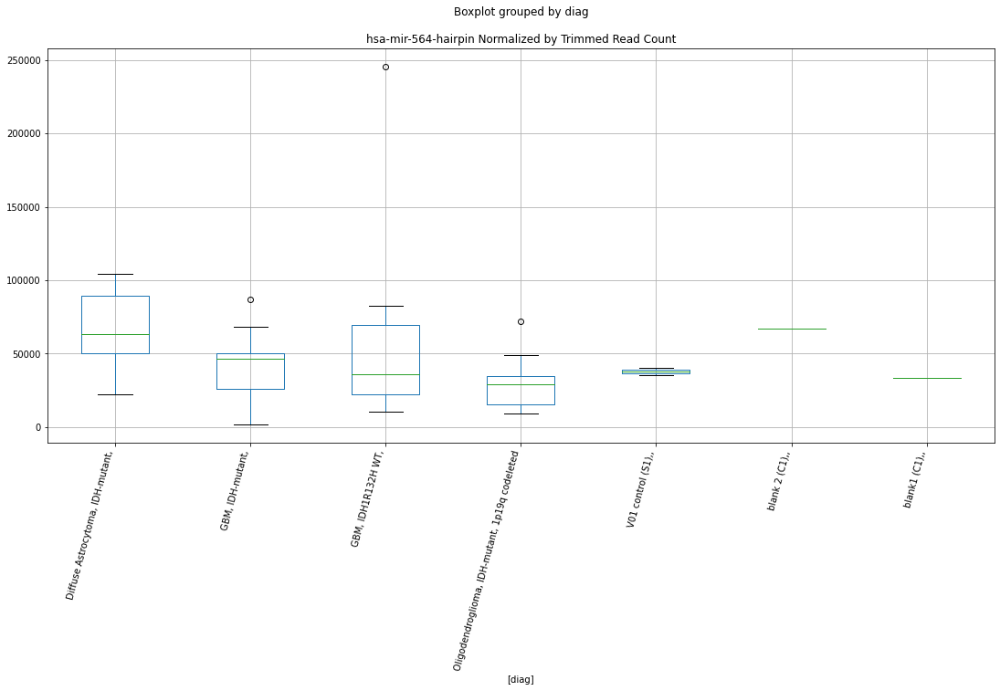

 p : 0.0032164211735839134  ( t : 3.396488991776138 ) :  D-plex  :  bbduk2  :  hsa-mir-302d-hairpin
Control and blanks
73     31693.34
337    18693.30
Name: hsa-mir-302d-hairpin, dtype: float64
205    10924.55
Name: hsa-mir-302d-hairpin, dtype: float64
469    10647.49
Name: hsa-mir-302d-hairpin, dtype: float64


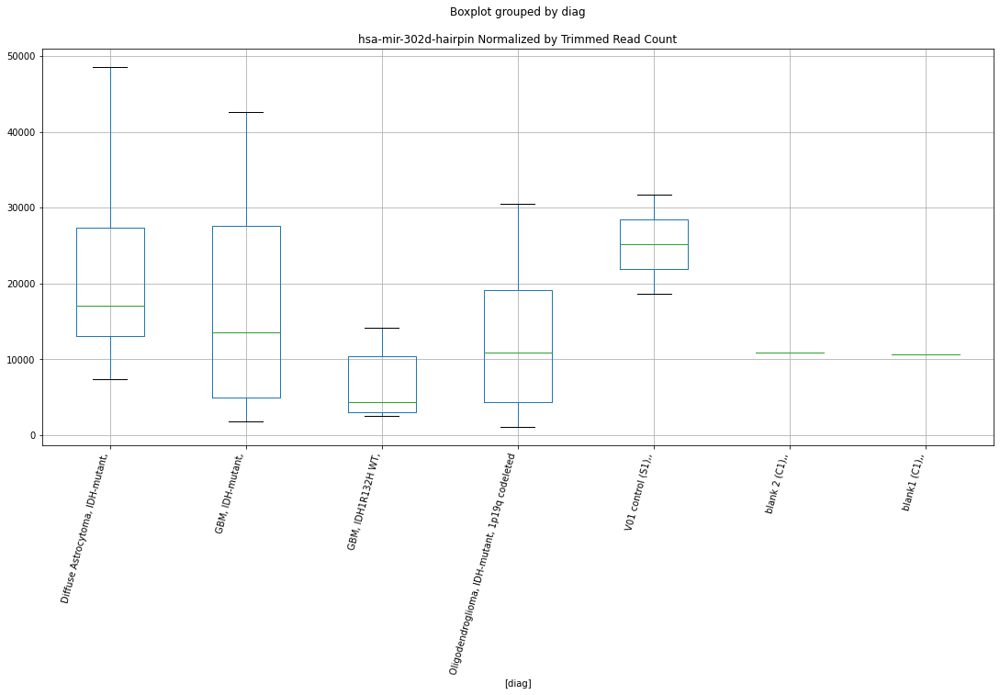

 p : 0.0032192140638032797  ( t : 3.3960970442121305 ) :  D-plex  :  cutadapt2  :  hsa-mir-302d-hairpin
Control and blanks
76     30304.57
340    15853.18
Name: hsa-mir-302d-hairpin, dtype: float64
208    10228.89
Name: hsa-mir-302d-hairpin, dtype: float64
472    10981.16
Name: hsa-mir-302d-hairpin, dtype: float64


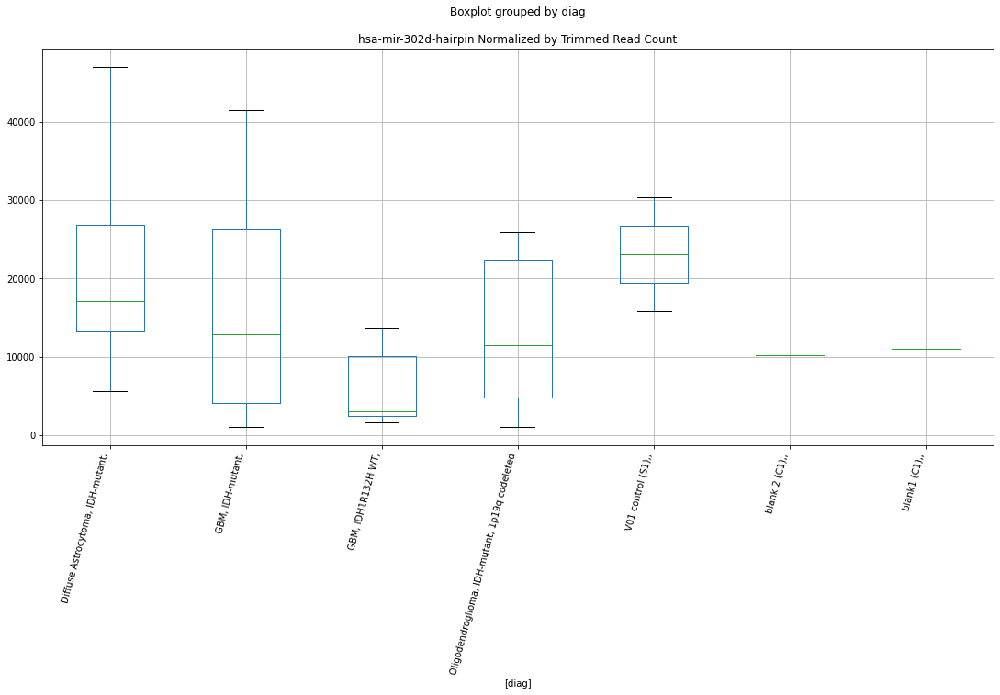

 p : 0.0033766753230109925  ( t : 3.374524962630249 ) :  D-plex  :  bbduk2  :  hsa-mir-3613-hairpin
Control and blanks
73     138368.50
337    170910.19
Name: hsa-mir-3613-hairpin, dtype: float64
205    116946.39
Name: hsa-mir-3613-hairpin, dtype: float64
469    107657.97
Name: hsa-mir-3613-hairpin, dtype: float64


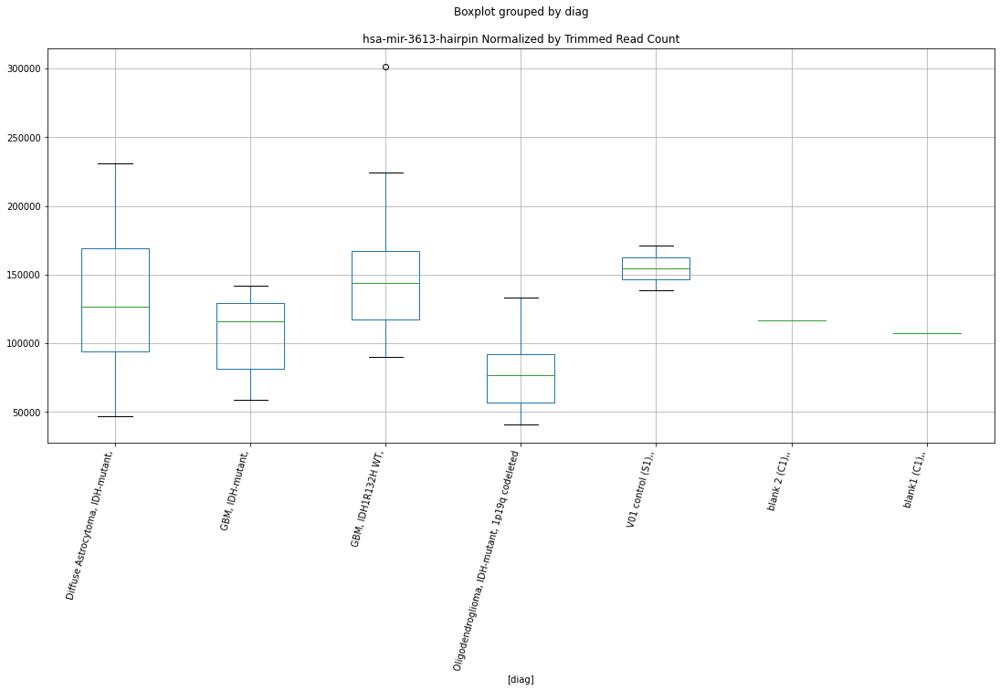

 p : 0.003652104224967022  ( t : 3.3390720180122577 ) :  D-plex  :  cutadapt2  :  hsa-mir-411-hairpin
Control and blanks
76     24243.65
340    41394.41
Name: hsa-mir-411-hairpin, dtype: float64
208    22574.11
Name: hsa-mir-411-hairpin, dtype: float64
472    35255.31
Name: hsa-mir-411-hairpin, dtype: float64


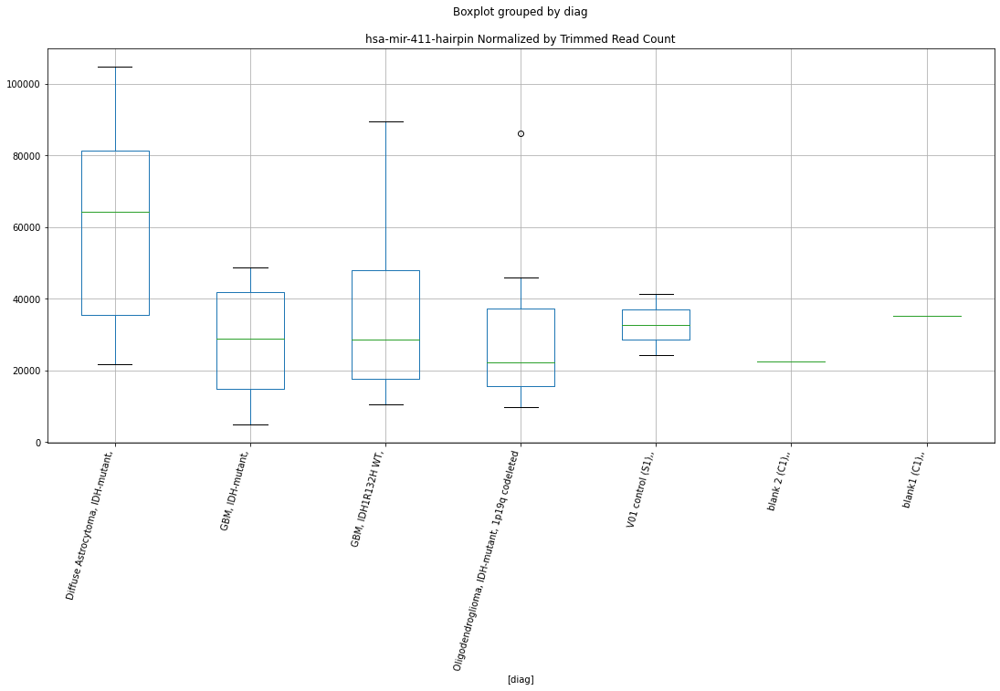

 p : 0.0036677451556454063  ( t : 3.3371385805569145 ) :  D-plex  :  cutadapt2  :  hsa-mir-1343-5p-mature
Control and blanks
76     5303.3
340    2642.2
Name: hsa-mir-1343-5p-mature, dtype: float64
208    20810.51
Name: hsa-mir-1343-5p-mature, dtype: float64
472    11559.12
Name: hsa-mir-1343-5p-mature, dtype: float64


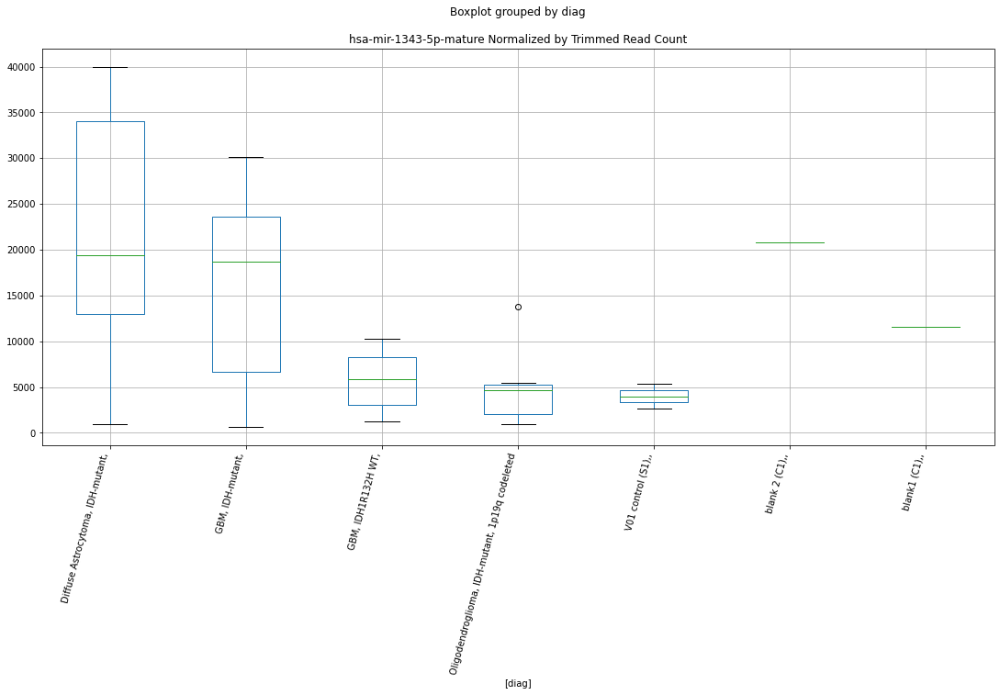

 p : 0.0036730074287564403  ( t : 3.336489914753384 ) :  D-plex  :  bbduk2  :  hsa-mir-4272-mature
Control and blanks
73     773.01
337    890.16
Name: hsa-mir-4272-mature, dtype: float64
205    78083.66
Name: hsa-mir-4272-mature, dtype: float64
469    11830.55
Name: hsa-mir-4272-mature, dtype: float64


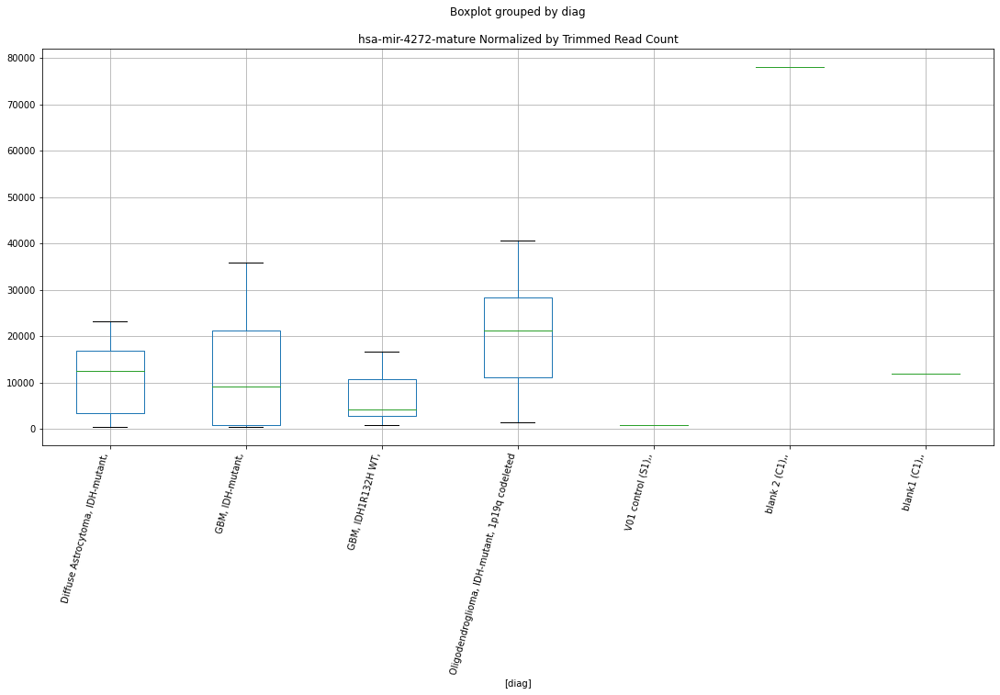

 p : 0.0037497785971616006  ( t : 3.327129187617466 ) :  D-plex  :  cutadapt2  :  hsa-mir-8081-hairpin
Control and blanks
76      87125.63
340    108330.05
Name: hsa-mir-8081-hairpin, dtype: float64
208    39328.33
Name: hsa-mir-8081-hairpin, dtype: float64
472    251988.75
Name: hsa-mir-8081-hairpin, dtype: float64


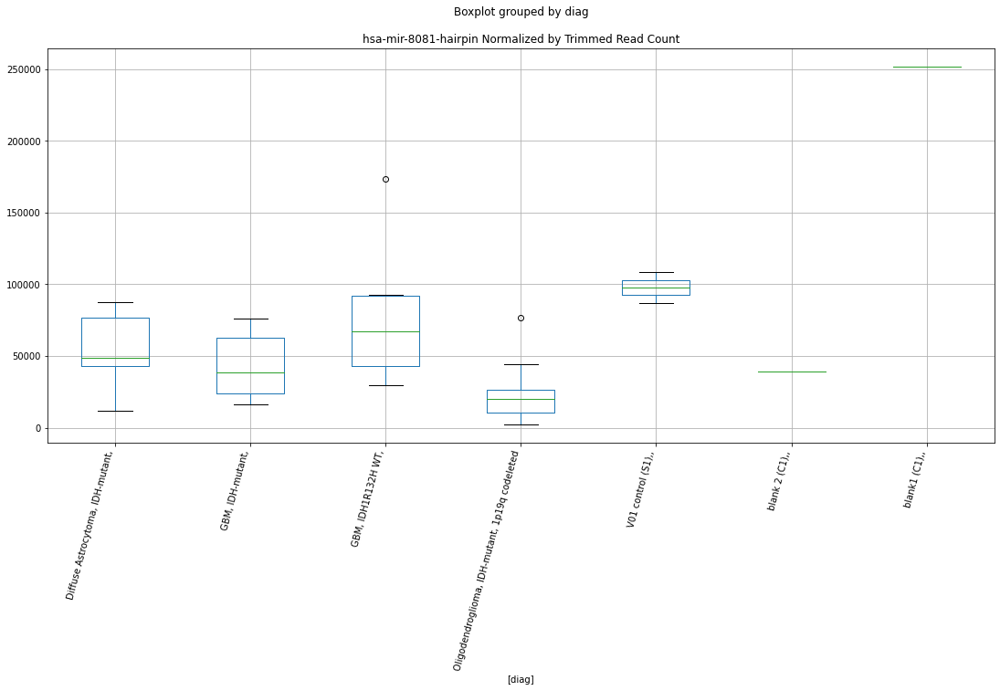

 p : 0.003785130870310127  ( t : 3.3228819346713134 ) :  Lexogen  :  cutadapt2  :  hsa-mir-122b-hairpin
Control and blanks
82      2840.10
346    21885.19
Name: hsa-mir-122b-hairpin, dtype: float64
214    4068.4
Name: hsa-mir-122b-hairpin, dtype: float64
478    4986.67
Name: hsa-mir-122b-hairpin, dtype: float64


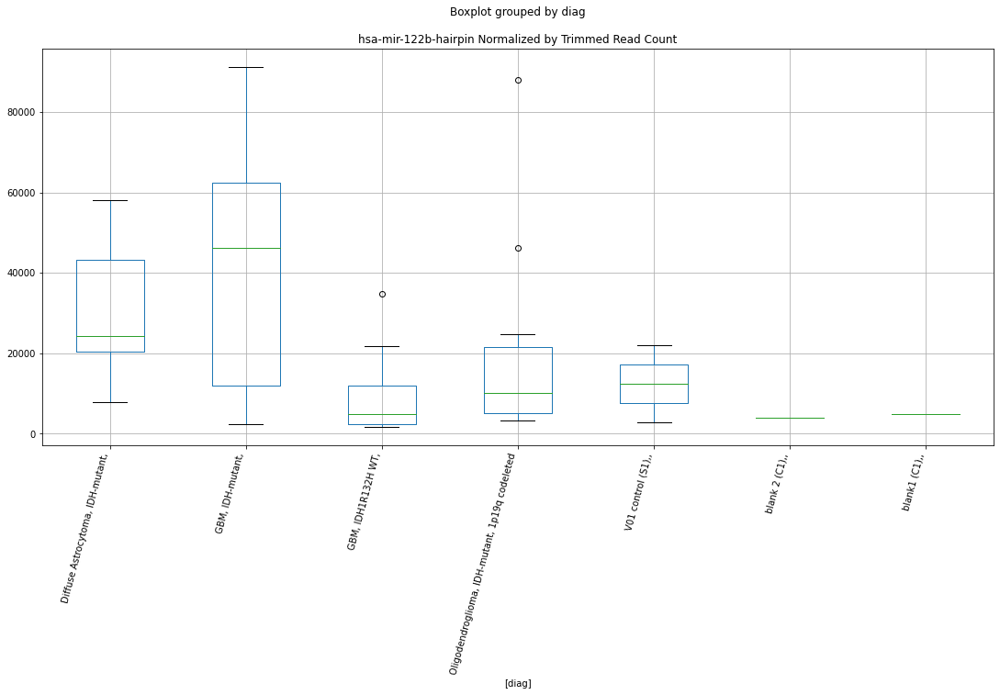

 p : 0.003850157715924152  ( t : 3.315170501349126 ) :  D-plex  :  cutadapt2  :  hsa-mir-6818-hairpin
Control and blanks
76     37123.10
340    38752.21
Name: hsa-mir-6818-hairpin, dtype: float64
208    12521.58
Name: hsa-mir-6818-hairpin, dtype: float64
472    17916.63
Name: hsa-mir-6818-hairpin, dtype: float64


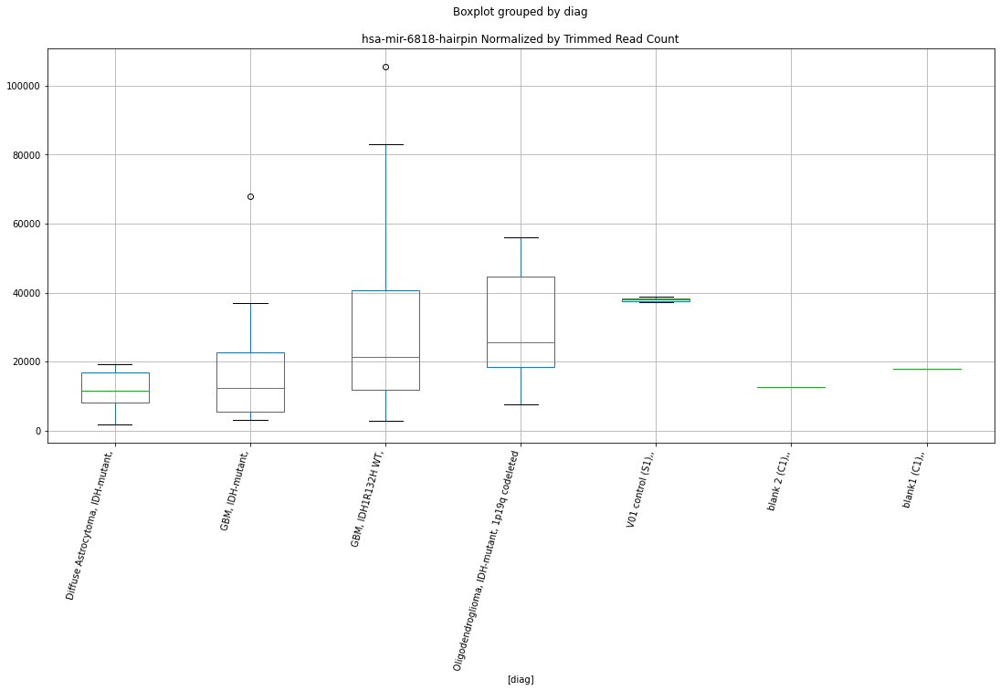

 p : 0.003928153951898716  ( t : 3.3060883006182578 ) :  D-plex  :  cutadapt2  :  hsa-mir-3613-hairpin
Control and blanks
76     130309.64
340    203449.12
Name: hsa-mir-3613-hairpin, dtype: float64
208    119748.59
Name: hsa-mir-3613-hairpin, dtype: float64
472    89005.2
Name: hsa-mir-3613-hairpin, dtype: float64


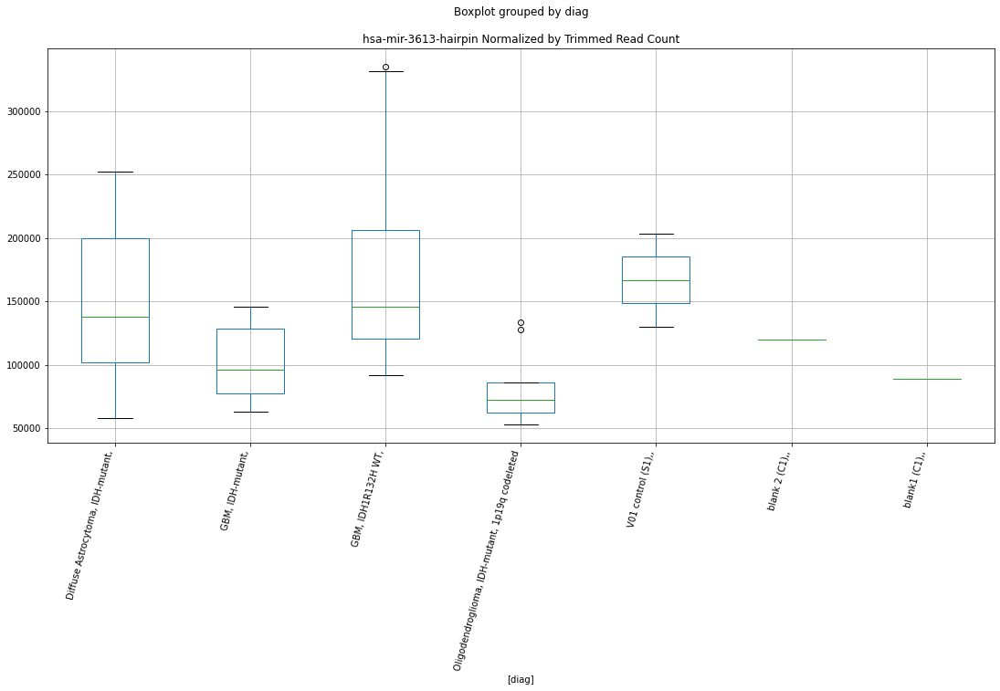

 p : 0.004186641062878626  ( t : 3.2772079583817746 ) :  D-plex  :  cutadapt2  :  hsa-mir-7515-hairpin
Control and blanks
76      4545.69
340    70458.57
Name: hsa-mir-7515-hairpin, dtype: float64
208    17459.66
Name: hsa-mir-7515-hairpin, dtype: float64
472    21384.37
Name: hsa-mir-7515-hairpin, dtype: float64


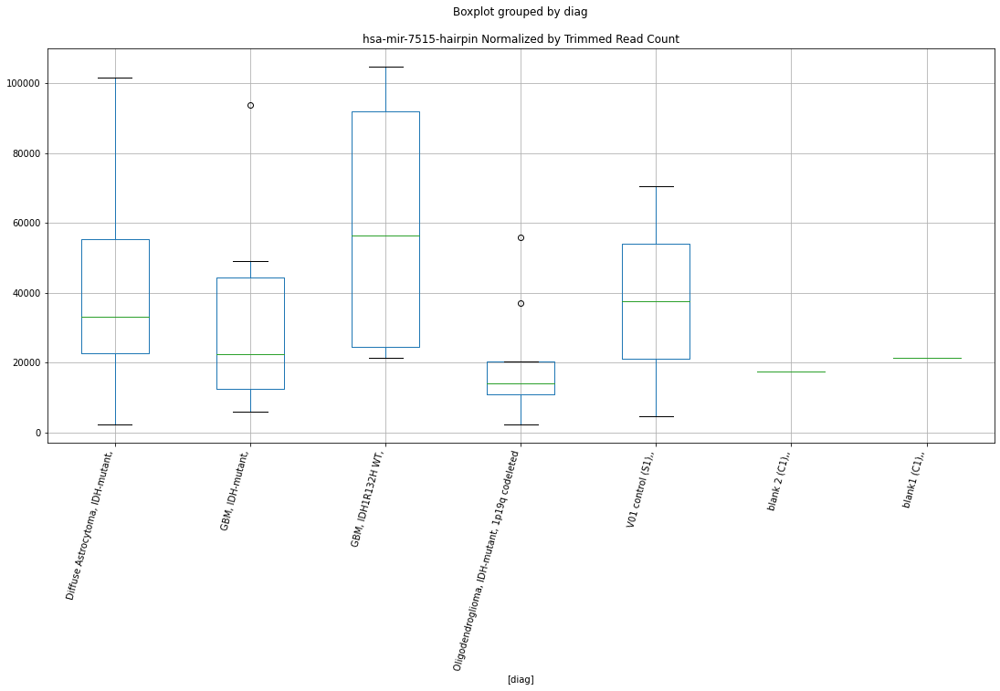

 p : 0.004456557573944767  ( t : 3.2488631569317925 ) :  D-plex  :  bbduk2  :  hsa-mir-4477b-hairpin
Control and blanks
73      5411.06
337    19583.46
Name: hsa-mir-4477b-hairpin, dtype: float64
205    28833.64
Name: hsa-mir-4477b-hairpin, dtype: float64
469    33125.53
Name: hsa-mir-4477b-hairpin, dtype: float64


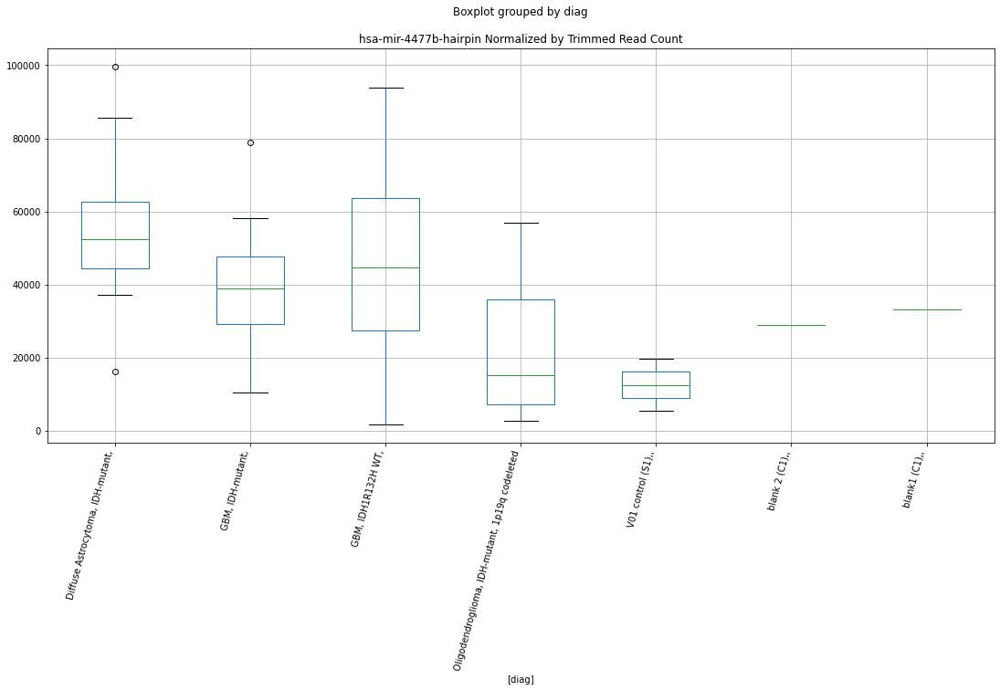

 p : 0.004456557573944767  ( t : 3.2488631569317925 ) :  D-plex  :  bbduk2  :  hsa-mir-4477a-hairpin
Control and blanks
73      5411.06
337    19583.46
Name: hsa-mir-4477a-hairpin, dtype: float64
205    28833.64
Name: hsa-mir-4477a-hairpin, dtype: float64
469    33125.53
Name: hsa-mir-4477a-hairpin, dtype: float64


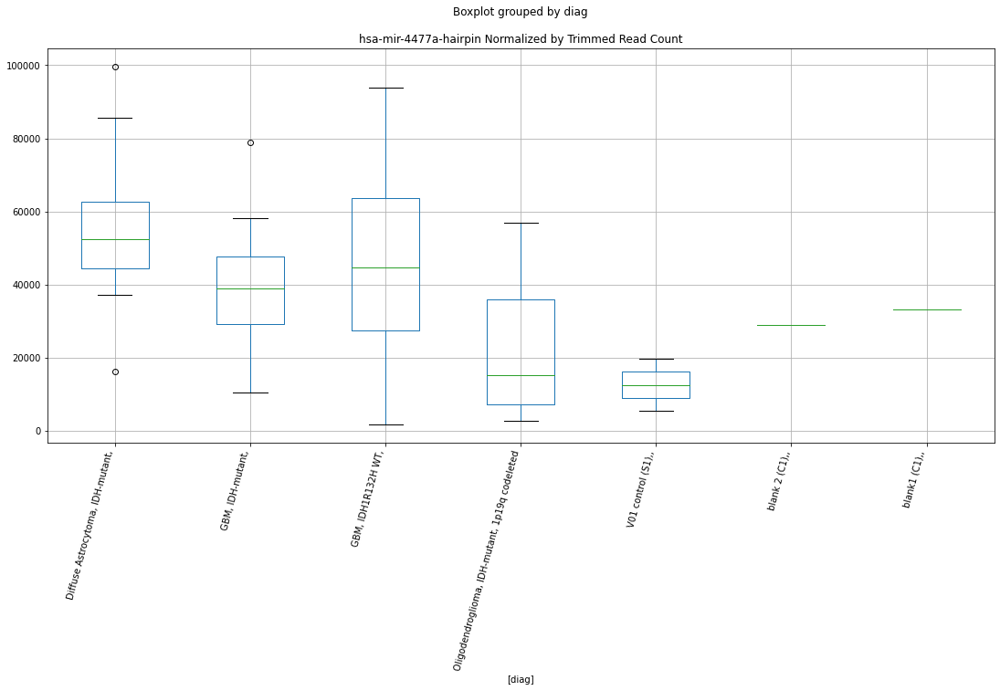

 p : 0.004520040592423262  ( t : 3.2424416508882934 ) :  D-plex  :  cutadapt2  :  hsa-mir-4713-hairpin
Control and blanks
76     9091.37
340    4403.66
Name: hsa-mir-4713-hairpin, dtype: float64
208    70015.01
Name: hsa-mir-4713-hairpin, dtype: float64
472    45658.51
Name: hsa-mir-4713-hairpin, dtype: float64


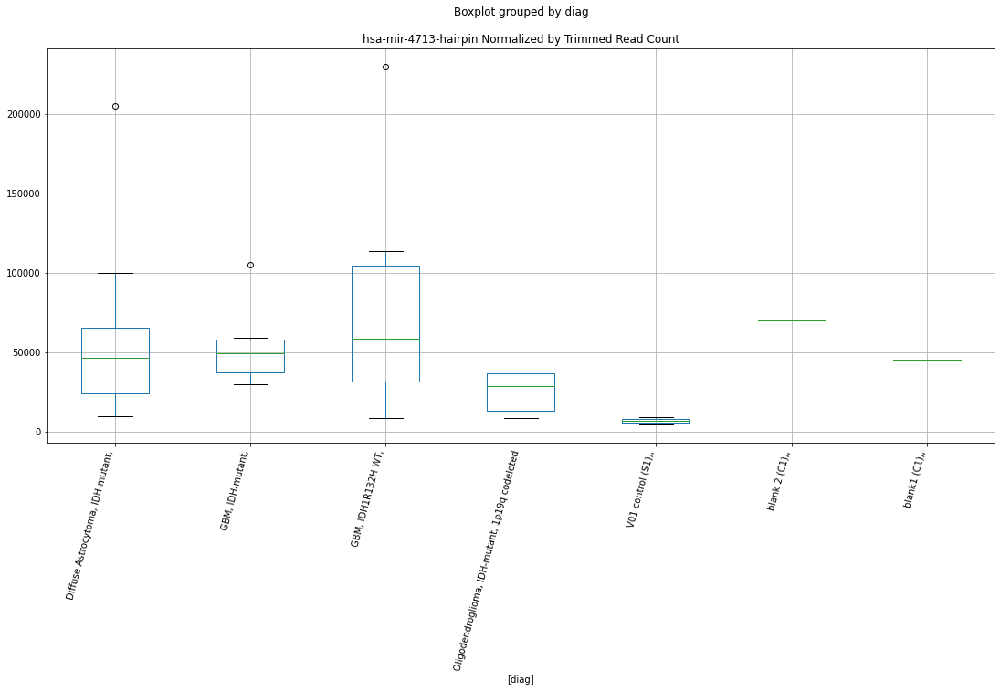

 p : 0.004603686065866517  ( t : 3.234114429809113 ) :  Lexogen  :  bbduk2  :  hsa-mir-11401-hairpin
Control and blanks
79          NaN
343    12314.23
Name: hsa-mir-11401-hairpin, dtype: float64
211   NaN
Name: hsa-mir-11401-hairpin, dtype: float64
475   NaN
Name: hsa-mir-11401-hairpin, dtype: float64


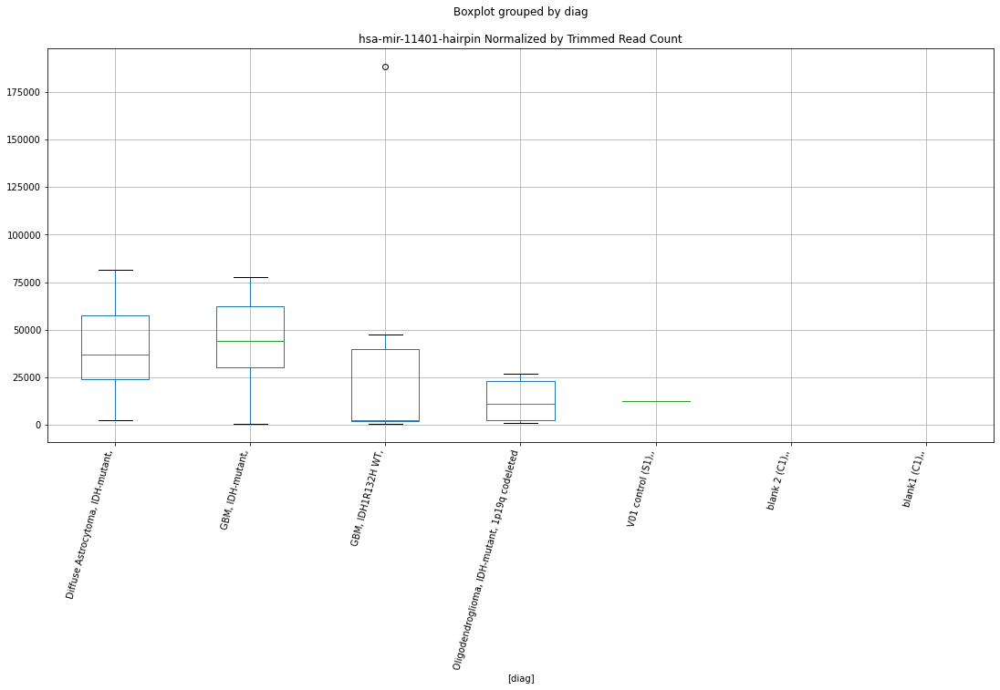

 p : 0.0047693602536653884  ( t : 3.2180500853661913 ) :  Lexogen  :  cutadapt2  :  hsa-mir-122-hairpin
Control and blanks
82      2840.10
346    21885.19
Name: hsa-mir-122-hairpin, dtype: float64
214    4068.4
Name: hsa-mir-122-hairpin, dtype: float64
478    4986.67
Name: hsa-mir-122-hairpin, dtype: float64


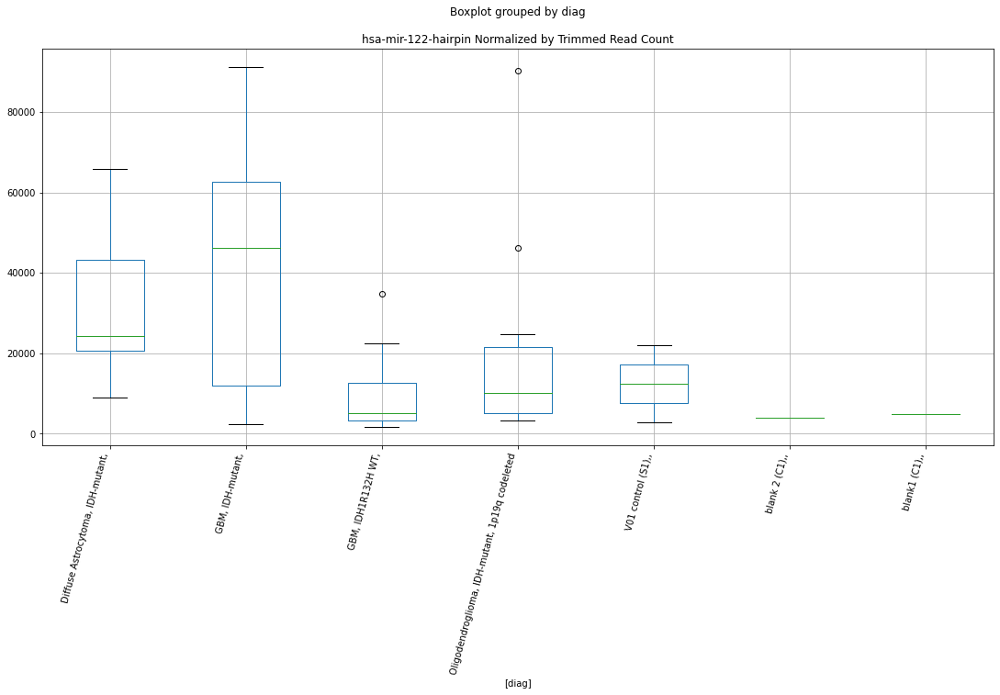

 p : 0.0048806339561821635  ( t : 3.207564806539963 ) :  D-plex  :  cutadapt2  :  hsa-mir-564-hairpin
Control and blanks
76     39395.94
340    35229.29
Name: hsa-mir-564-hairpin, dtype: float64
208    67722.32
Name: hsa-mir-564-hairpin, dtype: float64
472    30631.66
Name: hsa-mir-564-hairpin, dtype: float64


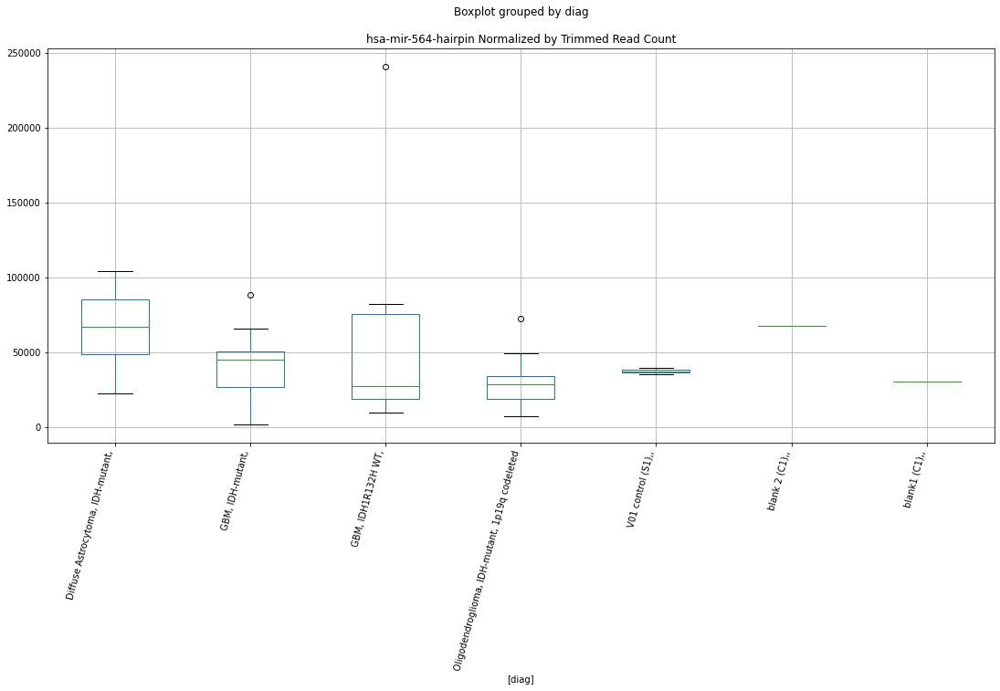

 p : 0.004901534855005934  ( t : 3.2056214806065544 ) :  D-plex  :  bbduk2  :  hsa-mir-3667-hairpin
Control and blanks
73     157693.71
337     25814.56
Name: hsa-mir-3667-hairpin, dtype: float64
205    75218.2
Name: hsa-mir-3667-hairpin, dtype: float64
469    97010.48
Name: hsa-mir-3667-hairpin, dtype: float64


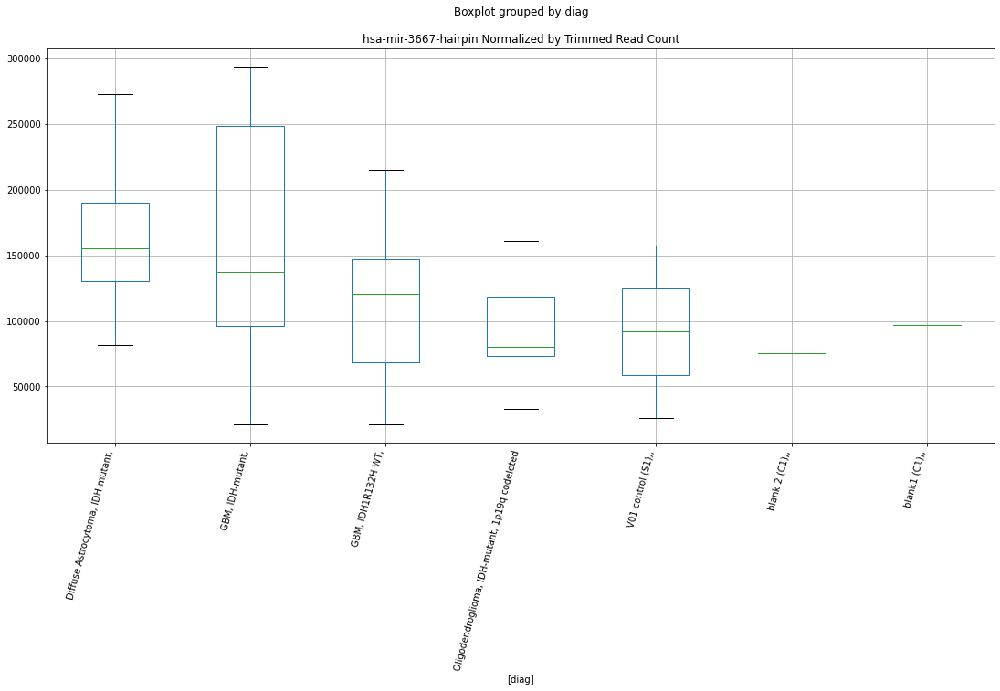

 p : 0.005077723845579882  ( t : 3.18955511238308 ) :  D-plex  :  bbduk2  :  hsa-mir-6733-3p-mature
Control and blanks
73     15460.17
337     9791.73
Name: hsa-mir-6733-3p-mature, dtype: float64
205    10387.28
Name: hsa-mir-6733-3p-mature, dtype: float64
469    39040.8
Name: hsa-mir-6733-3p-mature, dtype: float64


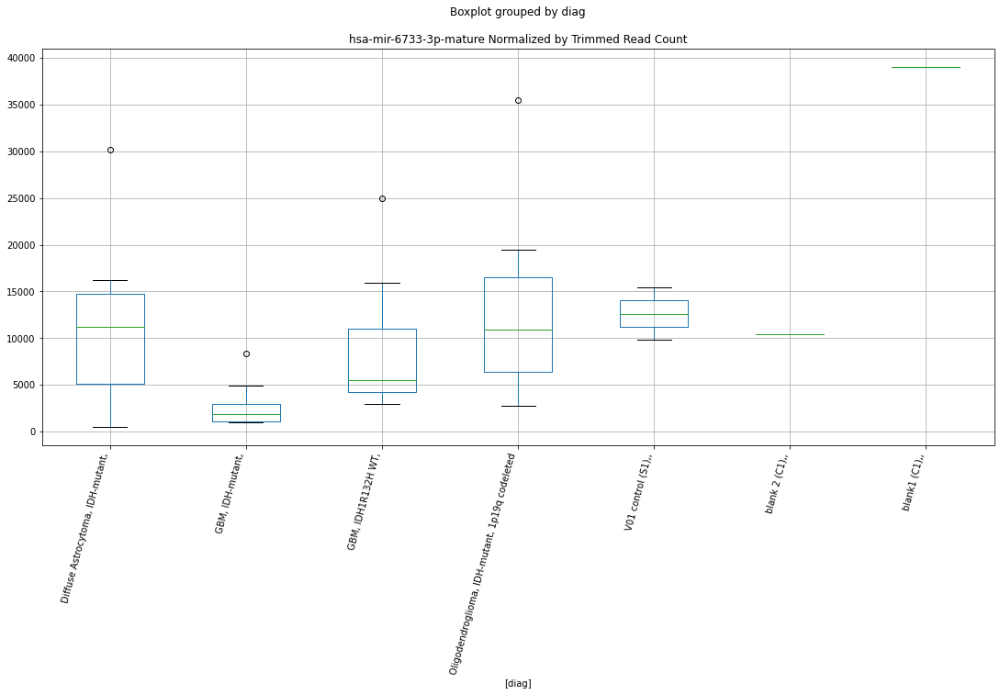

 p : 0.005135583819821386  ( t : 3.184397839379857 ) :  D-plex  :  cutadapt2  :  hsa-mir-3667-hairpin
Control and blanks
76     155310.91
340     25541.23
Name: hsa-mir-3667-hairpin, dtype: float64
208    78480.3
Name: hsa-mir-3667-hairpin, dtype: float64
472    98252.49
Name: hsa-mir-3667-hairpin, dtype: float64


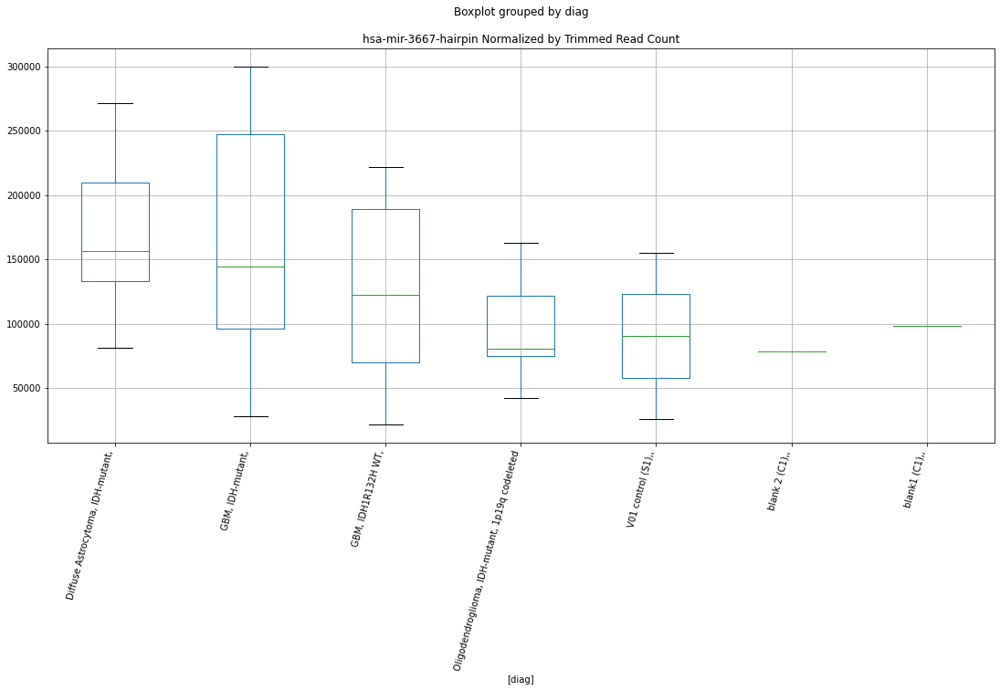

 p : 0.005302141318963059  ( t : 3.1698633591429393 ) :  D-plex  :  bbduk2  :  hsa-mir-129-2-hairpin
Control and blanks
73     21644.24
337    31155.50
Name: hsa-mir-129-2-hairpin, dtype: float64
205    28117.28
Name: hsa-mir-129-2-hairpin, dtype: float64
469    39632.33
Name: hsa-mir-129-2-hairpin, dtype: float64


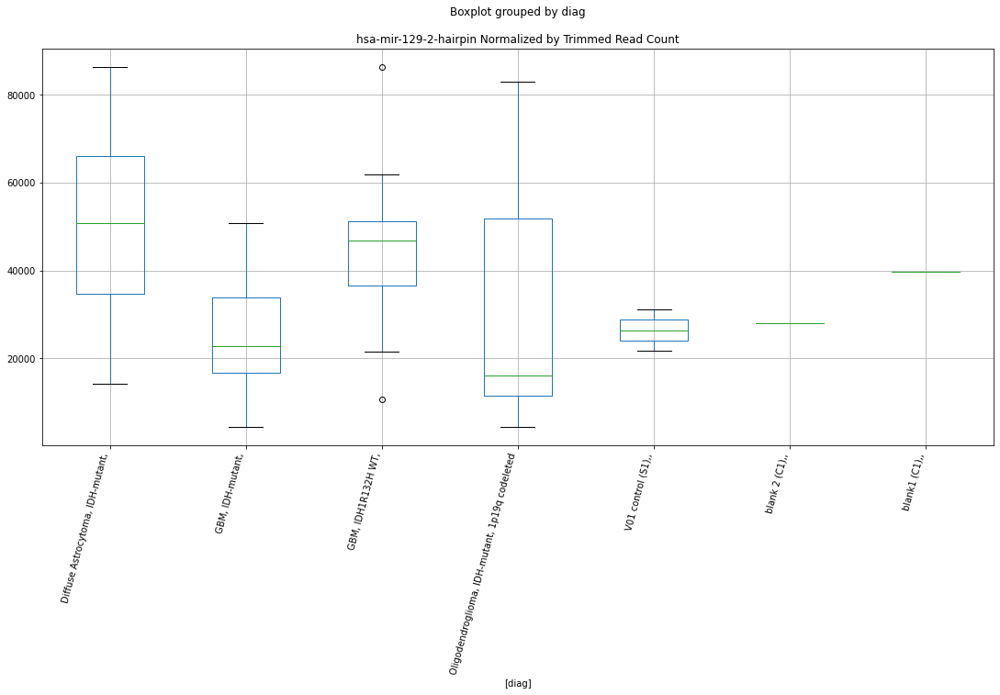

 p : 0.005321884848007053  ( t : 3.168170160178327 ) :  D-plex  :  bbduk2  :  hsa-mir-6818-hairpin
Control and blanks
73     39423.43
337    40057.08
Name: hsa-mir-6818-hairpin, dtype: float64
205    13431.82
Name: hsa-mir-6818-hairpin, dtype: float64
469    19520.4
Name: hsa-mir-6818-hairpin, dtype: float64


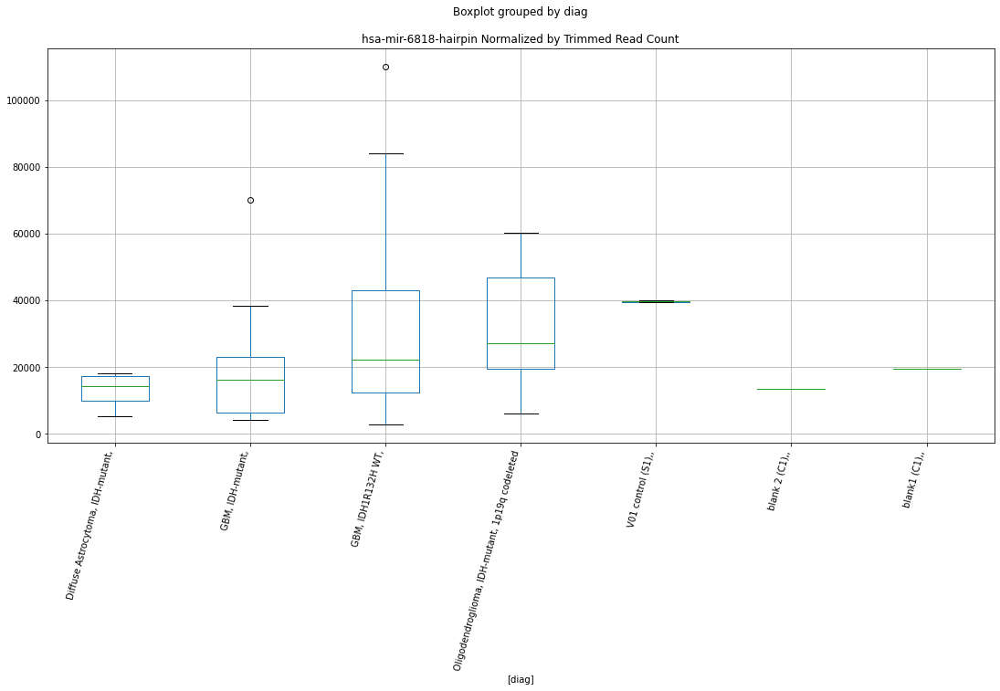

 p : 0.0053228556185249635  ( t : 3.1680870657574465 ) :  D-plex  :  cutadapt2  :  hsa-mir-29c-hairpin
Control and blanks
76      7576.14
340    49321.00
Name: hsa-mir-29c-hairpin, dtype: float64
208    51497.18
Name: hsa-mir-29c-hairpin, dtype: float64
472    21384.37
Name: hsa-mir-29c-hairpin, dtype: float64


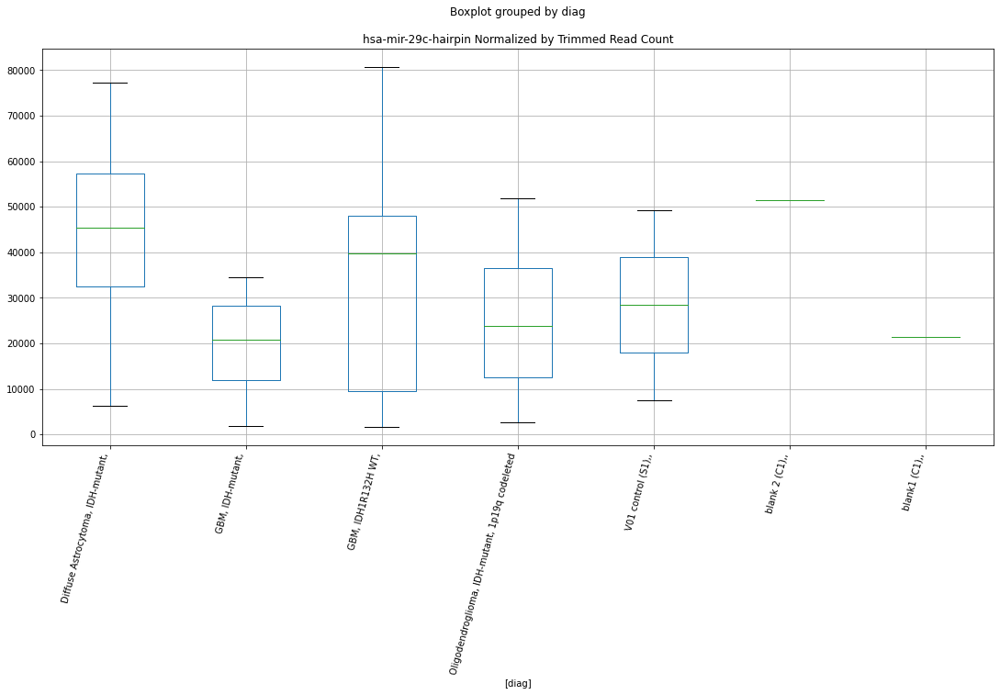

 p : 0.005411189210548118  ( t : 3.160587395778221 ) :  D-plex  :  bbduk2  :  hsa-mir-1343-5p-mature
Control and blanks
73     5411.06
337    1780.31
Name: hsa-mir-1343-5p-mature, dtype: float64
205    18983.64
Name: hsa-mir-1343-5p-mature, dtype: float64
469    10647.49
Name: hsa-mir-1343-5p-mature, dtype: float64


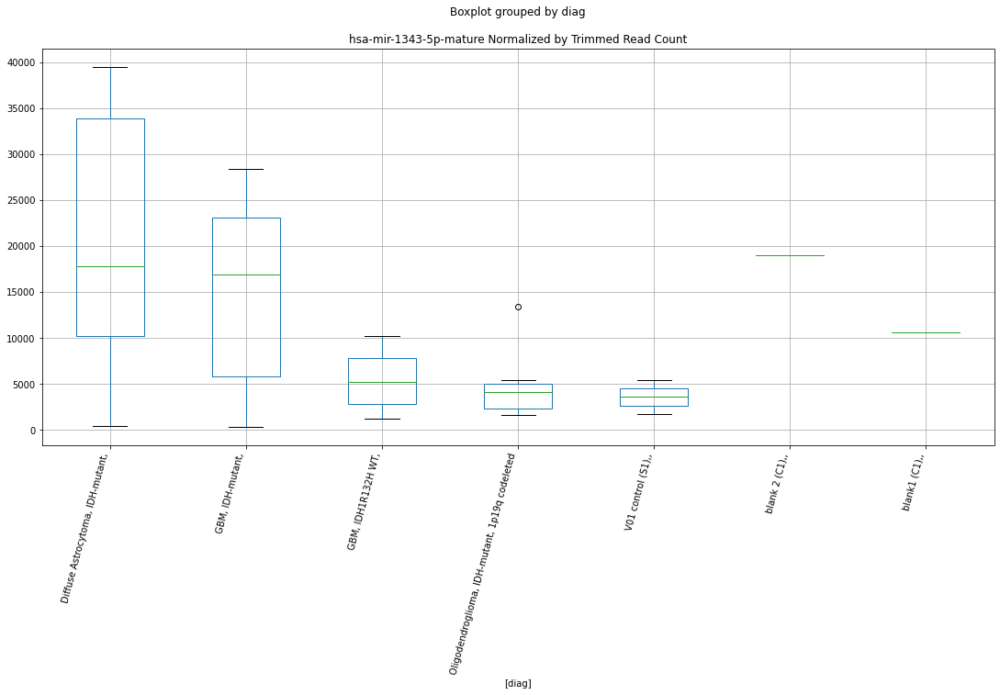

 p : 0.005427396219197341  ( t : 3.1592244020143645 ) :  Lexogen  :  bbduk2  :  hsa-mir-6780b-hairpin
Control and blanks
79      1430.60
343    14225.06
Name: hsa-mir-6780b-hairpin, dtype: float64
211    5192.82
Name: hsa-mir-6780b-hairpin, dtype: float64
475   NaN
Name: hsa-mir-6780b-hairpin, dtype: float64


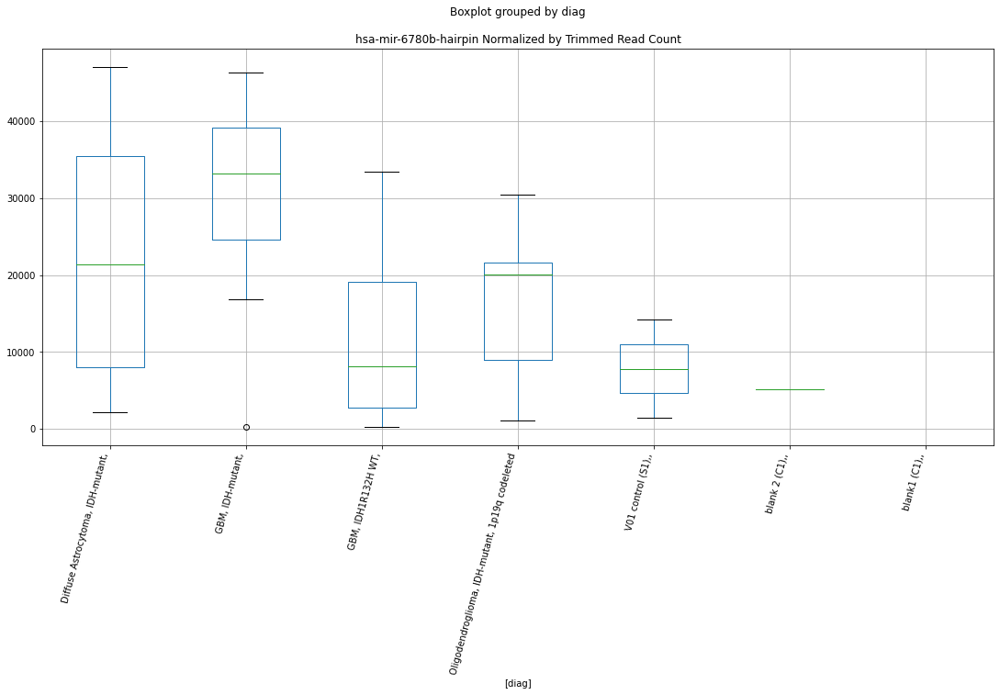

 p : 0.005526158539799018  ( t : 3.151003616567813 ) :  D-plex  :  bbduk2  :  hsa-mir-7515-hairpin
Control and blanks
73      3865.04
337    71212.58
Name: hsa-mir-7515-hairpin, dtype: float64
205    18625.46
Name: hsa-mir-7515-hairpin, dtype: float64
469    24252.62
Name: hsa-mir-7515-hairpin, dtype: float64


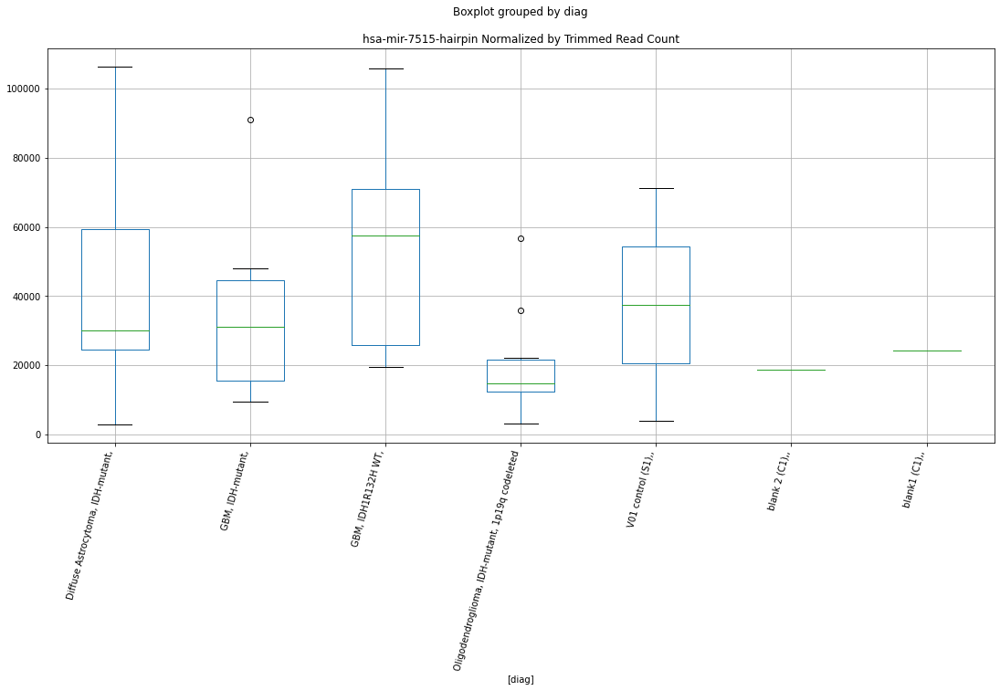

 p : 0.005659749473188974  ( t : 3.1401093555628163 ) :  D-plex  :  cutadapt2  :  hsa-mir-548f-3-hairpin
Control and blanks
76      6060.91
340    63412.71
Name: hsa-mir-548f-3-hairpin, dtype: float64
208    94529.08
Name: hsa-mir-548f-3-hairpin, dtype: float64
472    49126.25
Name: hsa-mir-548f-3-hairpin, dtype: float64


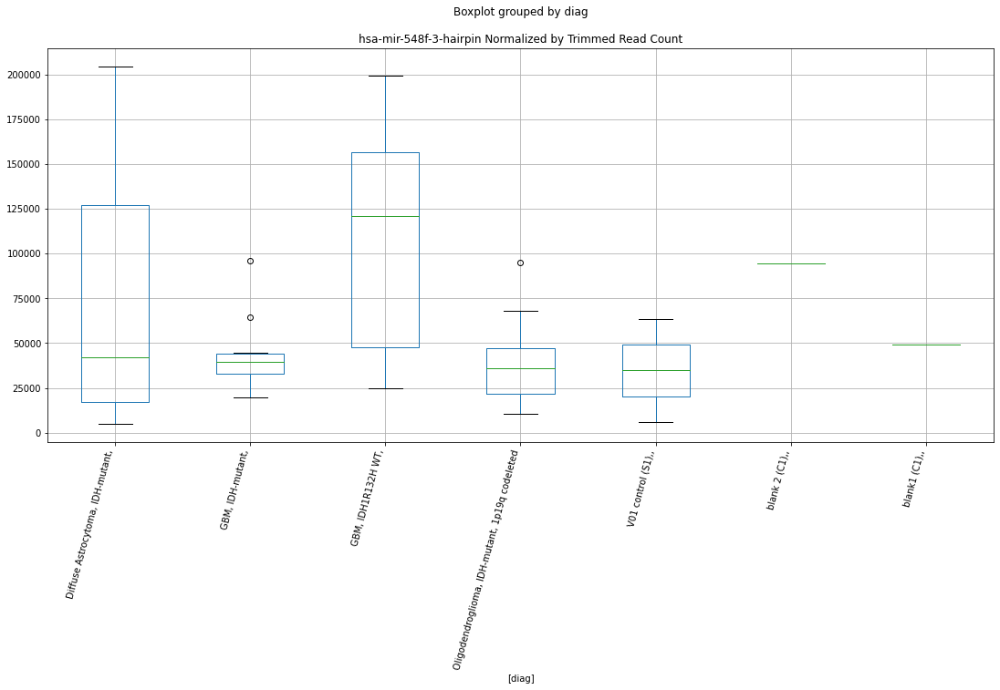

 p : 0.005757152840913125  ( t : 3.132323395335264 ) :  D-plex  :  bbduk2  :  hsa-mir-373-hairpin
Control and blanks
73     128319.39
337      5340.94
Name: hsa-mir-373-hairpin, dtype: float64
205    31340.92
Name: hsa-mir-373-hairpin, dtype: float64
469    41406.91
Name: hsa-mir-373-hairpin, dtype: float64


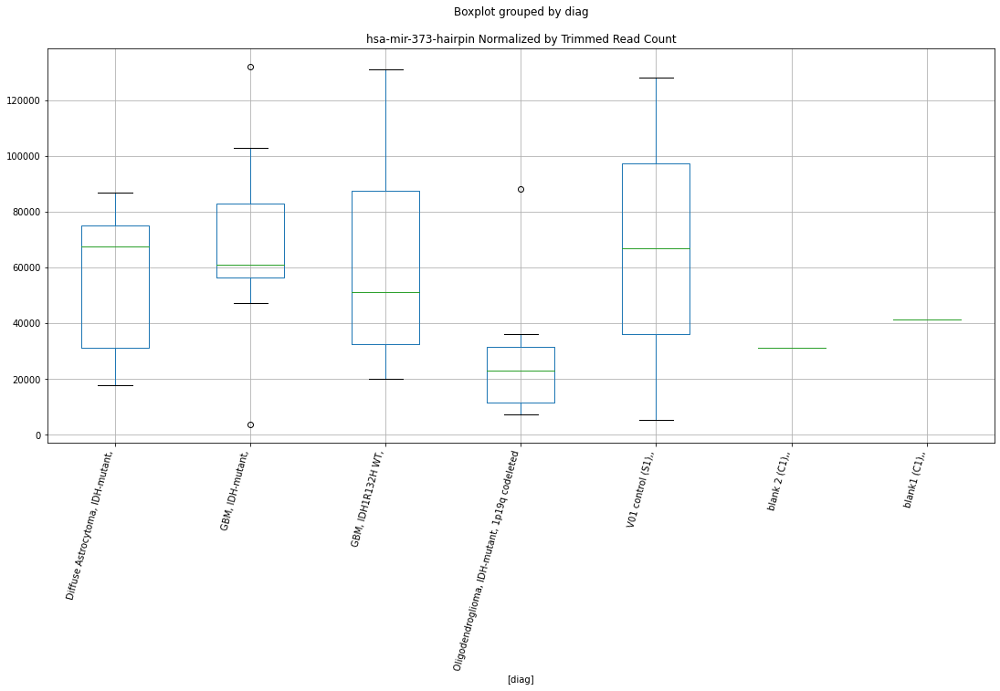

 p : 0.005840187756639579  ( t : 3.1257869011653807 ) :  D-plex  :  cutadapt2  :  hsa-mir-1290-hairpin
Control and blanks
76     12121.83
340    30825.62
Name: hsa-mir-1290-hairpin, dtype: float64
208    18517.82
Name: hsa-mir-1290-hairpin, dtype: float64
472    23696.19
Name: hsa-mir-1290-hairpin, dtype: float64


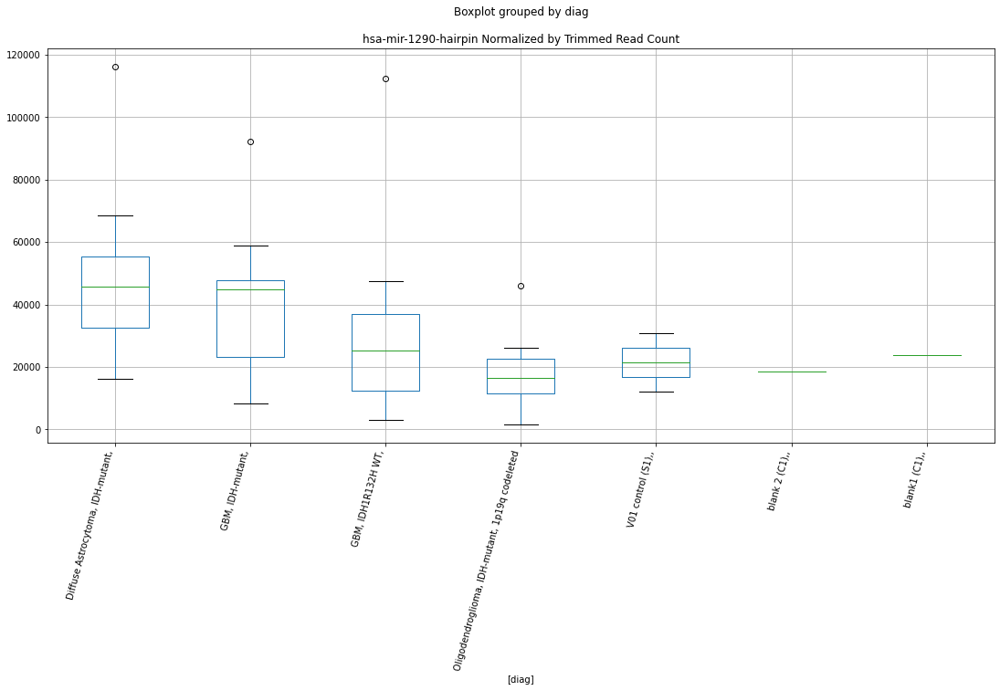

 p : 0.005870538639810556  ( t : 3.1234203086406334 ) :  D-plex  :  cutadapt2  :  hsa-mir-4272-mature
Control and blanks
76     757.61
340    880.73
Name: hsa-mir-4272-mature, dtype: float64
208    77245.78
Name: hsa-mir-4272-mature, dtype: float64
472    10981.16
Name: hsa-mir-4272-mature, dtype: float64


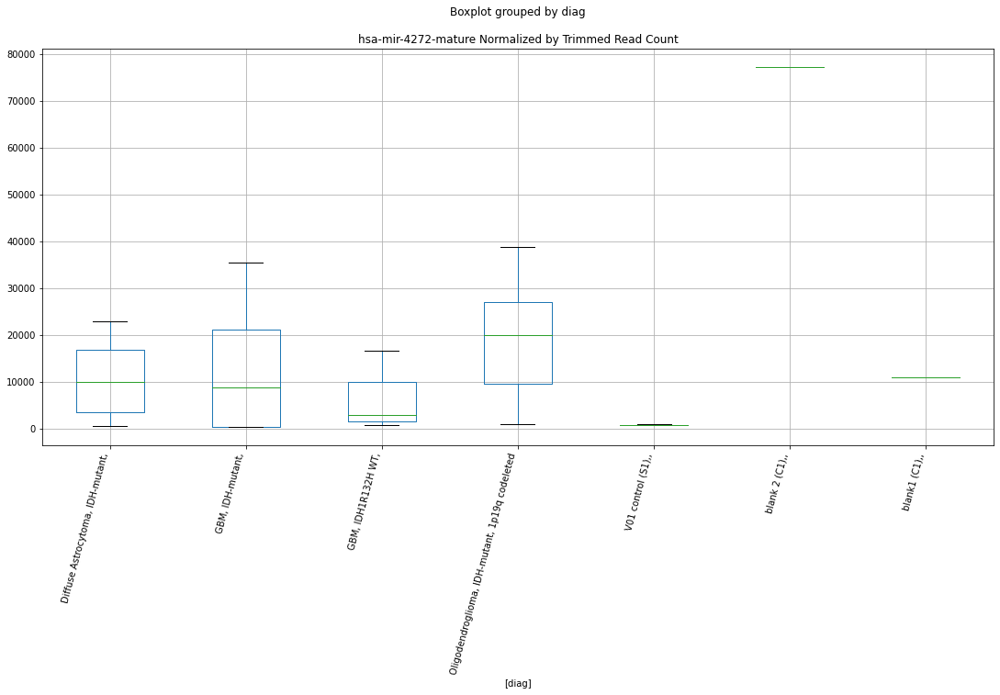

 p : 0.0059625109501545105  ( t : 3.116321076745985 ) :  D-plex  :  bbduk2  :  hsa-mir-411-hairpin
Control and blanks
73     23963.26
337    41837.39
Name: hsa-mir-411-hairpin, dtype: float64
205    22207.28
Name: hsa-mir-411-hairpin, dtype: float64
469    35491.64
Name: hsa-mir-411-hairpin, dtype: float64


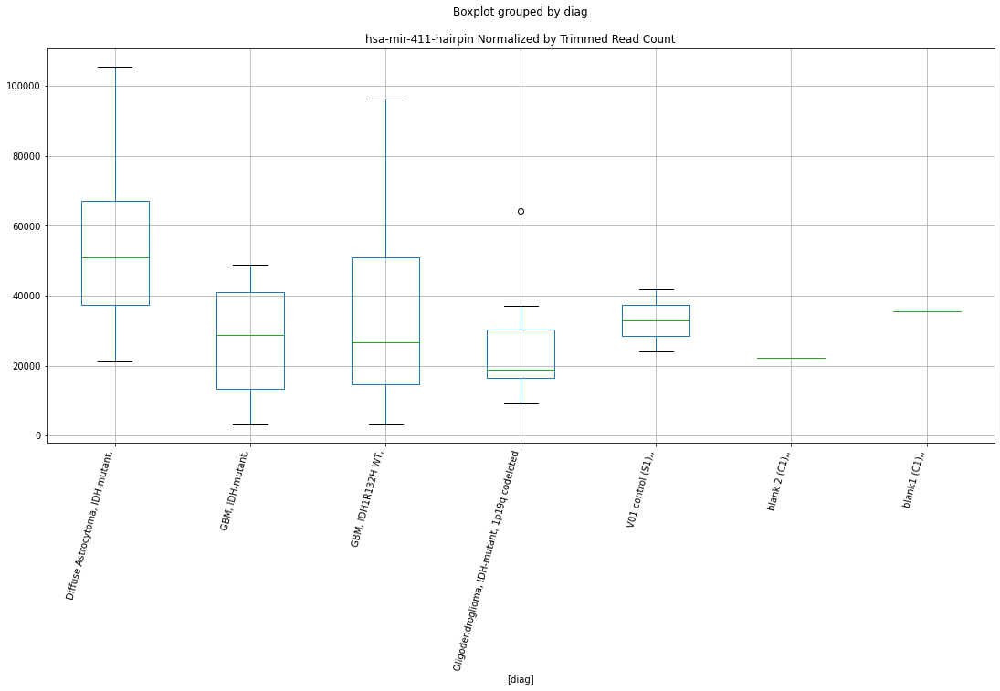

 p : 0.006070208479417303  ( t : 3.1081426361272255 ) :  D-plex  :  bbduk2  :  hsa-mir-6780a-3p-mature
Control and blanks
73     38650.42
337    11572.04
Name: hsa-mir-6780a-3p-mature, dtype: float64
205    11999.09
Name: hsa-mir-6780a-3p-mature, dtype: float64
469    13013.6
Name: hsa-mir-6780a-3p-mature, dtype: float64


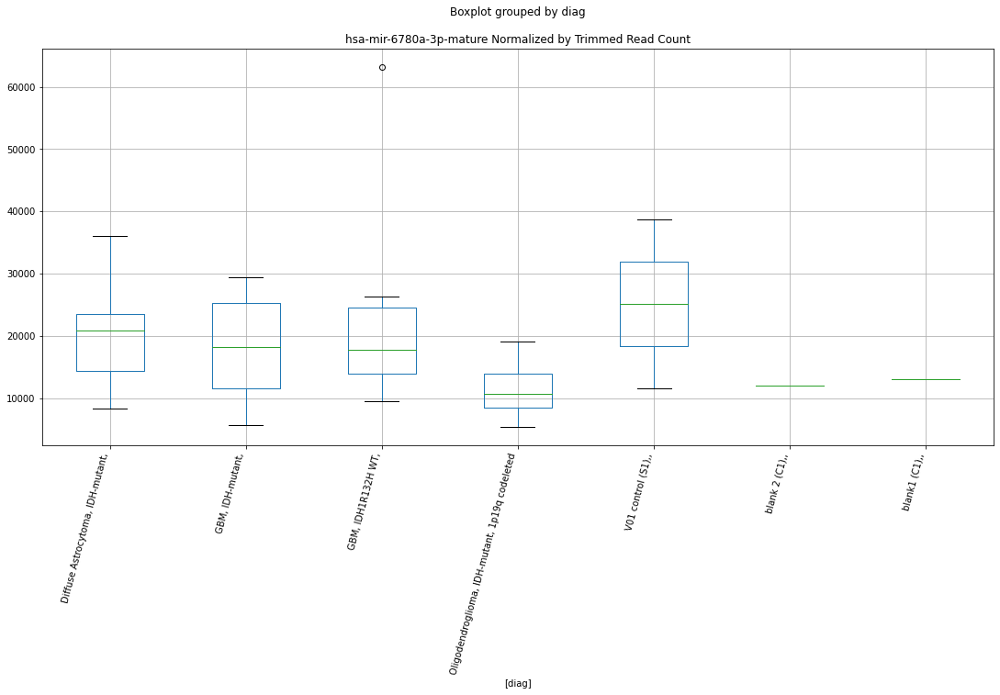

 p : 0.006080694821298875  ( t : 3.1073538922051163 ) :  D-plex  :  cutadapt2  :  hsa-mir-8084-hairpin
Control and blanks
76     101520.30
340    216660.11
Name: hsa-mir-8084-hairpin, dtype: float64
208    61902.44
Name: hsa-mir-8084-hairpin, dtype: float64
472    71666.52
Name: hsa-mir-8084-hairpin, dtype: float64


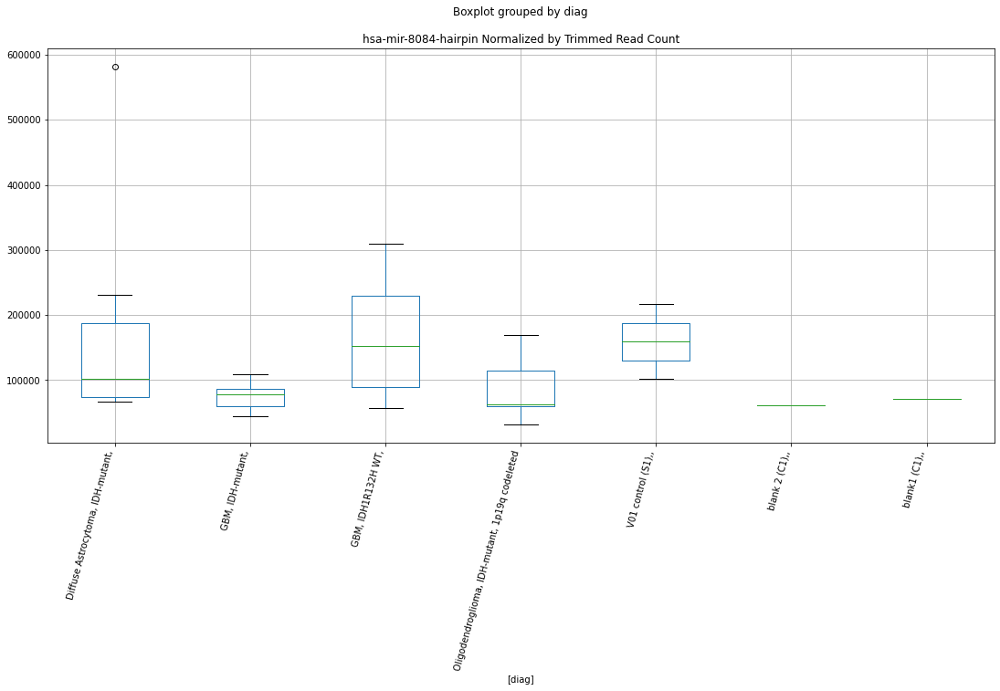

 p : 0.006129144651204372  ( t : 3.103726818452418 ) :  D-plex  :  bbduk2  :  hsa-mir-3907-hairpin
Control and blanks
73     268233.92
337     63201.17
Name: hsa-mir-3907-hairpin, dtype: float64
205    218132.78
Name: hsa-mir-3907-hairpin, dtype: float64
469    150839.47
Name: hsa-mir-3907-hairpin, dtype: float64


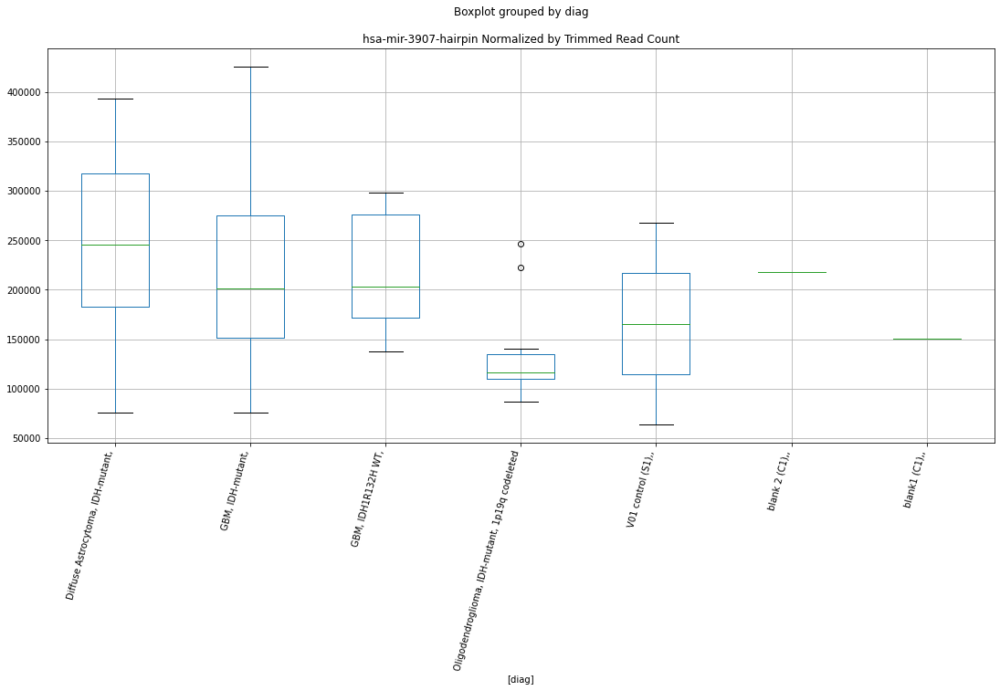

 p : 0.006467657989468202  ( t : 3.0791387057093504 ) :  Lexogen  :  bbduk2  :  hsa-mir-5003-hairpin
Control and blanks
79      1430.6
343    19320.6
Name: hsa-mir-5003-hairpin, dtype: float64
211    2733.06
Name: hsa-mir-5003-hairpin, dtype: float64
475    3832.25
Name: hsa-mir-5003-hairpin, dtype: float64


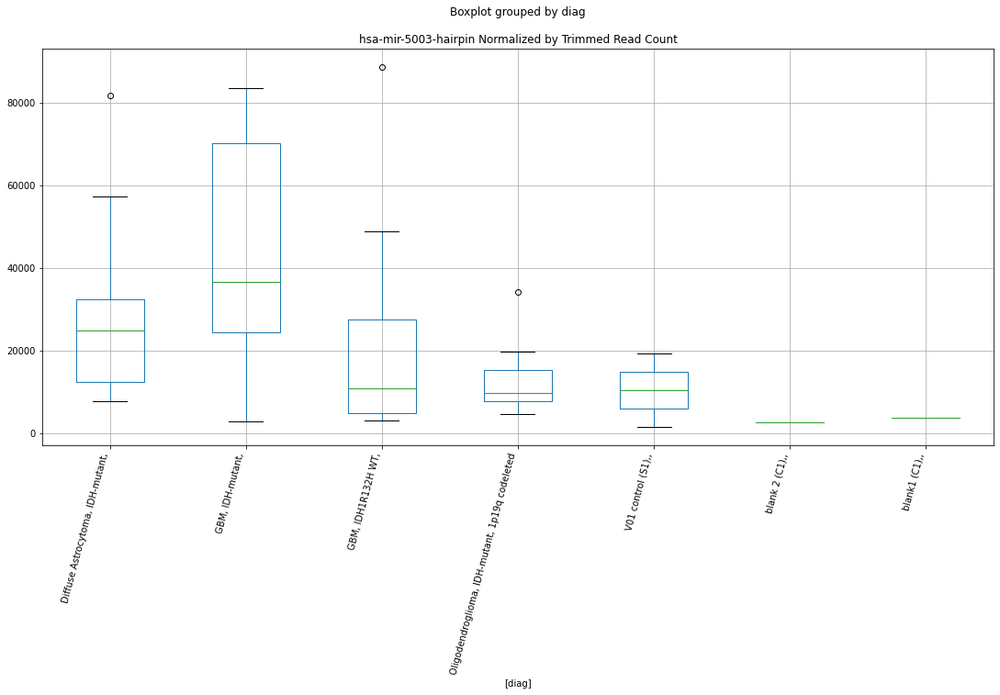

 p : 0.0064872221766859505  ( t : 3.0777562670450713 ) :  Lexogen  :  bbduk2  :  hsa-mir-3940-hairpin
Control and blanks
79          NaN
343    61571.15
Name: hsa-mir-3940-hairpin, dtype: float64
211   NaN
Name: hsa-mir-3940-hairpin, dtype: float64
475    718.55
Name: hsa-mir-3940-hairpin, dtype: float64


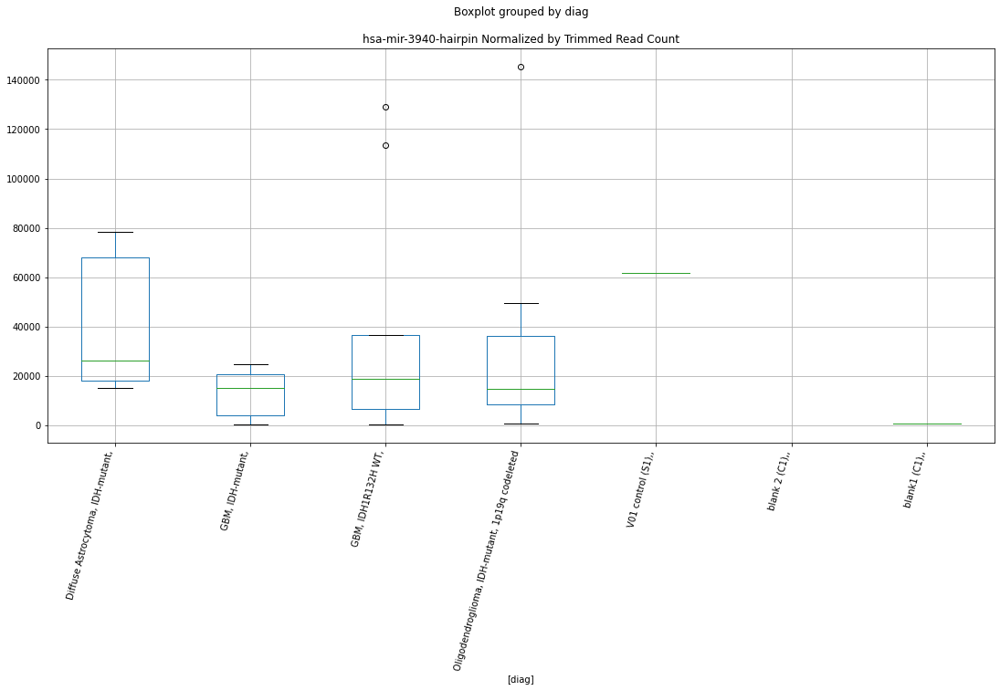

 p : 0.006520360898393193  ( t : 3.0754238697350664 ) :  D-plex  :  cutadapt2  :  hsa-mir-10392-hairpin
Control and blanks
76     37123.10
340    13210.98
Name: hsa-mir-10392-hairpin, dtype: float64
208    37917.45
Name: hsa-mir-10392-hairpin, dtype: float64
472    34677.35
Name: hsa-mir-10392-hairpin, dtype: float64


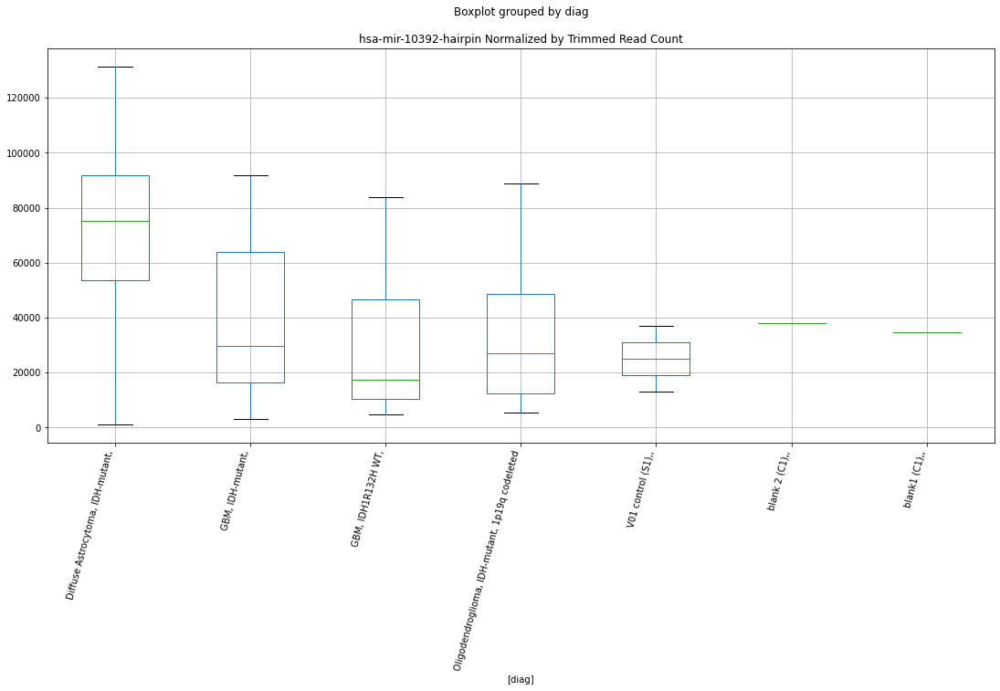

 p : 0.006555479307903318  ( t : 3.072964706392886 ) :  D-plex  :  bbduk2  :  hsa-mir-8084-hairpin
Control and blanks
73     107448.17
337    223429.47
Name: hsa-mir-8084-hairpin, dtype: float64
205    64830.92
Name: hsa-mir-8084-hairpin, dtype: float64
469    80447.72
Name: hsa-mir-8084-hairpin, dtype: float64


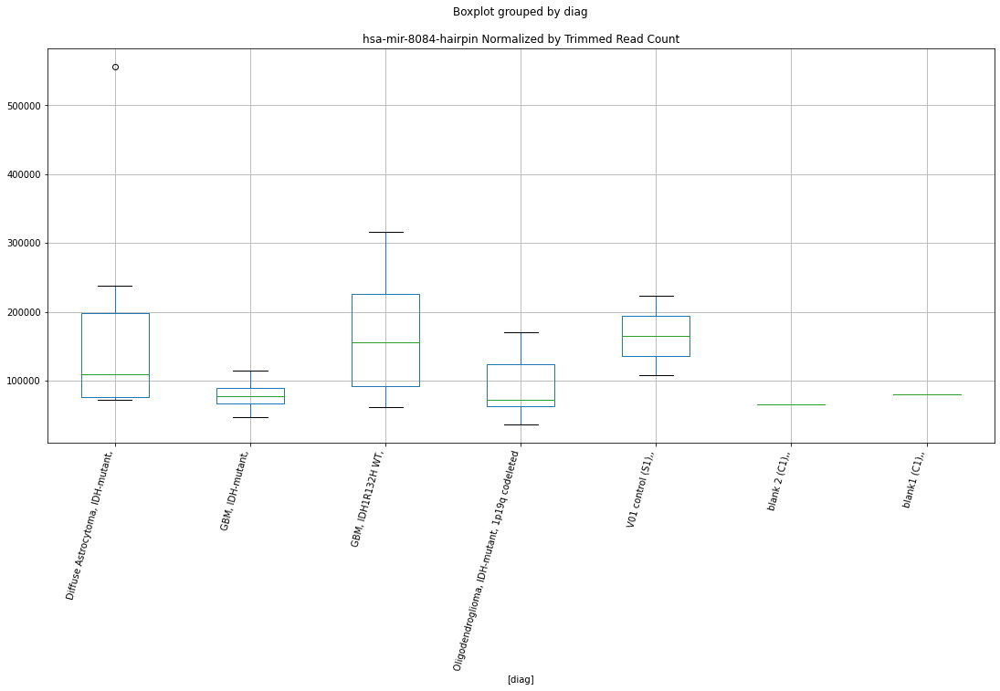

 p : 0.006576783397811875  ( t : 3.0714791355985334 ) :  D-plex  :  cutadapt2  :  hsa-mir-3130-2-hairpin
Control and blanks
76     64397.21
340     3522.93
Name: hsa-mir-3130-2-hairpin, dtype: float64
208    112517.82
Name: hsa-mir-3130-2-hairpin, dtype: float64
472    45658.51
Name: hsa-mir-3130-2-hairpin, dtype: float64


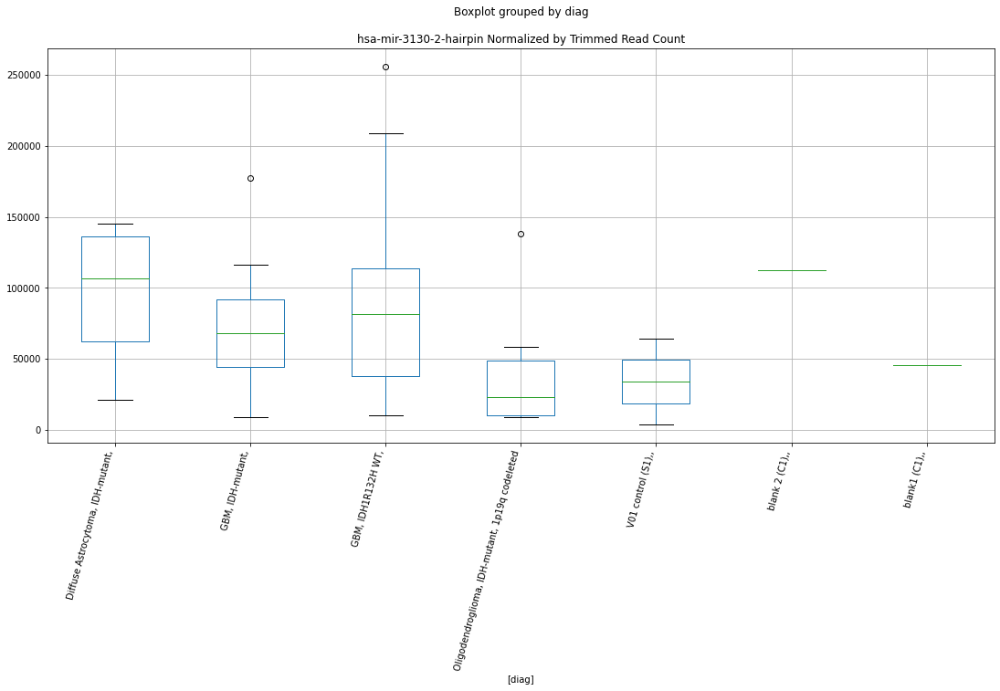

 p : 0.006576783397811875  ( t : 3.0714791355985334 ) :  D-plex  :  cutadapt2  :  hsa-mir-3130-1-hairpin
Control and blanks
76     64397.21
340     3522.93
Name: hsa-mir-3130-1-hairpin, dtype: float64
208    112517.82
Name: hsa-mir-3130-1-hairpin, dtype: float64
472    45658.51
Name: hsa-mir-3130-1-hairpin, dtype: float64


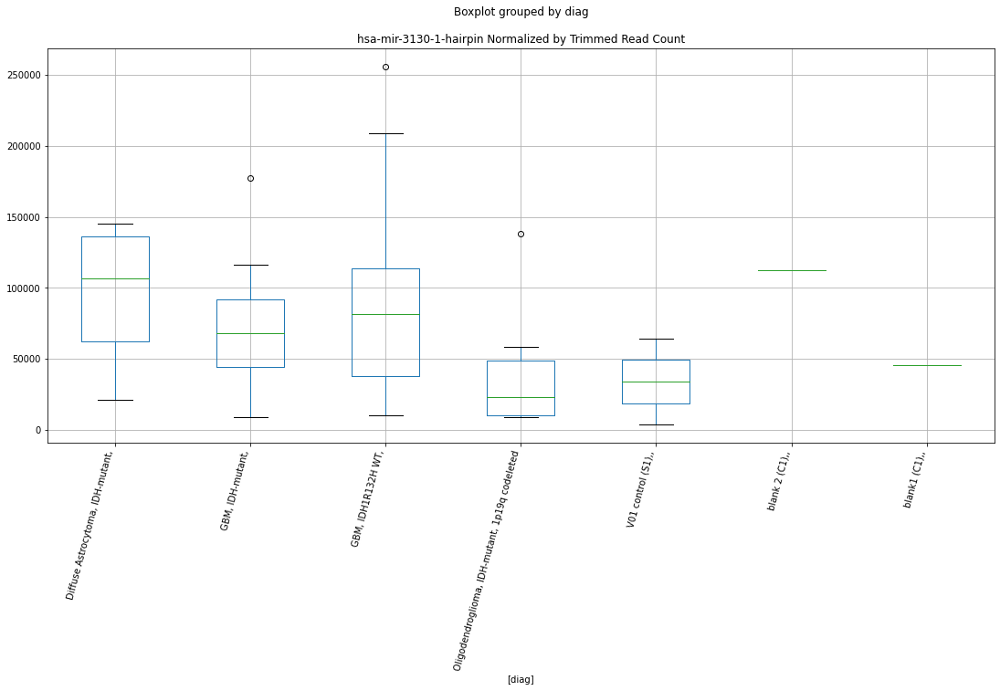

 p : 0.006664463613001399  ( t : 3.065413981261943 ) :  D-plex  :  bbduk2  :  hsa-mir-9-1-hairpin
Control and blanks
73     118270.29
337    145095.63
Name: hsa-mir-9-1-hairpin, dtype: float64
205    90978.2
Name: hsa-mir-9-1-hairpin, dtype: float64
469    44364.55
Name: hsa-mir-9-1-hairpin, dtype: float64


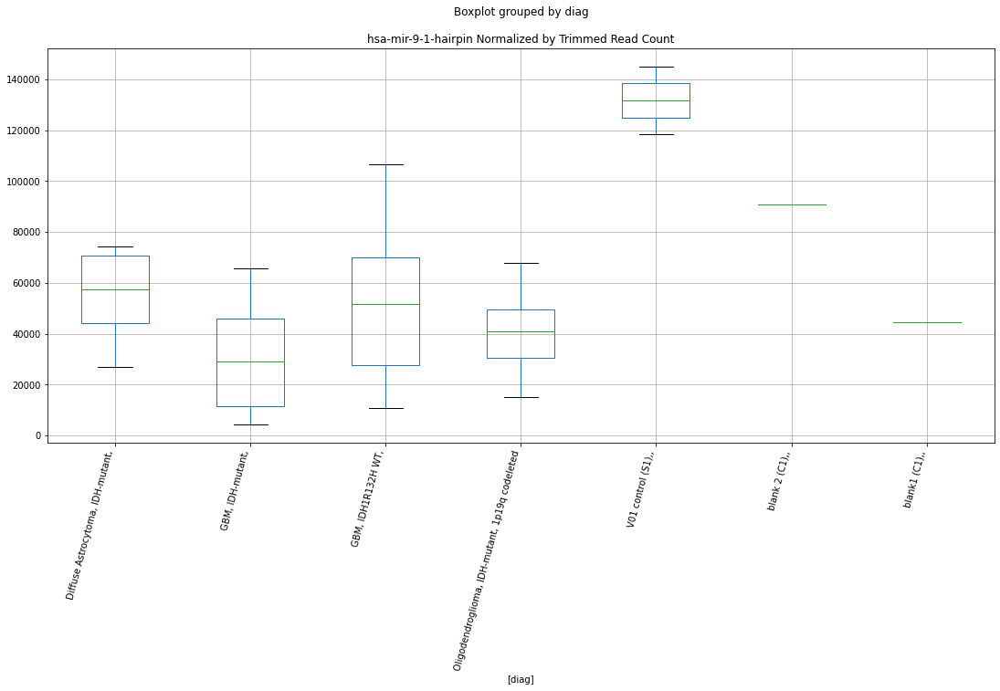

 p : 0.006716444075265163  ( t : 3.061854890168784 ) :  D-plex  :  cutadapt2  :  hsa-mir-6794-5p-mature
Control and blanks
76     27274.11
340     1761.46
Name: hsa-mir-6794-5p-mature, dtype: float64
208    35624.76
Name: hsa-mir-6794-5p-mature, dtype: float64
472    10981.16
Name: hsa-mir-6794-5p-mature, dtype: float64


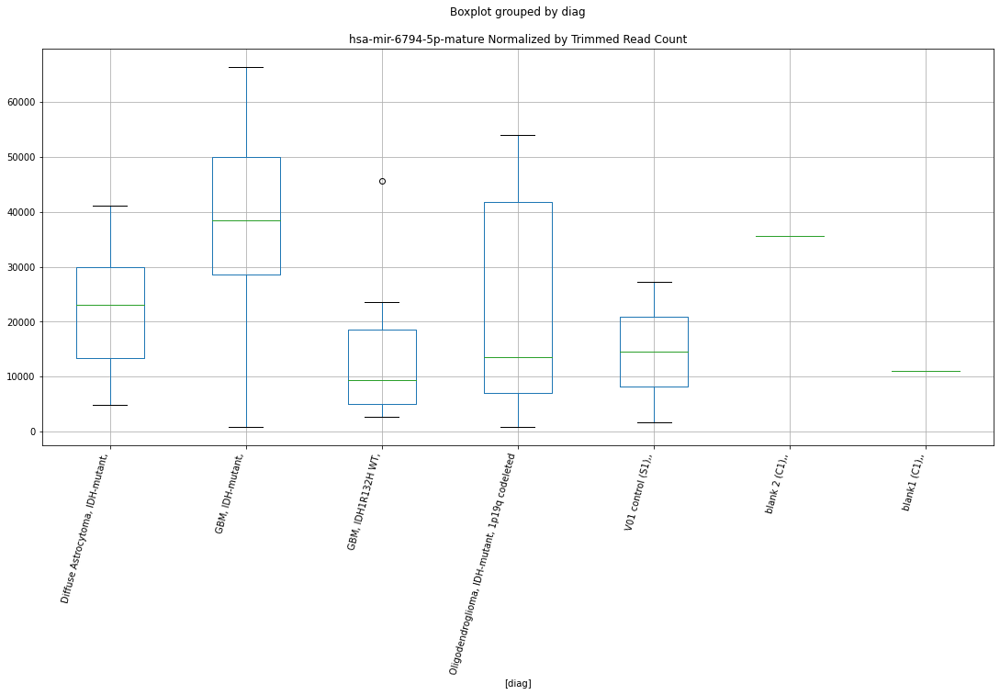

 p : 0.0068216192094144555  ( t : 3.0547348654974877 ) :  D-plex  :  cutadapt2  :  hsa-mir-1343-5p-mature
Control and blanks
76     5303.3
340    2642.2
Name: hsa-mir-1343-5p-mature, dtype: float64
208    20810.51
Name: hsa-mir-1343-5p-mature, dtype: float64
472    11559.12
Name: hsa-mir-1343-5p-mature, dtype: float64


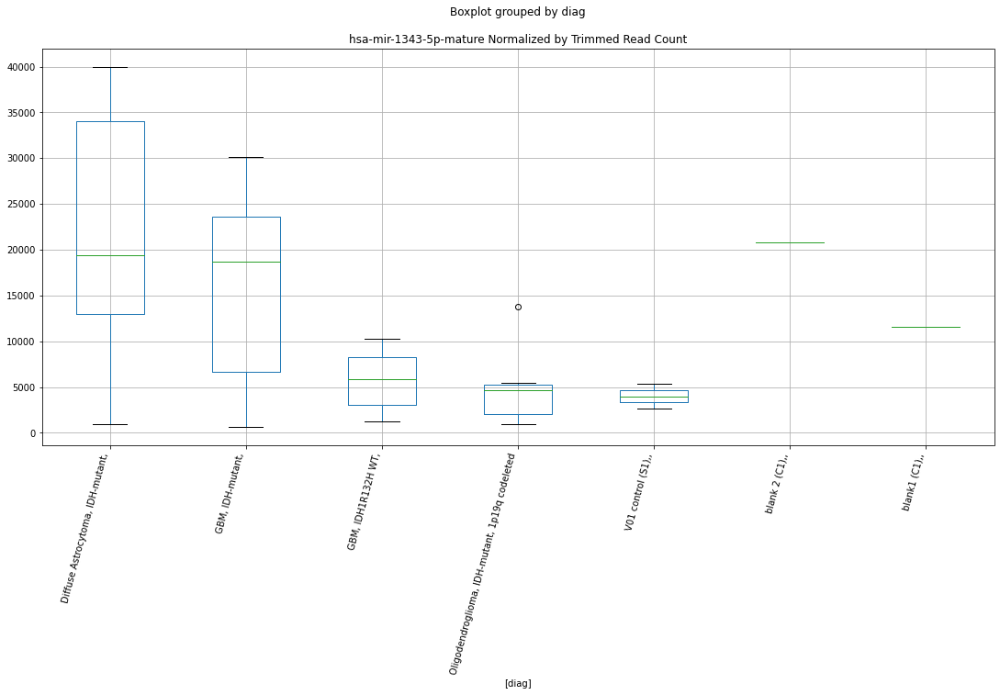

 p : 0.0068685120127693735  ( t : 3.0515947466286772 ) :  D-plex  :  bbduk2  :  hsa-mir-6794-5p-mature
Control and blanks
73     26282.29
337     1780.31
Name: hsa-mir-6794-5p-mature, dtype: float64
205    35639.1
Name: hsa-mir-6794-5p-mature, dtype: float64
469    11239.02
Name: hsa-mir-6794-5p-mature, dtype: float64


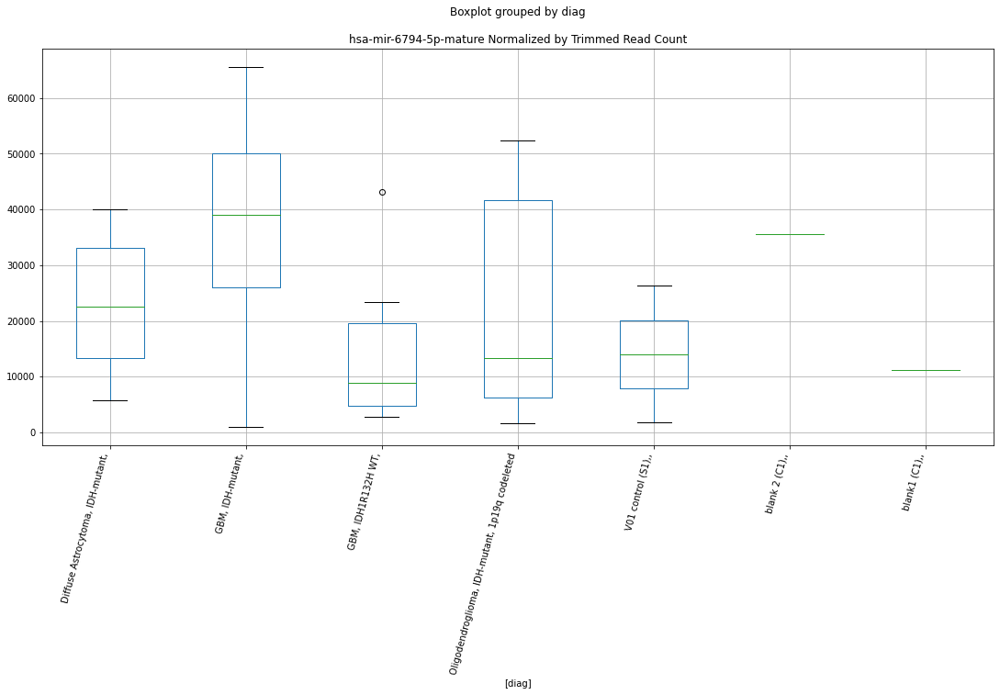

 p : 0.006951691252680666  ( t : 3.0460757282006696 ) :  D-plex  :  bbduk2  :  hsa-mir-548f-5-hairpin
Control and blanks
73     138368.50
337     54299.59
Name: hsa-mir-548f-5-hairpin, dtype: float64
205    56413.65
Name: hsa-mir-548f-5-hairpin, dtype: float64
469    62110.37
Name: hsa-mir-548f-5-hairpin, dtype: float64


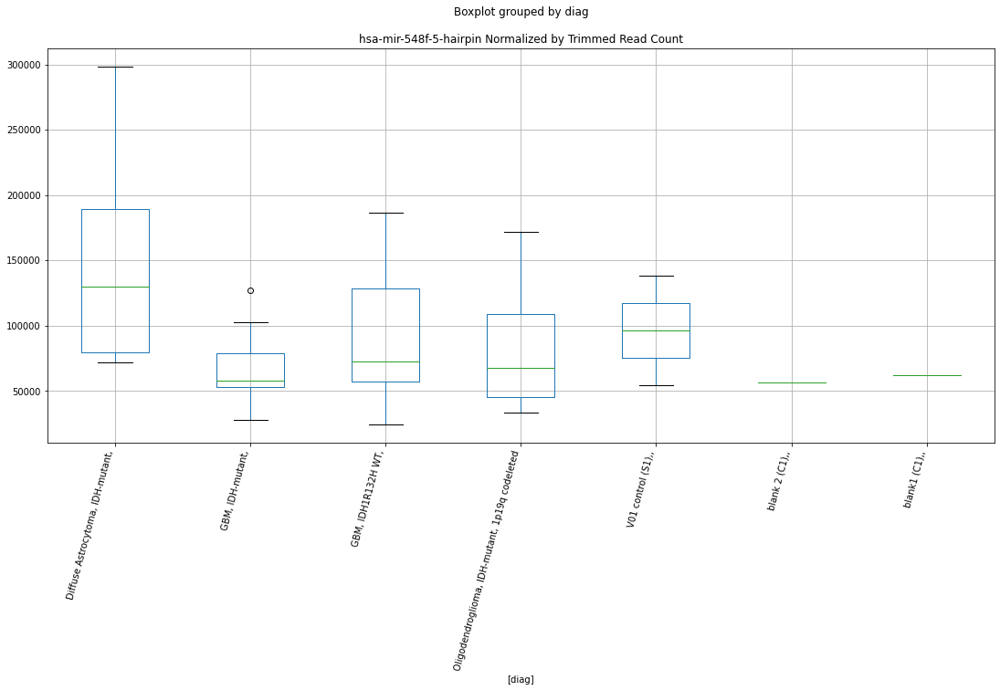

 p : 0.007004879913482656  ( t : 3.0425801899597857 ) :  D-plex  :  bbduk2  :  hsa-mir-10392-hairpin
Control and blanks
73     38650.42
337    13352.36
Name: hsa-mir-10392-hairpin, dtype: float64
205    38862.74
Name: hsa-mir-10392-hairpin, dtype: float64
469    34900.11
Name: hsa-mir-10392-hairpin, dtype: float64


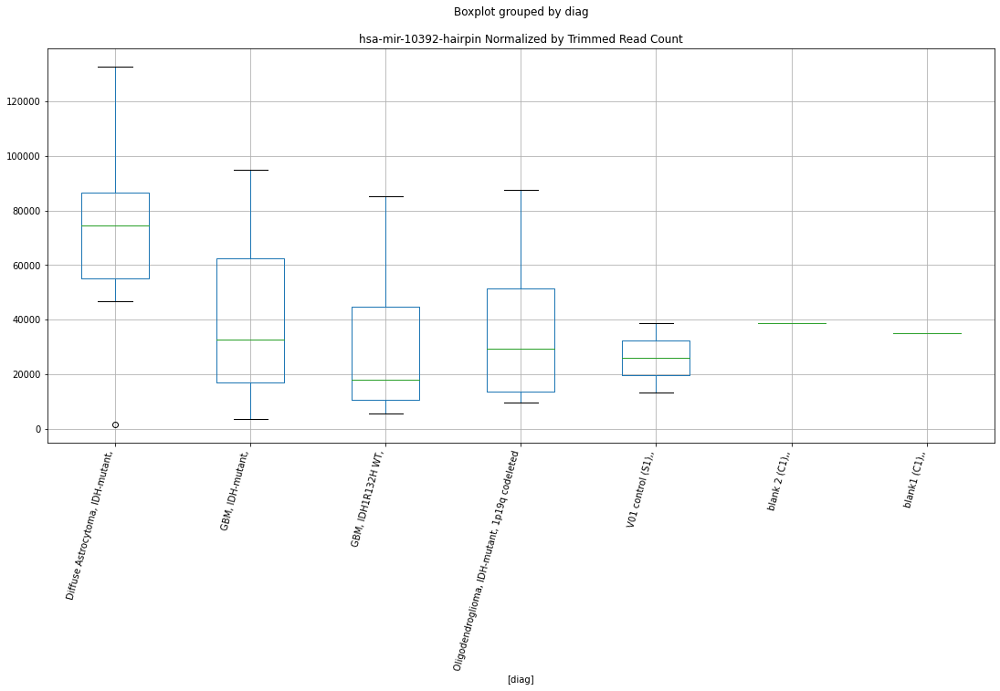

 p : 0.007040830418510649  ( t : 3.0402321297679205 ) :  D-plex  :  bbduk2  :  hsa-mir-4672-hairpin
Control and blanks
73      26282.29
337    380987.31
Name: hsa-mir-4672-hairpin, dtype: float64
205    96709.11
Name: hsa-mir-4672-hairpin, dtype: float64
469    89320.62
Name: hsa-mir-4672-hairpin, dtype: float64


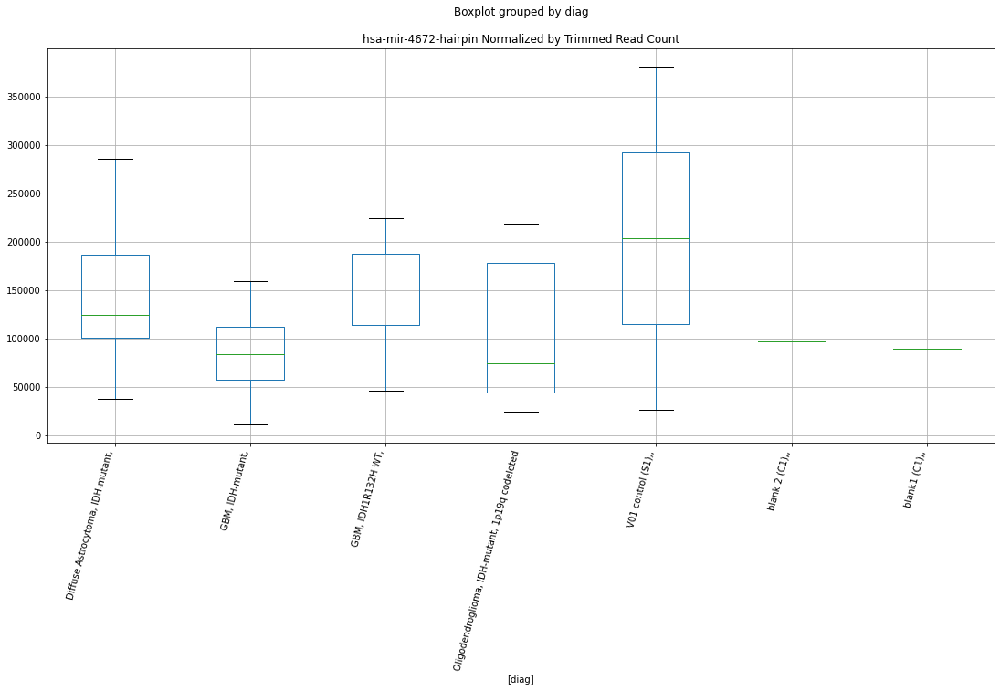

 p : 0.007133538910417155  ( t : 3.034230388084381 ) :  D-plex  :  cutadapt2  :  hsa-mir-3907-hairpin
Control and blanks
76     252285.53
340     71339.30
Name: hsa-mir-3907-hairpin, dtype: float64
208    207399.62
Name: hsa-mir-3907-hairpin, dtype: float64
472    141021.22
Name: hsa-mir-3907-hairpin, dtype: float64


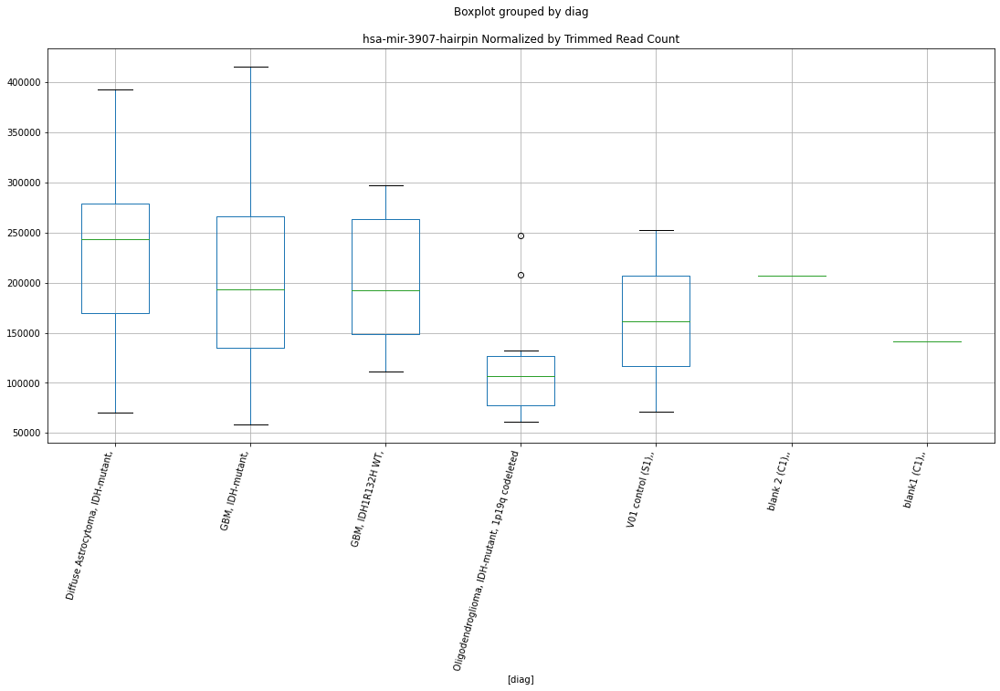

 p : 0.007202826575658416  ( t : 3.0297941797366317 ) :  D-plex  :  cutadapt2  :  hsa-mir-4477a-hairpin
Control and blanks
76      3030.46
340    19376.11
Name: hsa-mir-4477a-hairpin, dtype: float64
208    27864.91
Name: hsa-mir-4477a-hairpin, dtype: float64
472    28319.84
Name: hsa-mir-4477a-hairpin, dtype: float64


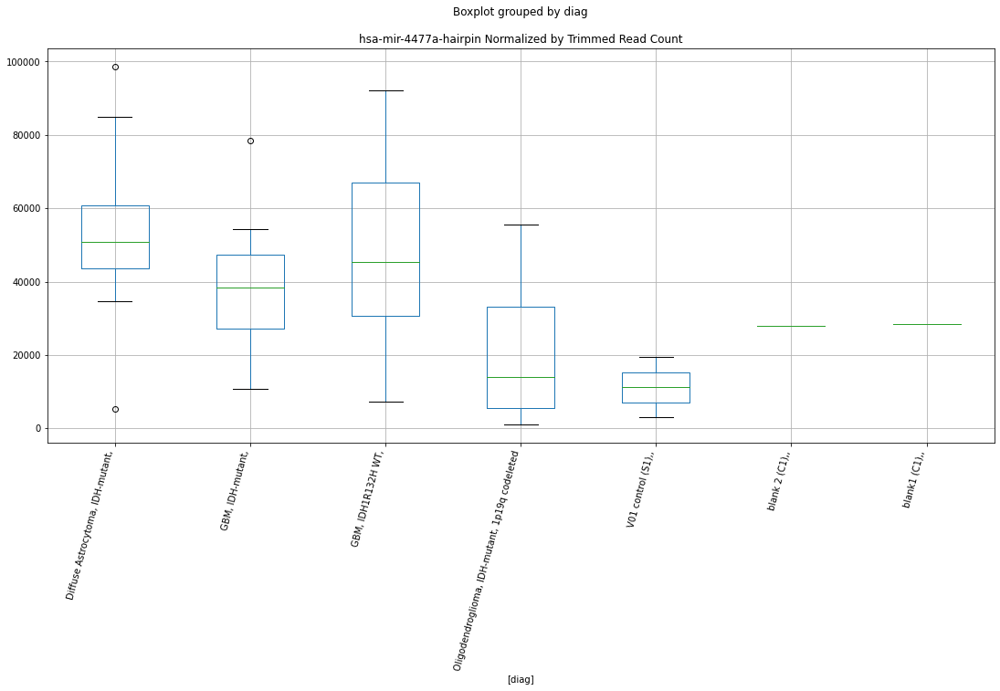

 p : 0.007202826575658416  ( t : 3.0297941797366317 ) :  D-plex  :  cutadapt2  :  hsa-mir-4477b-hairpin
Control and blanks
76      3030.46
340    19376.11
Name: hsa-mir-4477b-hairpin, dtype: float64
208    27864.91
Name: hsa-mir-4477b-hairpin, dtype: float64
472    28319.84
Name: hsa-mir-4477b-hairpin, dtype: float64


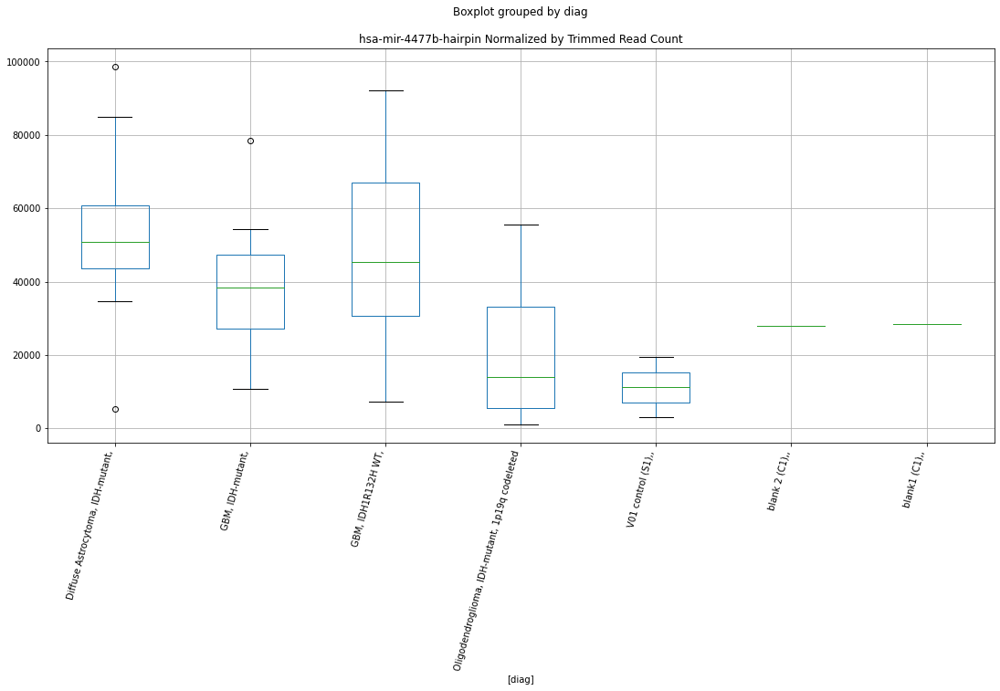

 p : 0.007208920899847757  ( t : 3.029405972160186 ) :  D-plex  :  bbduk2  :  hsa-mir-3059-3p-mature
Control and blanks
73     136049.48
337     32045.66
Name: hsa-mir-3059-3p-mature, dtype: float64
205    41549.1
Name: hsa-mir-3059-3p-mature, dtype: float64
469    49688.29
Name: hsa-mir-3059-3p-mature, dtype: float64


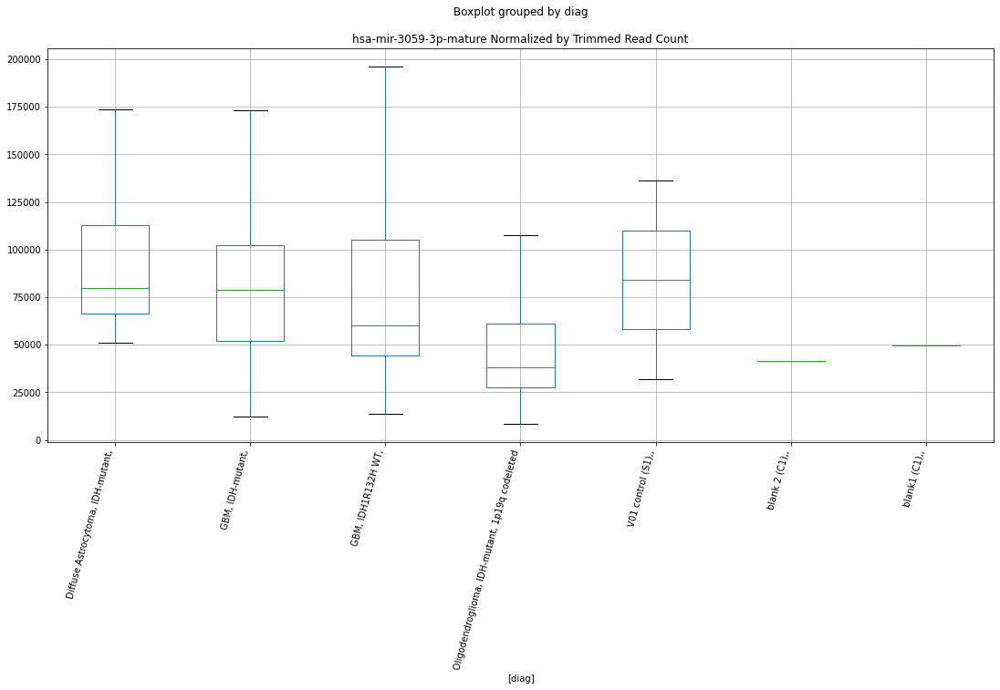

 p : 0.007211710758772366  ( t : 3.029228364992341 ) :  D-plex  :  bbduk2  :  hsa-mir-155-hairpin
Control and blanks
73     89668.97
337     2670.47
Name: hsa-mir-155-hairpin, dtype: float64
205    20595.46
Name: hsa-mir-155-hairpin, dtype: float64
469    30759.42
Name: hsa-mir-155-hairpin, dtype: float64


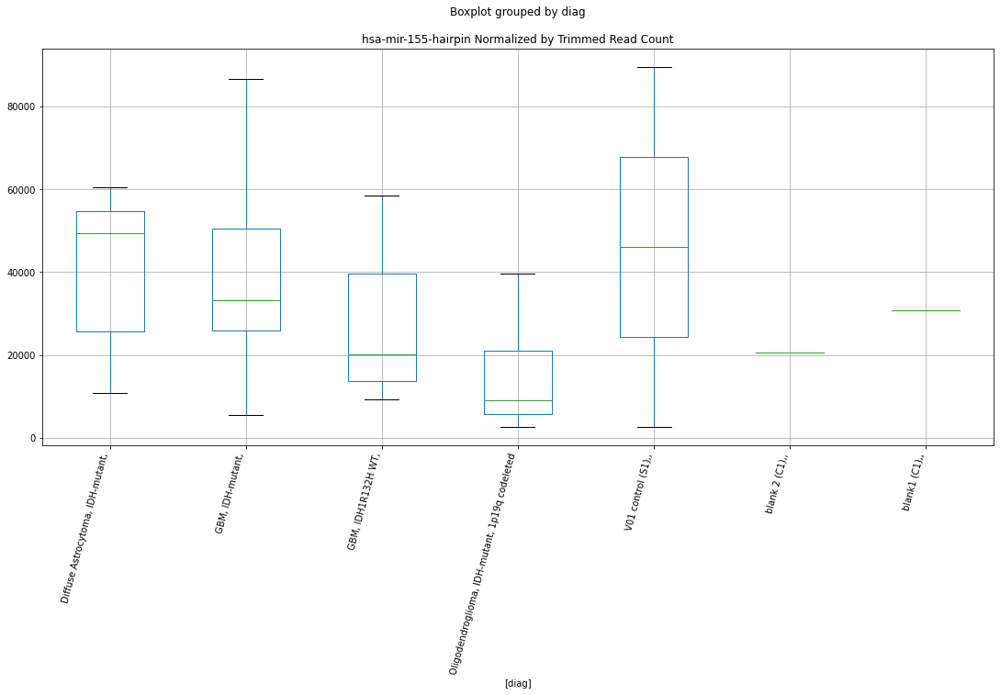

 p : 0.007225230243709355  ( t : 3.0283686365595868 ) :  D-plex  :  cutadapt2  :  hsa-mir-373-hairpin
Control and blanks
76     106065.99
340      3522.93
Name: hsa-mir-373-hairpin, dtype: float64
208    29981.24
Name: hsa-mir-373-hairpin, dtype: float64
472    39301.0
Name: hsa-mir-373-hairpin, dtype: float64


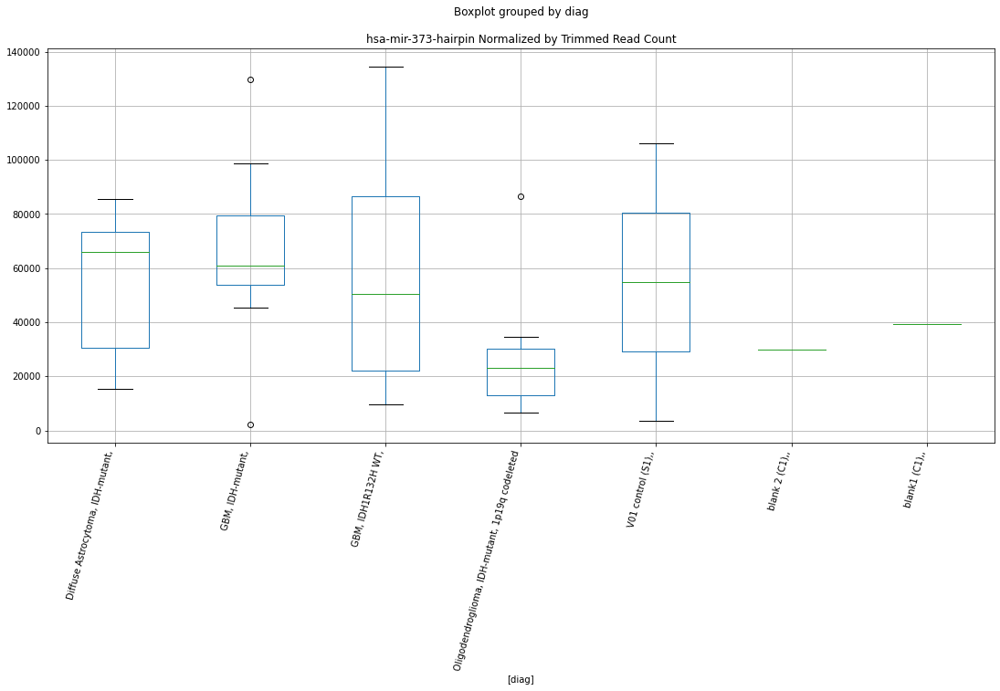

 p : 0.0072927091878451766  ( t : 3.024100774254661 ) :  D-plex  :  cutadapt2  :  hsa-mir-1915-hairpin
Control and blanks
76     113642.13
340      8807.32
Name: hsa-mir-1915-hairpin, dtype: float64
208    89590.99
Name: hsa-mir-1915-hairpin, dtype: float64
472    33521.44
Name: hsa-mir-1915-hairpin, dtype: float64


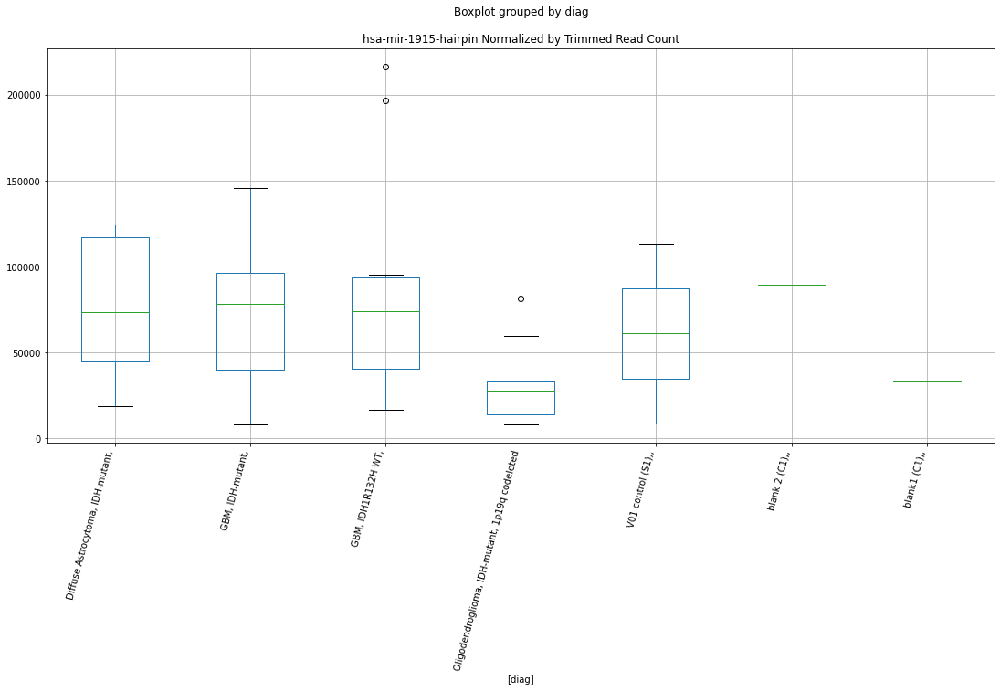

 p : 0.007389061224667331  ( t : 3.018072825403359 ) :  D-plex  :  cutadapt2  :  hsa-mir-548f-5-hairpin
Control and blanks
76     136370.56
340     54605.39
Name: hsa-mir-548f-5-hairpin, dtype: float64
208    54318.95
Name: hsa-mir-548f-5-hairpin, dtype: float64
472    57217.63
Name: hsa-mir-548f-5-hairpin, dtype: float64


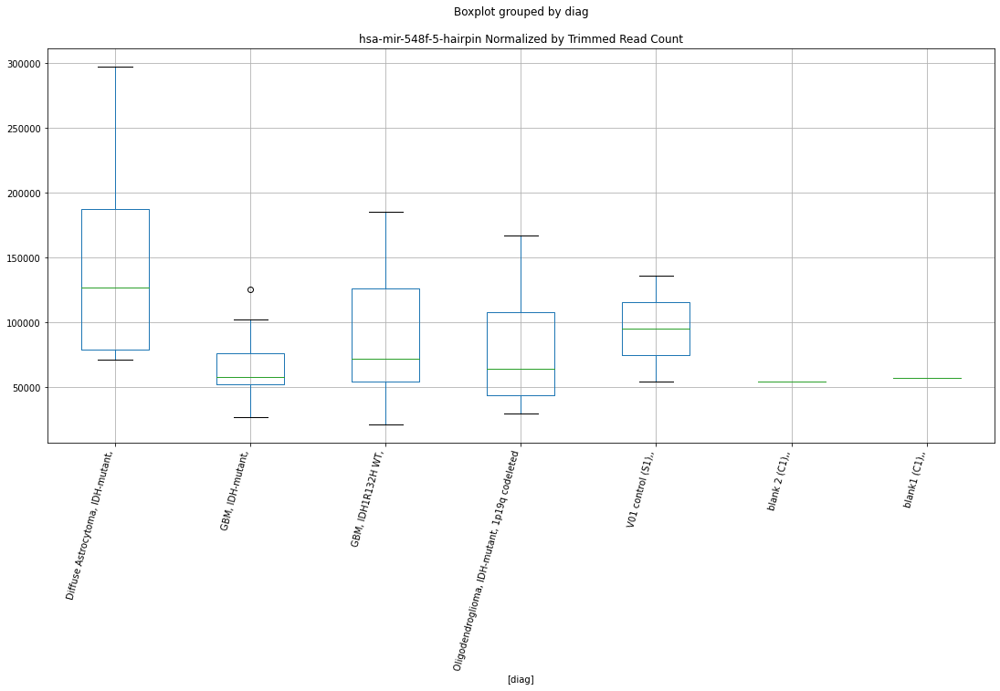

 p : 0.0075048571925919695  ( t : 3.010928671973357 ) :  Lexogen  :  bbduk2  :  hsa-mir-3942-hairpin
Control and blanks
79         NaN
343    3184.71
Name: hsa-mir-3942-hairpin, dtype: float64
211    819.92
Name: hsa-mir-3942-hairpin, dtype: float64
475    718.55
Name: hsa-mir-3942-hairpin, dtype: float64


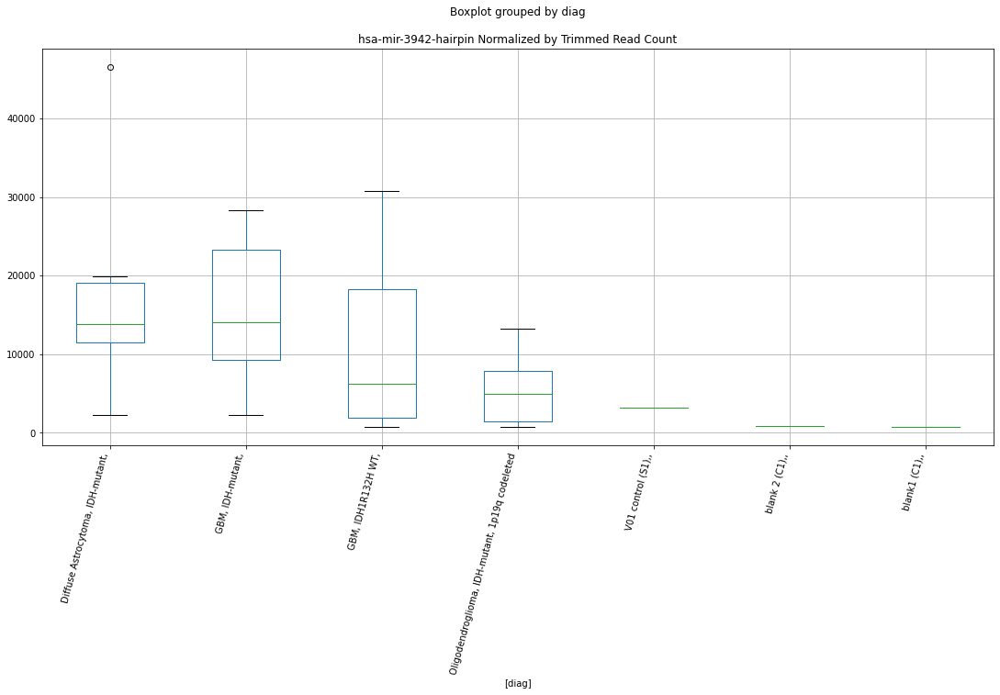

 p : 0.007514583485373978  ( t : 3.010333481790139 ) :  D-plex  :  bbduk2  :  hsa-mir-4756-hairpin
Control and blanks
73     26282.29
337     2670.47
Name: hsa-mir-4756-hairpin, dtype: float64
205    33848.19
Name: hsa-mir-4756-hairpin, dtype: float64
469    28984.84
Name: hsa-mir-4756-hairpin, dtype: float64


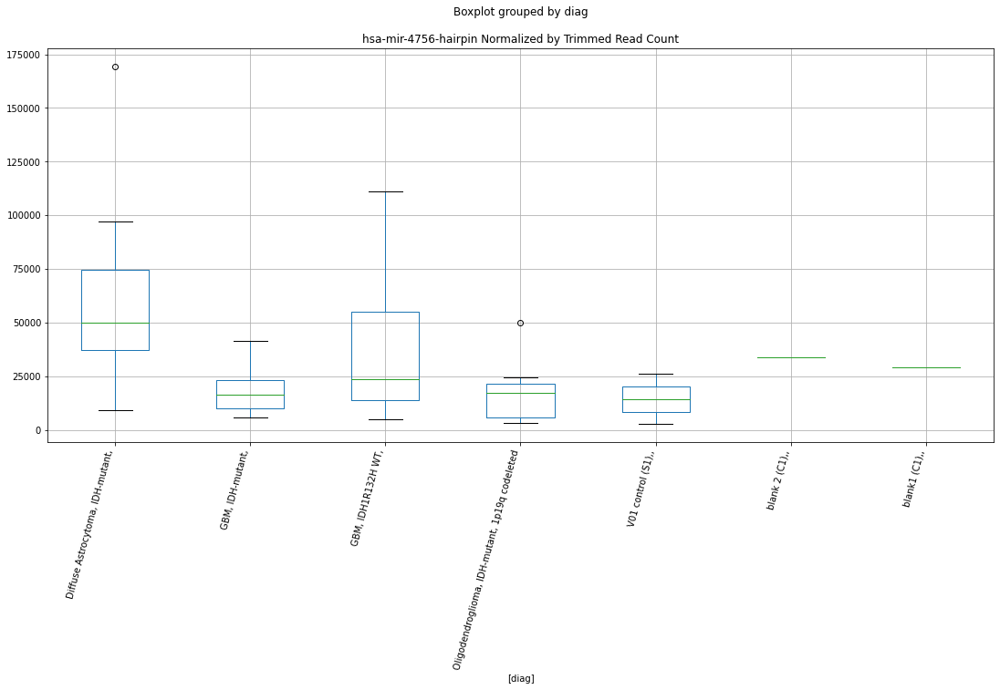

 p : 0.00758232737331699  ( t : 3.0062086027341772 ) :  D-plex  :  cutadapt2  :  hsa-mir-3199-1-hairpin
Control and blanks
76     3030.46
340    2642.20
Name: hsa-mir-3199-1-hairpin, dtype: float64
208    11287.05
Name: hsa-mir-3199-1-hairpin, dtype: float64
472    9825.25
Name: hsa-mir-3199-1-hairpin, dtype: float64


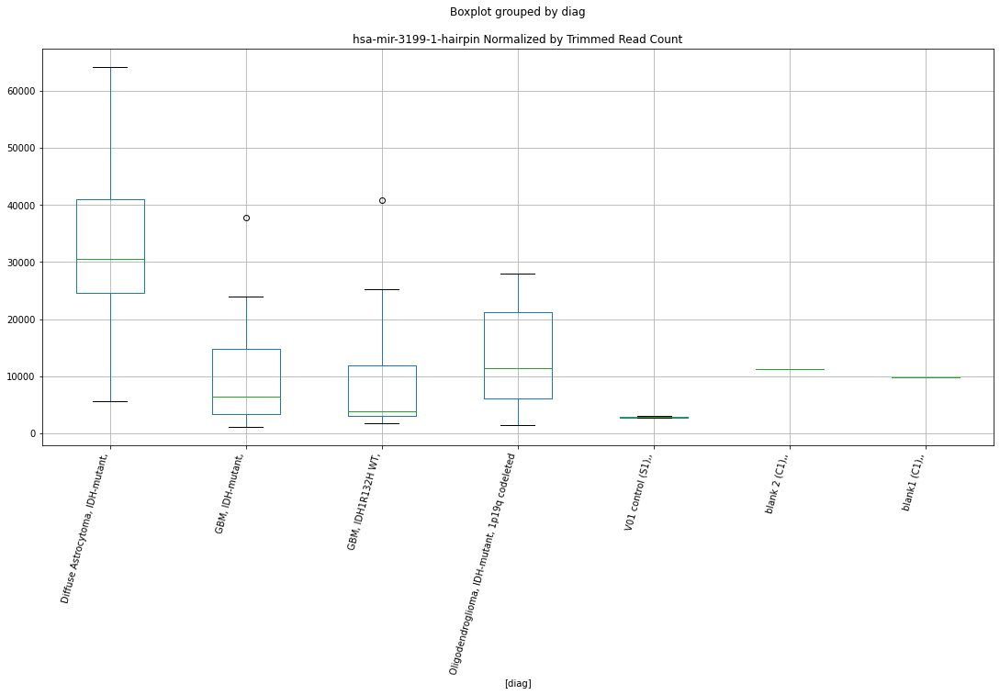

 p : 0.00762565738583644  ( t : 3.0035889928619888 ) :  Lexogen  :  cutadapt2  :  hsa-mir-122b-hairpin
Control and blanks
82      2840.10
346    21885.19
Name: hsa-mir-122b-hairpin, dtype: float64
214    4068.4
Name: hsa-mir-122b-hairpin, dtype: float64
478    4986.67
Name: hsa-mir-122b-hairpin, dtype: float64


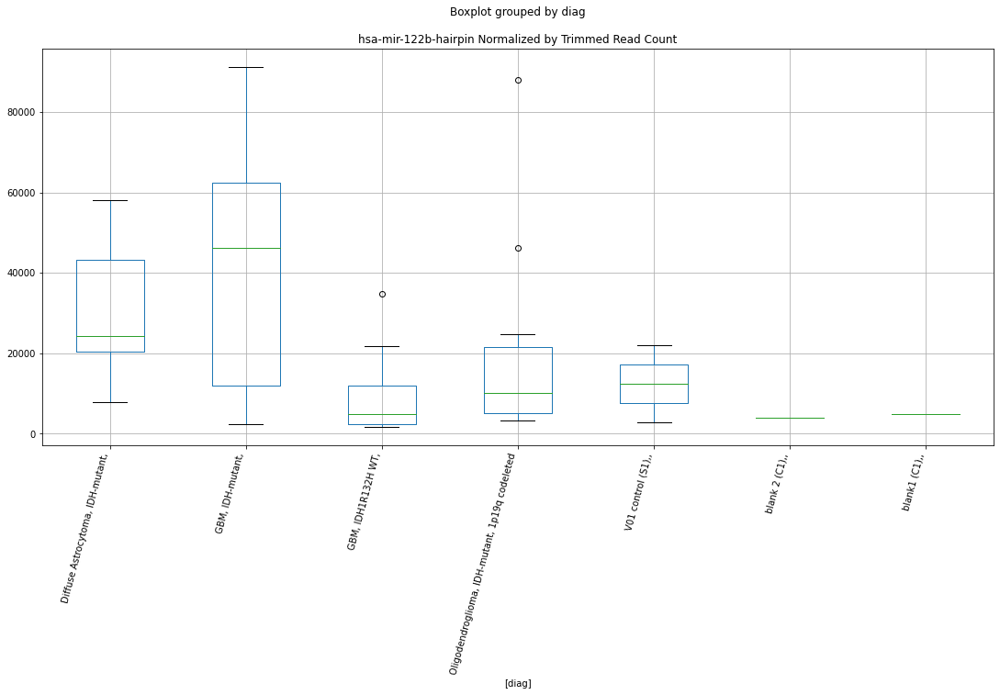

 p : 0.007685857672334673  ( t : 2.9999733423183264 ) :  D-plex  :  bbduk2  :  hsa-mir-1915-hairpin
Control and blanks
73     117497.28
337     10681.89
Name: hsa-mir-1915-hairpin, dtype: float64
205    88829.11
Name: hsa-mir-1915-hairpin, dtype: float64
469    33125.53
Name: hsa-mir-1915-hairpin, dtype: float64


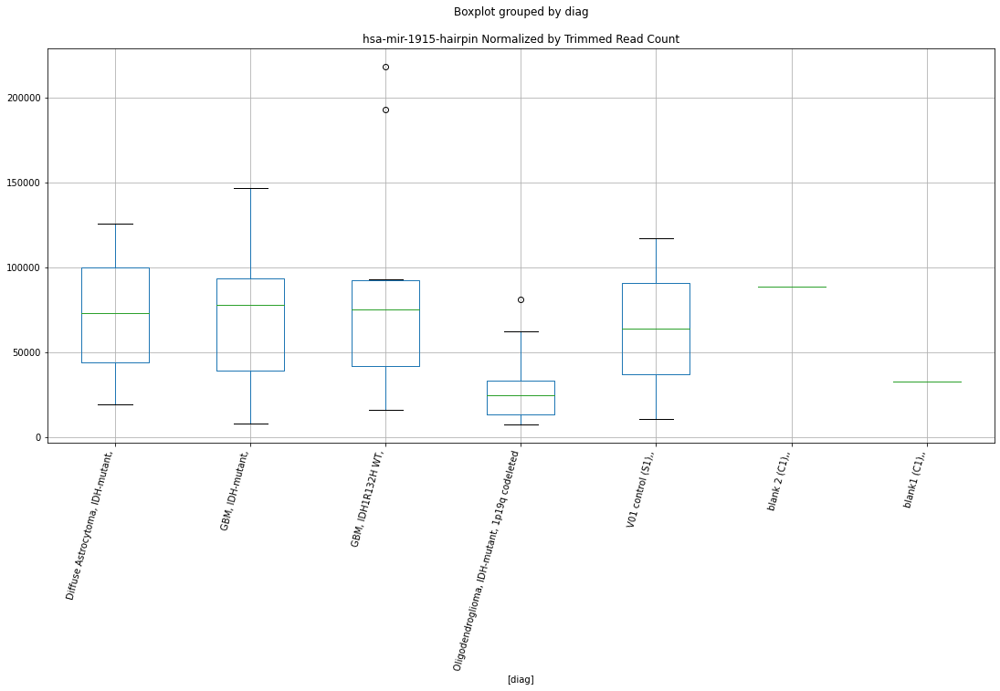

 p : 0.00774184227845827  ( t : 2.9966354754835343 ) :  D-plex  :  bbduk2  :  hsa-mir-3199-1-hairpin
Control and blanks
73     3092.03
337    2670.47
Name: hsa-mir-3199-1-hairpin, dtype: float64
205    11820.0
Name: hsa-mir-3199-1-hairpin, dtype: float64
469    18337.35
Name: hsa-mir-3199-1-hairpin, dtype: float64


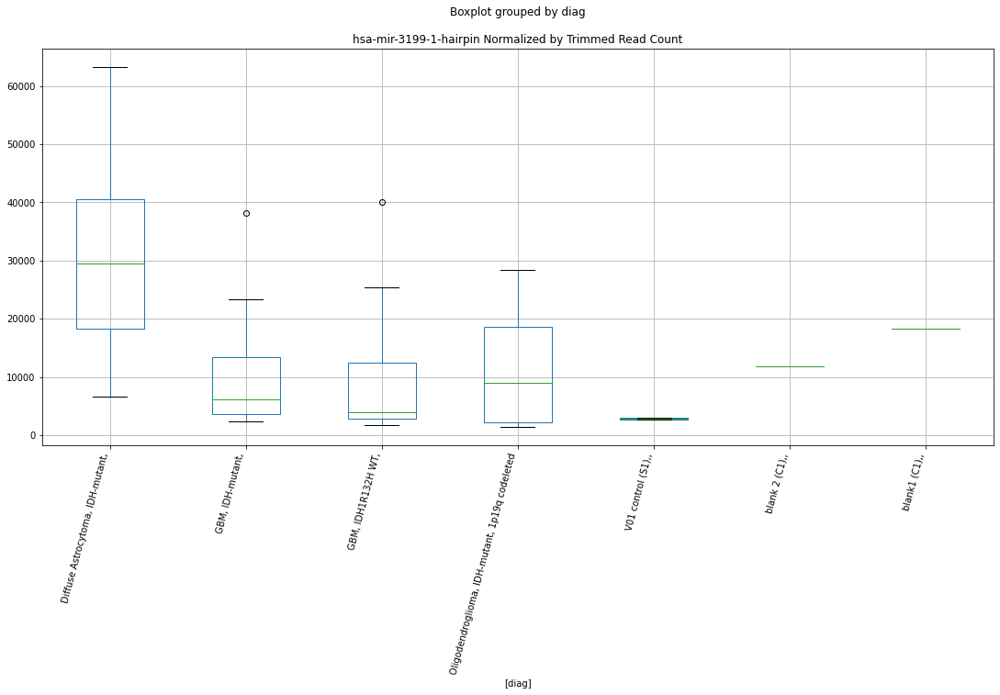

 p : 0.007792139845756238  ( t : 2.9936565965423463 ) :  D-plex  :  cutadapt2  :  hsa-mir-548f-3-hairpin
Control and blanks
76      6060.91
340    63412.71
Name: hsa-mir-548f-3-hairpin, dtype: float64
208    94529.08
Name: hsa-mir-548f-3-hairpin, dtype: float64
472    49126.25
Name: hsa-mir-548f-3-hairpin, dtype: float64


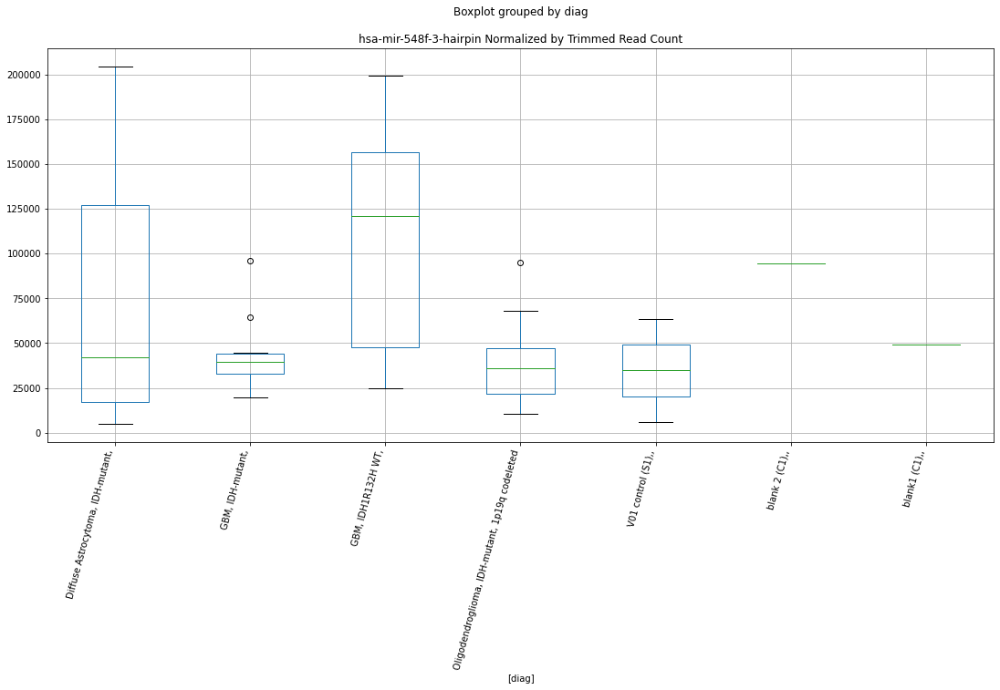

 p : 0.007837538298350712  ( t : 2.990983848395971 ) :  D-plex  :  cutadapt2  :  hsa-mir-155-hairpin
Control and blanks
76     87883.25
340     2642.20
Name: hsa-mir-155-hairpin, dtype: float64
208    19752.34
Name: hsa-mir-155-hairpin, dtype: float64
472    29475.75
Name: hsa-mir-155-hairpin, dtype: float64


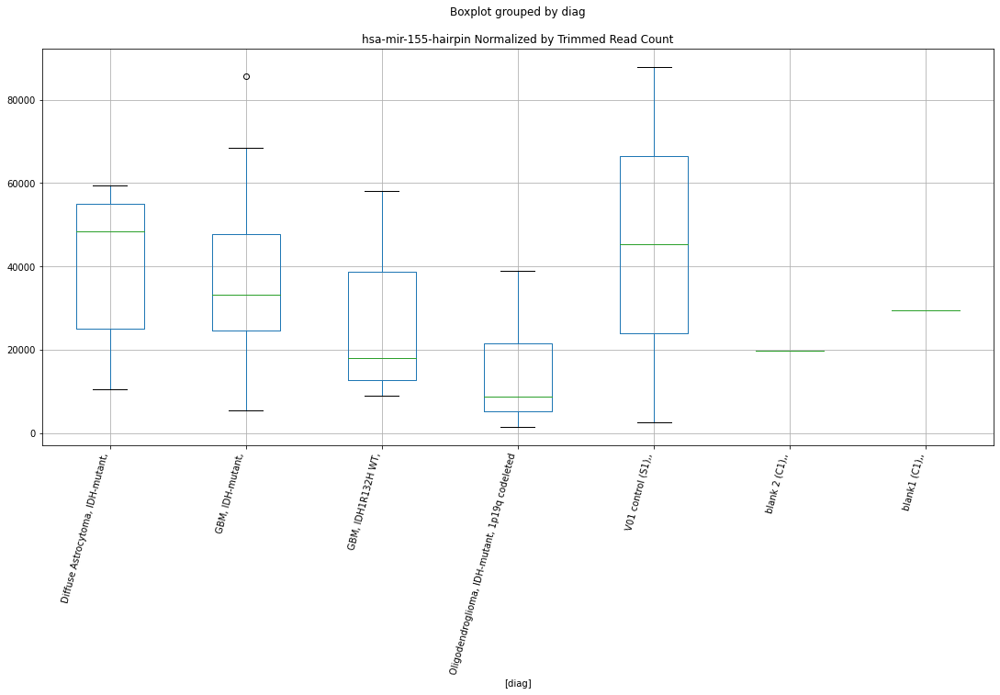

 p : 0.007906236606929653  ( t : 2.9869677970380555 ) :  D-plex  :  bbduk2  :  hsa-mir-324-3p-mature
Control and blanks
73     30920.34
337     8011.42
Name: hsa-mir-324-3p-mature, dtype: float64
205    10745.46
Name: hsa-mir-324-3p-mature, dtype: float64
469    14196.66
Name: hsa-mir-324-3p-mature, dtype: float64


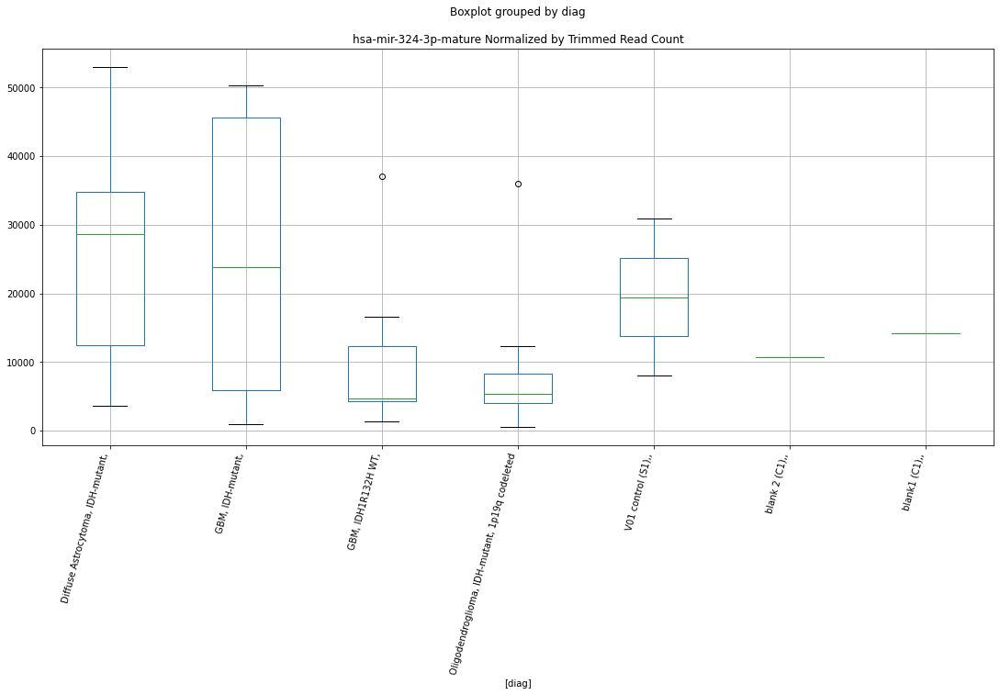

 p : 0.007924240610668648  ( t : 2.98592089589148 ) :  D-plex  :  cutadapt2  :  hsa-mir-331-3p-mature
Control and blanks
76     78034.26
340     2642.20
Name: hsa-mir-331-3p-mature, dtype: float64
208    18165.1
Name: hsa-mir-331-3p-mature, dtype: float64
472    16182.76
Name: hsa-mir-331-3p-mature, dtype: float64


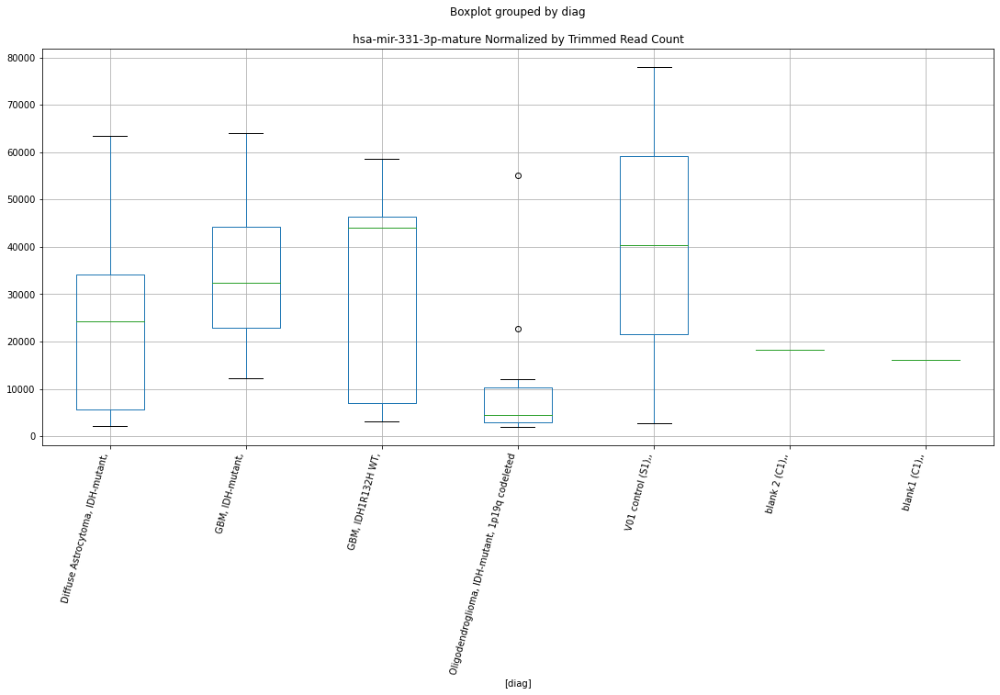

 p : 0.007941367722157764  ( t : 2.98492712402395 ) :  D-plex  :  bbduk2  :  hsa-mir-4756-hairpin
Control and blanks
73     26282.29
337     2670.47
Name: hsa-mir-4756-hairpin, dtype: float64
205    33848.19
Name: hsa-mir-4756-hairpin, dtype: float64
469    28984.84
Name: hsa-mir-4756-hairpin, dtype: float64


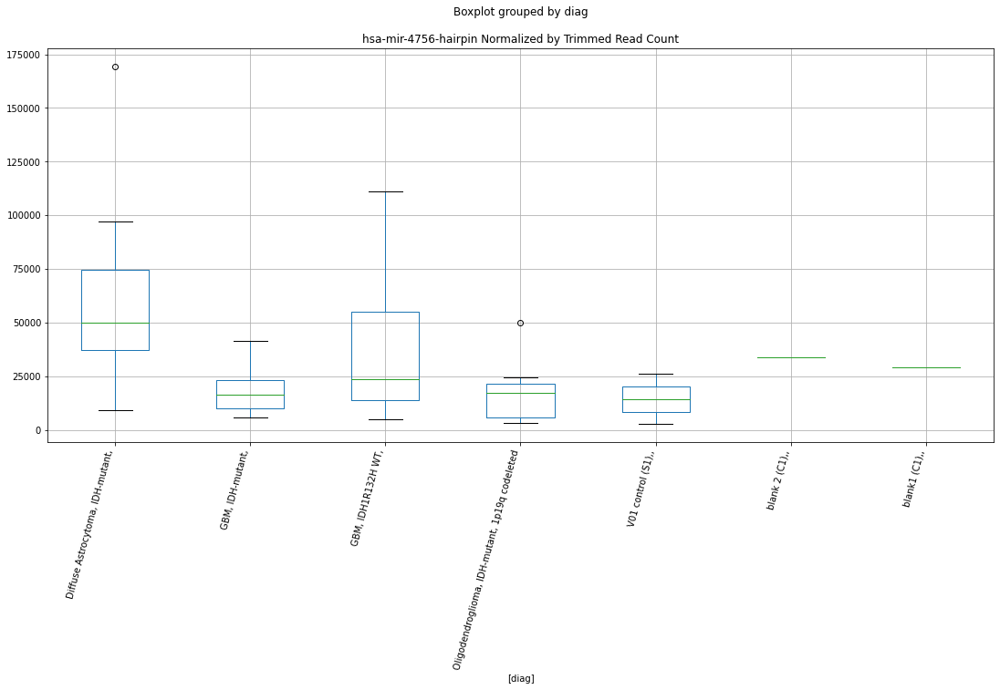

 p : 0.007962820963125231  ( t : 2.9836852649416143 ) :  D-plex  :  bbduk2  :  hsa-mir-3130-2-hairpin
Control and blanks
73     65705.71
337     3560.63
Name: hsa-mir-3130-2-hairpin, dtype: float64
205    113543.66
Name: hsa-mir-3130-2-hairpin, dtype: float64
469    47322.19
Name: hsa-mir-3130-2-hairpin, dtype: float64


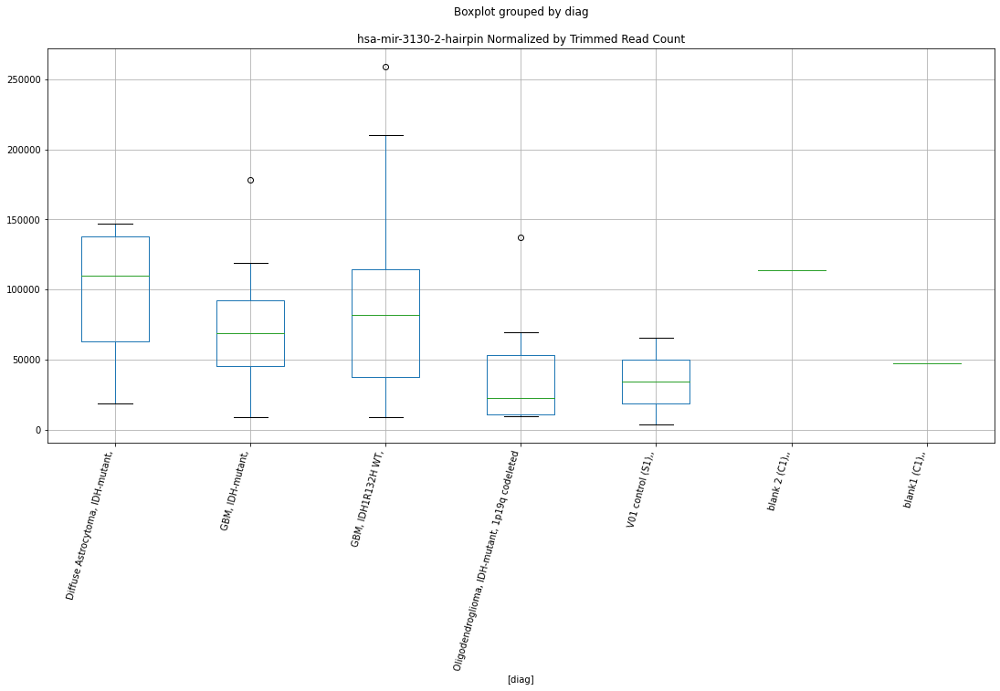

 p : 0.007962820963125231  ( t : 2.9836852649416143 ) :  D-plex  :  bbduk2  :  hsa-mir-3130-1-hairpin
Control and blanks
73     65705.71
337     3560.63
Name: hsa-mir-3130-1-hairpin, dtype: float64
205    113543.66
Name: hsa-mir-3130-1-hairpin, dtype: float64
469    47322.19
Name: hsa-mir-3130-1-hairpin, dtype: float64


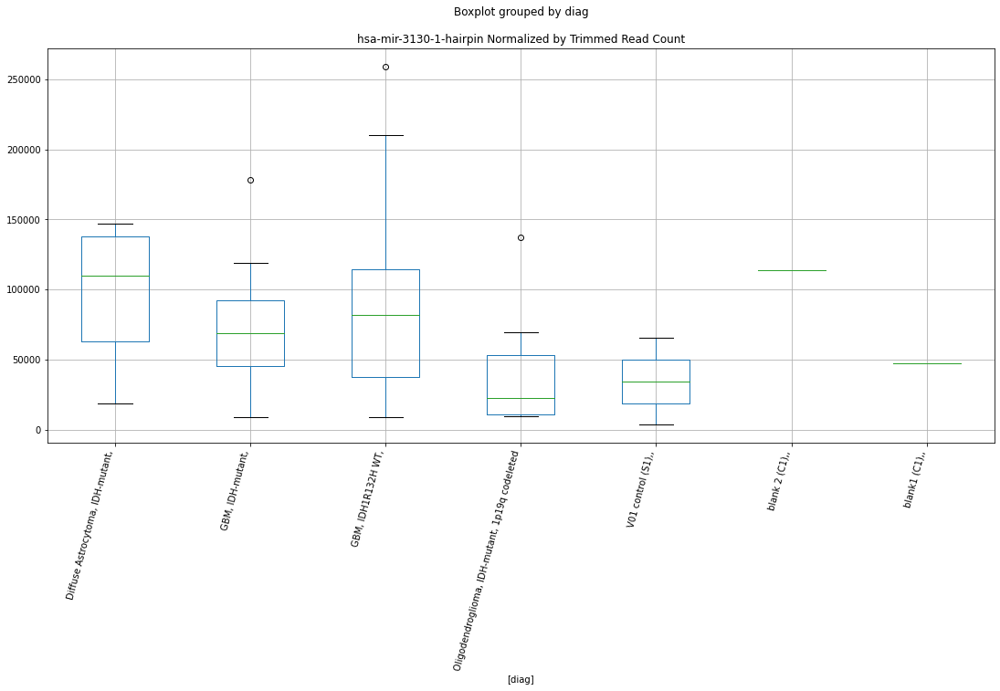

 p : 0.007969260881404327  ( t : 2.983313112127965 ) :  D-plex  :  cutadapt2  :  hsa-mir-3613-hairpin
Control and blanks
76     130309.64
340    203449.12
Name: hsa-mir-3613-hairpin, dtype: float64
208    119748.59
Name: hsa-mir-3613-hairpin, dtype: float64
472    89005.2
Name: hsa-mir-3613-hairpin, dtype: float64


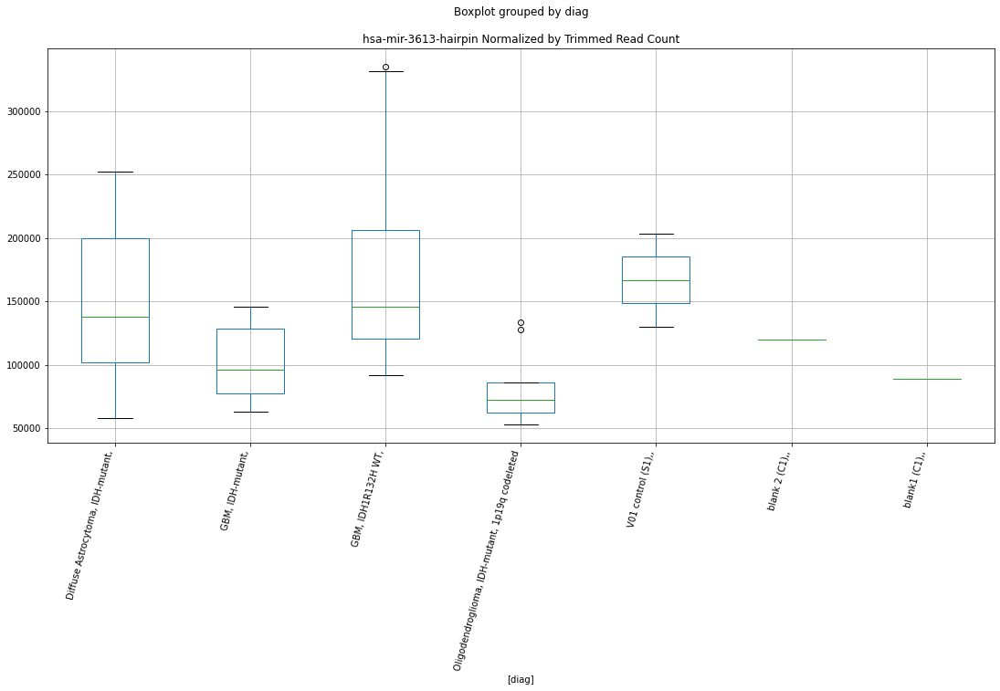

 p : 0.008061893957401488  ( t : 2.977992026592185 ) :  D-plex  :  bbduk2  :  hsa-mir-92a-2-5p-mature
Control and blanks
73     42515.46
337    17803.15
Name: hsa-mir-92a-2-5p-mature, dtype: float64
205    42086.37
Name: hsa-mir-92a-2-5p-mature, dtype: float64
469    10055.96
Name: hsa-mir-92a-2-5p-mature, dtype: float64


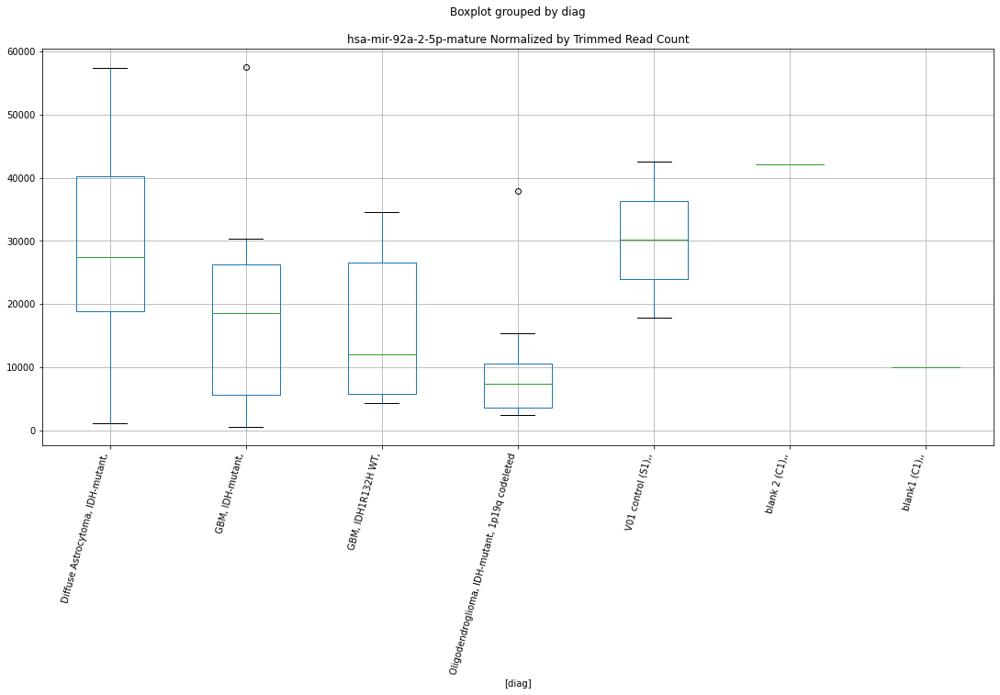

 p : 0.008131473980410182  ( t : 2.9740340218399837 ) :  Lexogen  :  bbduk2  :  hsa-mir-216a-hairpin
Control and blanks
79         NaN
343    17834.4
Name: hsa-mir-216a-hairpin, dtype: float64
211    3279.68
Name: hsa-mir-216a-hairpin, dtype: float64
475    958.06
Name: hsa-mir-216a-hairpin, dtype: float64


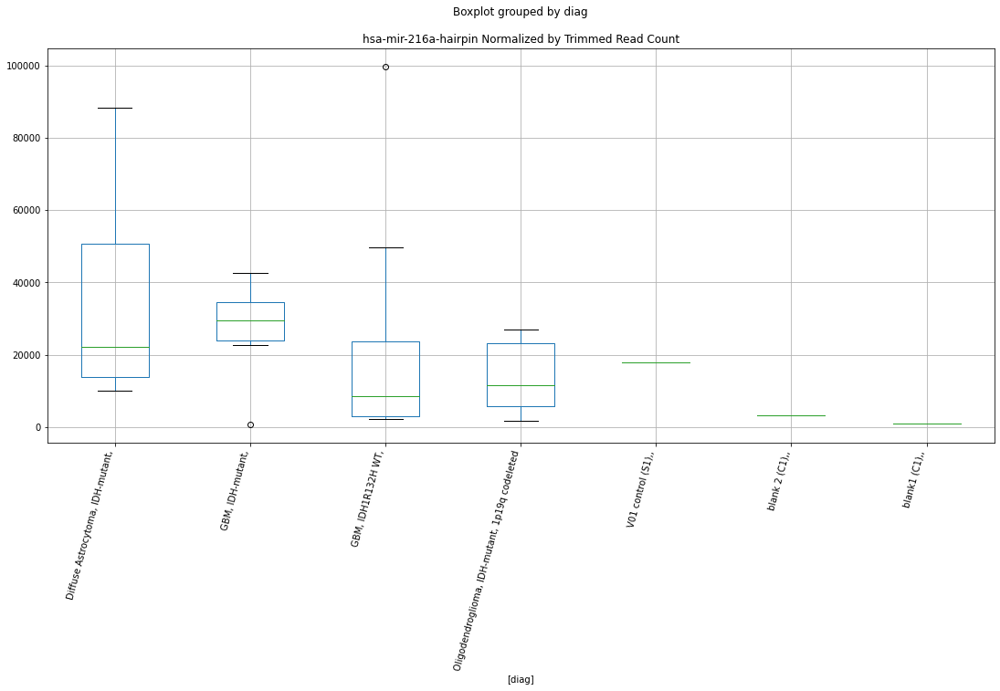

 p : 0.008161516138866202  ( t : 2.972335238191486 ) :  D-plex  :  bbduk2  :  hsa-mir-4489-hairpin
Control and blanks
73     16233.18
337    57860.22
Name: hsa-mir-4489-hairpin, dtype: float64
205    44056.37
Name: hsa-mir-4489-hairpin, dtype: float64
469    15379.71
Name: hsa-mir-4489-hairpin, dtype: float64


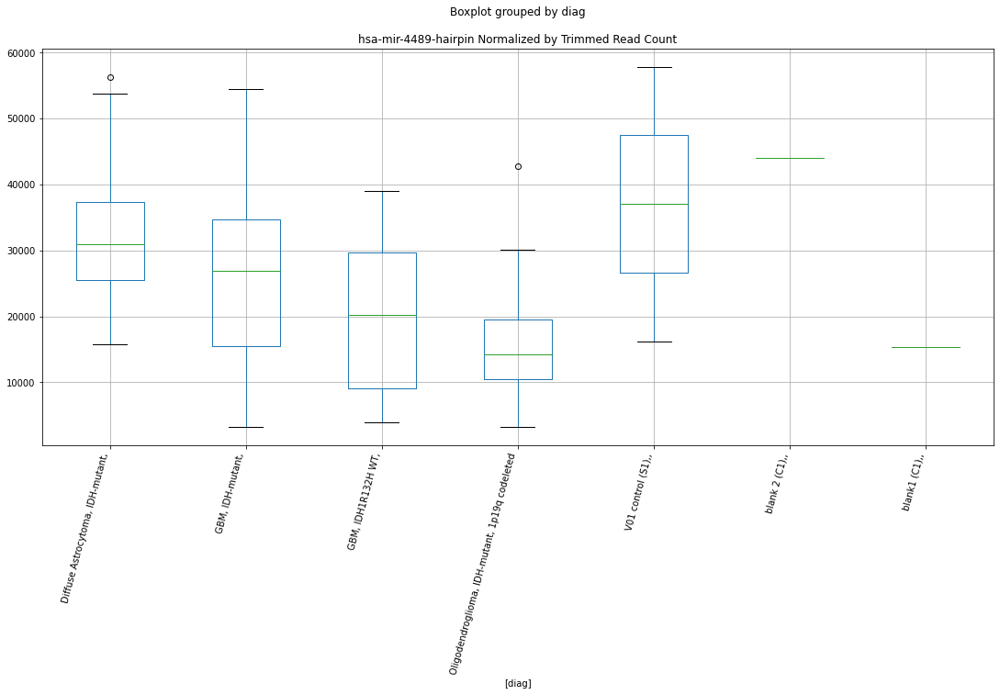

 p : 0.00832336812515573  ( t : 2.963286077089683 ) :  D-plex  :  bbduk2  :  hsa-mir-6824-hairpin
Control and blanks
73     113632.24
337     40057.08
Name: hsa-mir-6824-hairpin, dtype: float64
205    40295.46
Name: hsa-mir-6824-hairpin, dtype: float64
469    26618.73
Name: hsa-mir-6824-hairpin, dtype: float64


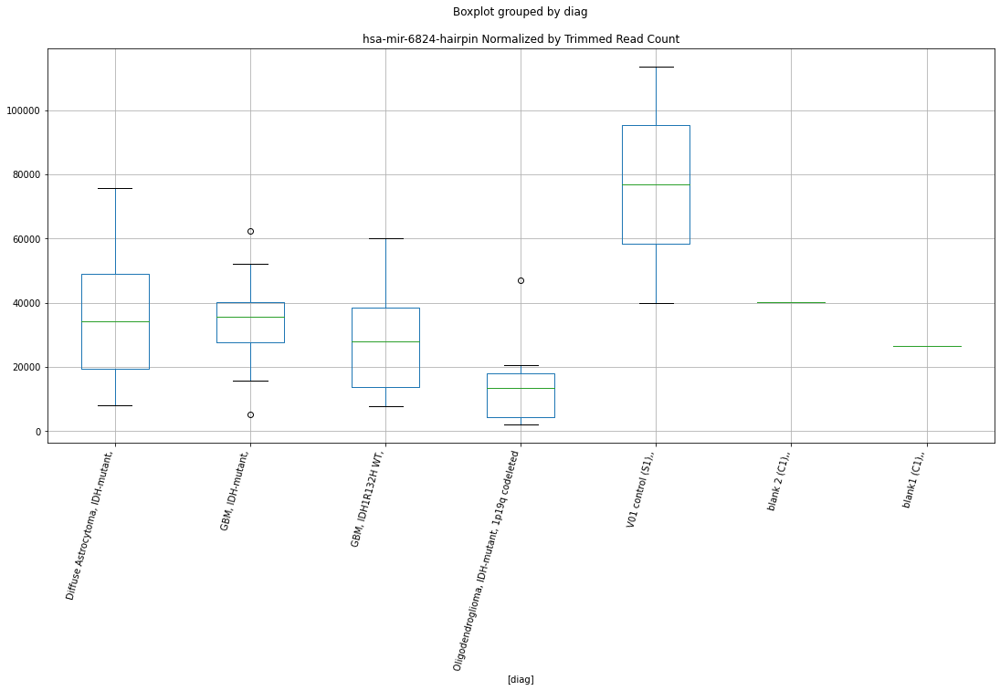

 p : 0.008348801361179934  ( t : 2.961879628798709 ) :  D-plex  :  cutadapt2  :  hsa-mir-3199-2-hairpin
Control and blanks
76     3030.46
340    2642.20
Name: hsa-mir-3199-2-hairpin, dtype: float64
208    11110.69
Name: hsa-mir-3199-2-hairpin, dtype: float64
472    8669.34
Name: hsa-mir-3199-2-hairpin, dtype: float64


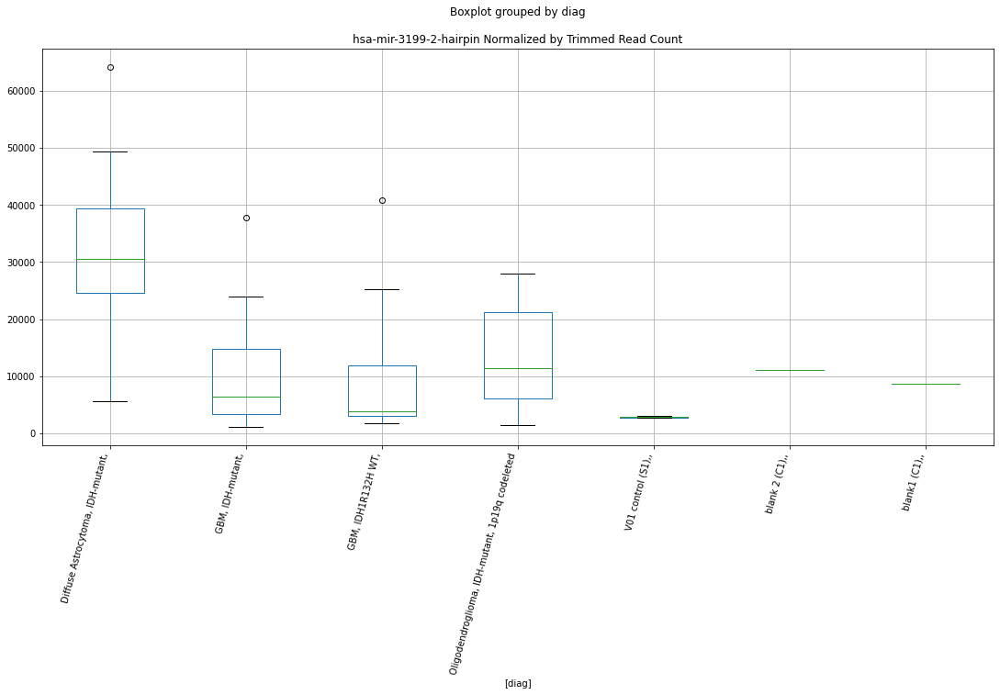

 p : 0.008411879556142357  ( t : 2.958409266527035 ) :  Lexogen  :  cutadapt2  :  hsa-mir-122-hairpin
Control and blanks
82      2840.10
346    21885.19
Name: hsa-mir-122-hairpin, dtype: float64
214    4068.4
Name: hsa-mir-122-hairpin, dtype: float64
478    4986.67
Name: hsa-mir-122-hairpin, dtype: float64


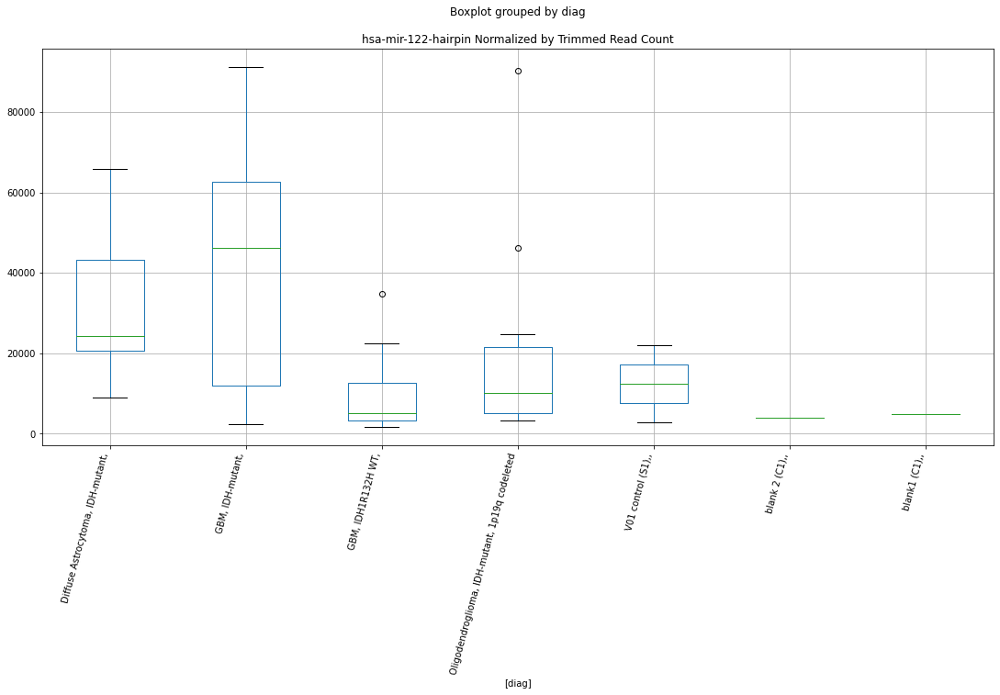

 p : 0.008470750201475386  ( t : 2.955193061808402 ) :  D-plex  :  cutadapt2  :  hsa-mir-3907-hairpin
Control and blanks
76     252285.53
340     71339.30
Name: hsa-mir-3907-hairpin, dtype: float64
208    207399.62
Name: hsa-mir-3907-hairpin, dtype: float64
472    141021.22
Name: hsa-mir-3907-hairpin, dtype: float64


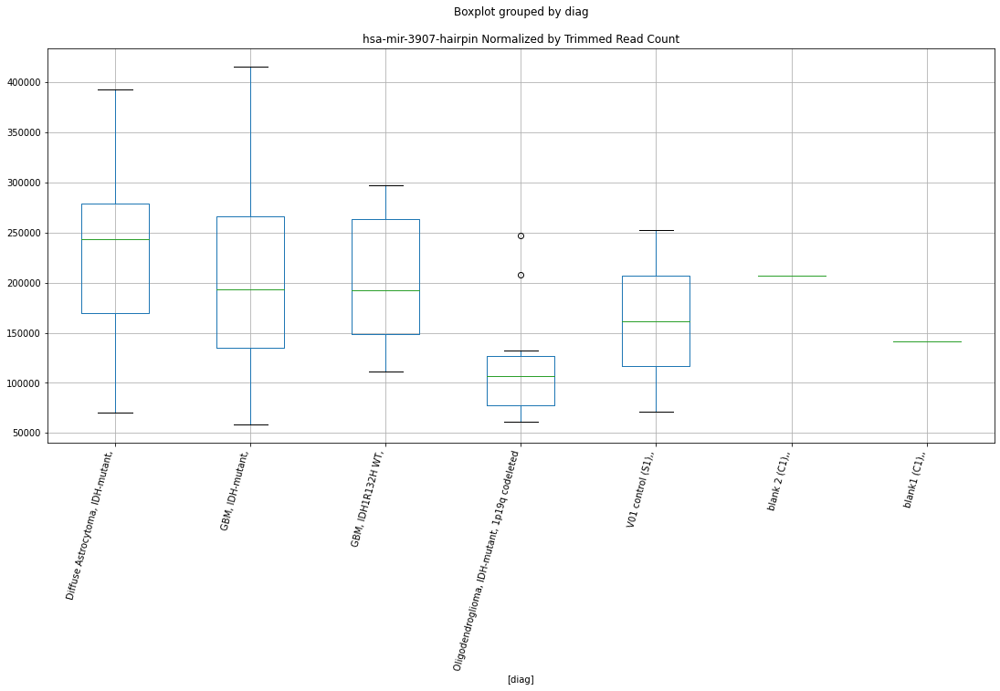

 p : 0.008527878560074286  ( t : 2.952092675614549 ) :  D-plex  :  bbduk2  :  hsa-mir-3199-2-hairpin
Control and blanks
73     3092.03
337    2670.47
Name: hsa-mir-3199-2-hairpin, dtype: float64
205    11640.91
Name: hsa-mir-3199-2-hairpin, dtype: float64
469    17154.29
Name: hsa-mir-3199-2-hairpin, dtype: float64


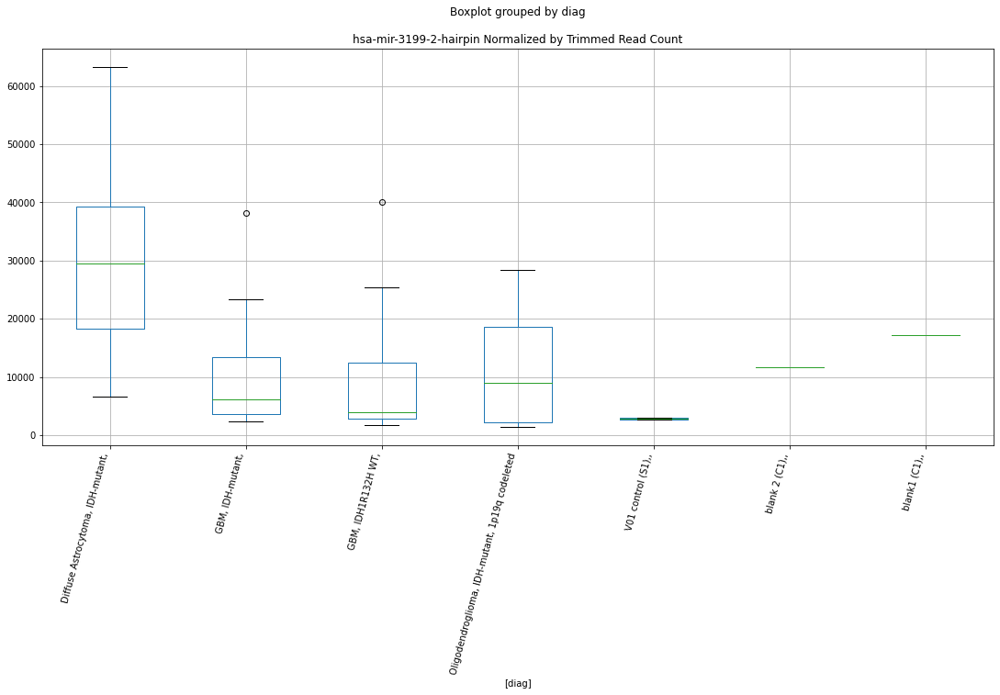

 p : 0.008557798228535486  ( t : 2.9504769370146504 ) :  D-plex  :  bbduk2  :  hsa-mir-331-3p-mature
Control and blanks
73     79619.87
337     3560.63
Name: hsa-mir-331-3p-mature, dtype: float64
205    18267.28
Name: hsa-mir-331-3p-mature, dtype: float64
469    16562.76
Name: hsa-mir-331-3p-mature, dtype: float64


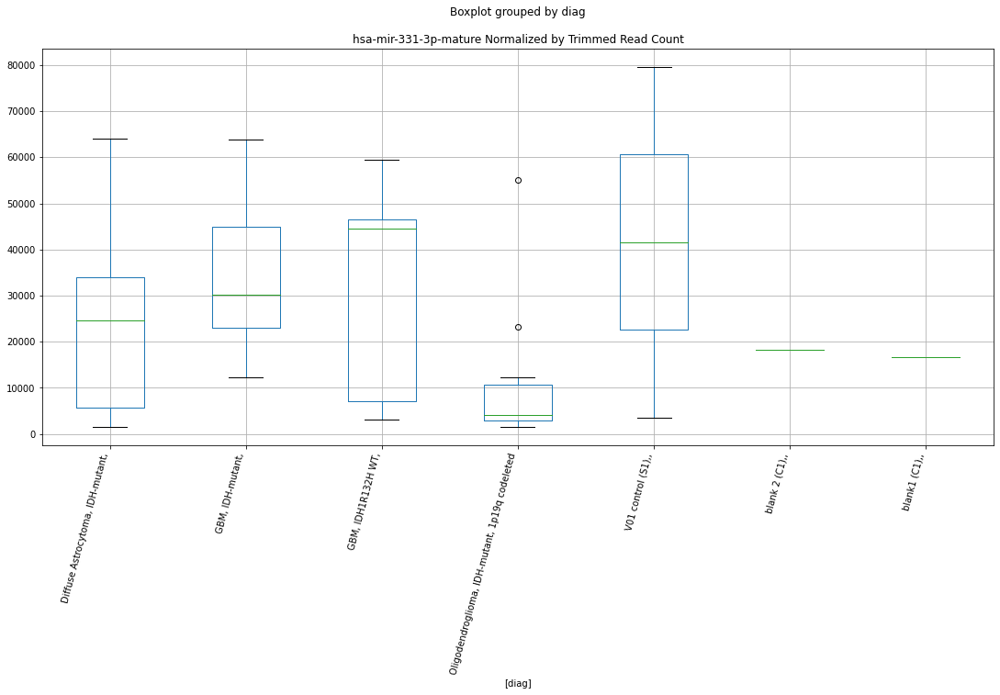

 p : 0.008590938230670711  ( t : 2.9486936655858975 ) :  D-plex  :  bbduk2  :  hsa-mir-29c-hairpin
Control and blanks
73      9276.10
337    50738.96
Name: hsa-mir-29c-hairpin, dtype: float64
205    55518.2
Name: hsa-mir-29c-hairpin, dtype: float64
469    30167.89
Name: hsa-mir-29c-hairpin, dtype: float64


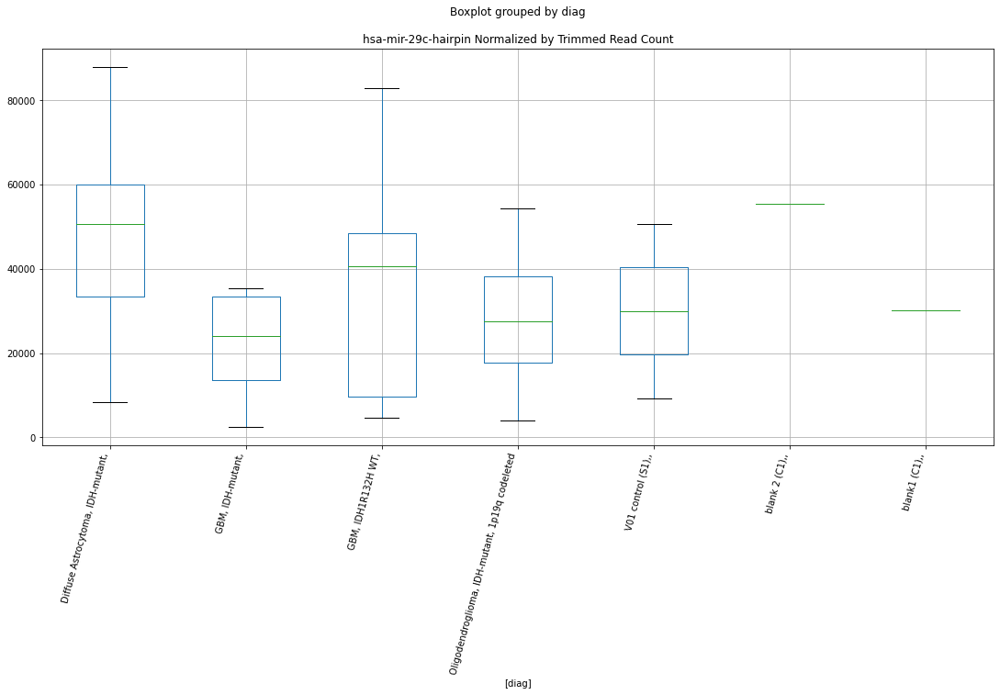

 p : 0.00859716866269683  ( t : 2.9483591486393252 ) :  D-plex  :  cutadapt2  :  hsa-mir-3124-hairpin
Control and blanks
76     47729.7
340    22018.3
Name: hsa-mir-3124-hairpin, dtype: float64
208    28041.27
Name: hsa-mir-3124-hairpin, dtype: float64
472    41612.82
Name: hsa-mir-3124-hairpin, dtype: float64


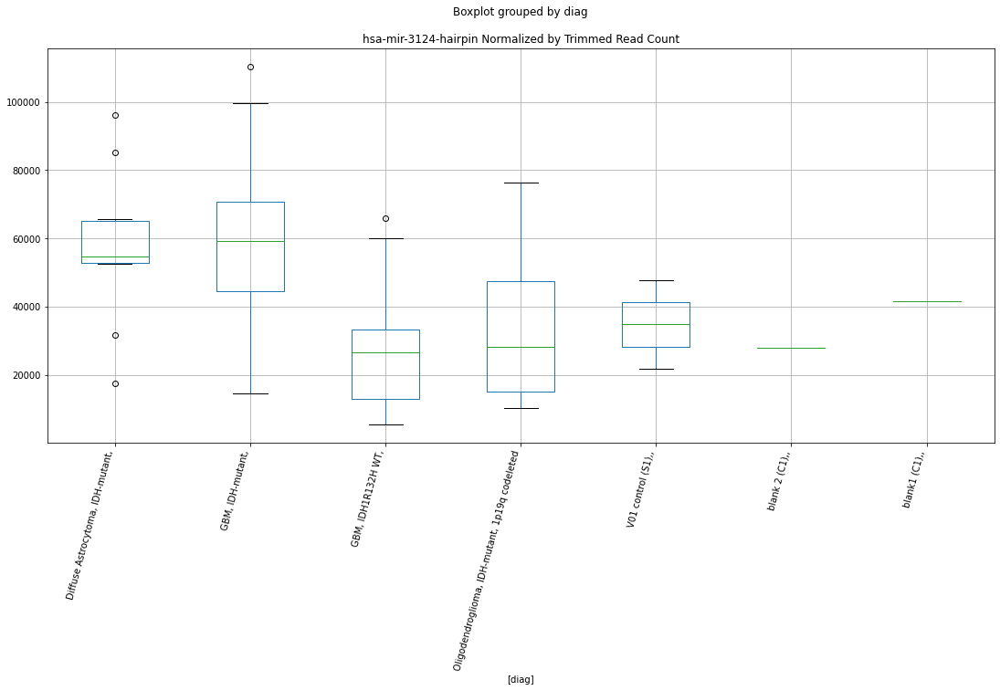

 p : 0.008680125814573643  ( t : 2.9439273450554184 ) :  Lexogen  :  cutadapt2  :  hsa-mir-10b-5p-mature
Control and blanks
82       1420.05
346    135309.40
Name: hsa-mir-10b-5p-mature, dtype: float64
214    5966.98
Name: hsa-mir-10b-5p-mature, dtype: float64
478    237.46
Name: hsa-mir-10b-5p-mature, dtype: float64


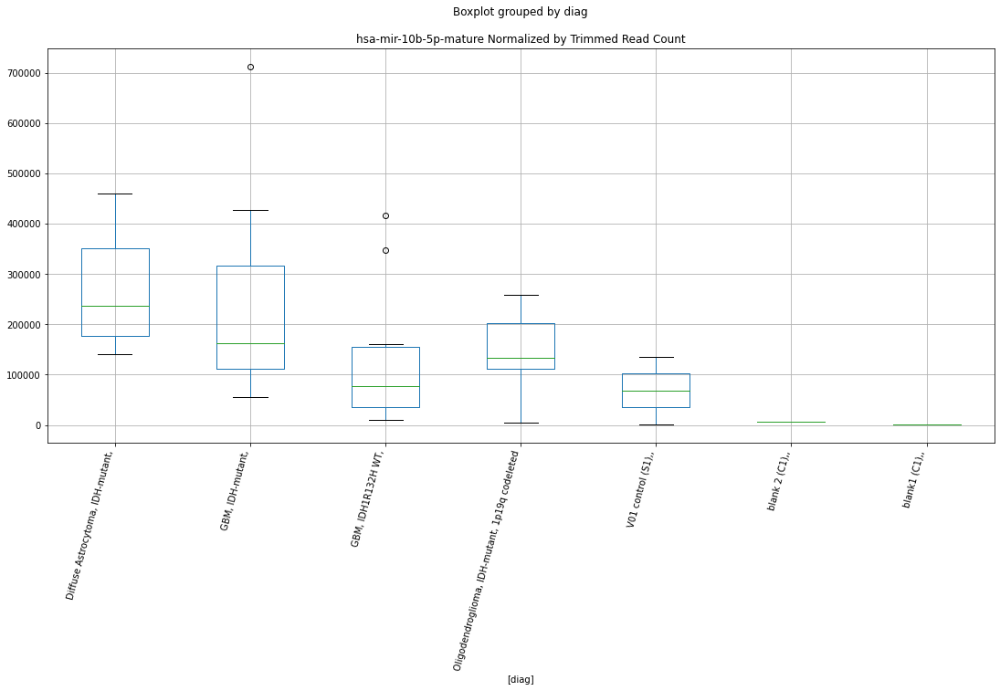

 p : 0.008687738066292668  ( t : 2.943522733631177 ) :  D-plex  :  bbduk2  :  hsa-mir-548f-3-hairpin
Control and blanks
73     10049.11
337    69432.27
Name: hsa-mir-548f-3-hairpin, dtype: float64
205    94918.2
Name: hsa-mir-548f-3-hairpin, dtype: float64
469    62110.37
Name: hsa-mir-548f-3-hairpin, dtype: float64


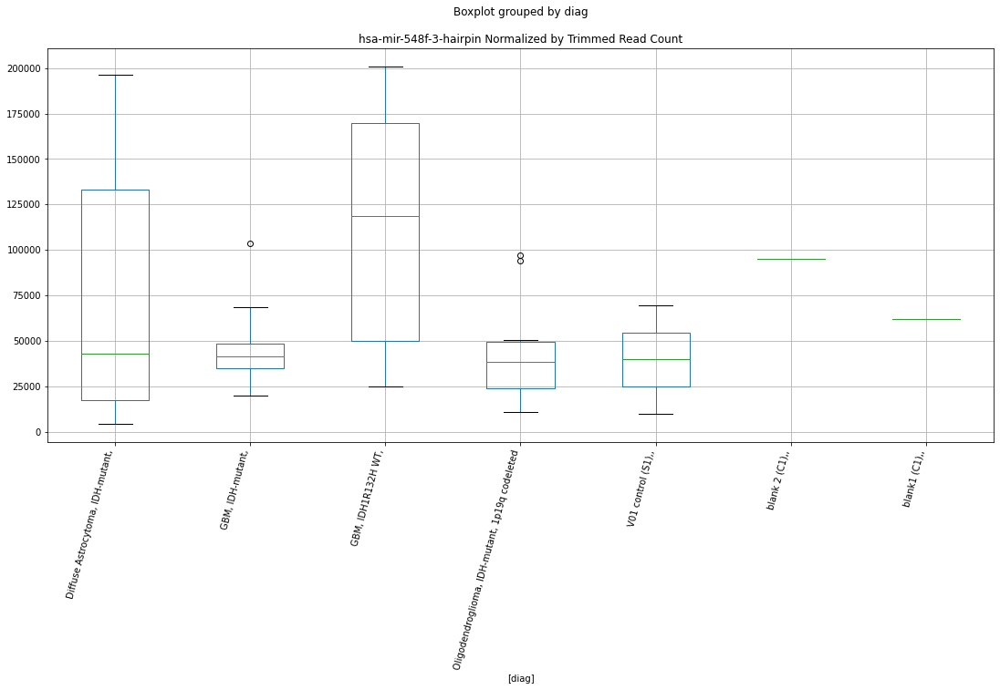

 p : 0.008746130904871925  ( t : 2.9404303647433983 ) :  Lexogen  :  cutadapt2  :  hsa-mir-1305-hairpin
Control and blanks
82          NaN
346    45243.42
Name: hsa-mir-1305-hairpin, dtype: float64
214    7594.34
Name: hsa-mir-1305-hairpin, dtype: float64
478    9023.5
Name: hsa-mir-1305-hairpin, dtype: float64


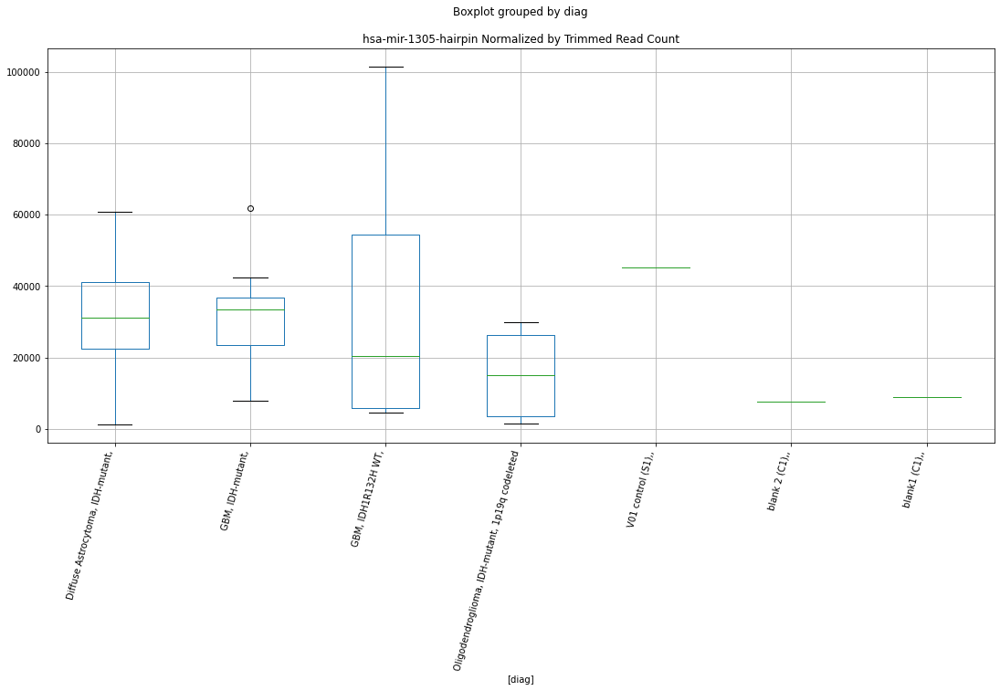

 p : 0.008782817731569064  ( t : 2.938497709500387 ) :  Lexogen  :  cutadapt2  :  hsa-mir-6090-hairpin
Control and blanks
82         NaN
346    29881.7
Name: hsa-mir-6090-hairpin, dtype: float64
214    7051.89
Name: hsa-mir-6090-hairpin, dtype: float64
478    237.46
Name: hsa-mir-6090-hairpin, dtype: float64


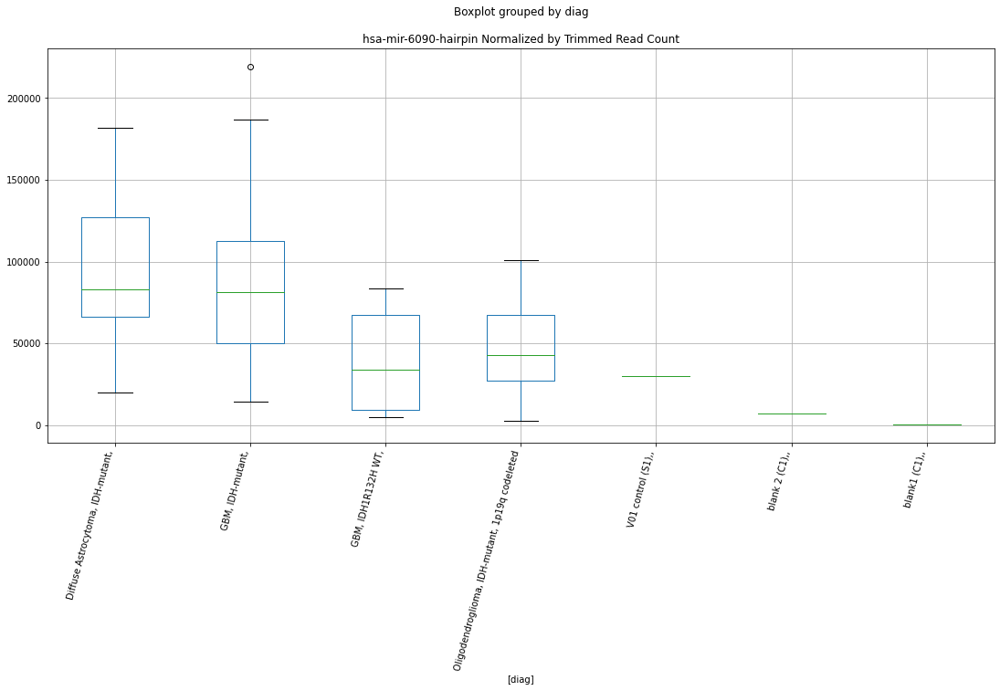

 p : 0.008820277425437596  ( t : 2.9365323854430327 ) :  Lexogen  :  bbduk2  :  hsa-mir-10b-5p-mature
Control and blanks
79       1430.60
343    136730.42
Name: hsa-mir-10b-5p-mature, dtype: float64
211    6286.05
Name: hsa-mir-10b-5p-mature, dtype: float64
475    239.52
Name: hsa-mir-10b-5p-mature, dtype: float64


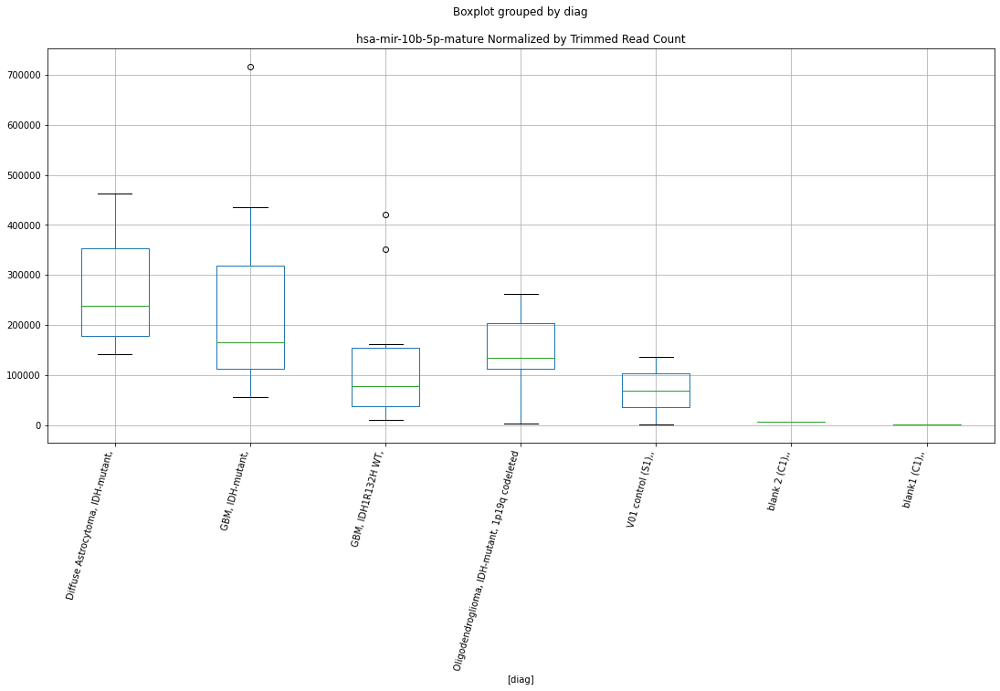

 p : 0.008958799470127302  ( t : 2.929334318433851 ) :  D-plex  :  cutadapt2  :  hsa-mir-4672-hairpin
Control and blanks
76      26516.50
340    379595.55
Name: hsa-mir-4672-hairpin, dtype: float64
208    96116.32
Name: hsa-mir-4672-hairpin, dtype: float64
472    87849.29
Name: hsa-mir-4672-hairpin, dtype: float64


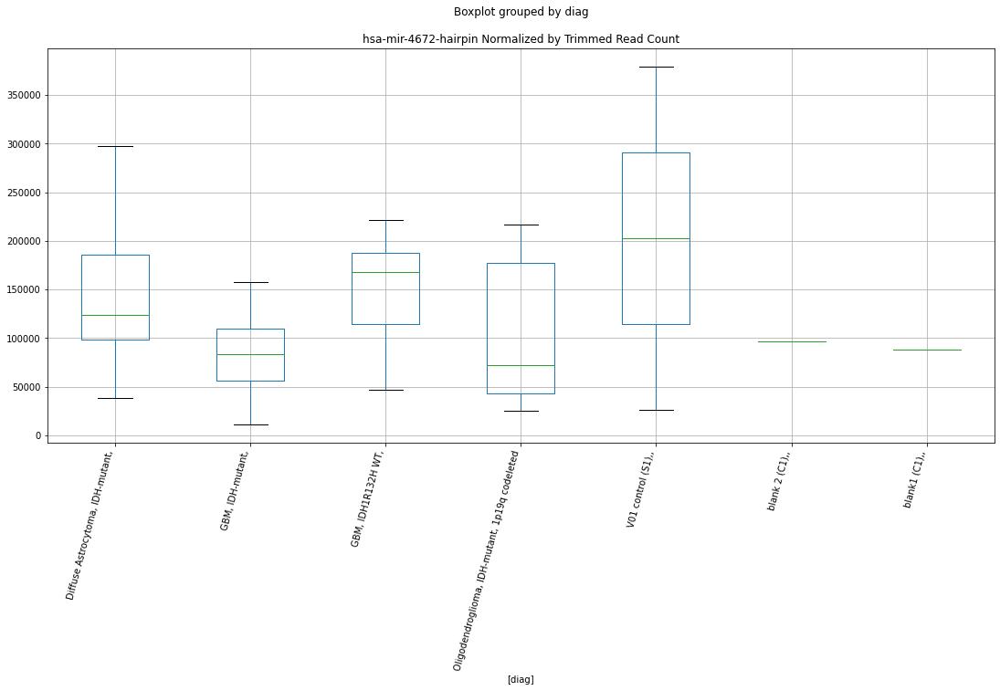

 p : 0.008964046281225485  ( t : 2.929063798191928 ) :  D-plex  :  bbduk2  :  hsa-mir-4767-hairpin
Control and blanks
73     105129.14
337      1780.31
Name: hsa-mir-4767-hairpin, dtype: float64
205    43519.1
Name: hsa-mir-4767-hairpin, dtype: float64
469    33125.53
Name: hsa-mir-4767-hairpin, dtype: float64


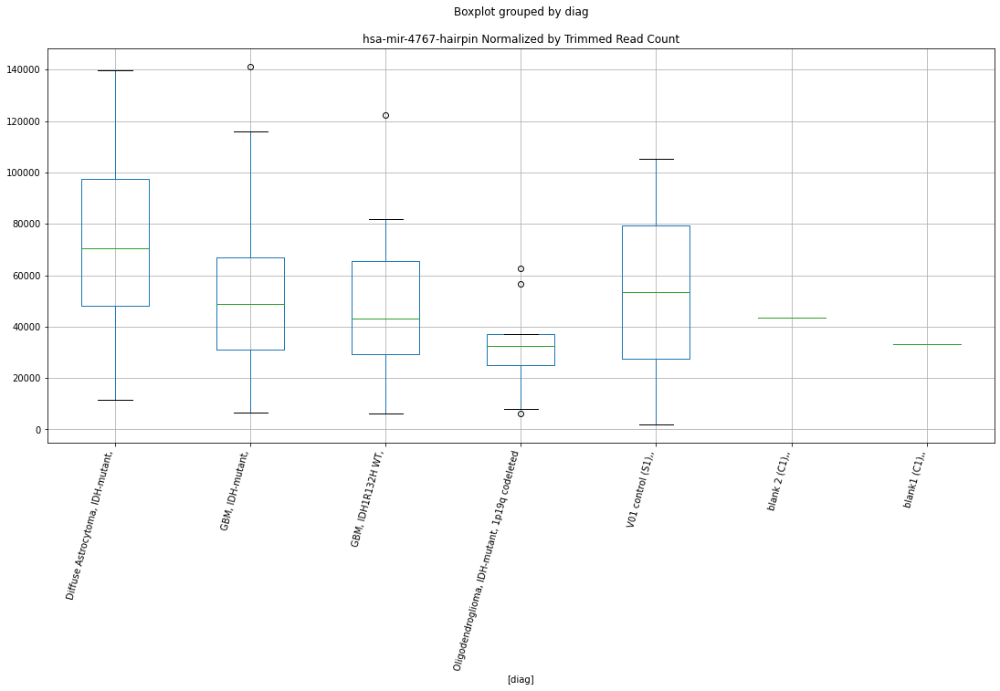

 p : 0.009000198307442682  ( t : 2.9272039898554647 ) :  D-plex  :  bbduk2  :  hsa-mir-411-hairpin
Control and blanks
73     23963.26
337    41837.39
Name: hsa-mir-411-hairpin, dtype: float64
205    22207.28
Name: hsa-mir-411-hairpin, dtype: float64
469    35491.64
Name: hsa-mir-411-hairpin, dtype: float64


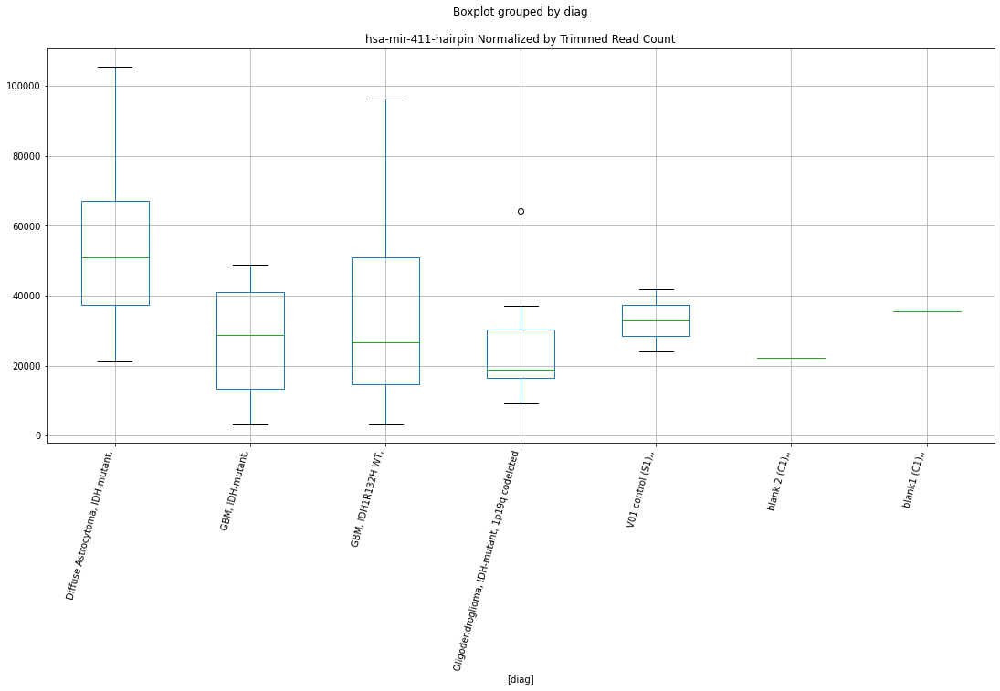

 p : 0.00900991338224095  ( t : 2.926705438536494 ) :  Lexogen  :  bbduk2  :  hsa-mir-6090-hairpin
Control and blanks
79          NaN
343    29936.32
Name: hsa-mir-6090-hairpin, dtype: float64
211    7105.96
Name: hsa-mir-6090-hairpin, dtype: float64
475    239.52
Name: hsa-mir-6090-hairpin, dtype: float64


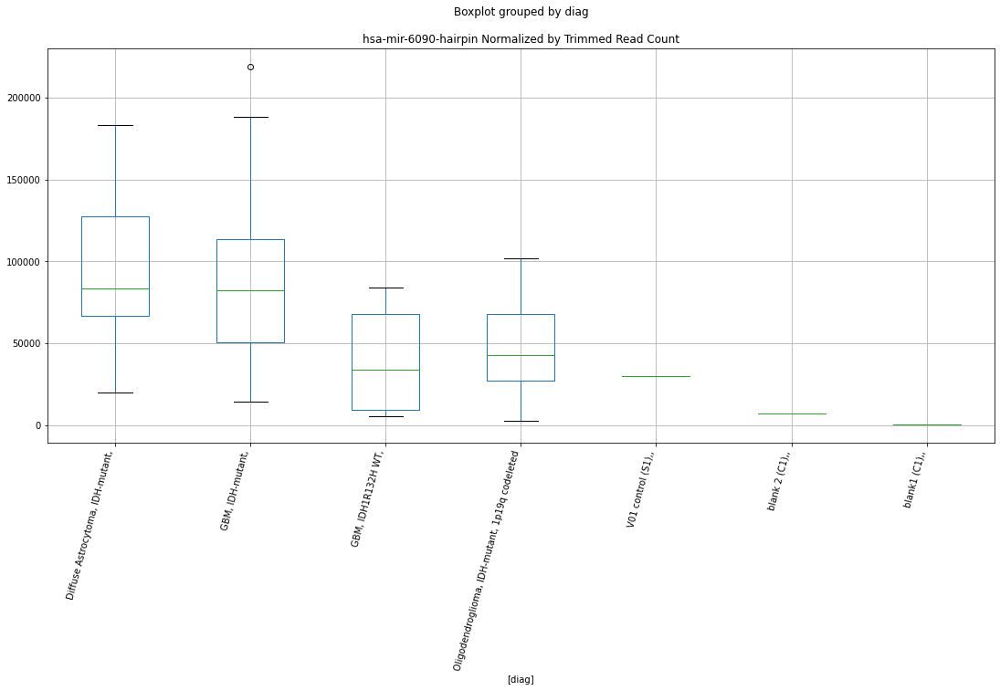

 p : 0.009039118646821115  ( t : 2.925209828644157 ) :  D-plex  :  bbduk2  :  hsa-mir-8081-hairpin
Control and blanks
73      98172.07
337    161118.46
Name: hsa-mir-8081-hairpin, dtype: float64
205    45847.28
Name: hsa-mir-8081-hairpin, dtype: float64
469    285116.17
Name: hsa-mir-8081-hairpin, dtype: float64


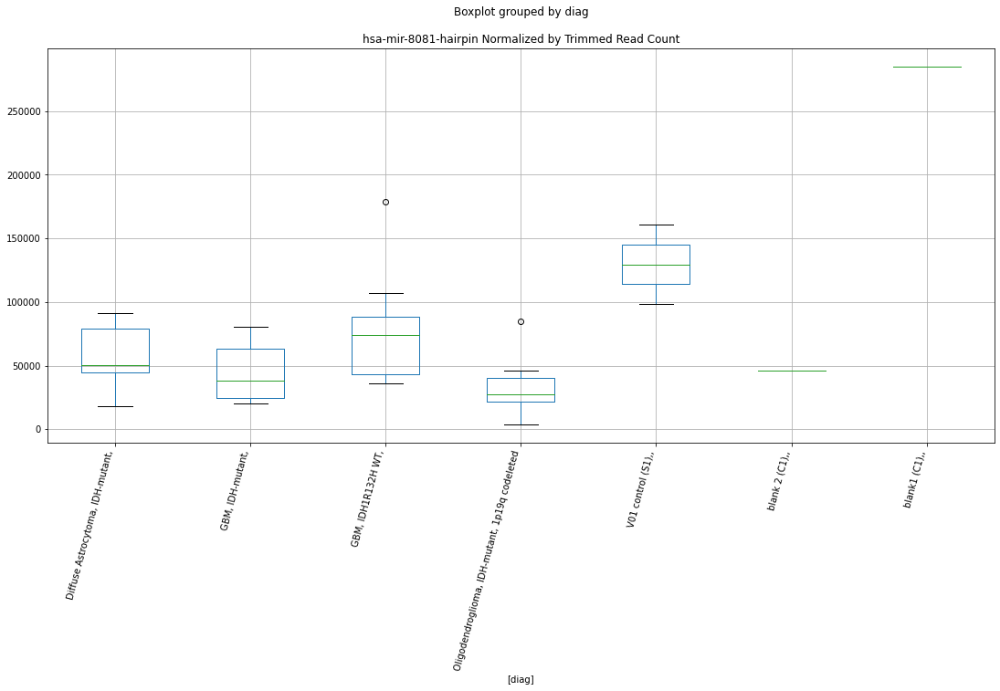

 p : 0.009290405274682076  ( t : 2.912531109234865 ) :  D-plex  :  bbduk2  :  hsa-mir-6733-3p-mature
Control and blanks
73     15460.17
337     9791.73
Name: hsa-mir-6733-3p-mature, dtype: float64
205    10387.28
Name: hsa-mir-6733-3p-mature, dtype: float64
469    39040.8
Name: hsa-mir-6733-3p-mature, dtype: float64


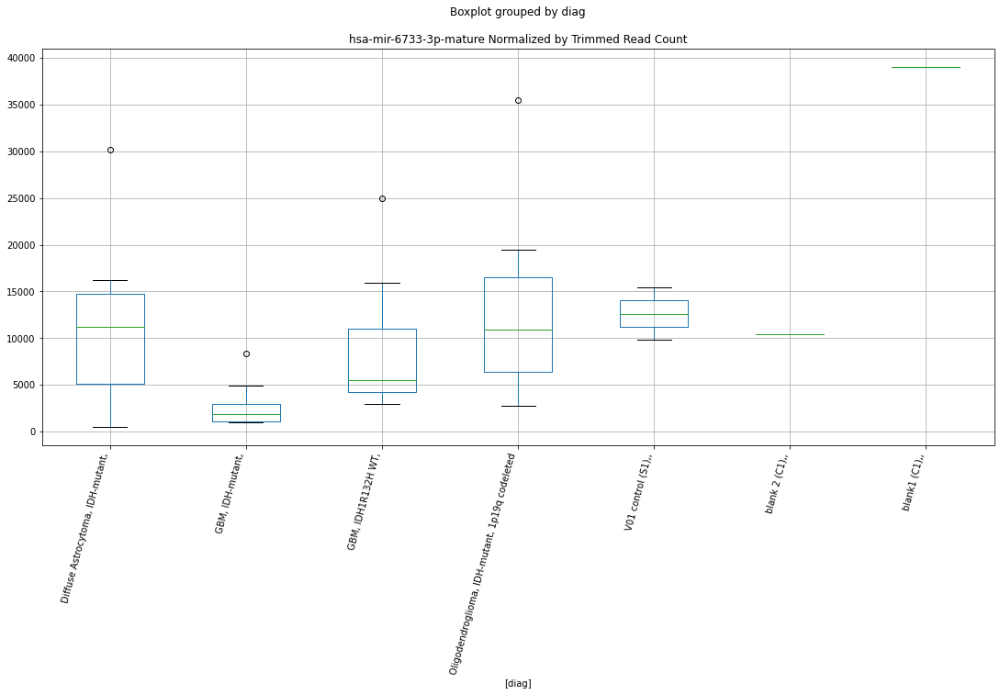

 p : 0.009293135678575634  ( t : 2.912395175257819 ) :  Lexogen  :  cutadapt2  :  hsa-mir-6883-hairpin
Control and blanks
82          NaN
346    36194.74
Name: hsa-mir-6883-hairpin, dtype: float64
214    7594.34
Name: hsa-mir-6883-hairpin, dtype: float64
478    237.46
Name: hsa-mir-6883-hairpin, dtype: float64


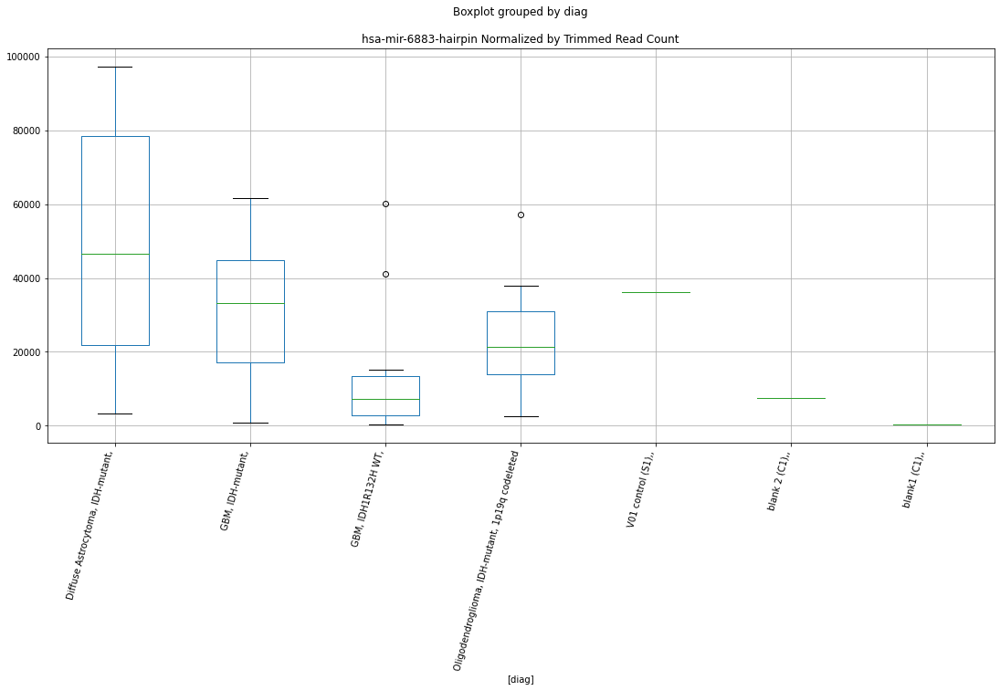

 p : 0.009307785703711234  ( t : 2.911666477974863 ) :  D-plex  :  cutadapt2  :  hsa-mir-3151-hairpin
Control and blanks
76      50002.54
340    105687.86
Name: hsa-mir-3151-hairpin, dtype: float64
208    74247.65
Name: hsa-mir-3151-hairpin, dtype: float64
472    63575.14
Name: hsa-mir-3151-hairpin, dtype: float64


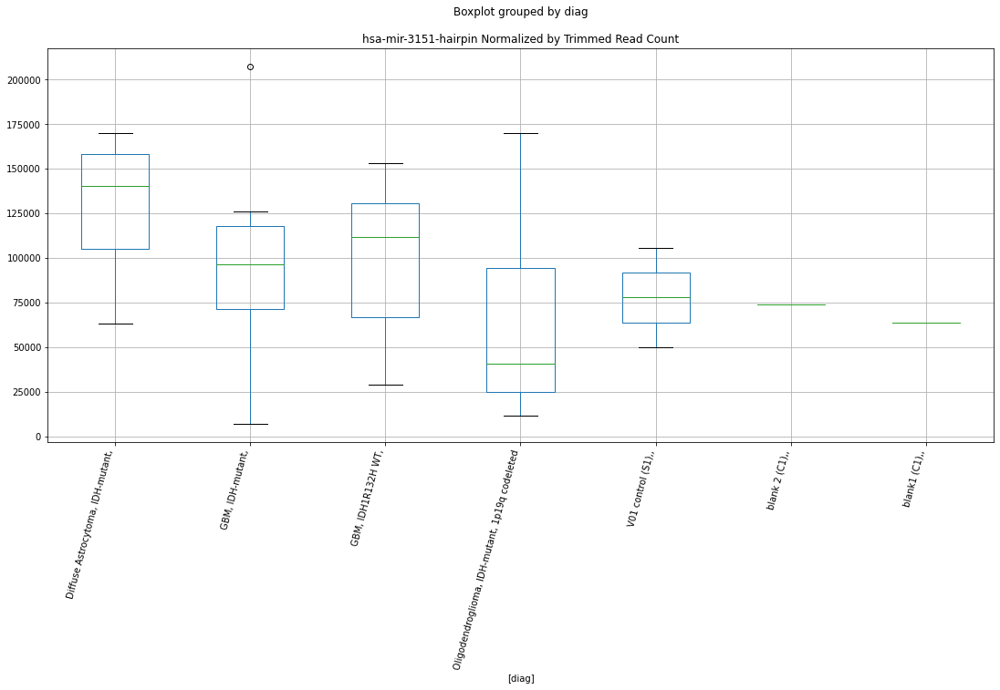

 p : 0.00931614101749143  ( t : 2.9112513780766336 ) :  D-plex  :  cutadapt2  :  hsa-mir-92a-2-5p-mature
Control and blanks
76     41668.78
340    17614.64
Name: hsa-mir-92a-2-5p-mature, dtype: float64
208    41621.01
Name: hsa-mir-92a-2-5p-mature, dtype: float64
472    9825.25
Name: hsa-mir-92a-2-5p-mature, dtype: float64


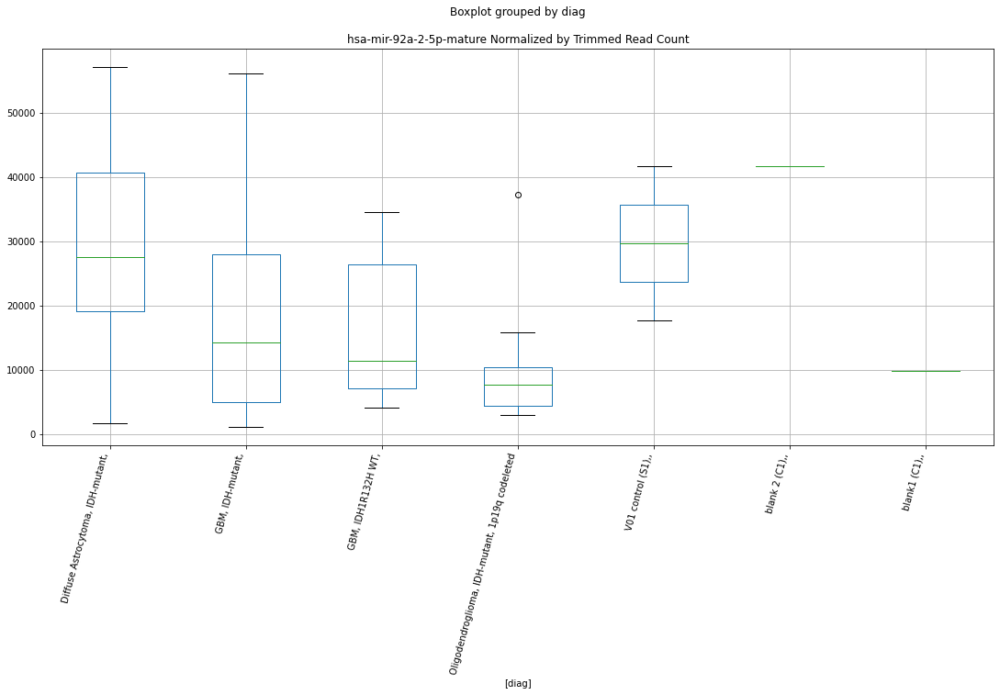

 p : 0.009354979696830345  ( t : 2.9093265473876397 ) :  D-plex  :  cutadapt2  :  hsa-mir-6833-5p-mature
Control and blanks
76     77276.65
340      880.73
Name: hsa-mir-6833-5p-mature, dtype: float64
208    39681.05
Name: hsa-mir-6833-5p-mature, dtype: float64
472    40456.91
Name: hsa-mir-6833-5p-mature, dtype: float64


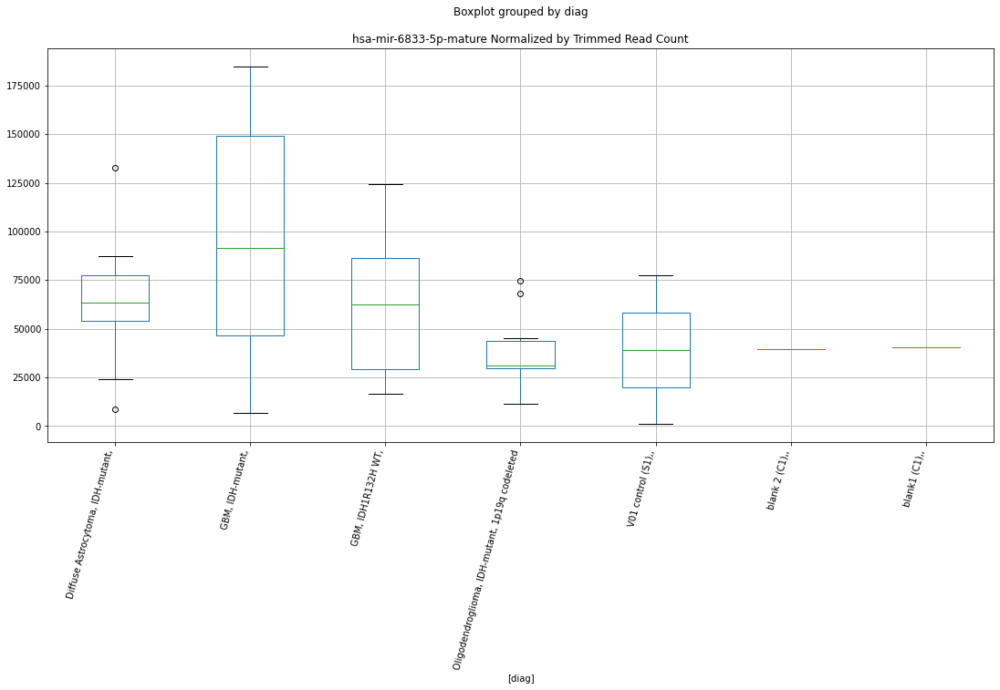

 p : 0.009393560306698693  ( t : 2.9074221378185876 ) :  Lexogen  :  bbduk2  :  hsa-mir-6883-hairpin
Control and blanks
79          NaN
343    36730.38
Name: hsa-mir-6883-hairpin, dtype: float64
211    7652.58
Name: hsa-mir-6883-hairpin, dtype: float64
475   NaN
Name: hsa-mir-6883-hairpin, dtype: float64


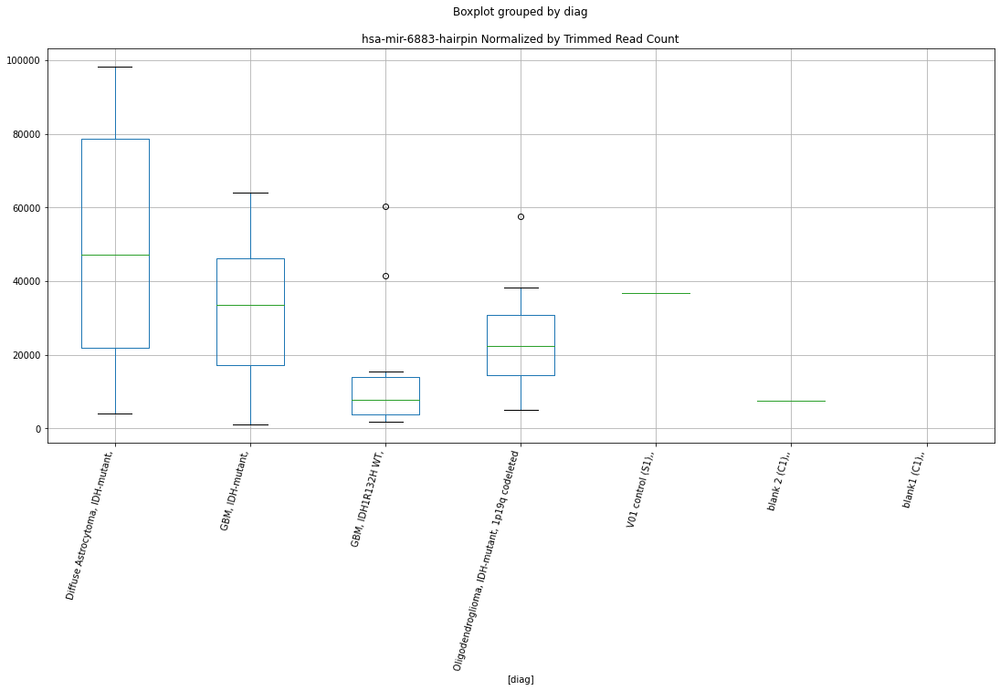

 p : 0.009409905756496466  ( t : 2.9066175750896264 ) :  D-plex  :  cutadapt2  :  hsa-mir-8085-hairpin
Control and blanks
76     19697.97
340    23779.77
Name: hsa-mir-8085-hairpin, dtype: float64
208    14814.26
Name: hsa-mir-8085-hairpin, dtype: float64
472    27741.88
Name: hsa-mir-8085-hairpin, dtype: float64


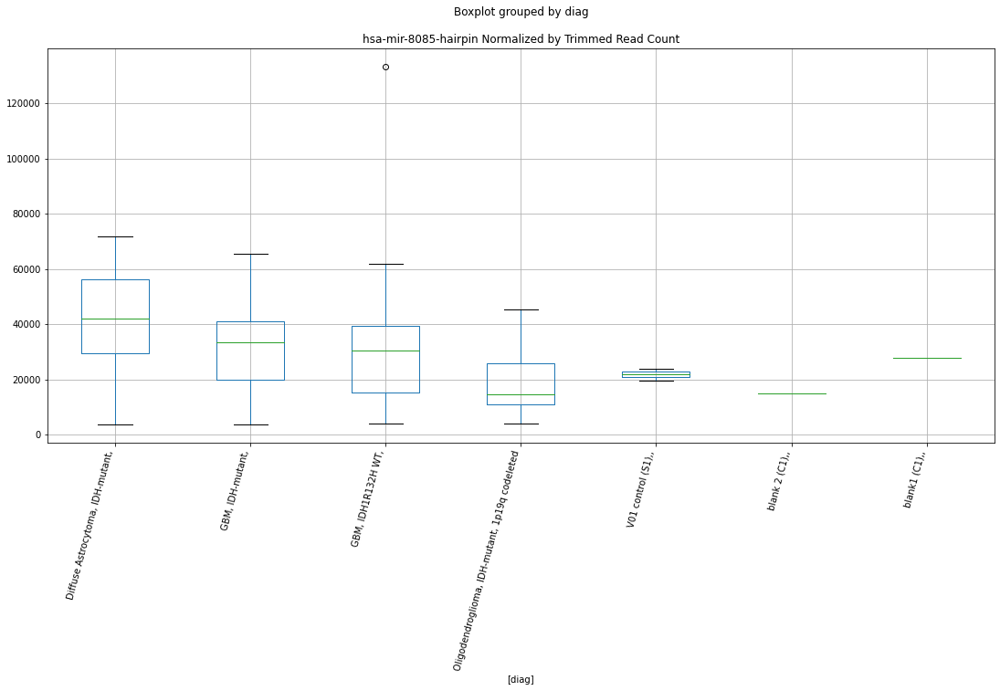

 p : 0.00947710772620121  ( t : 2.9033238586899324 ) :  Lexogen  :  cutadapt2  :  hsa-mir-10b-hairpin
Control and blanks
82       1420.05
346    135730.27
Name: hsa-mir-10b-hairpin, dtype: float64
214    8679.25
Name: hsa-mir-10b-hairpin, dtype: float64
478    237.46
Name: hsa-mir-10b-hairpin, dtype: float64


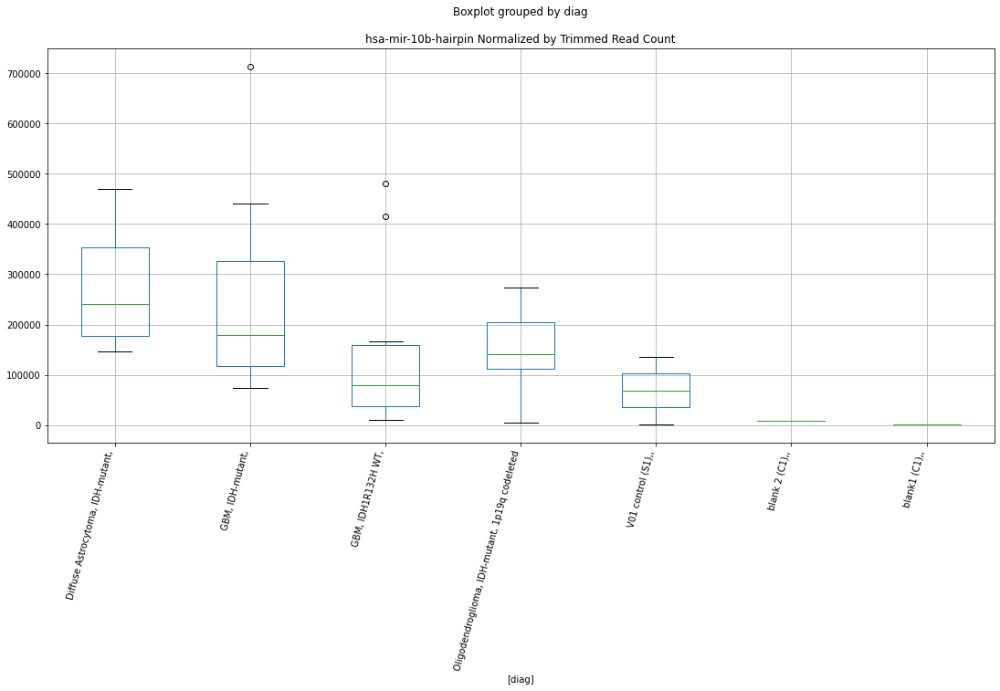

 p : 0.00952282141630274  ( t : 2.9010962013642216 ) :  D-plex  :  bbduk2  :  hsa-mir-3907-hairpin
Control and blanks
73     268233.92
337     63201.17
Name: hsa-mir-3907-hairpin, dtype: float64
205    218132.78
Name: hsa-mir-3907-hairpin, dtype: float64
469    150839.47
Name: hsa-mir-3907-hairpin, dtype: float64


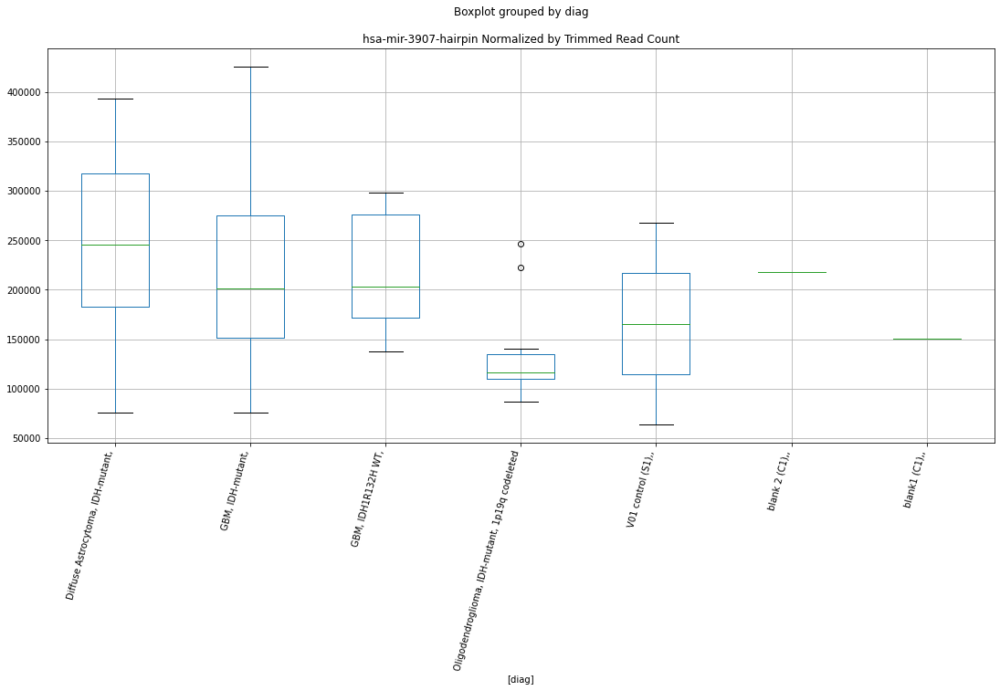

 p : 0.009523468783380031  ( t : 2.9010647289982248 ) :  D-plex  :  bbduk2  :  hsa-mir-548f-3-hairpin
Control and blanks
73     10049.11
337    69432.27
Name: hsa-mir-548f-3-hairpin, dtype: float64
205    94918.2
Name: hsa-mir-548f-3-hairpin, dtype: float64
469    62110.37
Name: hsa-mir-548f-3-hairpin, dtype: float64


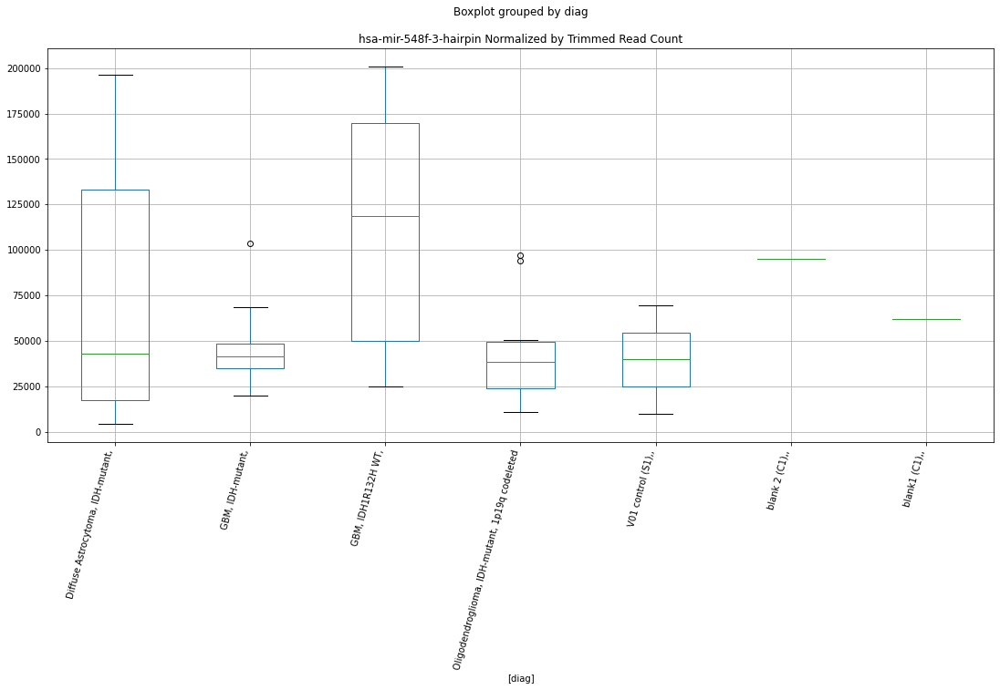

 p : 0.009570209821691102  ( t : 2.8987978129907064 ) :  Lexogen  :  cutadapt2  :  hsa-mir-25-hairpin
Control and blanks
82     80942.91
346    68812.09
Name: hsa-mir-25-hairpin, dtype: float64
214    35530.67
Name: hsa-mir-25-hairpin, dtype: float64
478    32057.17
Name: hsa-mir-25-hairpin, dtype: float64


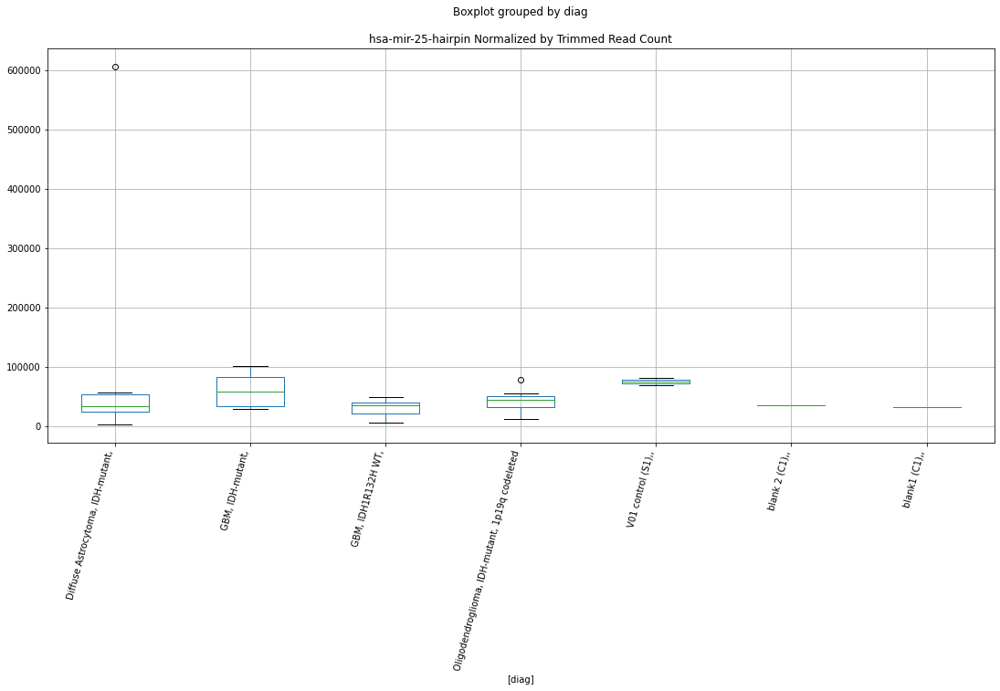

 p : 0.00957362762650072  ( t : 2.898632471103838 ) :  Lexogen  :  bbduk2  :  hsa-mir-10b-hairpin
Control and blanks
79       1430.60
343    137579.68
Name: hsa-mir-10b-hairpin, dtype: float64
211    9565.72
Name: hsa-mir-10b-hairpin, dtype: float64
475    479.03
Name: hsa-mir-10b-hairpin, dtype: float64


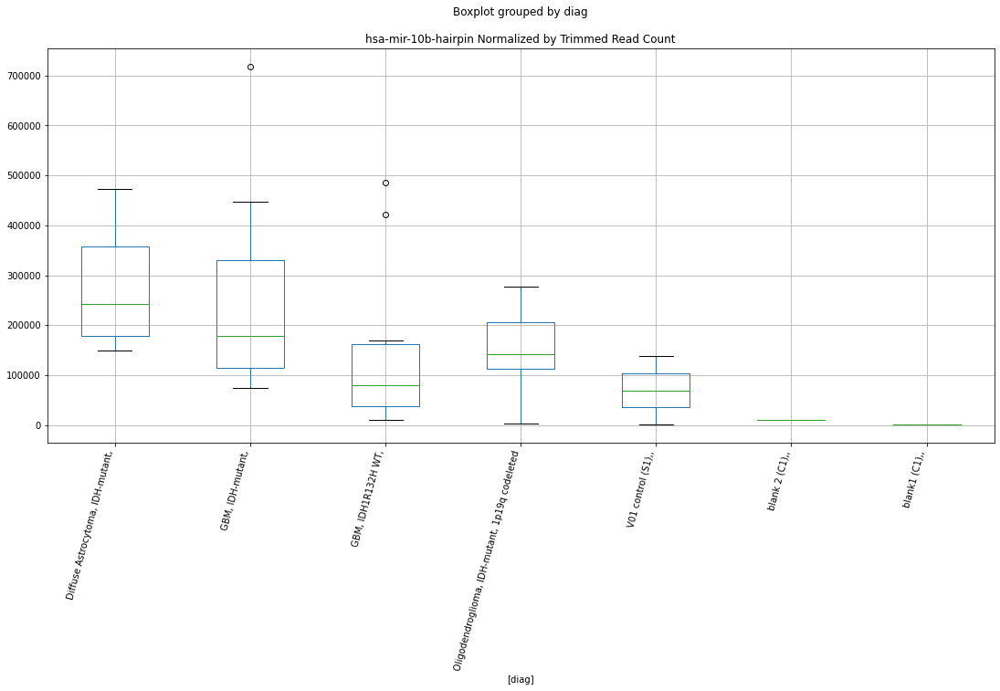

 p : 0.009660069348550132  ( t : 2.894469556828656 ) :  Lexogen  :  cutadapt2  :  hsa-mir-1227-hairpin
Control and blanks
82      1420.05
346    14940.85
Name: hsa-mir-1227-hairpin, dtype: float64
214    1898.59
Name: hsa-mir-1227-hairpin, dtype: float64
478   NaN
Name: hsa-mir-1227-hairpin, dtype: float64


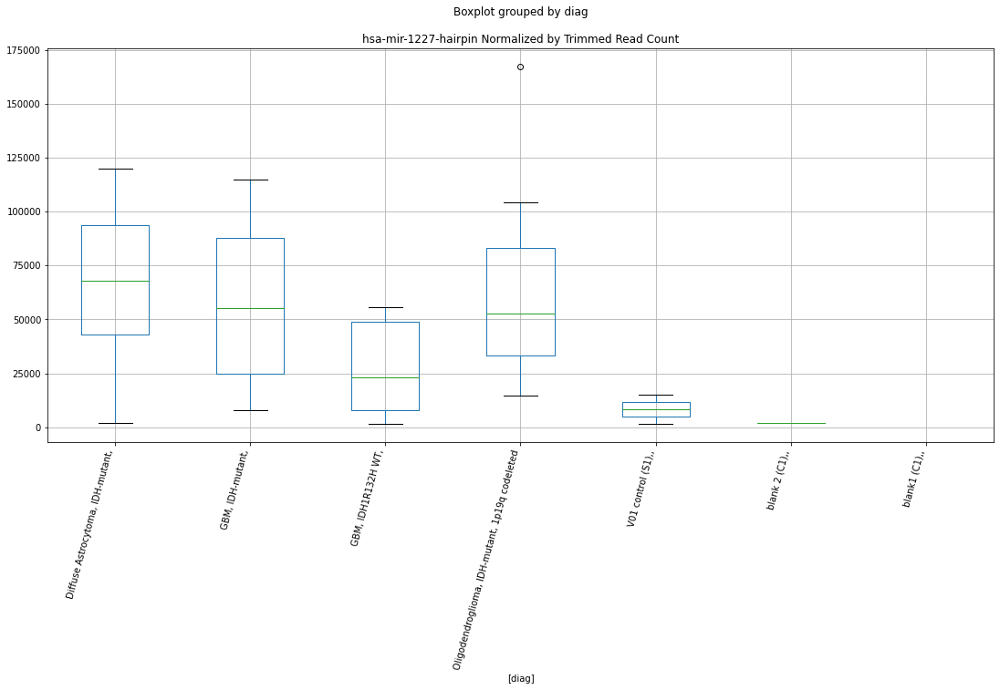

 p : 0.009666254496866622  ( t : 2.8941730693775494 ) :  D-plex  :  bbduk2  :  hsa-mir-1343-5p-mature
Control and blanks
73     5411.06
337    1780.31
Name: hsa-mir-1343-5p-mature, dtype: float64
205    18983.64
Name: hsa-mir-1343-5p-mature, dtype: float64
469    10647.49
Name: hsa-mir-1343-5p-mature, dtype: float64


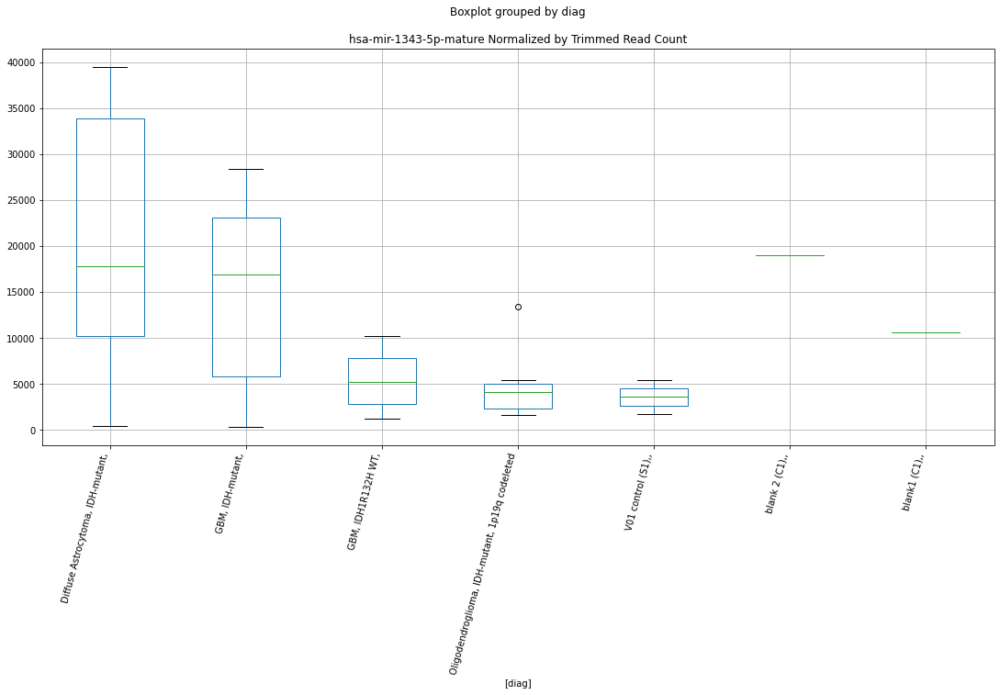

 p : 0.009758319364898715  ( t : 2.889781430404004 ) :  D-plex  :  bbduk2  :  hsa-mir-320e-hairpin
Control and blanks
73     101264.1
337     31155.5
Name: hsa-mir-320e-hairpin, dtype: float64
205    73606.38
Name: hsa-mir-320e-hairpin, dtype: float64
469    30759.42
Name: hsa-mir-320e-hairpin, dtype: float64


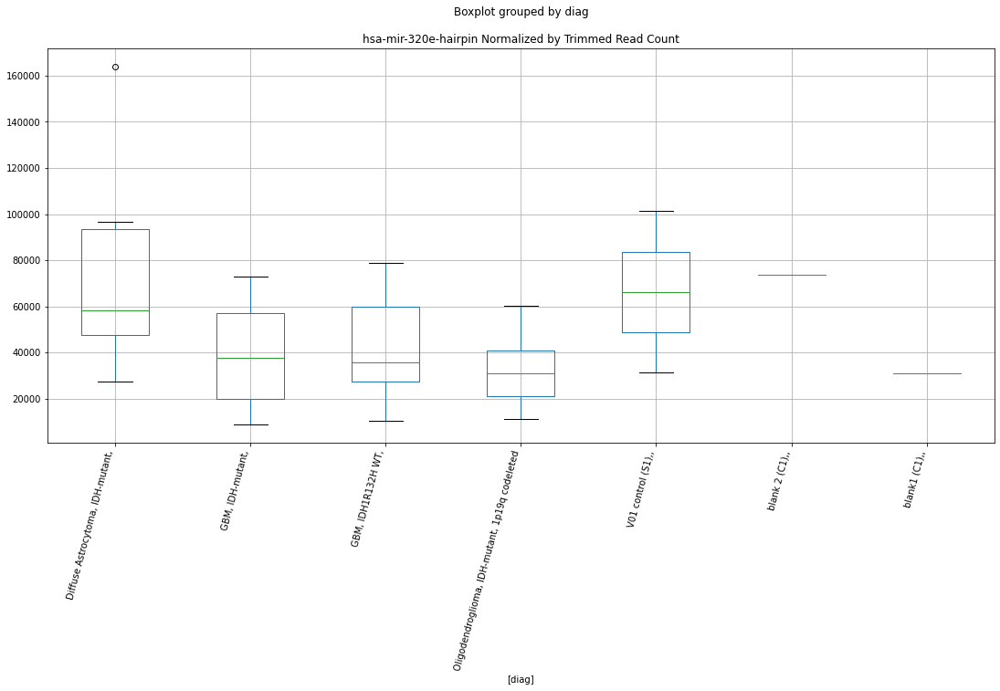

 p : 0.009850260362642646  ( t : 2.885435442403513 ) :  Lexogen  :  bbduk2  :  hsa-mir-1227-hairpin
Control and blanks
79      1430.6
343    14862.0
Name: hsa-mir-1227-hairpin, dtype: float64
211    1913.14
Name: hsa-mir-1227-hairpin, dtype: float64
475   NaN
Name: hsa-mir-1227-hairpin, dtype: float64


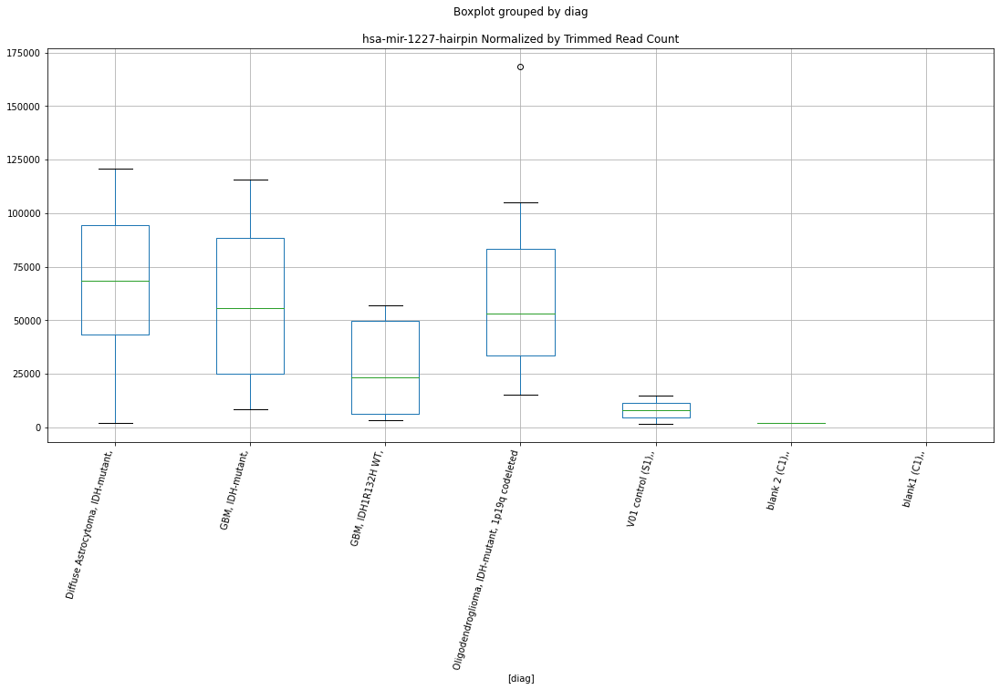

 p : 0.009898097538359215  ( t : 2.883189674783589 ) :  D-plex  :  cutadapt2  :  hsa-mir-3124-hairpin
Control and blanks
76     47729.7
340    22018.3
Name: hsa-mir-3124-hairpin, dtype: float64
208    28041.27
Name: hsa-mir-3124-hairpin, dtype: float64
472    41612.82
Name: hsa-mir-3124-hairpin, dtype: float64


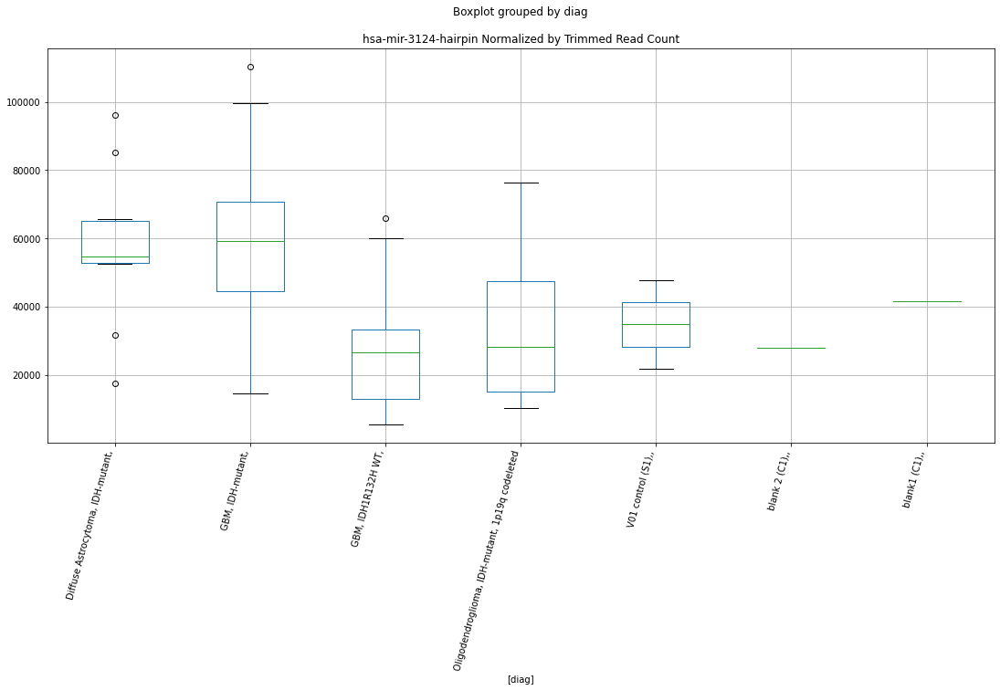

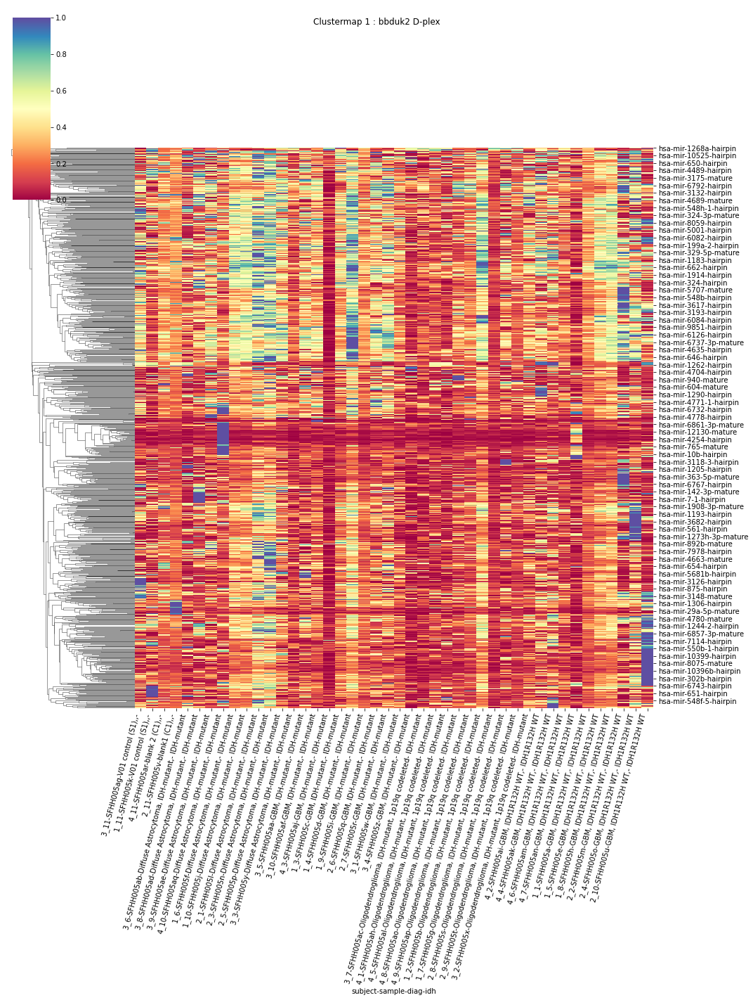

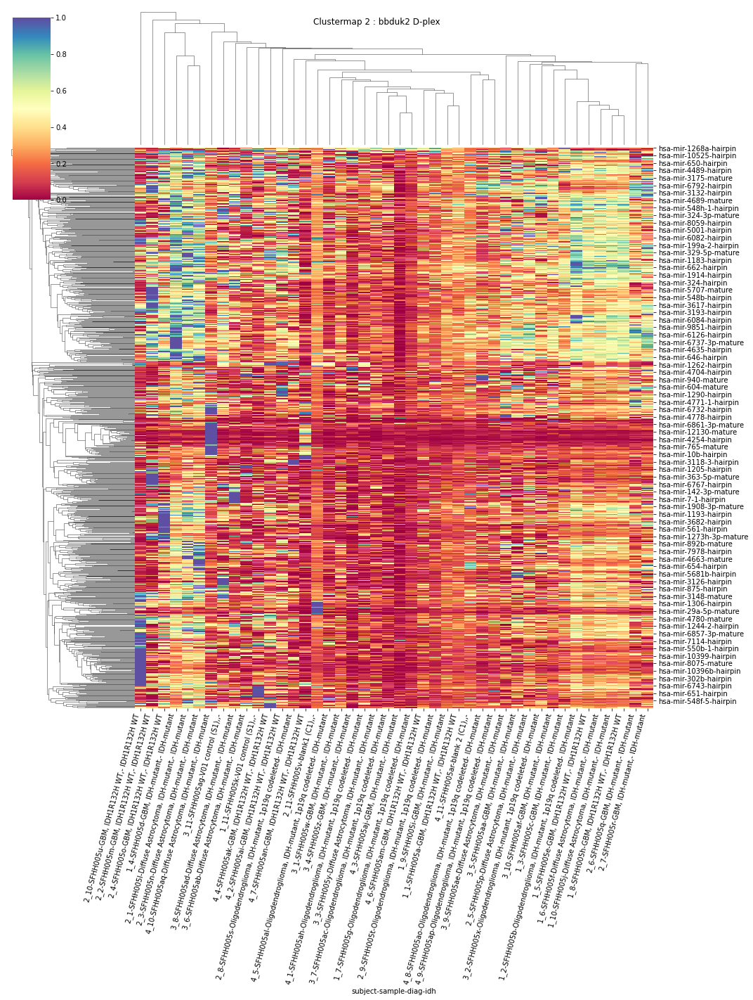

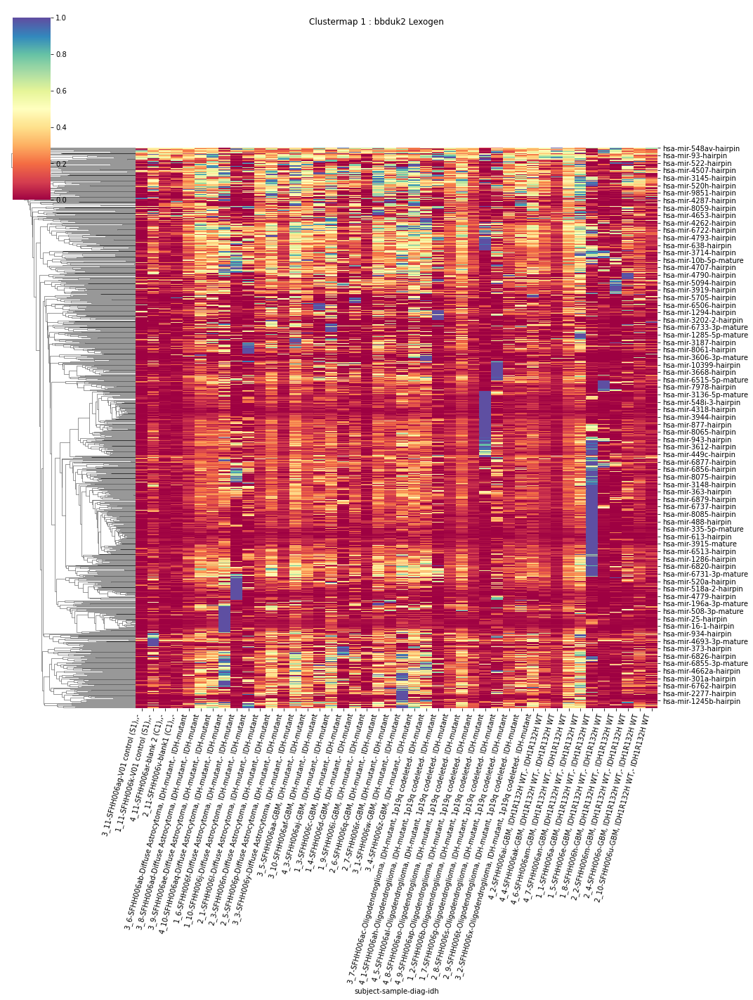

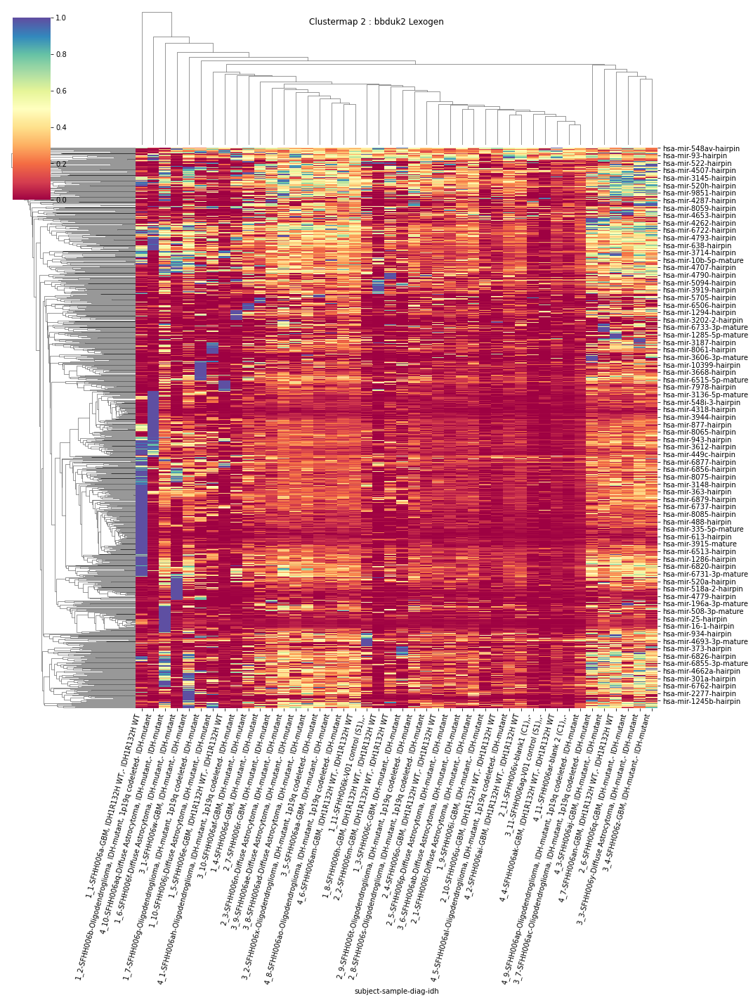

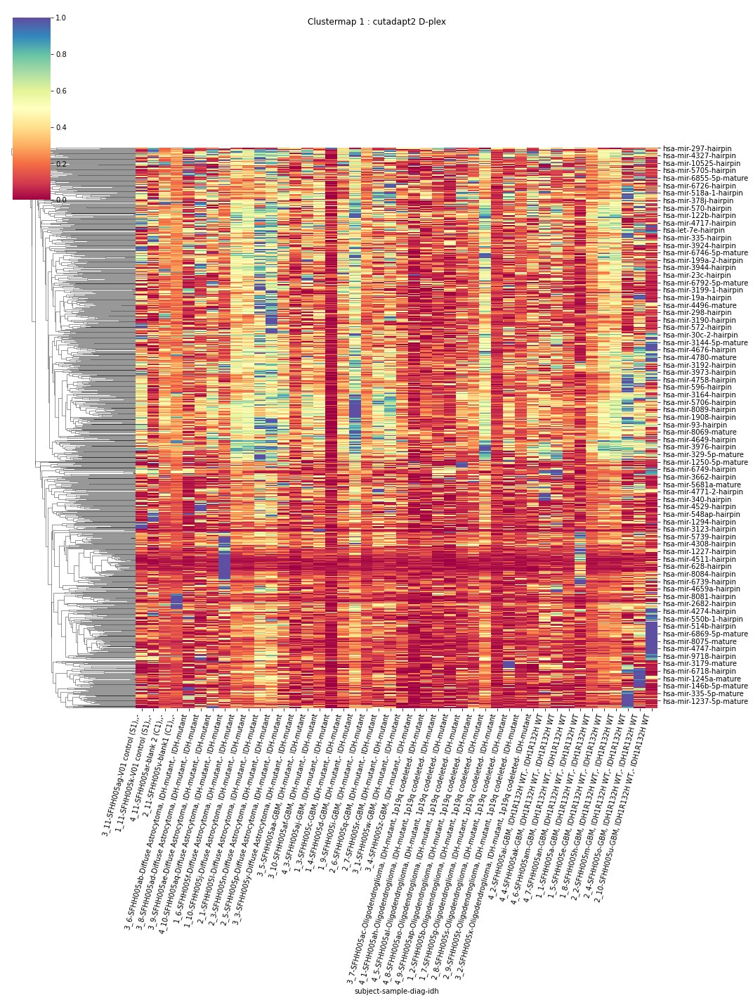

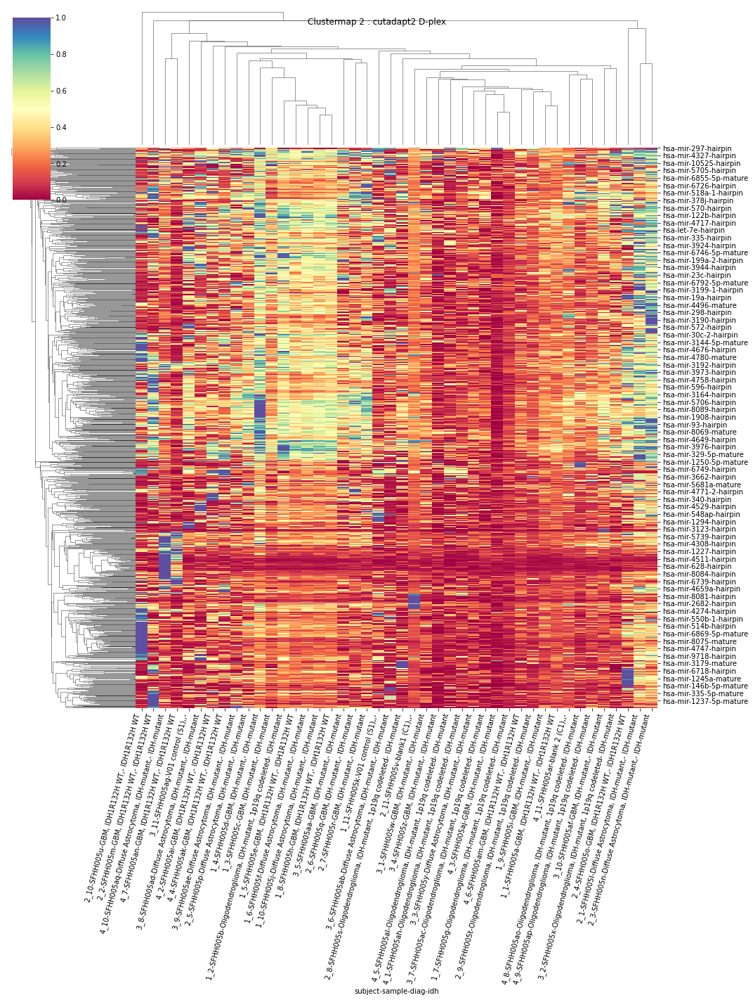

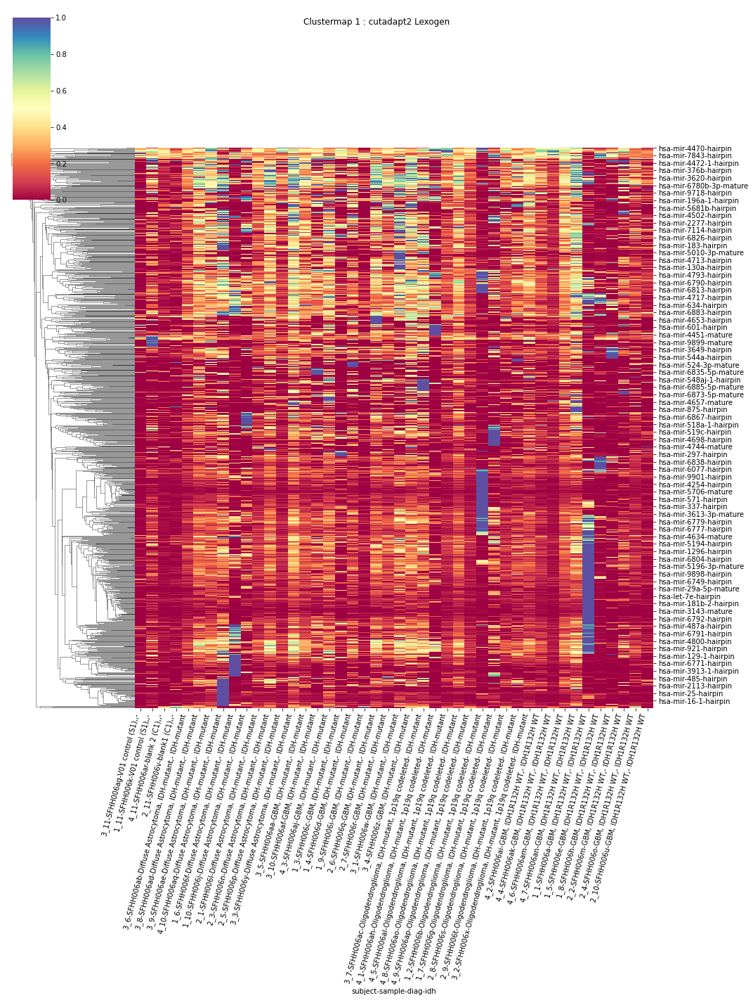

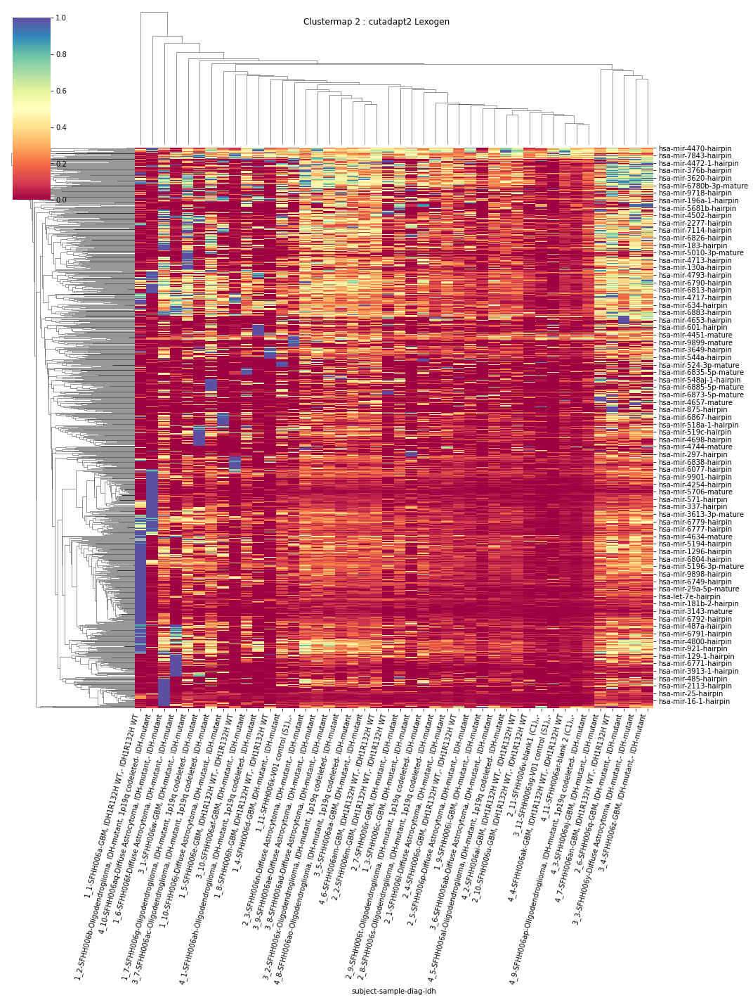

In [80]:
ttests_boxplots_and_heatmaps(dfn,mirnas)

# mRNA_Prot

 p : 0.003393371050070529  ( t : 3.372296103500296 ) :  D-plex  :  cutadapt2  :  NM_001134232.2
Control and blanks
76     35607.87
340    13210.98
Name: NM_001134232.2, dtype: float64
208    11287.05
Name: NM_001134232.2, dtype: float64
472    9825.25
Name: NM_001134232.2, dtype: float64


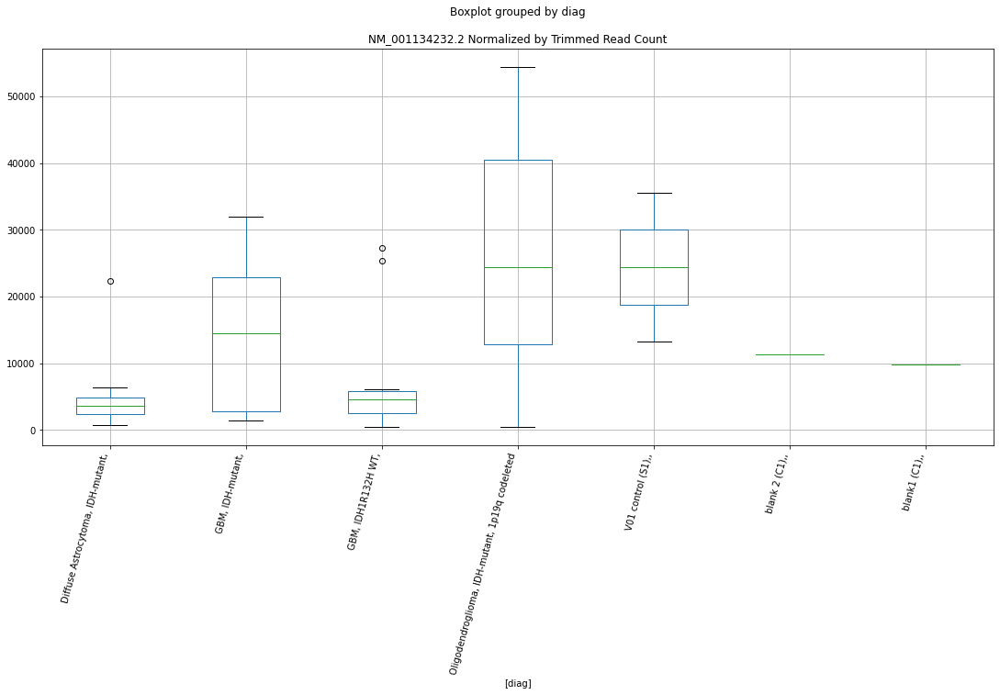

 p : 0.004536230490124078  ( t : 3.2408181529981452 ) :  D-plex  :  bbduk2  :  NM_018374.4
Control and blanks
73     32466.35
337     8901.57
Name: NM_018374.4, dtype: float64
205    9133.64
Name: NM_018374.4, dtype: float64
469    7689.86
Name: NM_018374.4, dtype: float64


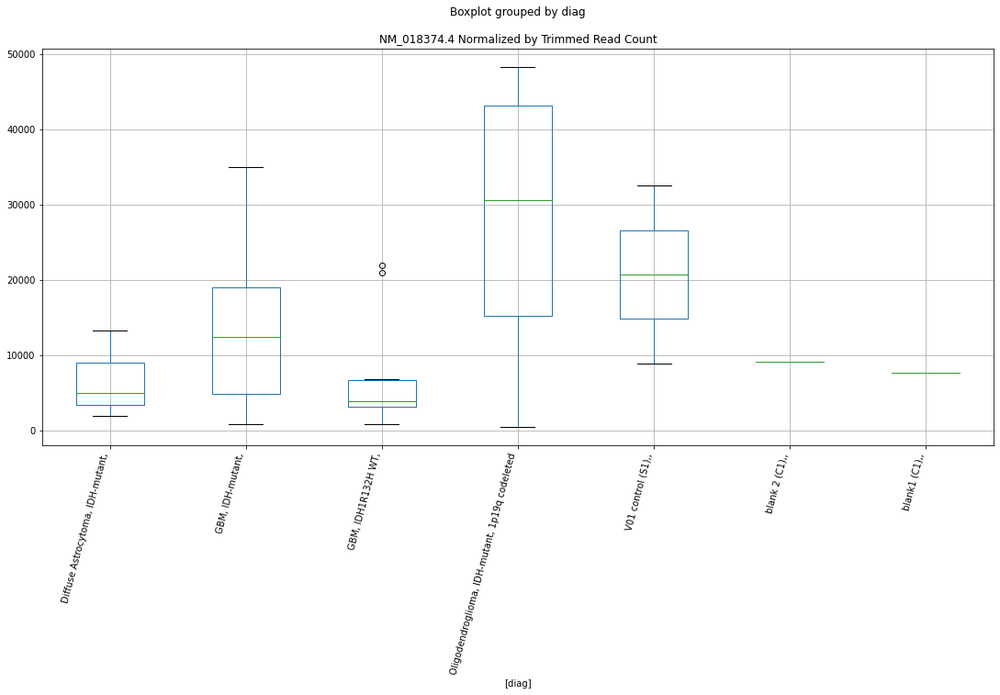

 p : 0.00682320942189189  ( t : 3.054628035203717 ) :  D-plex  :  bbduk2  :  XM_017016038.1
Control and blanks
73     3092.03
337    1780.31
Name: XM_017016038.1, dtype: float64
205    15580.91
Name: XM_017016038.1, dtype: float64
469    14196.66
Name: XM_017016038.1, dtype: float64


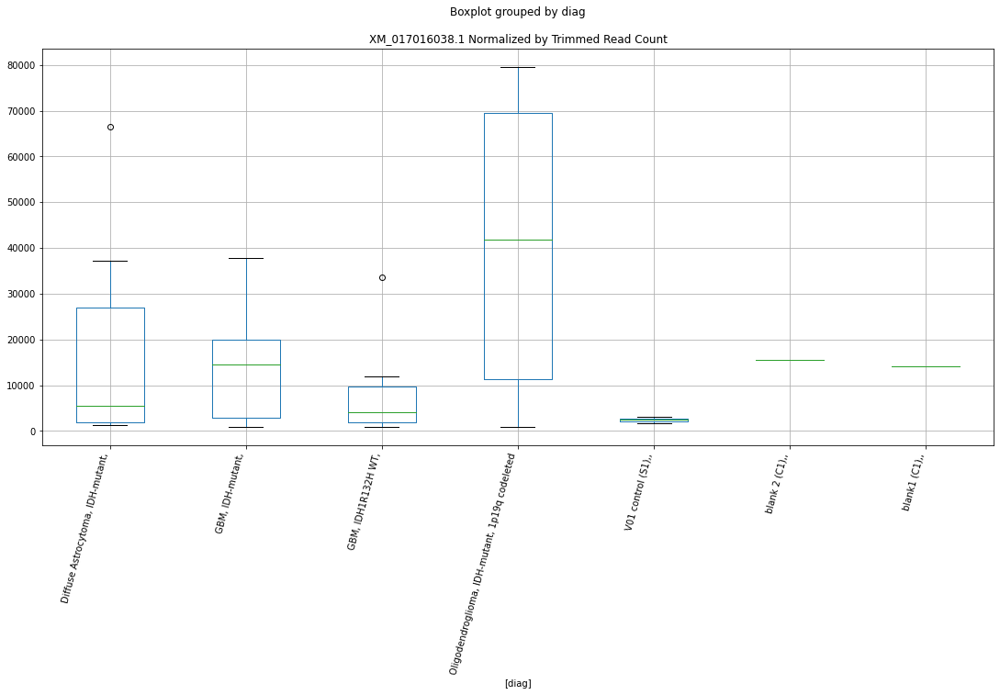

 p : 0.006912829623531446  ( t : 3.04864618928144 ) :  D-plex  :  cutadapt2  :  NM_018374.4
Control and blanks
76     30304.57
340     9688.05
Name: NM_018374.4, dtype: float64
208    10228.89
Name: NM_018374.4, dtype: float64
472    11559.12
Name: NM_018374.4, dtype: float64


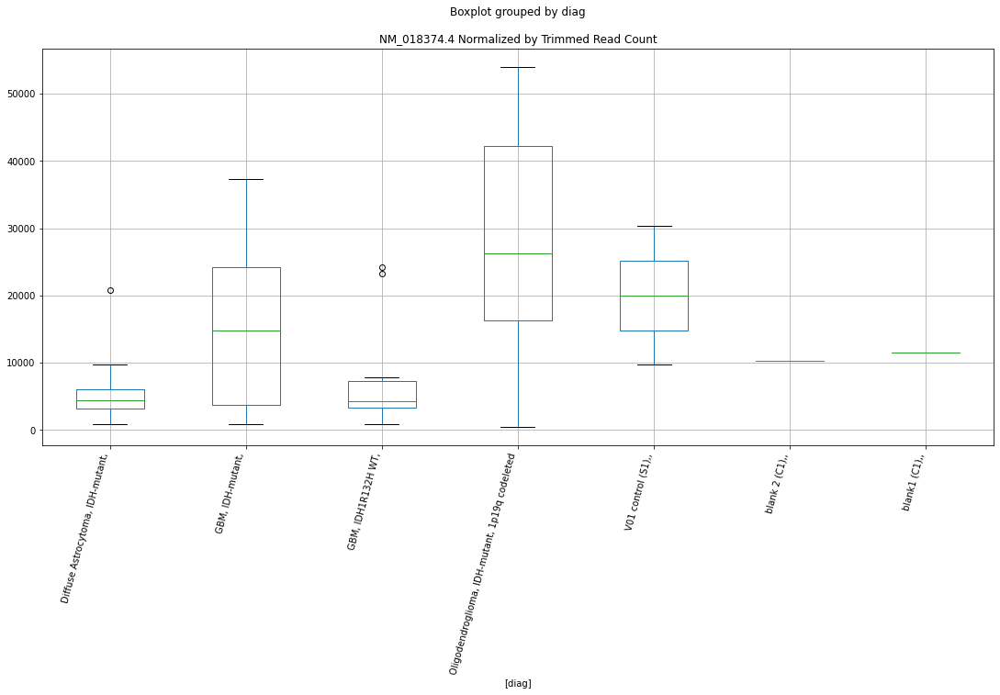

 p : 0.006960905287584014  ( t : 3.045468326197794 ) :  D-plex  :  bbduk2  :  NM_001134232.2
Control and blanks
73     37104.40
337     5340.94
Name: NM_001134232.2, dtype: float64
205    7880.0
Name: NM_001134232.2, dtype: float64
469    13605.13
Name: NM_001134232.2, dtype: float64


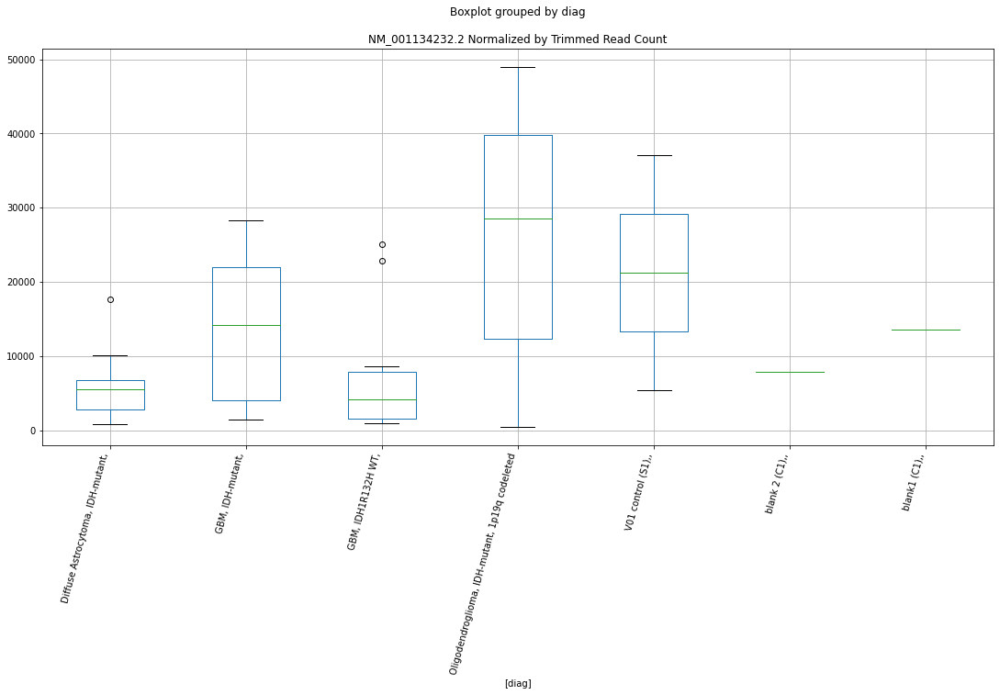

 p : 0.007374873599543034  ( t : 3.0189556152122763 ) :  D-plex  :  cutadapt2  :  NR_027253.1
Control and blanks
76     7576.14
340    1761.46
Name: NR_027253.1, dtype: float64
208    10757.97
Name: NR_027253.1, dtype: float64
472    6357.51
Name: NR_027253.1, dtype: float64


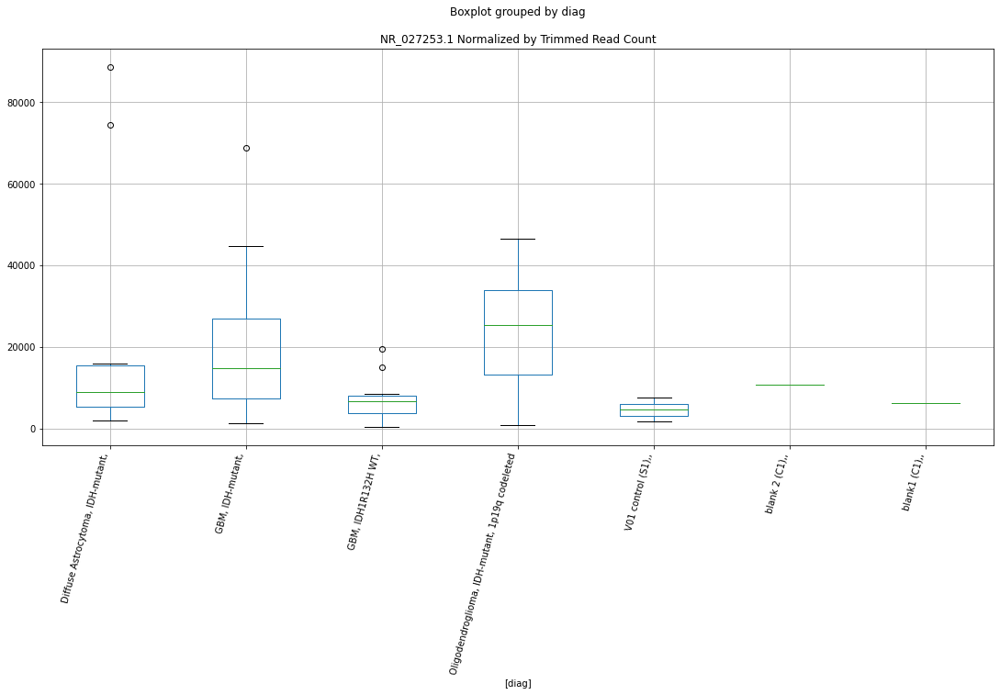

 p : 0.008005190120461848  ( t : 2.9812421563296794 ) :  Lexogen  :  cutadapt2  :  NR_029609.1
Control and blanks
82       1420.05
346    117843.33
Name: NR_029609.1, dtype: float64
214    5424.53
Name: NR_029609.1, dtype: float64
478   NaN
Name: NR_029609.1, dtype: float64


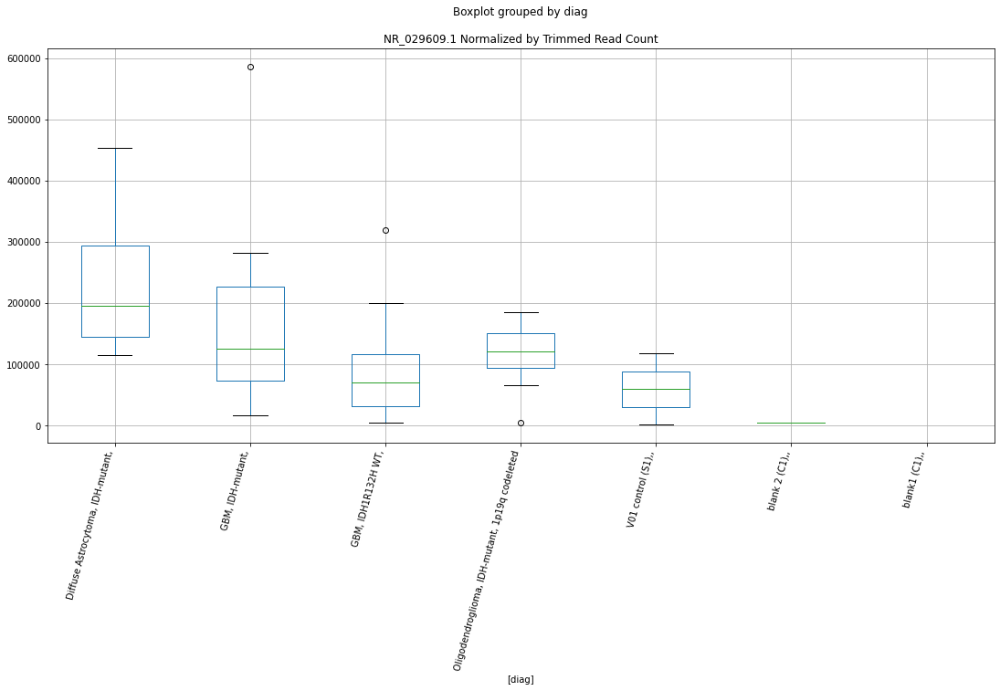

 p : 0.00800742332270485  ( t : 2.9811137326781547 ) :  Lexogen  :  bbduk2  :  NR_029609.1
Control and blanks
79       1430.60
343    118259.07
Name: NR_029609.1, dtype: float64
211    5466.13
Name: NR_029609.1, dtype: float64
475   NaN
Name: NR_029609.1, dtype: float64


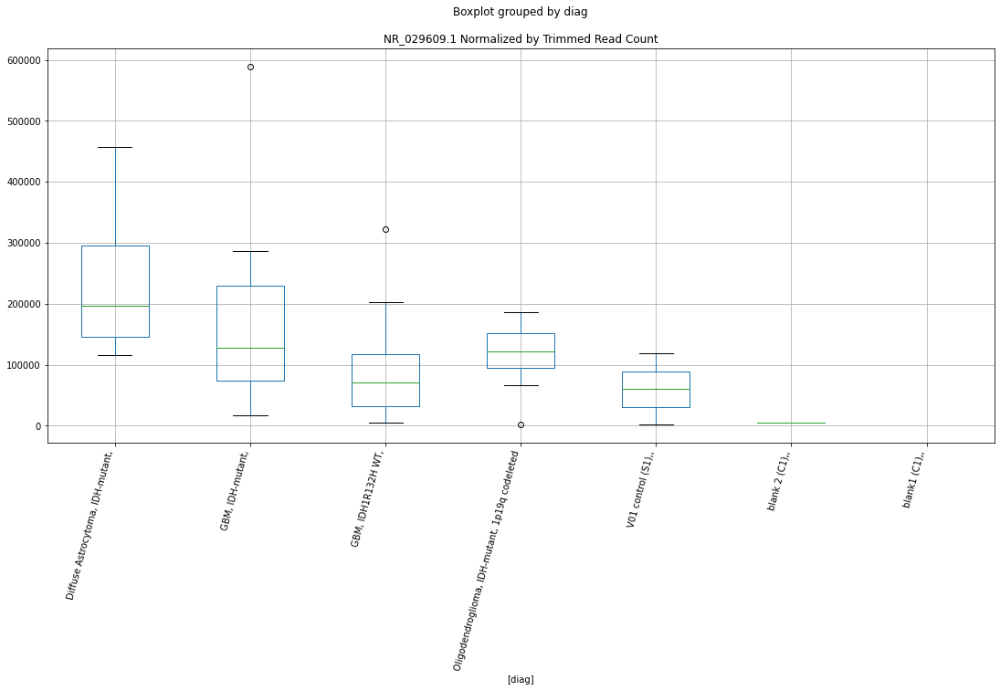

 p : 0.008394102637485608  ( t : 2.9593847376697604 ) :  D-plex  :  cutadapt2  :  NM_032522.5
Control and blanks
76      42426.40
340    133871.28
Name: NM_032522.5, dtype: float64
208    48322.7
Name: NM_032522.5, dtype: float64
472    46236.47
Name: NM_032522.5, dtype: float64


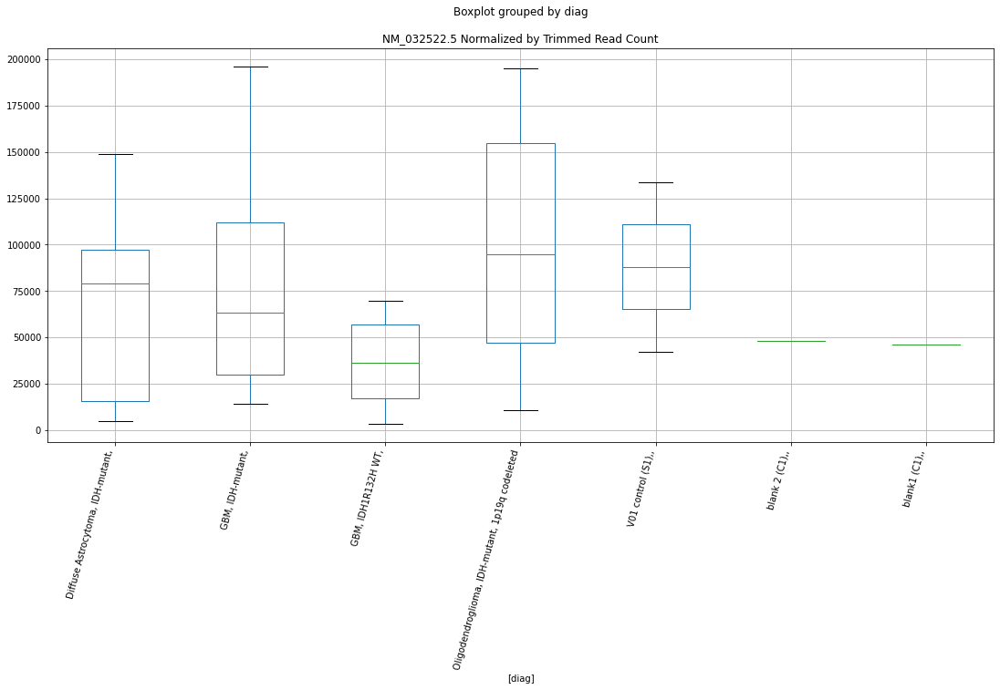

 p : 0.009160547606749617  ( t : 2.9190411205986835 ) :  D-plex  :  bbduk2  :  NM_173808.3
Control and blanks
73     8503.09
337    4450.79
Name: NM_173808.3, dtype: float64
205    29191.83
Name: NM_173808.3, dtype: float64
469    31350.95
Name: NM_173808.3, dtype: float64


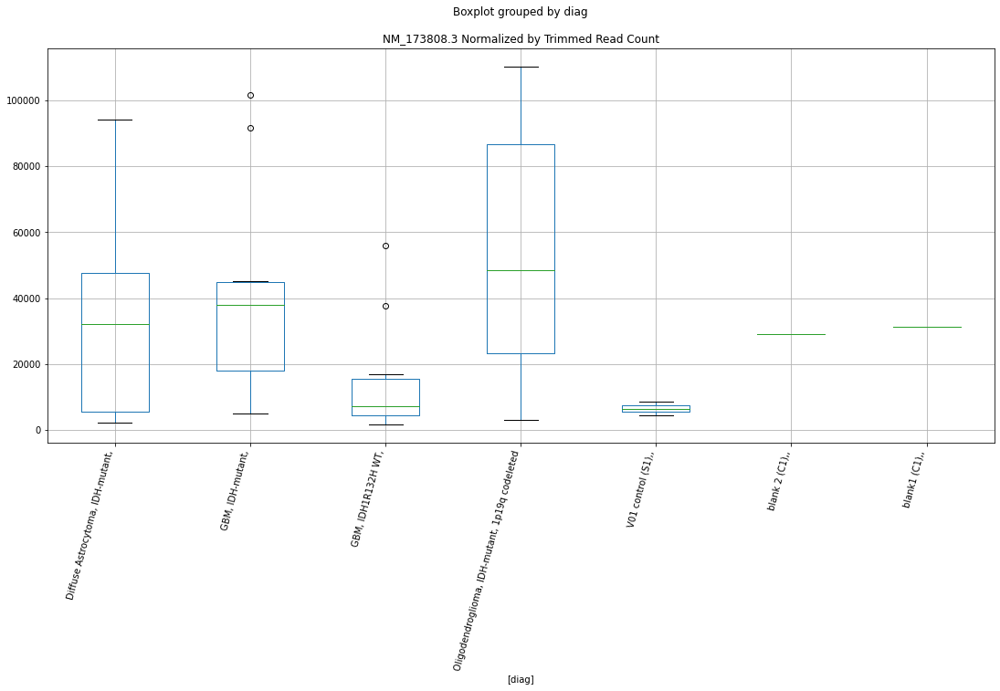

 p : 0.009432190254663991  ( t : 2.905522850951585 ) :  D-plex  :  bbduk2  :  XR_001748412.1
Control and blanks
73      773.01
337    7121.26
Name: XR_001748412.1, dtype: float64
205    7700.91
Name: XR_001748412.1, dtype: float64
469    7098.33
Name: XR_001748412.1, dtype: float64


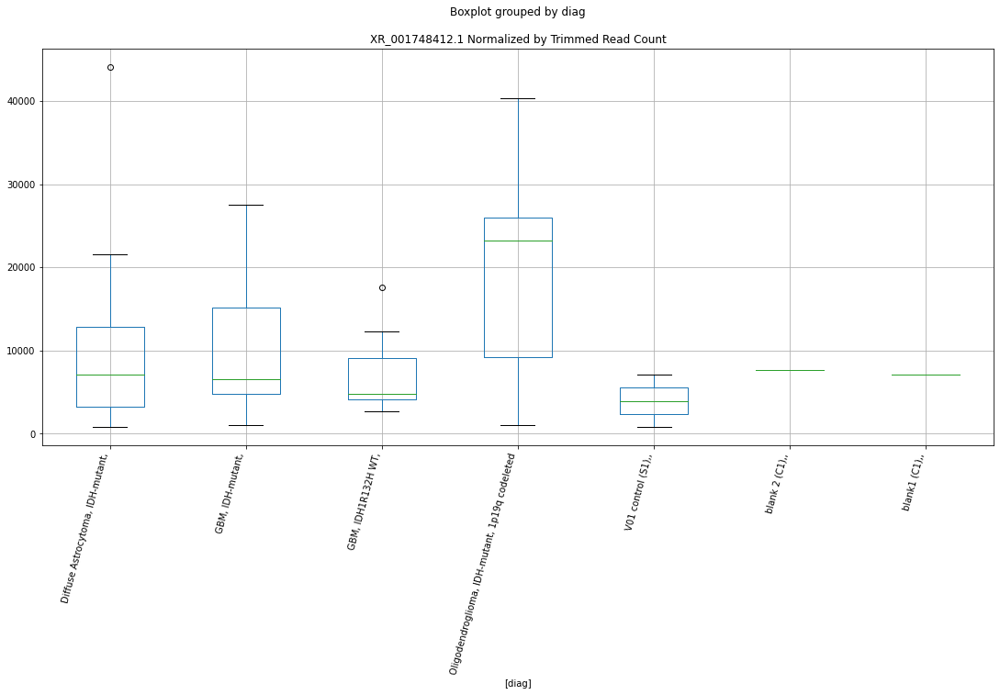

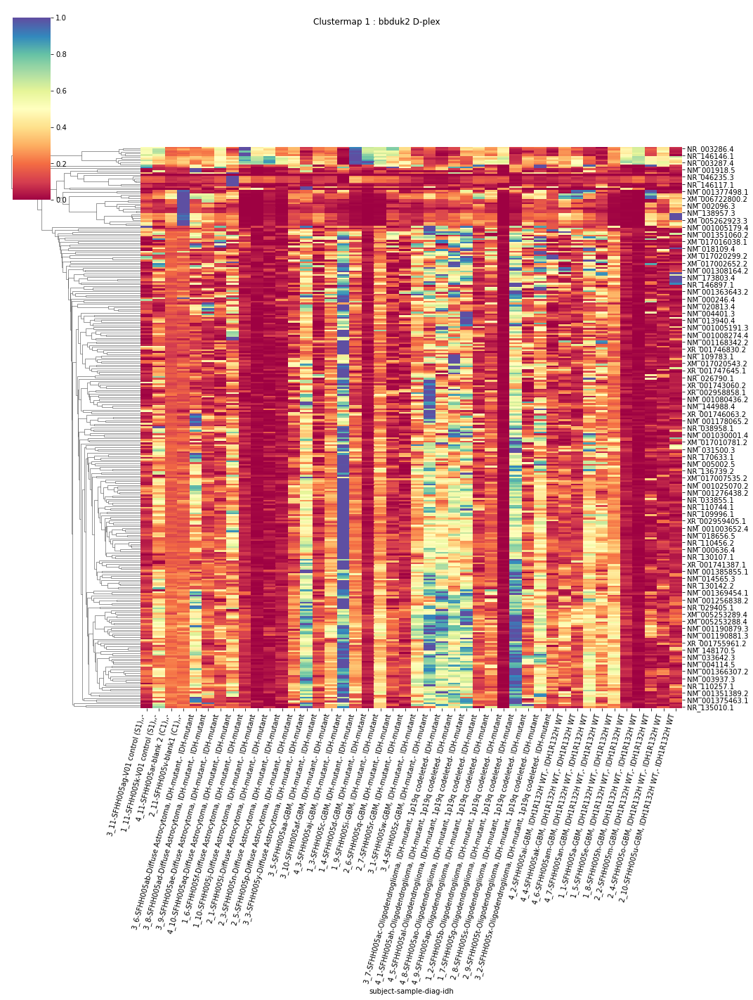

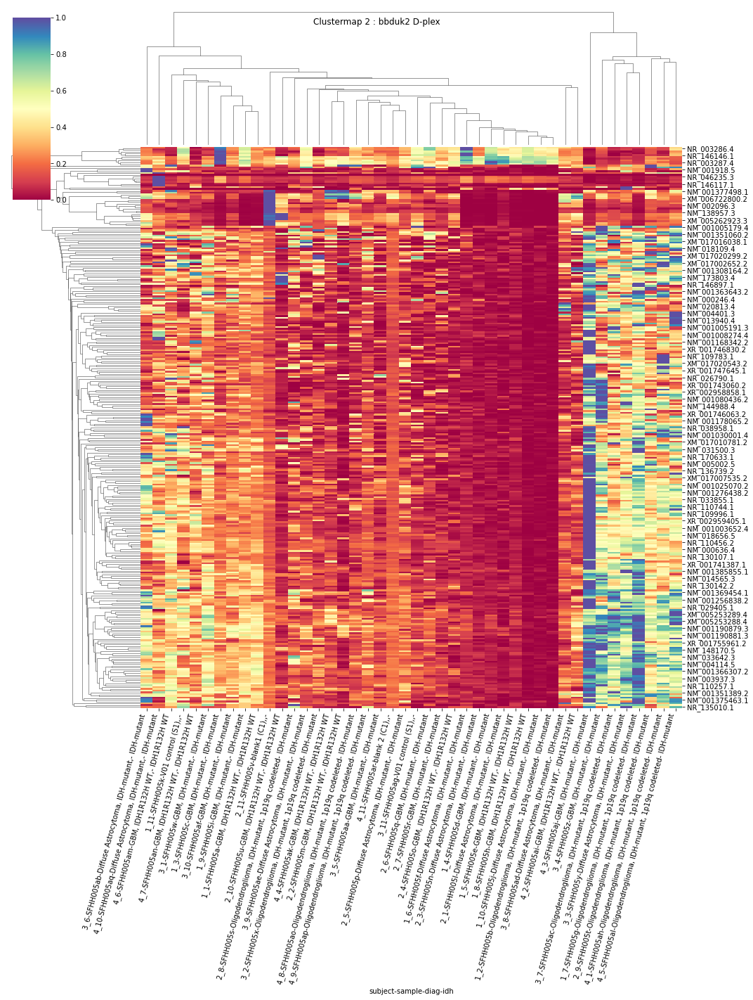

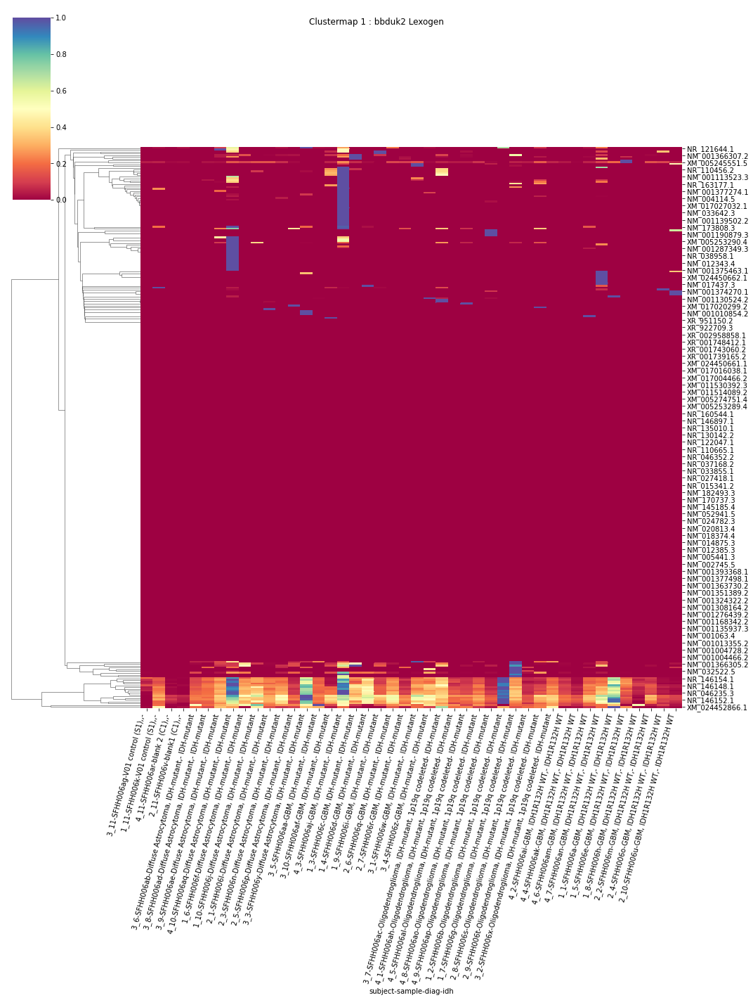

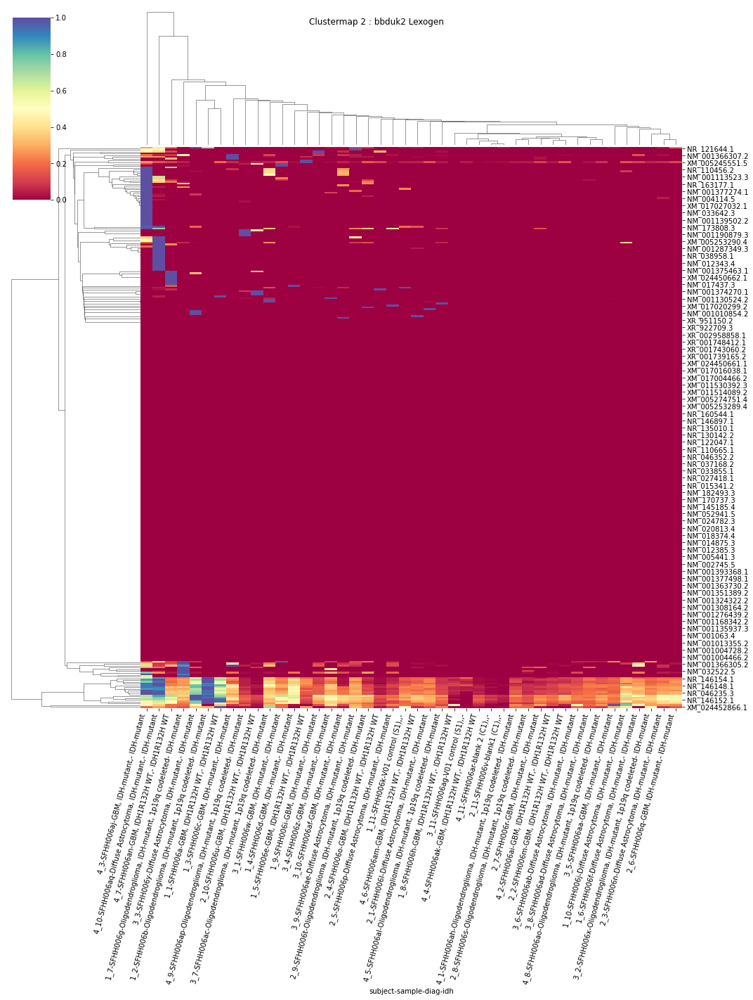

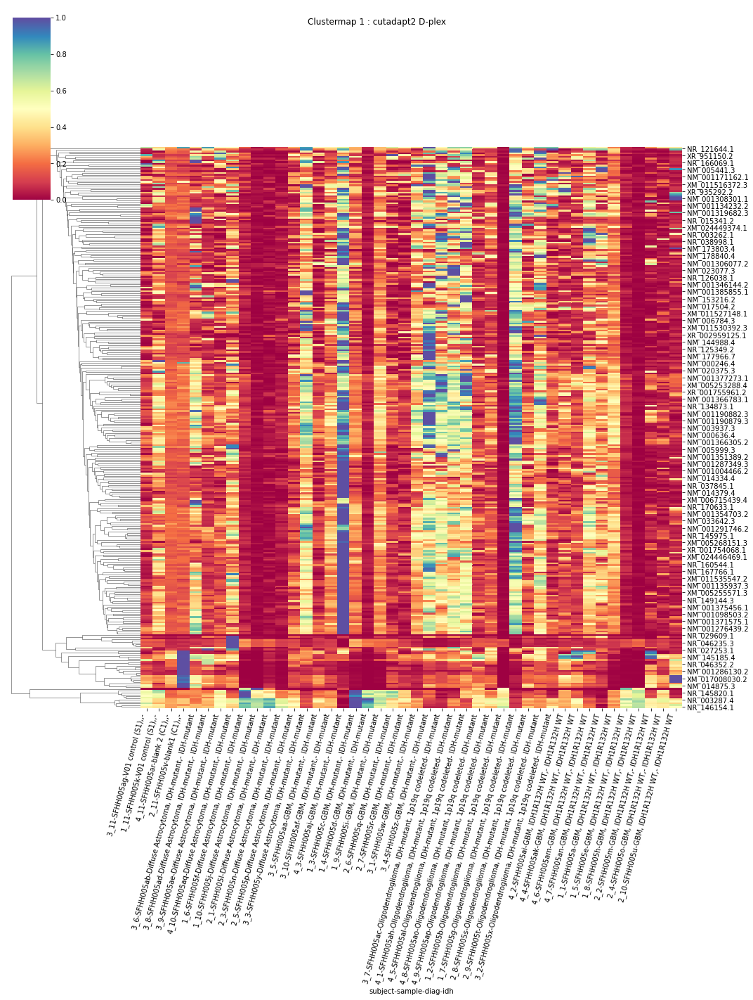

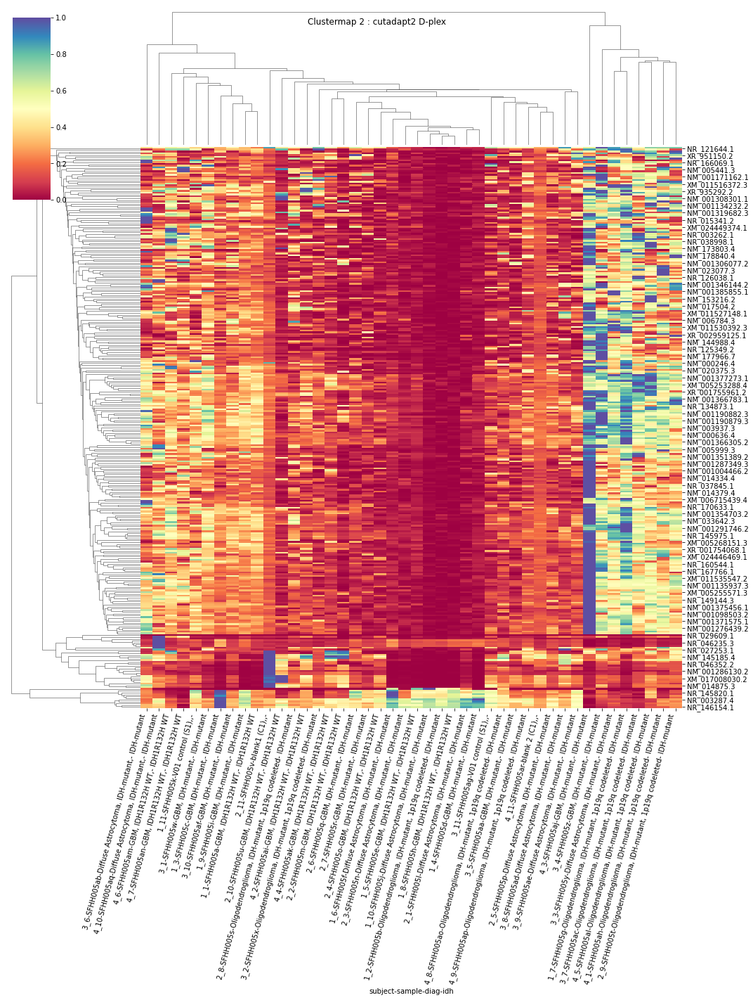

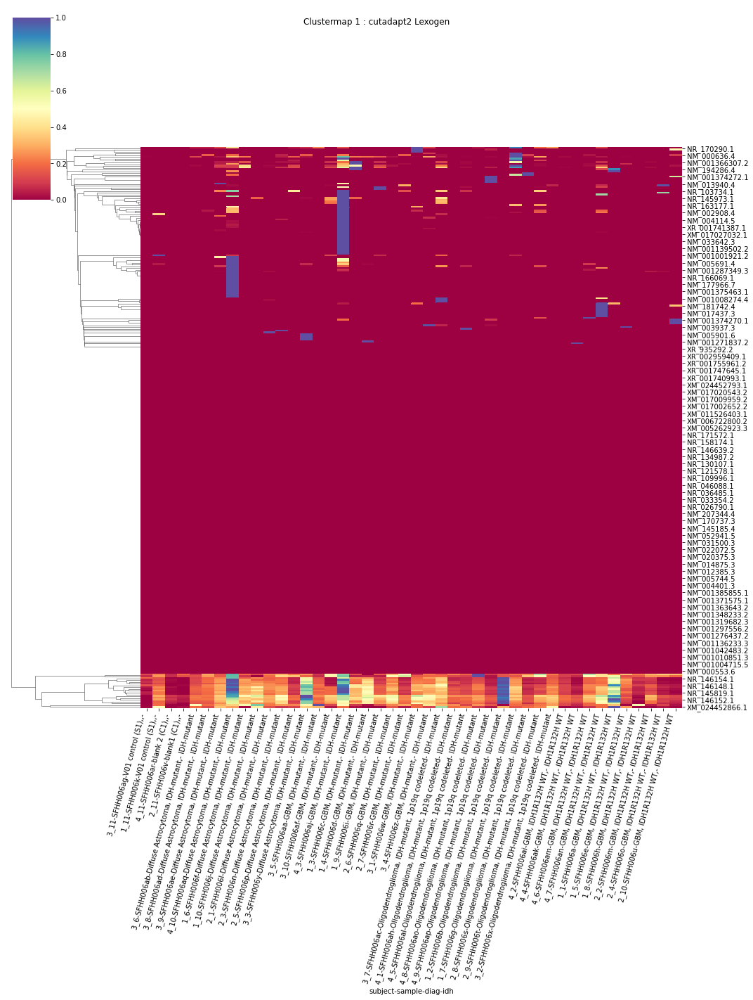

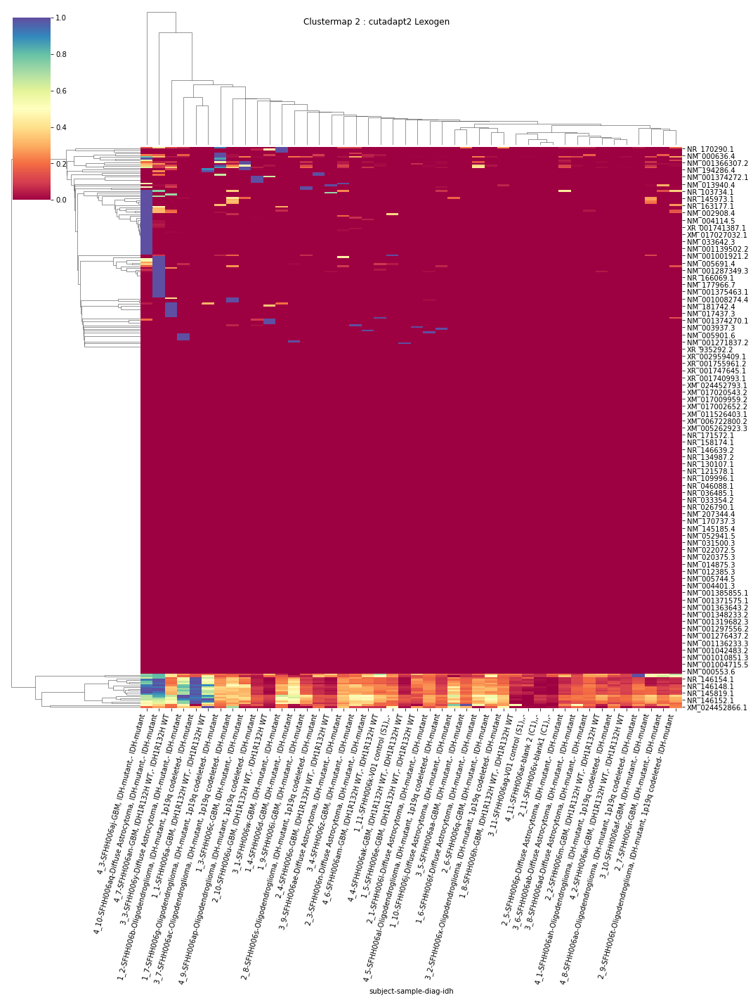

In [81]:
ttests_boxplots_and_heatmaps(dfn,mrnas)

# Diamond NR Families

In [82]:
#ttests_boxplots_and_heatmaps(dfn,diamond_families)

# RMSK Families

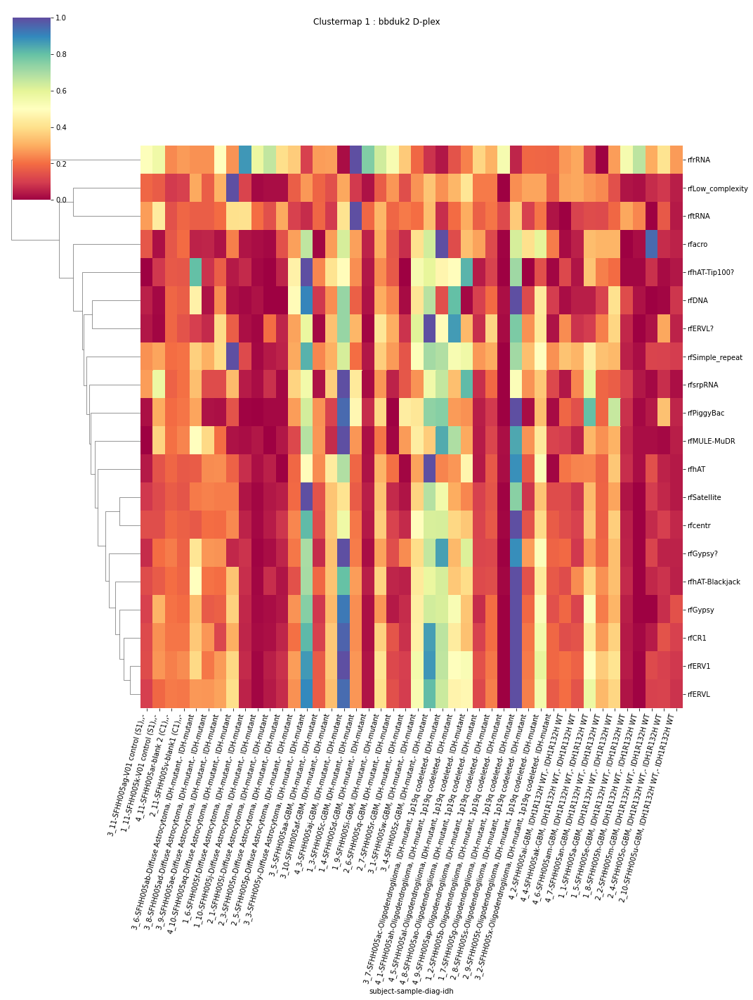

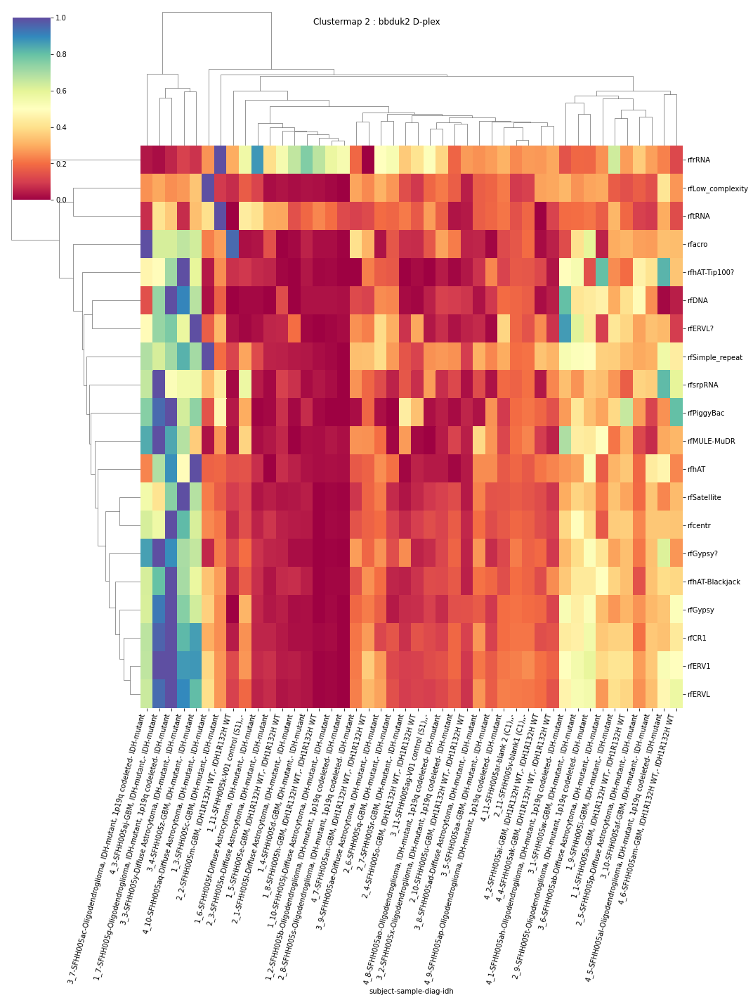

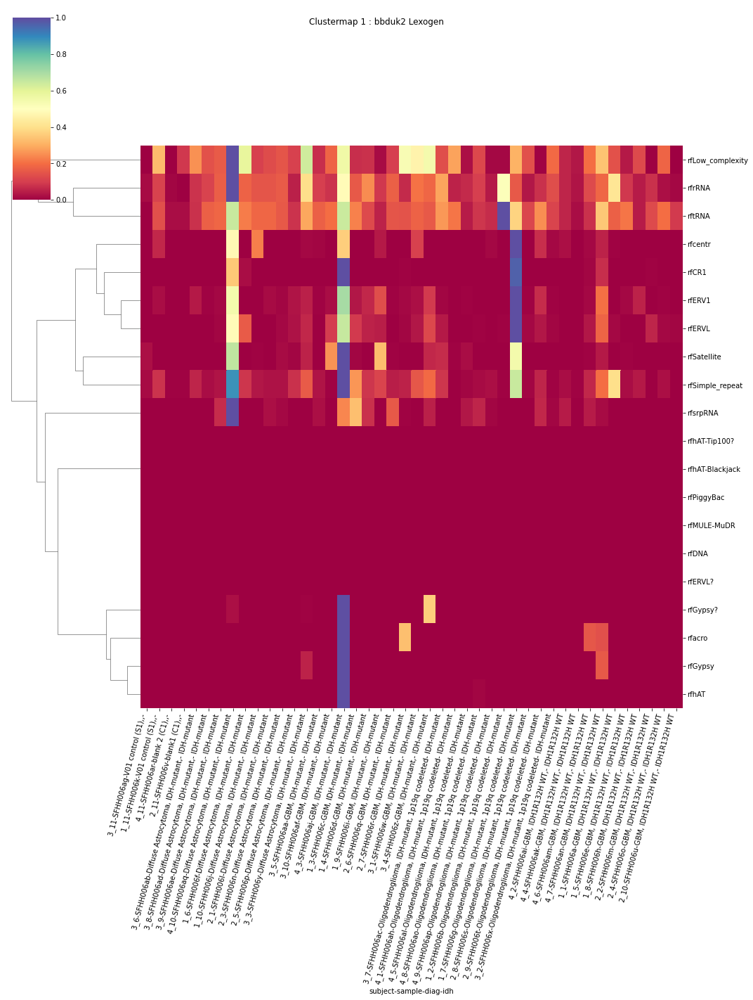

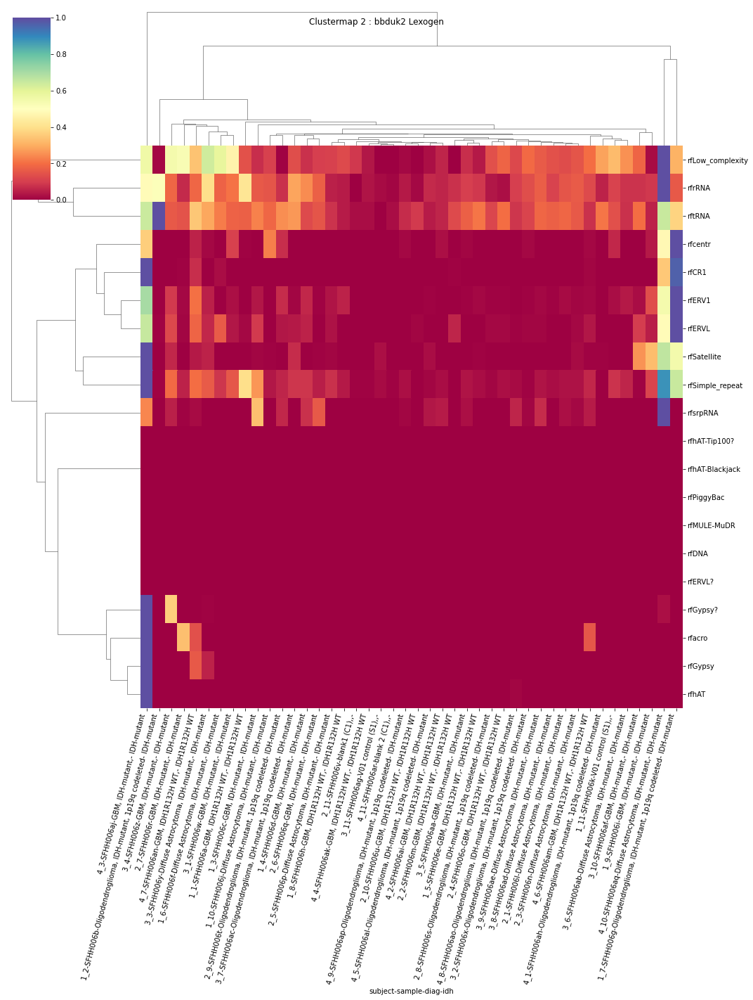

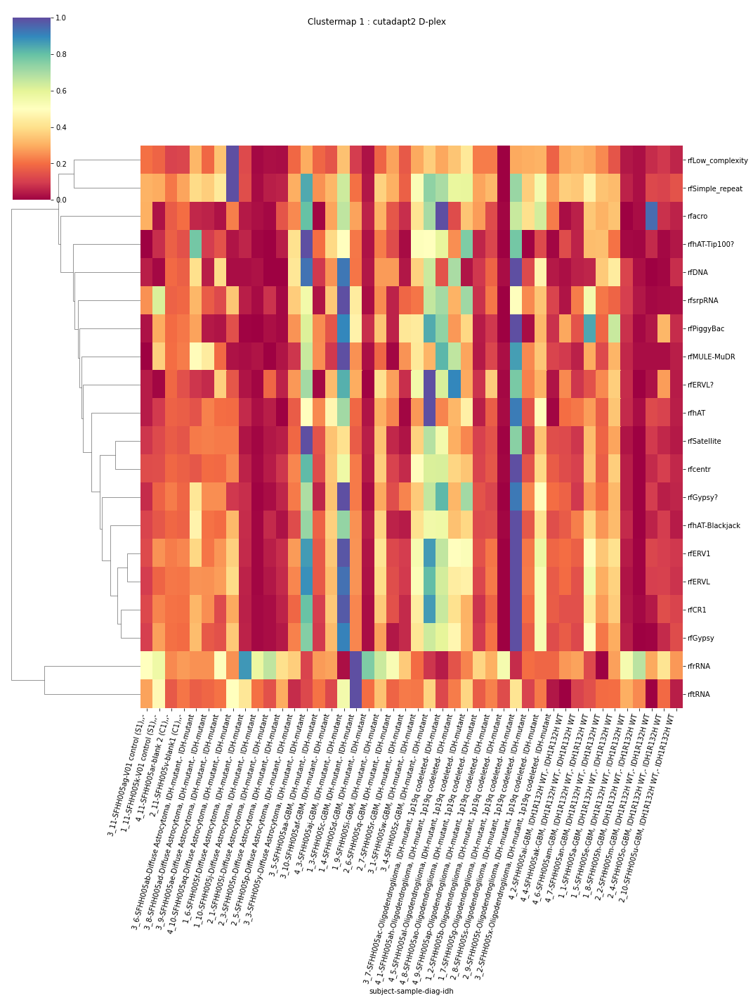

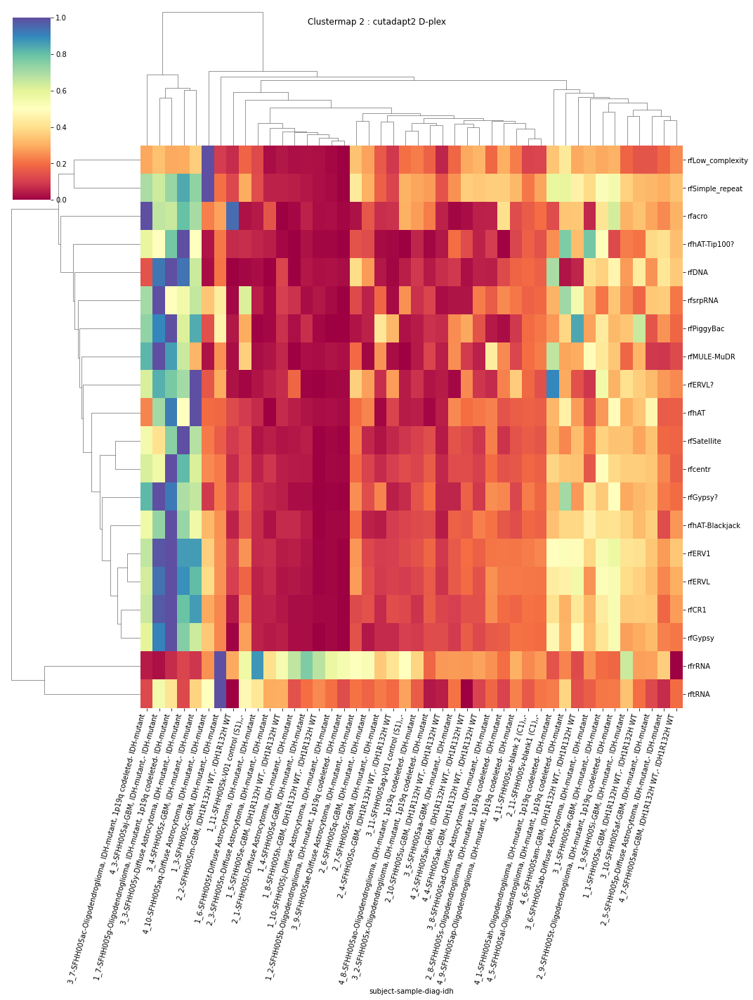

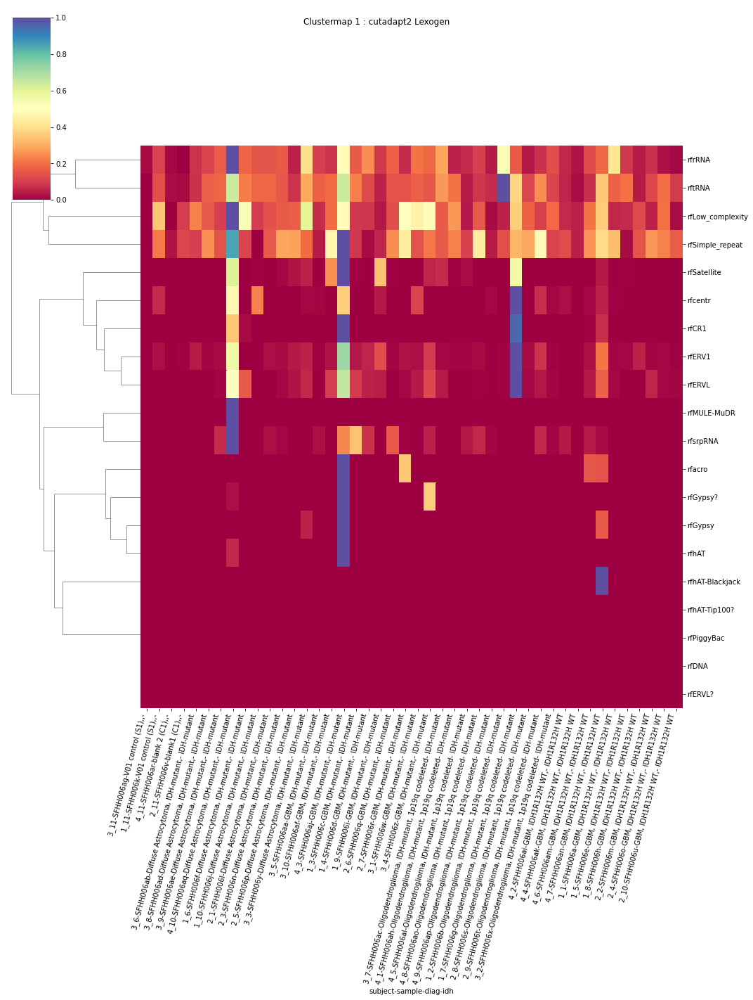

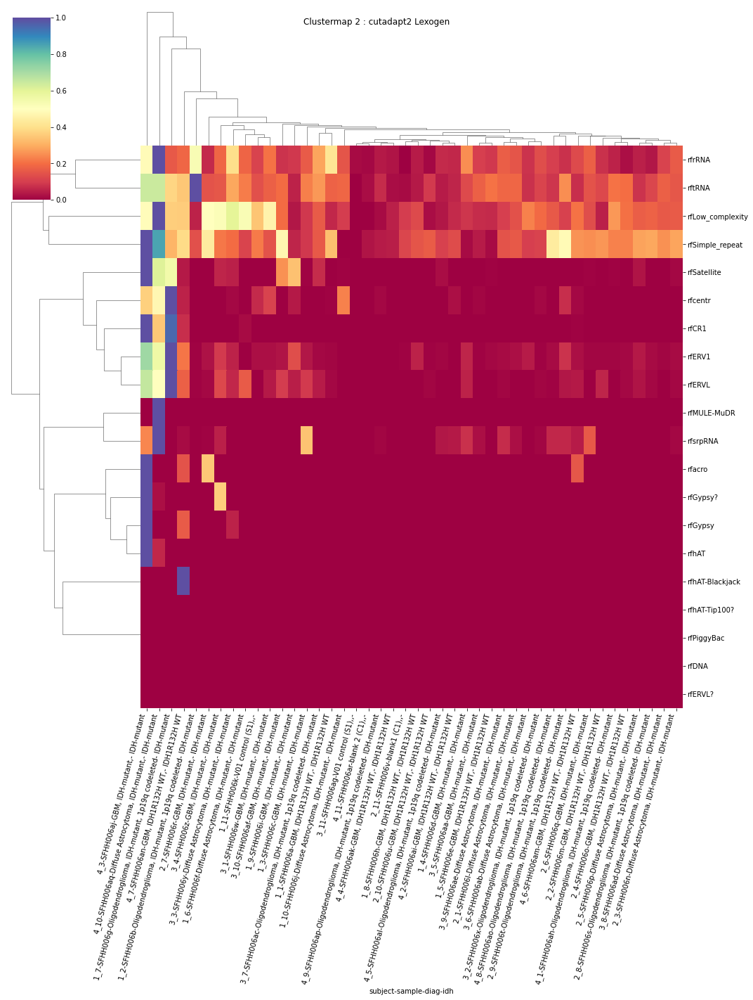

In [83]:
ttests_boxplots_and_heatmaps(dfn,rmsk_families)

# RMSK Classes

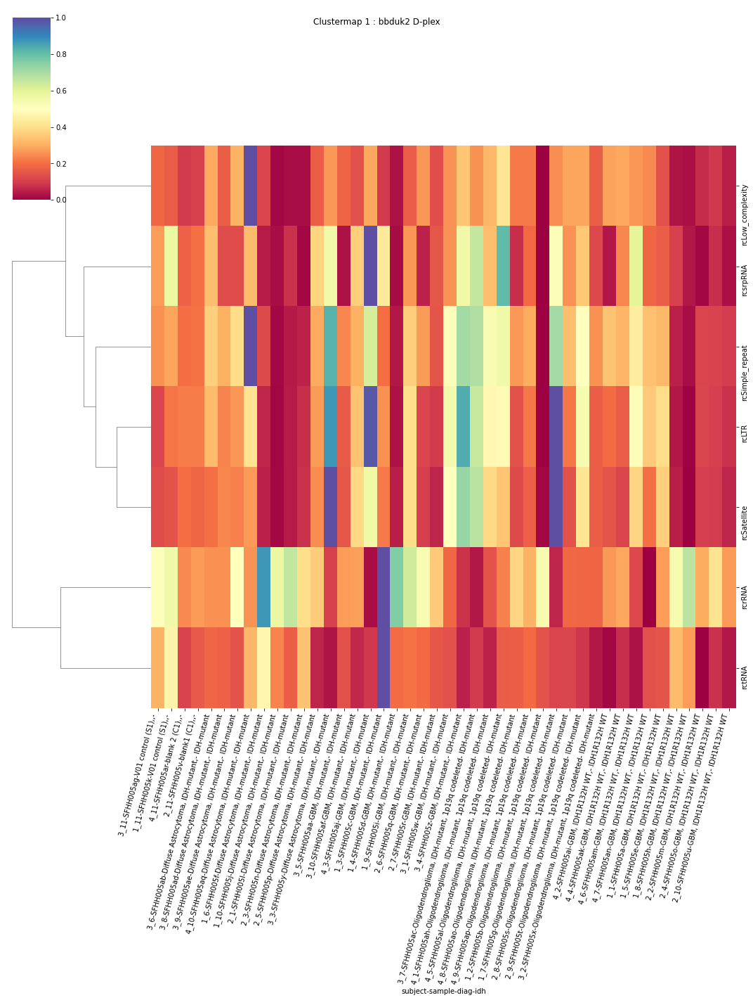

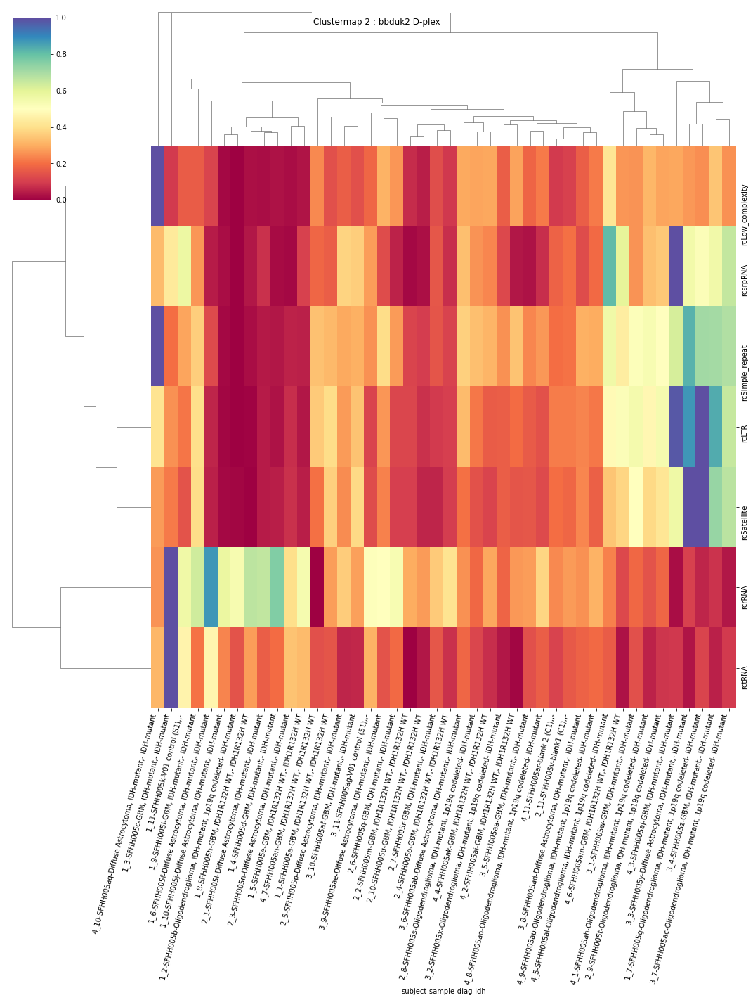

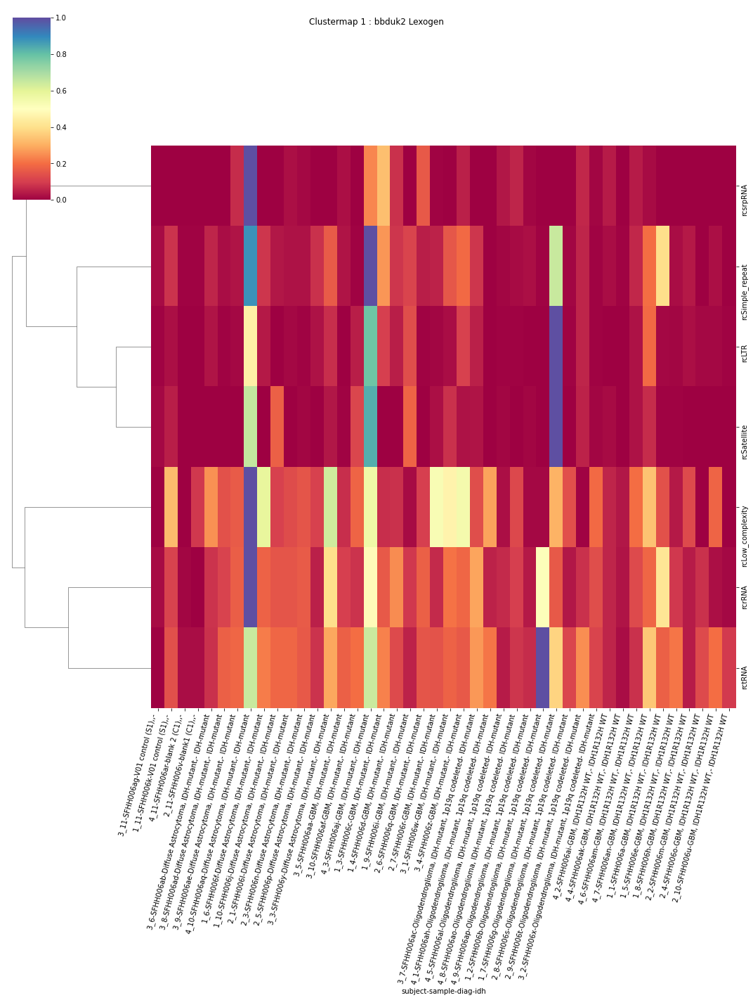

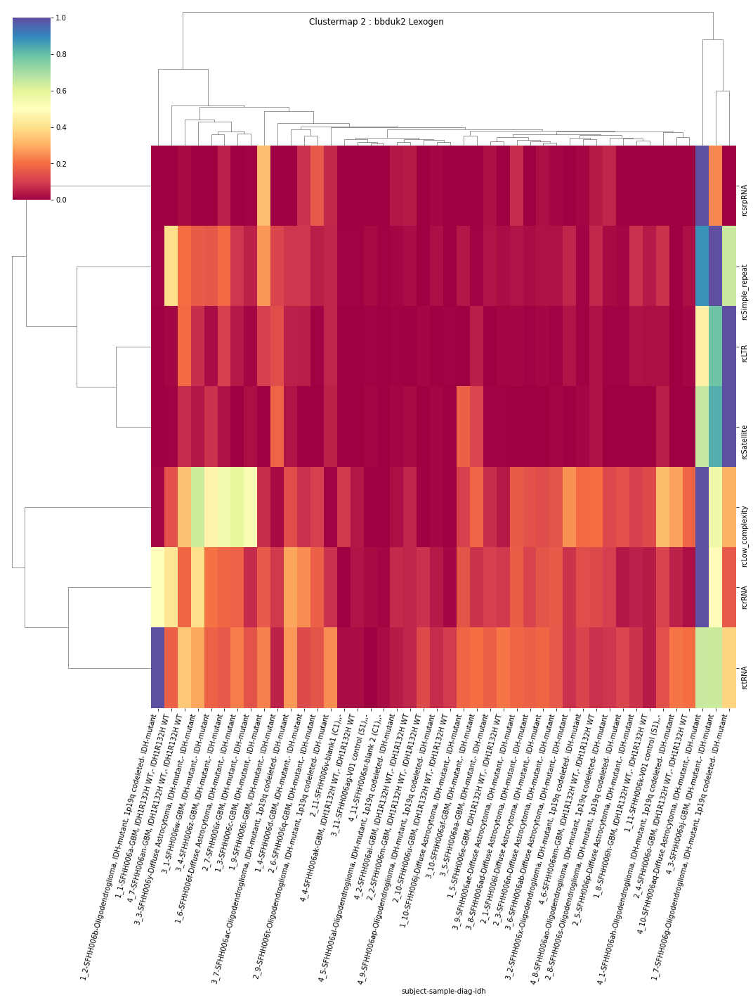

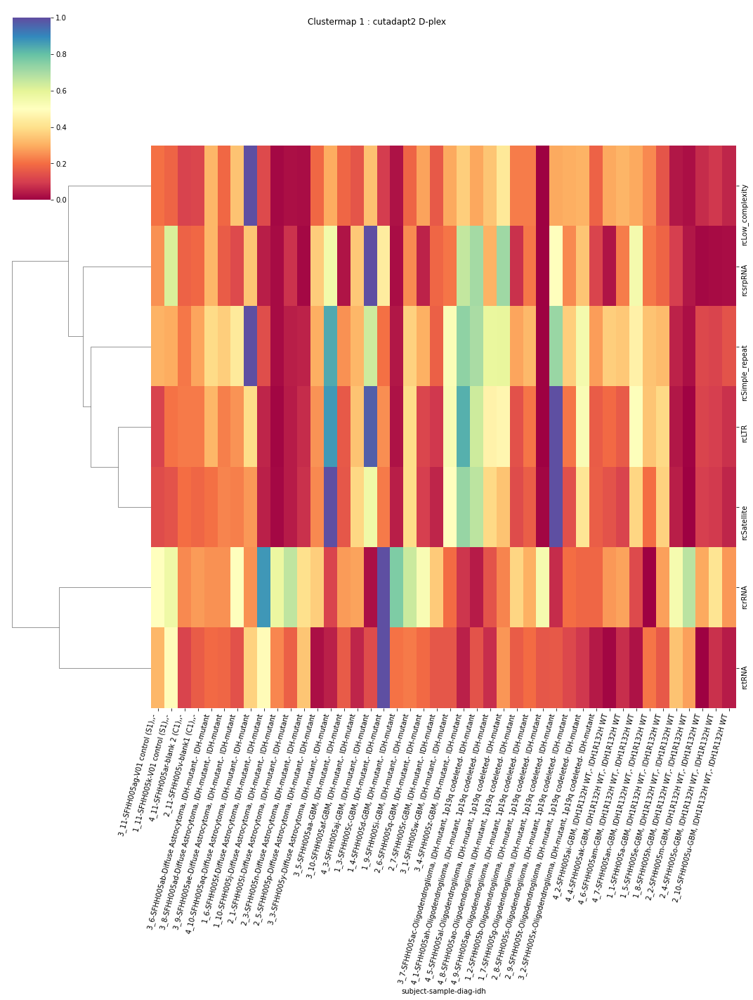

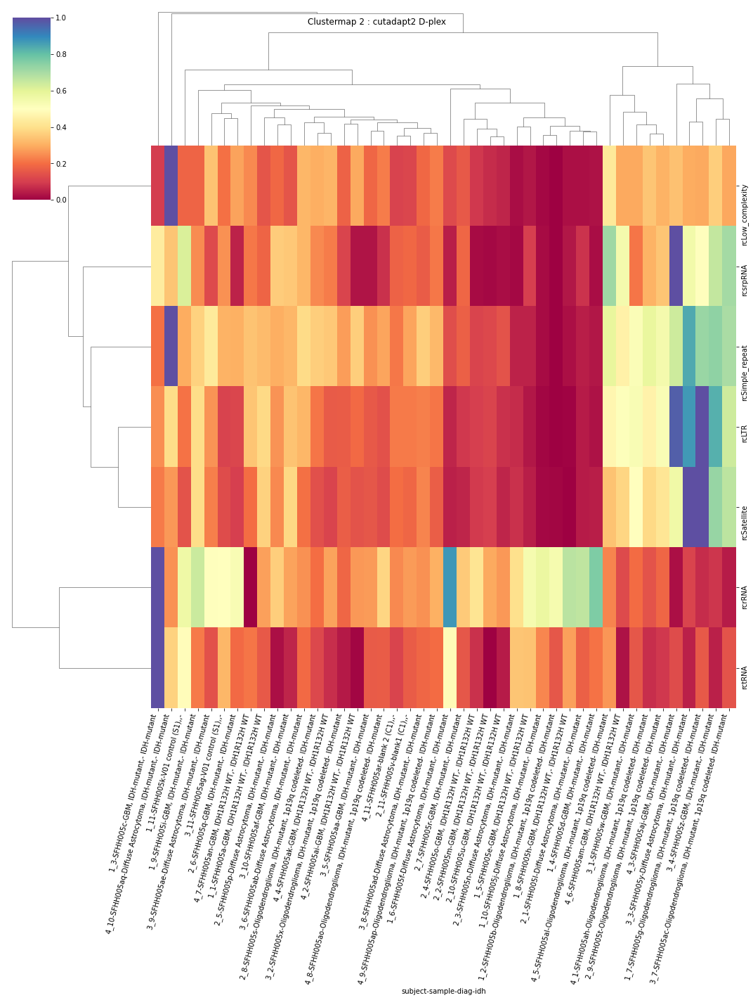

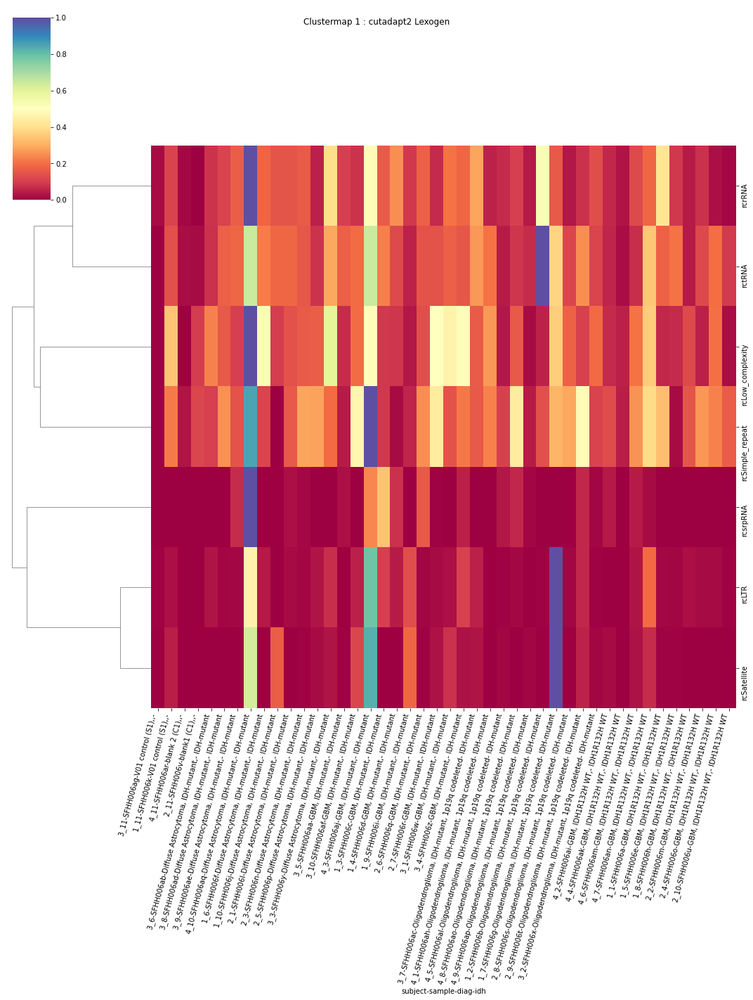

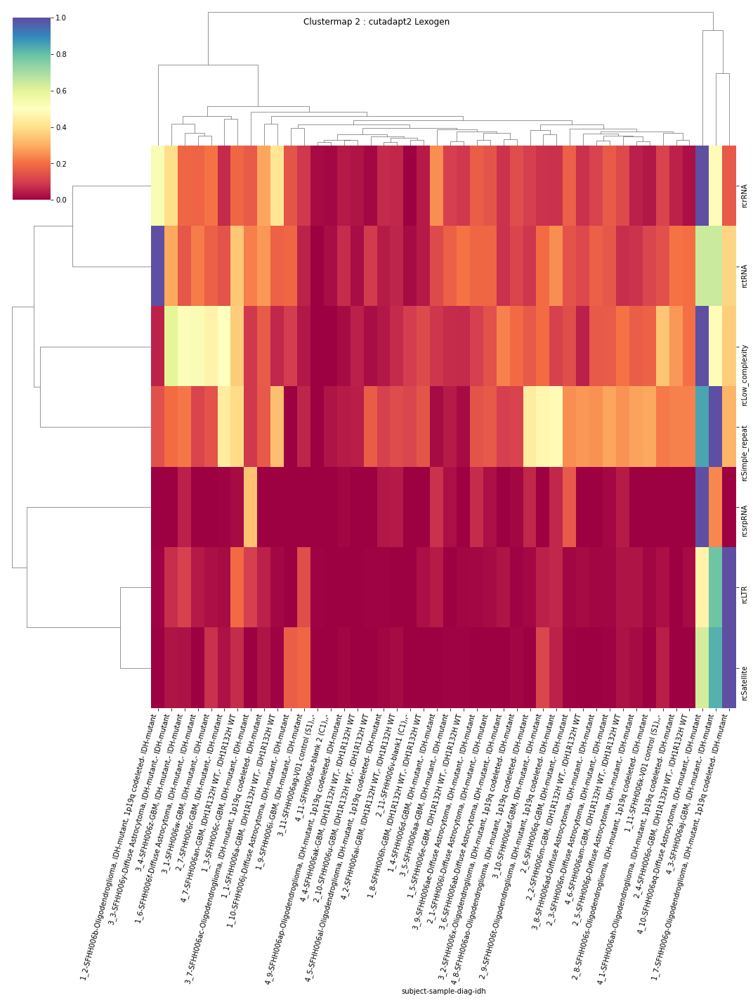

In [84]:
ttests_boxplots_and_heatmaps(dfn,rmsk_classes)

# RMSK Names

 p : 0.0015457098455486464  ( t : 3.7262168022697137 ) :  D-plex  :  bbduk2  :  rnMER57B2
Control and blanks
73     38650.42
337         NaN
Name: rnMER57B2, dtype: float64
205    16476.37
Name: rnMER57B2, dtype: float64
469    18928.87
Name: rnMER57B2, dtype: float64


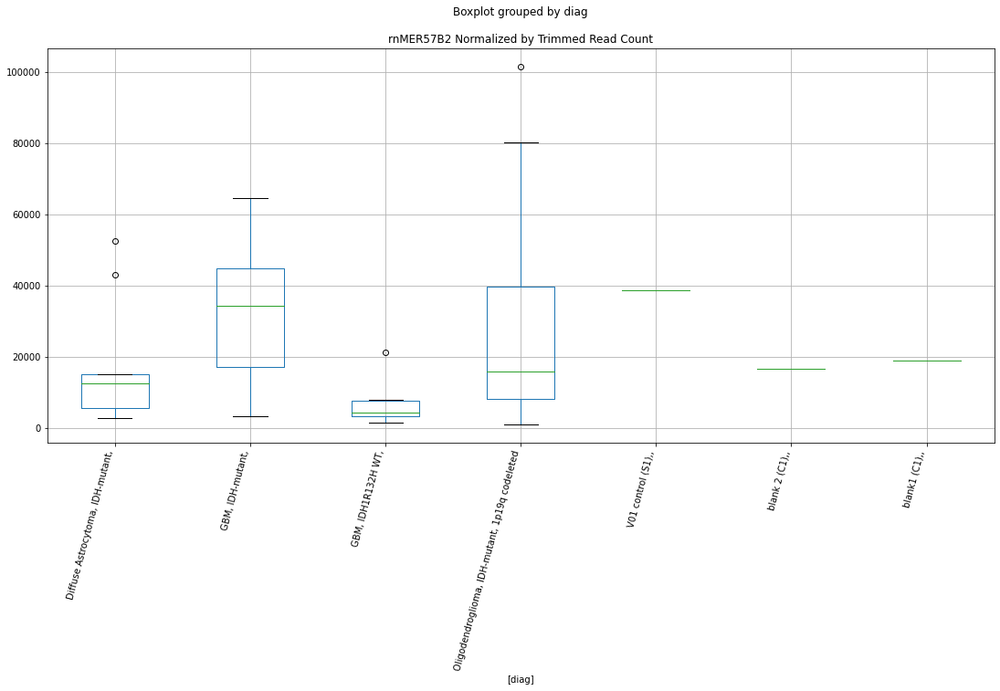

 p : 0.0020663332839156367  ( t : 3.5958177360221675 ) :  D-plex  :  bbduk2  :  rnCharlie5
Control and blanks
73     25509.28
337    34716.13
Name: rnCharlie5, dtype: float64
205    20237.28
Name: rnCharlie5, dtype: float64
469    23661.09
Name: rnCharlie5, dtype: float64


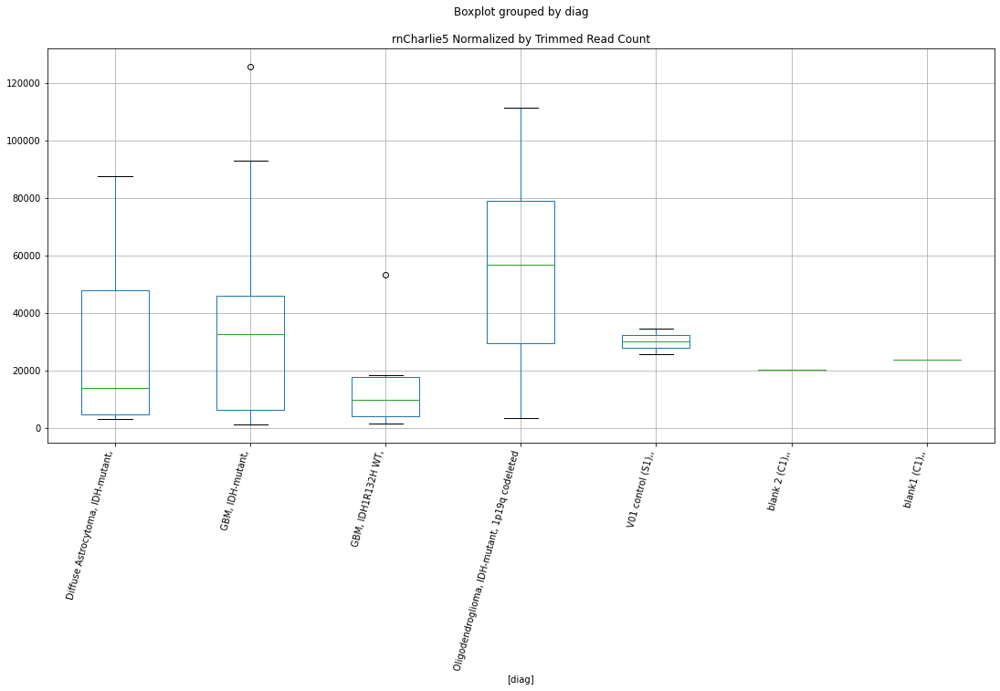

 p : 0.002305791925108369  ( t : 3.5465029679903735 ) :  D-plex  :  cutadapt2  :  rnMER57B2
Control and blanks
76     37880.71
340         NaN
Name: rnMER57B2, dtype: float64
208    17636.02
Name: rnMER57B2, dtype: float64
472    16760.72
Name: rnMER57B2, dtype: float64


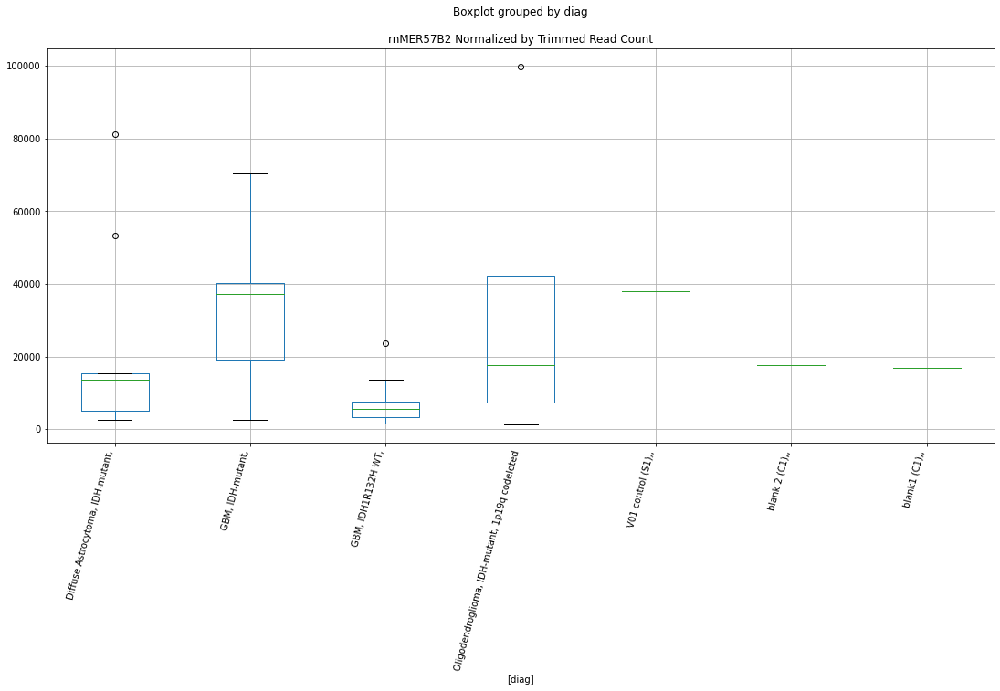

 p : 0.0023992932982546747  ( t : 3.528614392210094 ) :  D-plex  :  bbduk2  :  rnMamRep1879
Control and blanks
73       773.01
337    11572.04
Name: rnMamRep1879, dtype: float64
205    12894.55
Name: rnMamRep1879, dtype: float64
469    13605.13
Name: rnMamRep1879, dtype: float64


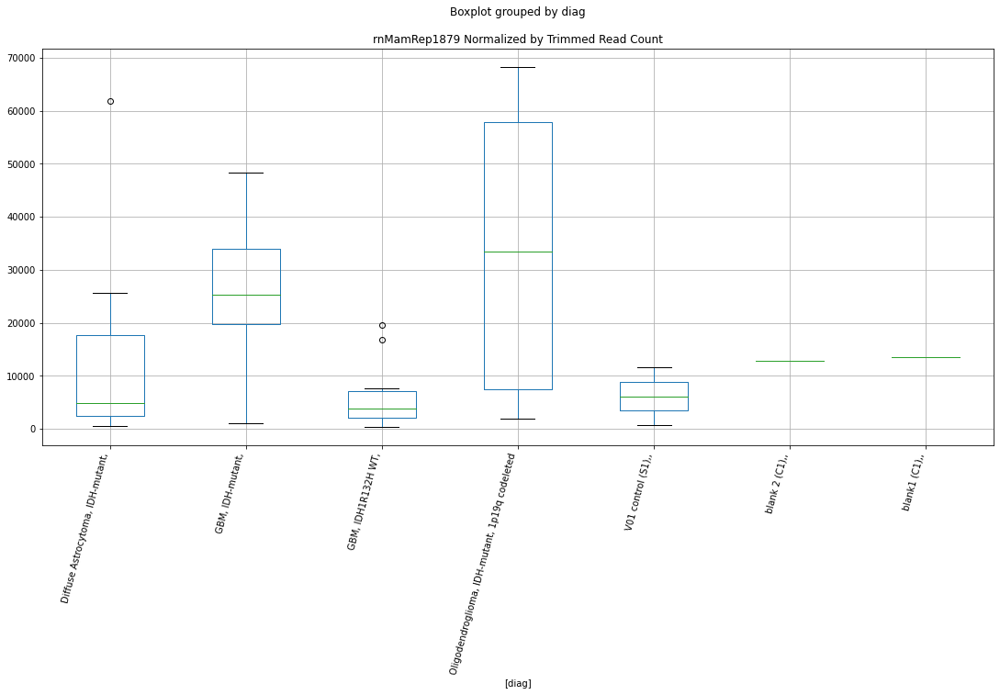

 p : 0.003608353937611461  ( t : 3.344523779325565 ) :  D-plex  :  cutadapt2  :  rnMamRep1879
Control and blanks
76       757.61
340    11449.52
Name: rnMamRep1879, dtype: float64
208    17459.66
Name: rnMamRep1879, dtype: float64
472    15026.85
Name: rnMamRep1879, dtype: float64


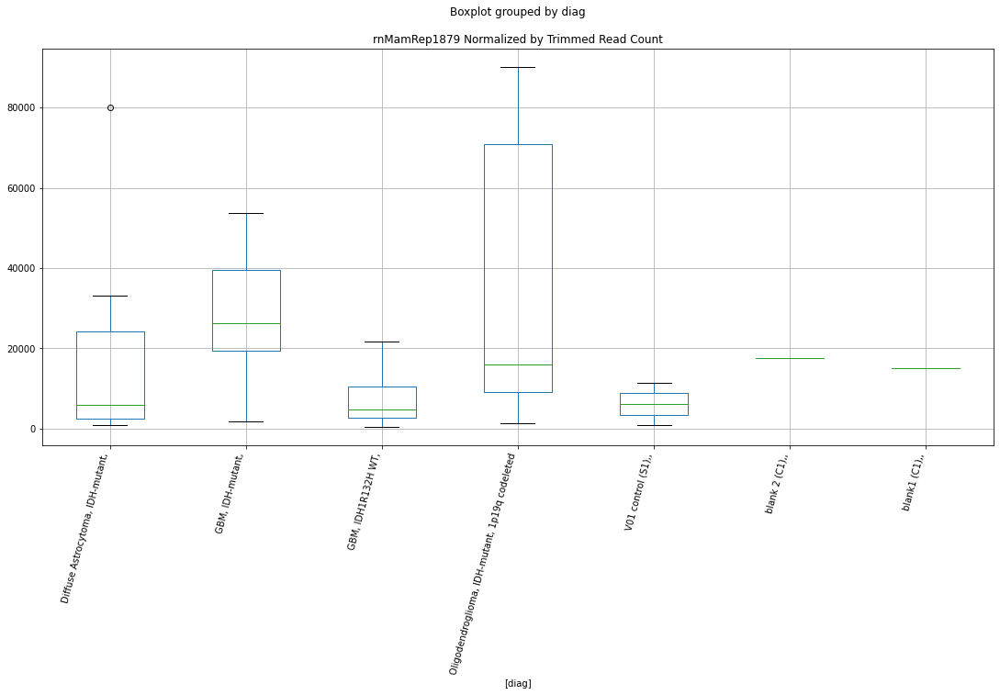

 p : 0.0038056833741707667  ( t : 3.320430647130948 ) :  D-plex  :  cutadapt2  :  rnCharlie5
Control and blanks
76     25001.27
340    23779.77
Name: rnCharlie5, dtype: float64
208    22221.39
Name: rnCharlie5, dtype: float64
472    26585.97
Name: rnCharlie5, dtype: float64


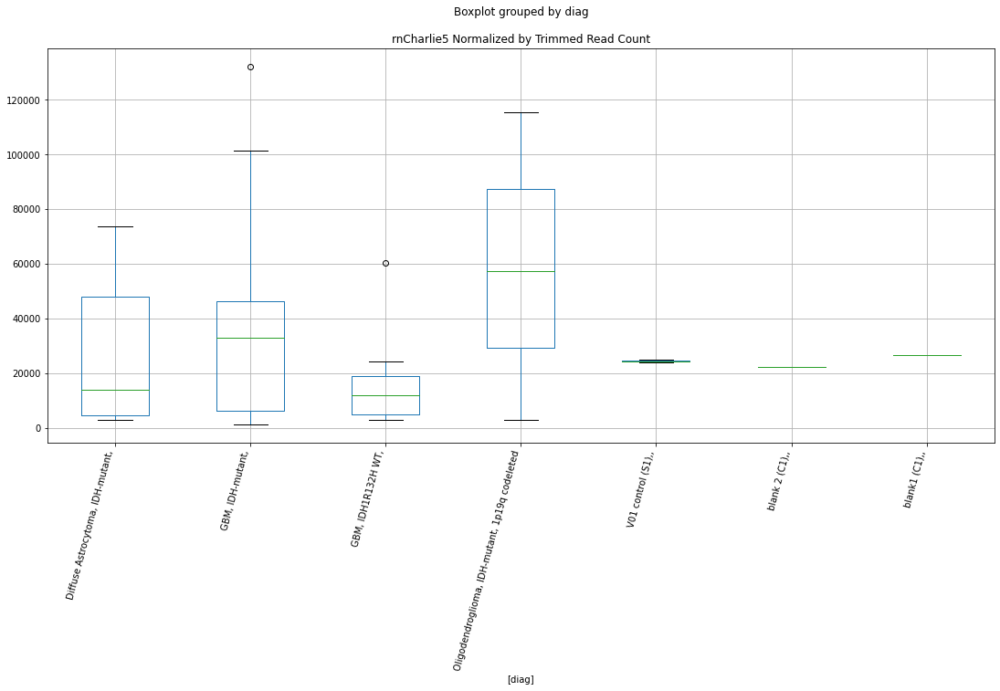

 p : 0.004481365756180244  ( t : 3.246343112614559 ) :  D-plex  :  cutadapt2  :  rnMER68
Control and blanks
76      6060.91
340    54605.39
Name: rnMER68, dtype: float64
208    34213.88
Name: rnMER68, dtype: float64
472    36989.17
Name: rnMER68, dtype: float64


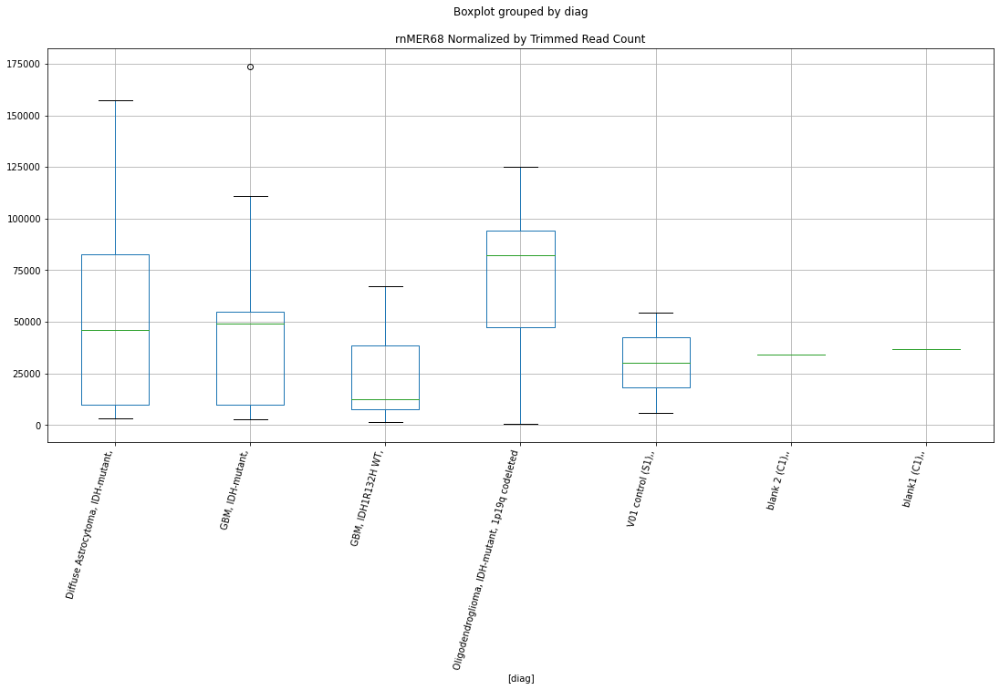

 p : 0.004568105038703879  ( t : 3.237638367176291 ) :  D-plex  :  bbduk2  :  rnMER68
Control and blanks
73      5411.06
337    56079.91
Name: rnMER68, dtype: float64
205    34027.28
Name: rnMER68, dtype: float64
469    36083.17
Name: rnMER68, dtype: float64


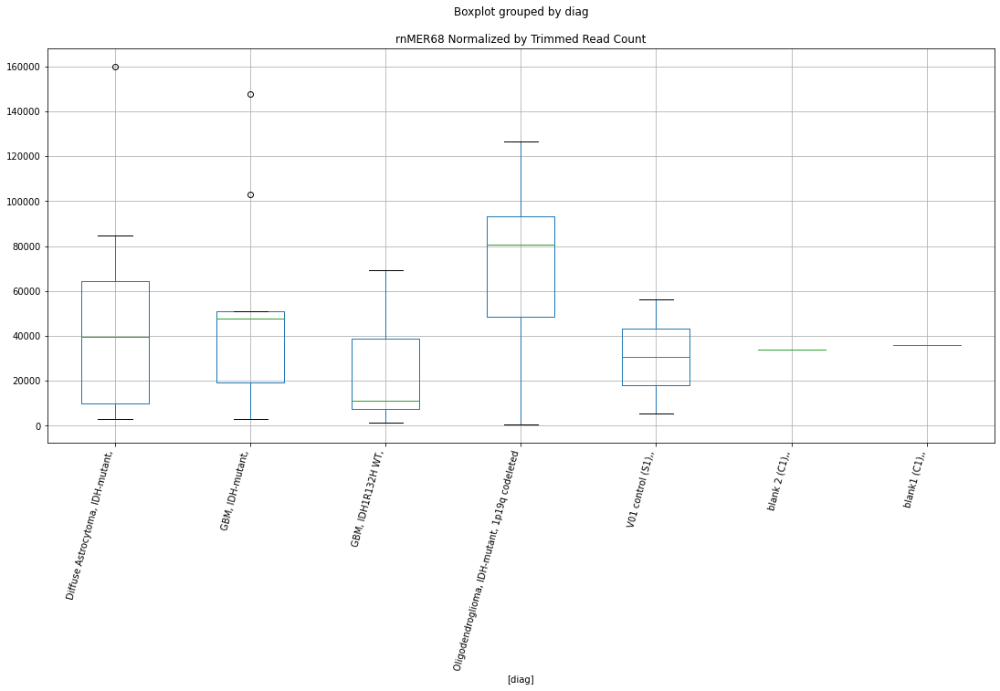

 p : 0.008097528285533319  ( t : 2.9759608757915244 ) :  D-plex  :  cutadapt2  :  rn(CCCTCT)n
Control and blanks
76      8333.76
340    10568.79
Name: rn(CCCTCT)n, dtype: float64
208    3703.56
Name: rn(CCCTCT)n, dtype: float64
472    8091.38
Name: rn(CCCTCT)n, dtype: float64


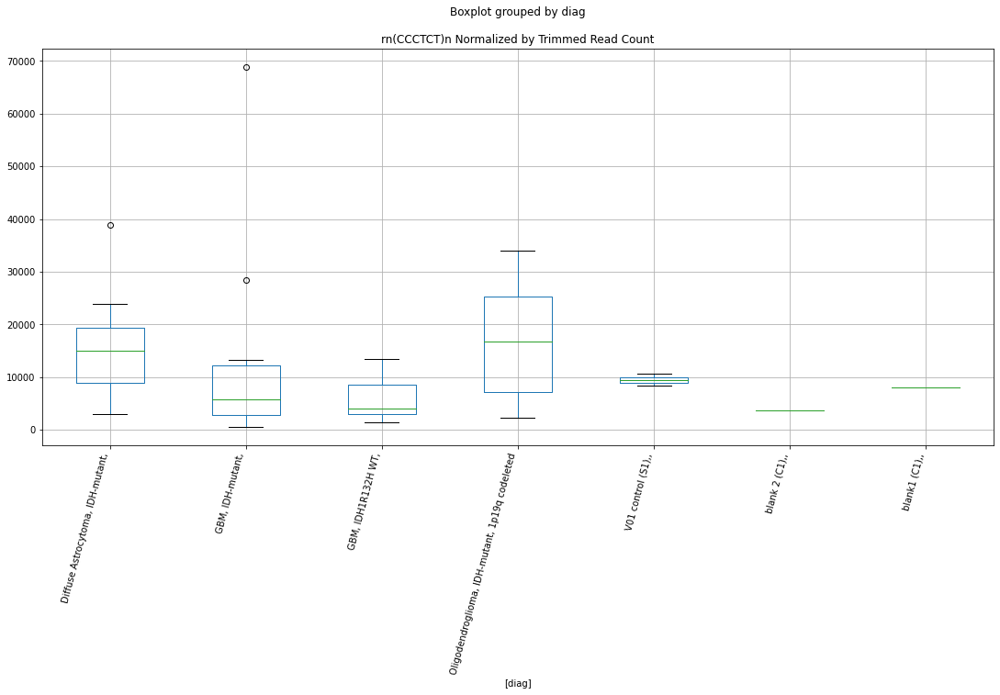

 p : 0.008137520297171668  ( t : 2.973691634269197 ) :  D-plex  :  bbduk2  :  rnHUERS-P3b-int
Control and blanks
73      6184.07
337    38276.76
Name: rnHUERS-P3b-int, dtype: float64
205    19162.73
Name: rnHUERS-P3b-int, dtype: float64
469    17745.82
Name: rnHUERS-P3b-int, dtype: float64


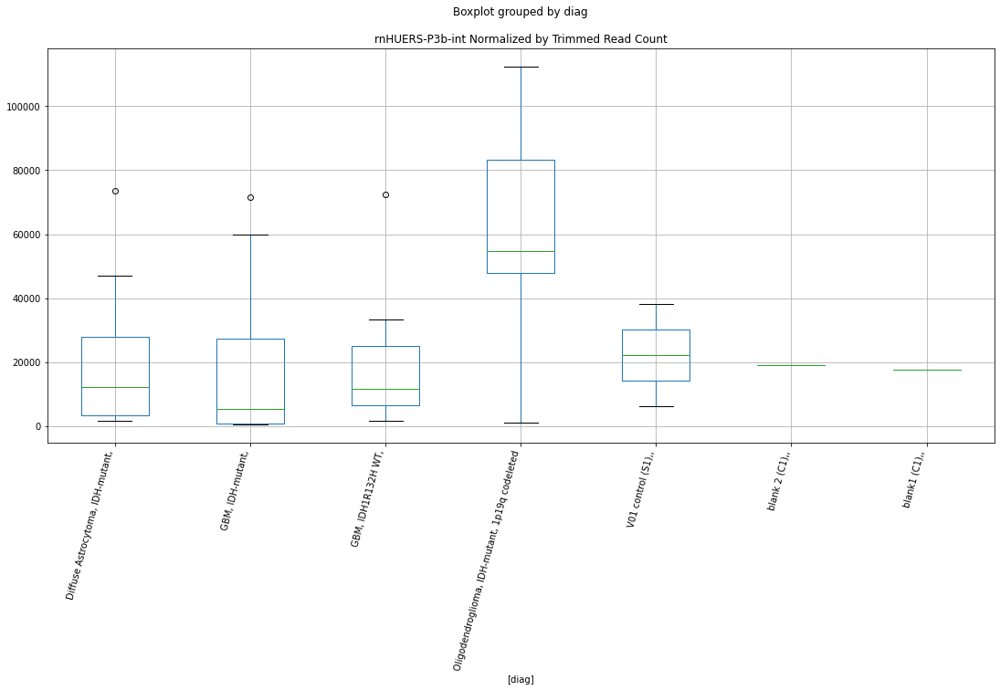

 p : 0.008465716321365222  ( t : 2.955467223378726 ) :  D-plex  :  cutadapt2  :  rnHUERS-P3b-int
Control and blanks
76      6060.91
340    38752.21
Name: rnHUERS-P3b-int, dtype: float64
208    18694.18
Name: rnHUERS-P3b-int, dtype: float64
472    17338.68
Name: rnHUERS-P3b-int, dtype: float64


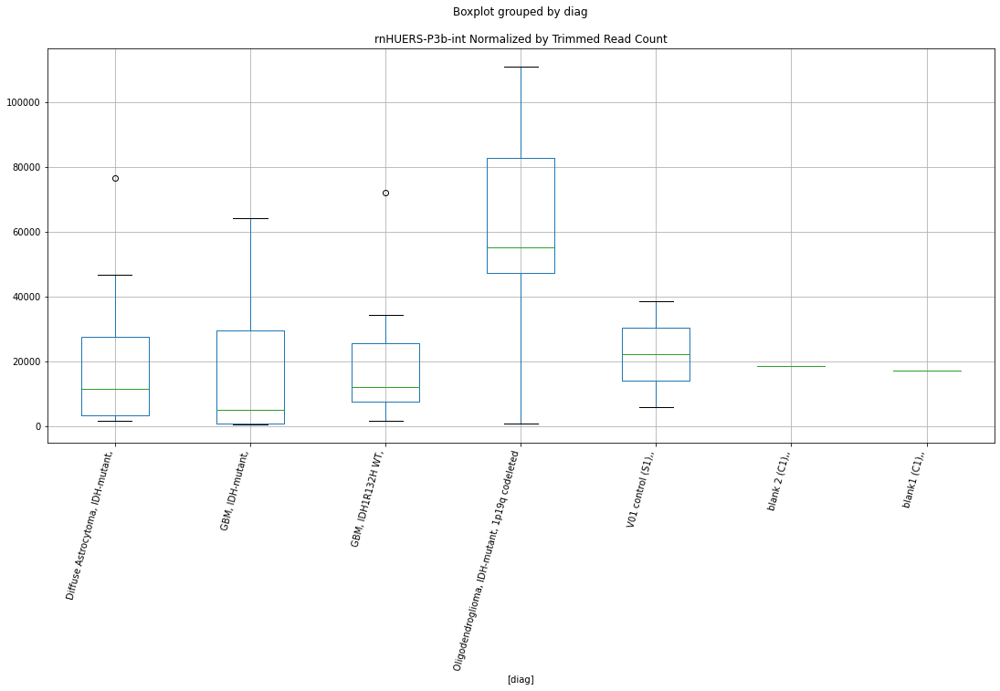

 p : 0.009172119091303534  ( t : 2.9184574108232297 ) :  D-plex  :  cutadapt2  :  rnHUERS-P3b-int
Control and blanks
76      6060.91
340    38752.21
Name: rnHUERS-P3b-int, dtype: float64
208    18694.18
Name: rnHUERS-P3b-int, dtype: float64
472    17338.68
Name: rnHUERS-P3b-int, dtype: float64


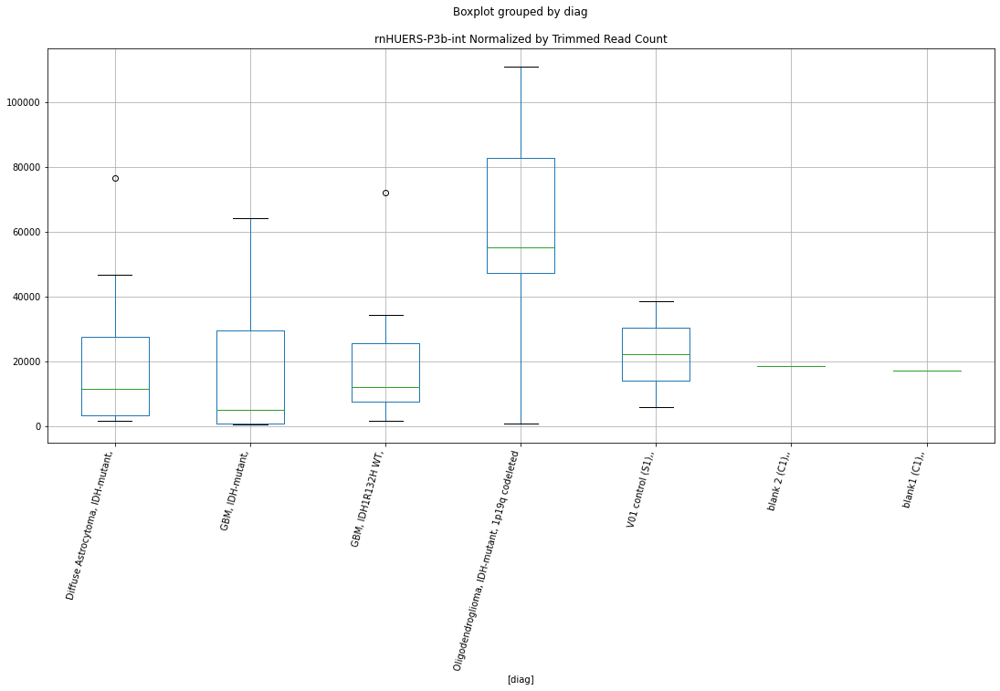

 p : 0.009952384204534013  ( t : 2.8806537831734467 ) :  D-plex  :  bbduk2  :  rnLTR16D
Control and blanks
73      1546.02
337    27594.88
Name: rnLTR16D, dtype: float64
205    17192.73
Name: rnLTR16D, dtype: float64
469    10055.96
Name: rnLTR16D, dtype: float64


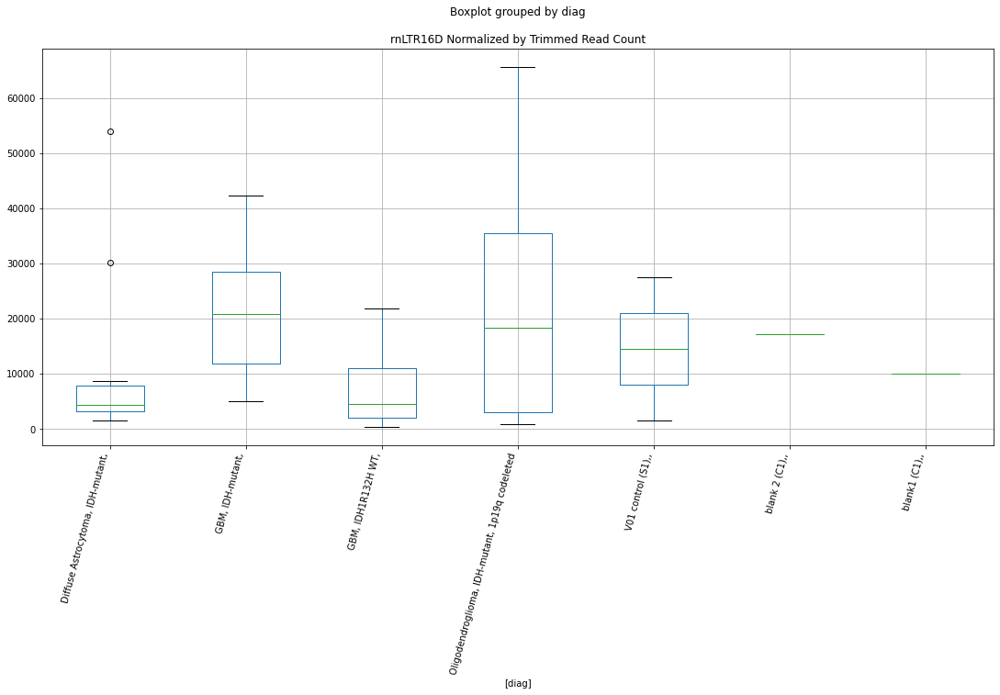

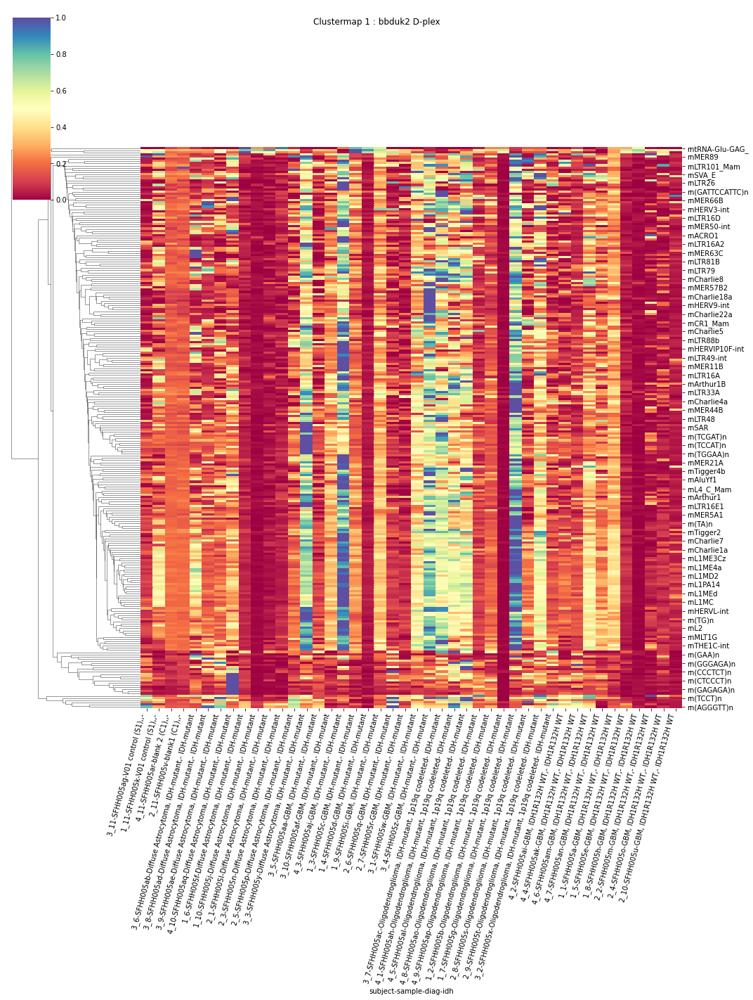

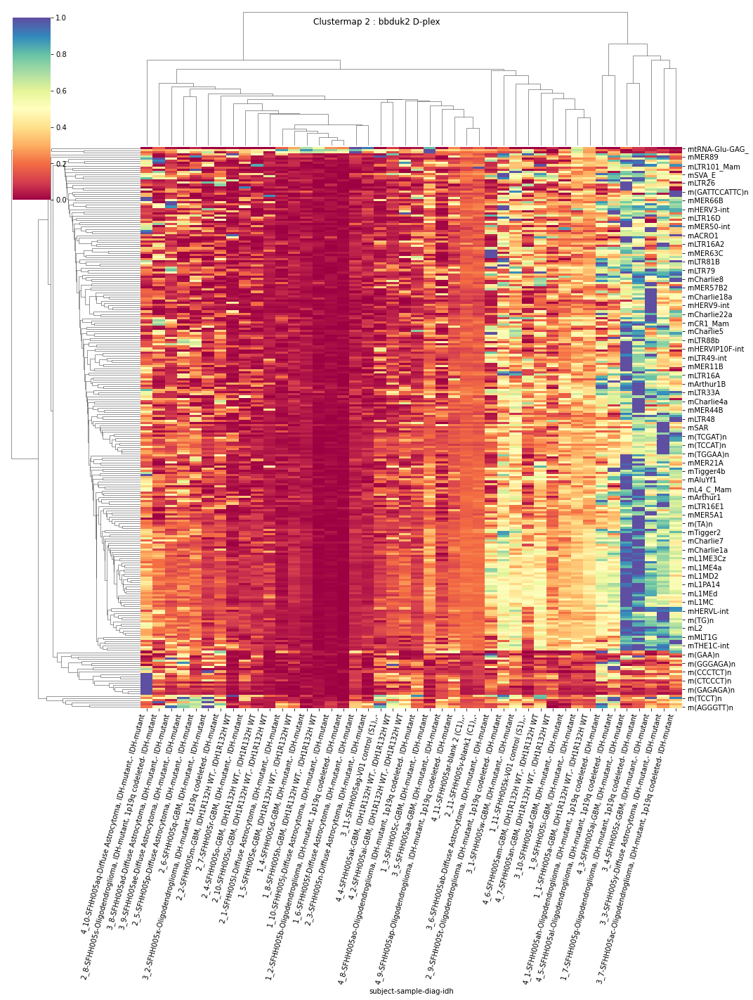

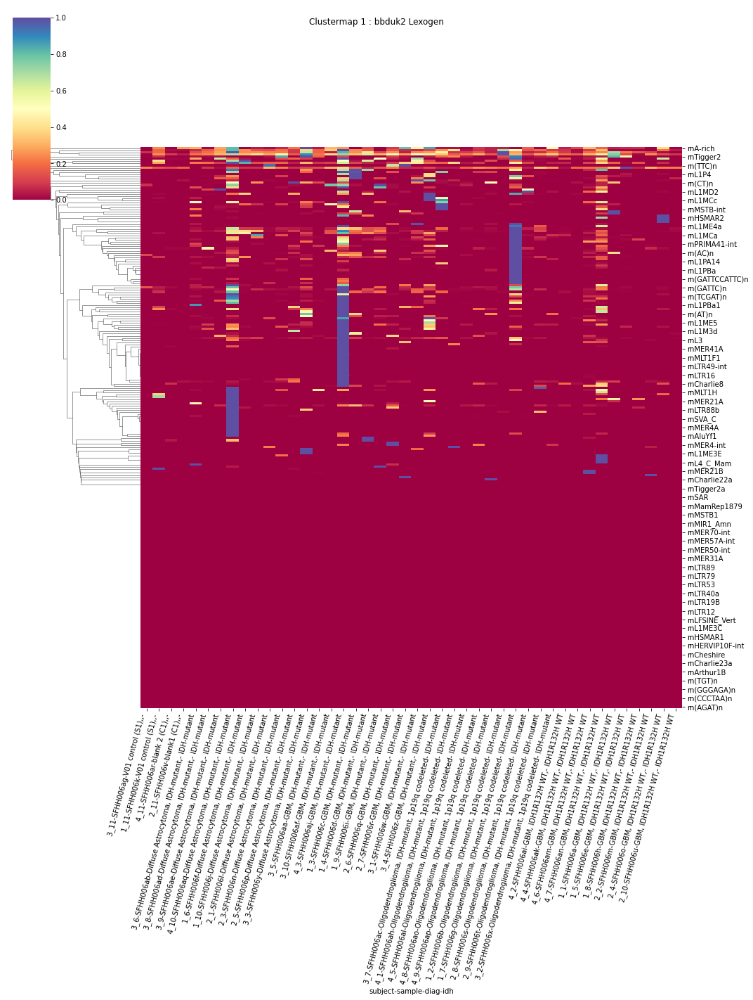

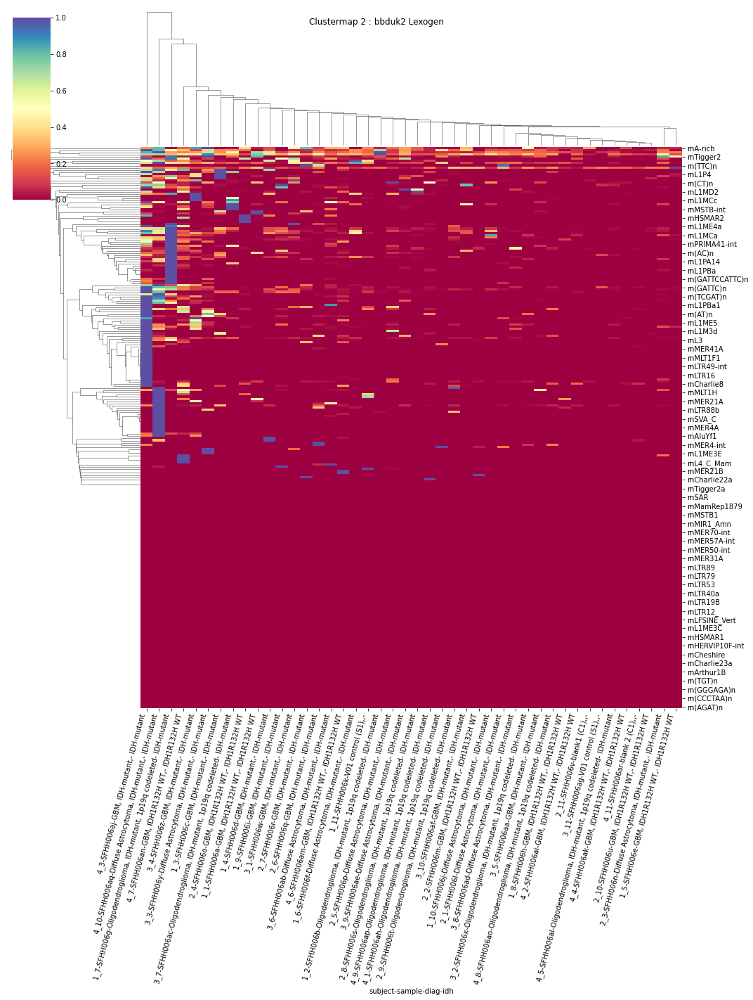

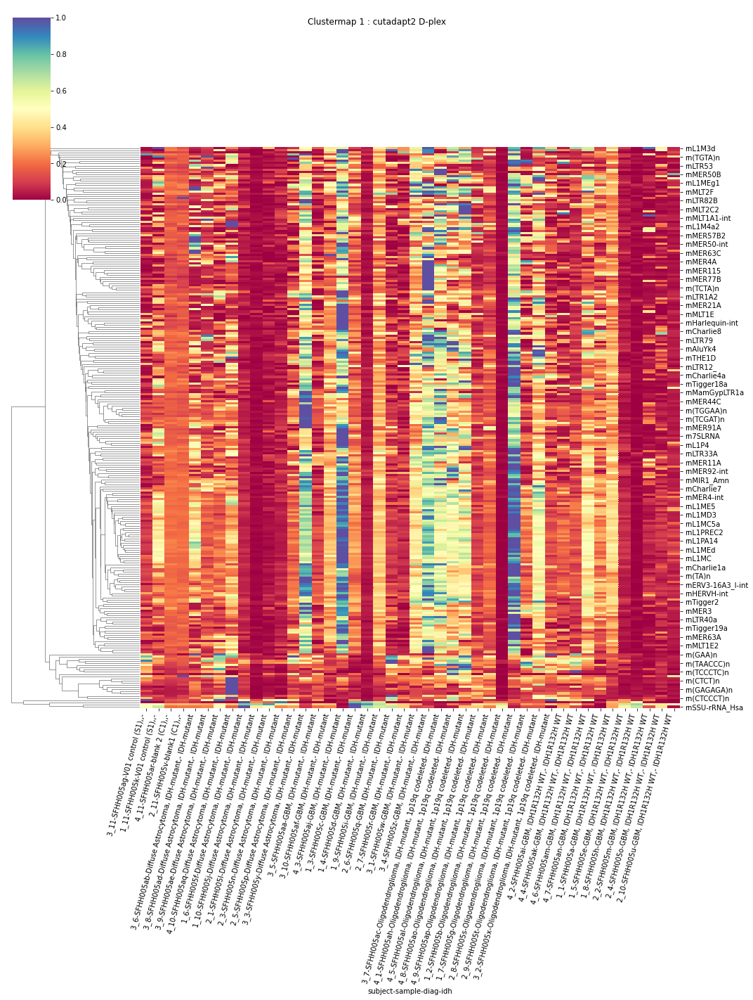

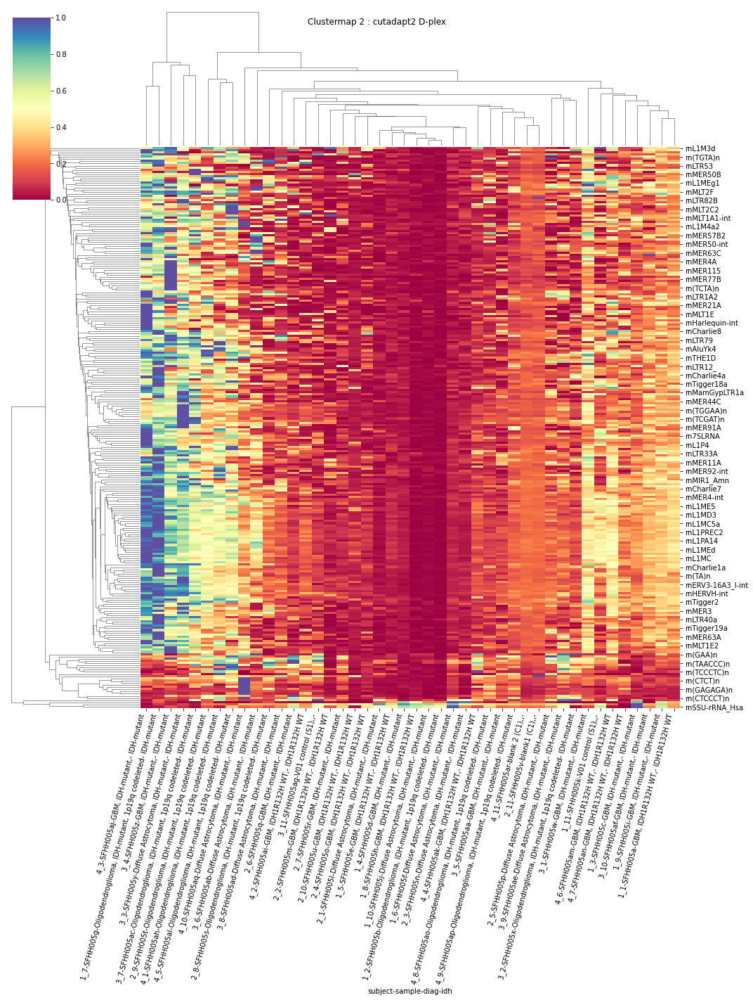

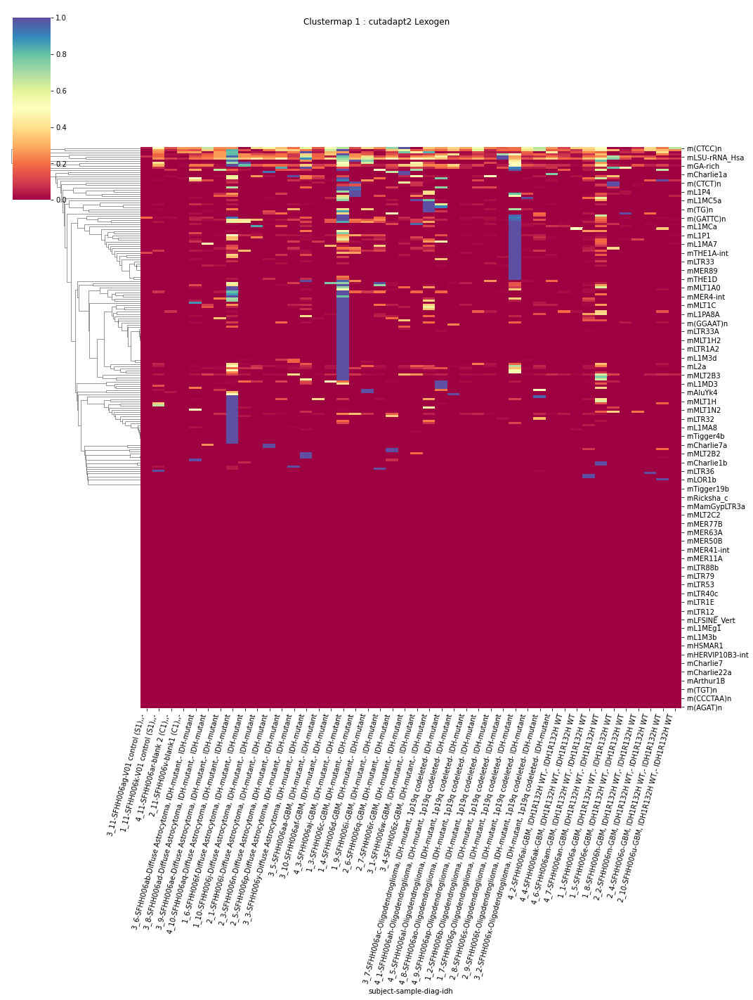

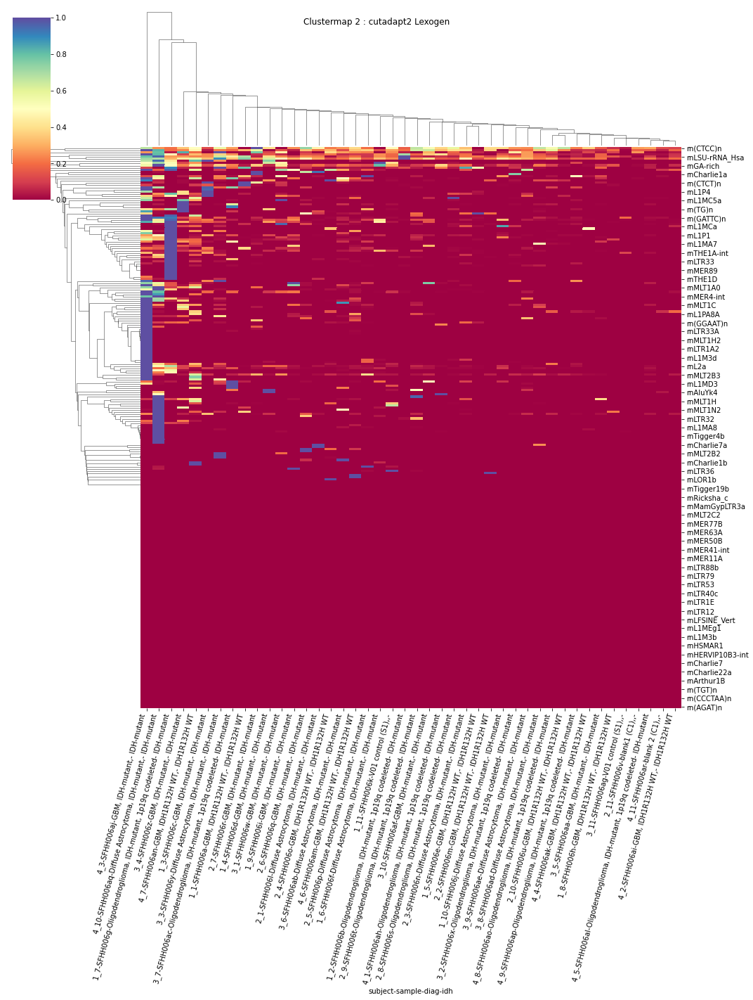

In [85]:
ttests_boxplots_and_heatmaps(dfn,rmsk_names)

In [86]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [87]:
pd.set_option('display.max_columns', default_max_columns)

In [88]:
pd.set_option('display.max_rows',default_max_rows)

In [89]:
pd.set_option('display.precision', default_precision)